In [1]:
import numpy as np
import pandas as pd
from functools import reduce
from sklearn.ensemble import ExtraTreesClassifier
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.model_selection import RepeatedKFold
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import cross_validate
from sklearn.metrics import roc_curve, mean_squared_error
from sklearn.metrics import confusion_matrix , classification_report
from sklearn.calibration import CalibratedClassifierCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.calibration import calibration_curve
import matplotlib.pyplot as plt

In [2]:
def load_dataframe(path):
    r"""
    Function to load the .xls to dataframe. All the sheets of .xls is merged, categorical data is converted to numerical
    values and Nan's in the independent features are filled with 0s
    
    Input Variables:
    path : path to the .xls file
    
    Output Variables:
    df_merged : Dataframe 
    """
    data = pd.ExcelFile(path)
    # Reading the datasheets excluding Description
    datasheets = data.sheet_names[1:]

    # Creating a dictionary of dataframes
    dfs = {sh:data.parse(sh) for sh in datasheets}
    
    # Merging all the dataframes
    df = [dfs['Soc_Dem'], dfs['Products_ActBalance'], dfs['Inflow_Outflow'], dfs['Sales_Revenues']]
    df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Client'],
                                                how='outer'), df)
    
    # Replacing the 'Sex' column values to numerical values
    df_merged['Sex'].replace('F', 0, inplace=True)
    df_merged['Sex'].replace('M', 1, inplace=True)

    # Removing the rows which do not have values for all the available columns
    df_merged = df_merged[df_merged['TransactionsDeb_CA'].notna()]
    
    #Filling the empty spaces with 0 for the data in the first three sheets
    df_merged.iloc[:, :30] = df_merged.iloc[:, :30].fillna(value=0)
    
    return df_merged

data = load_dataframe("Task_Data_Scientist_Dataset.xlsx")
#data

In [3]:
def train_and_target(data):
    r"""
    Function to create training and target sets. Training set consists of all the data samples from the Sales Revenue sheet 
    of the .xls file. All the other data samples are taken as target set.
    
    Input Variables:
    data :  main dataframe
    
    Output Variables: returns df_train, df_target
    df_train : Dataframe consisting of training datapoints
    df_target : Dataframe consisting of target datapoints
    
    """
    #Creating the test dataset by collecting the rows with NaN values in it
    df_target = data.loc[~data.index.isin(data.dropna().index)]

    #Creating the training dataset by collecting the rows without NaN values in it
    df_train = data.dropna()
    
    return df_train, df_target

df_train, df_target = train_and_target(data)

In [4]:
def create_target_set(df_train, target, dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL']):
    r"""
    Function to create dataframes of independent features and dependent features.
    
    Input Variables:
    df_train :  Dataframe from which features are extracted
    target : String type -  Column name of the target feature (for ex:'Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC' and 'Revenue_CL' )
    dependent_features : List - List of all the dependent features to drop from the training set
    
    Output Variables: returns X, y
    X : Dataframe of Independent features
    y : Dataframe of target
    
    """
    y  = df_train[target]
    X  = df_train.drop(dependent_features, axis='columns')
    return X, y

#X, y = create_target_set(df_train, 'Sale_CL', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
 #                                                             'Revenue_MF', 'Revenue_CC','Revenue_CL'])

In [5]:
def feature_selection(X, y, n=20):
    r"""
    Funtion to select features based on feature importance obtained fromExtraTreesClassifier. 
    n significant dependent features are chosen. n = 20 is choosen as default, a heuristic obtained from EDA
    
    Input Variables:
    X : Dataframe of Independent features
    y : Dataframe of target
    n : Number of significant features
    
    Output Variables: returns X
    X : Dataframe of Independent relevant features
    
    """
    model = ExtraTreesClassifier()
    model.fit(X,y)
    feature_importance = pd.Series(model.feature_importances_, index = X.columns)
    Series_features = feature_importance.nlargest(n)
    Relevant_columns = Series_features.index
    X = X[Relevant_columns]
    return X

#X = feature_selection(X, y, n=20)

In [6]:
def SMOTE_analysis(X, y):
    r"""
    Function to perform SMOTE 
    
    Input Variables:
    X : Dataframe of Independent relevant features
    y : Dataframe of target
    
    Output Variable: returns X_smc, y_smc
    X_smc : Dataframe of Independent relevant features with minority class oversampled
    y_smc : Dataframe of target with minority class oversampled
    
    """
    smote = SMOTE(sampling_strategy='minority')
    X_smc, y_smc = smote.fit_resample(X, y)
    return X_smc, y_smc

#X_S, y_S = SMOTE_analysis(X, y)

In [7]:
def train_and_test_split(X, y, test_size=0.2, random_state=15):
    r"""
    Function splits the training data to train and test sets 
    
    Input Variables:
    X : Dataframe of Independent relevant features
    y : Dataframe of target
    test_size : Ratio of test sample to train samples. Default value is set at 0.2
    random_state : seed 
    
    Output Variables: returns X_train, X_test, y_train, y_test
    X_train : Indenpendent features of train set.
    X_test : Independent features of test set
    y_train : Denpendent features of train set.
    y_test : Dependent features of test set
    
    """
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, 
                                                                random_state=random_state, stratify=y)
    return X_train, X_test, y_train, y_test


#X_train_c, X_test_c, y_train_c, y_test_c = train_and_test_split(X_S, y_S)

In [8]:
def model_classification(X_train, y_train,n_estimators=100, learning_rate=0.1, max_features=2, max_depth=4, 
                         random_state=42, n_splits=20, n_repeats=3):
    r"""
    
    """
    
    
    xgb = GradientBoostingClassifier(n_estimators=n_estimators, learning_rate=learning_rate,
                                     max_features=max_features, max_depth=max_depth, random_state=random_state)
    
    #Calibration of the probabilities
    calibrated_model = CalibratedClassifierCV(xgb, method='sigmoid', cv=3)
    cv = RepeatedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=42)

    n_scores = cross_validate(calibrated_model, X_train, y_train, scoring='roc_auc',  return_estimator=True,cv=cv, n_jobs=-1)
    
     #Computing the index at which minimum error occurs  
    index_min_error = np.argmin(n_scores['test_score'])

    #Choosing the estimator based on minimum error
    estimator = n_scores['estimator'][index_min_error]
    
    return estimator
#estimator = model_classification(X_train_c, y_train_c, n_estimators=100, learning_rate=0.1, 
#                                 max_features=2, max_depth=4, random_state=42)

In [9]:
def model_regression(X_train, y_train, learning_rate=0.05, n_estimators=190, min_samples_split=4,
                                 max_depth=4, random_state = 42,  n_splits=20, n_repeats=3):
    
    gbr = GradientBoostingRegressor(loss='huber', learning_rate=0.05, n_estimators=190, min_samples_split=4,
                                 max_depth=4, random_state = 42)
    
    cv = RepeatedKFold(n_splits=n_splits, n_repeats=n_repeats, random_state=42)
    n_scores = cross_validate(gbr, X_train, y_train, scoring='neg_root_mean_squared_error',  
                              return_estimator=True,cv=cv, n_jobs=-1)
    
     #Computing the index at which minimum error occurs  
    index_max_error = np.argmax(n_scores['test_score'])

    #Choosing the estimator based on minimum error
    estimator = n_scores['estimator'][index_max_error]
    
    return estimator
    

# Modelling for Consumer Loan 

def consumer_loan_prediction(df_train):
    
    ################################################################################################################
    #                                 Classification Task
    ################################################################################################################
    
    print("Consumer Loan Classification :")
    X_c, y_c= create_target_set(df_train, 'Sale_CL', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL'])
    
    X_c = feature_selection(X_c, y_c, n=20)
    
    X_S, y_S = SMOTE_analysis(X_c, y_c)
    
    X_train_c, X_test_c, y_train_c, y_test_c = train_and_test_split(X_S, y_S)
    
    estimator_c = model_classification(X_train_c, y_train_c, n_estimators=100, learning_rate=0.1, 
                                 max_features=2, max_depth=4, random_state=42)
    
    # predict probabilities
    probs_c = estimator_c.predict_proba(X_test_c)[:,1]
    # reliability diagram
    fop, mpv = calibration_curve(y_test_c, probs_c, n_bins=10, normalize=True)
    # plot perfectly calibrated
    plt.plot([0, 1], [0, 1], linestyle='--')
    # plot model reliability
    plt.plot(mpv, fop, marker='.')
    plt.show()
    prediction_c = estimator.predict(X_test_c)
    
    print("Classification Report: \n", classification_report(y_test_c, prediction_c))
    
    ################################################################################################################
    #                                 Regression Task
    ################################################################################################################
    
    print("Consumer Loan Regression task :")
    X_r, y_r= create_target_set(df_train, 'Revenue_CL', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL'])
    
    
    #X_r = feature_selection(X_r, y_c, n=20)
    
    #X_rs, y_rs = SMOTE_analysis(X_r, y_r)
    
    X_train_r, X_test_r, y_train_r, y_test_r = train_test_split(X_r, y_r, test_size=0.2, 
                                                                random_state=42)
    
    estimator_r = model_regression(X_train_r, y_train_r,learning_rate=0.05, n_estimators=190, min_samples_split=4,
                                 max_depth=4, random_state = 42)
    
    y_loan_pred = estimator_r.predict(X_test_r)
    MSE = mean_squared_error(y_test_r, y_loan_pred) 
    
    print("Mean squared error of the model for consumer loan = ", MSE)
    
    return estimator_c, estimator_r

consumer_loan_prediction(df_train)
    

# Modelling for Mutual Fund

def mutual_fund_prediction(df_train):
    
    ################################################################################################################
    #                                 Classification Task
    ################################################################################################################
    
    print("Mutual Fund Classification :")
    X_c, y_c= create_target_set(df_train, 'Sale_MF', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL'])
    
    X_c = feature_selection(X_c, y_c, n=20)
    
    X_S, y_S = SMOTE_analysis(X_c, y_c)
    
    X_train_c, X_test_c, y_train_c, y_test_c = train_and_test_split(X_S, y_S)
    
    estimator_c = model_classification(X_train_c, y_train_c, n_estimators=100, learning_rate=0.1, 
                                 max_features=2, max_depth=4, random_state=42)
    
    # predict probabilities
    probs_c = estimator_c.predict_proba(X_test_c)[:,1]
    # reliability diagram
    fop, mpv = calibration_curve(y_test_c, probs_c, n_bins=10, normalize=True)
    # plot perfectly calibrated
    plt.plot([0, 1], [0, 1], linestyle='--')
    # plot model reliability
    plt.plot(mpv, fop, marker='.')
    plt.show()
    prediction_c = estimator.predict(X_test_c)
    
    print("Classification Report: \n", classification_report(y_test_c, prediction_c))
    
    ################################################################################################################
    #                                 Regression Task
    ################################################################################################################
    
    print("Mutual Fund Regression task :")
    X_r, y_r= create_target_set(df_train, 'Revenue_MF', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL'])
    
    
    #X_r = feature_selection(X_r, y_c, n=20)
    
    #X_rs, y_rs = SMOTE_analysis(X_r, y_r)
    
    X_train_r, X_test_r, y_train_r, y_test_r = train_test_split(X_r, y_r, test_size=0.2, 
                                                                random_state=42)
    
    estimator_r = model_regression(X_train_r, y_train_r,learning_rate=0.05, n_estimators=190, min_samples_split=4,
                                 max_depth=4, random_state = 42)
    
    y_loan_pred = estimator_r.predict(X_test_r)
    MSE = mean_squared_error(y_test_r, y_loan_pred) 
    
    print("Mean squared error of the model for Mutual Fund = ", MSE)
    
    return estimator_c, estimator_r

mutual_fund_prediction(df_train)

# Modelling for Credit Card 

def credit_card_prediction(df_train):
    
    ################################################################################################################
    #                                 Classification Task
    ################################################################################################################
    
    print("Credit Card Classification :")
    X_c, y_c= create_target_set(df_train, 'Sale_CC', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL'])
    
    X_c = feature_selection(X_c, y_c, n=20)
    
    X_S, y_S = SMOTE_analysis(X_c, y_c)
    
    X_train_c, X_test_c, y_train_c, y_test_c = train_and_test_split(X_S, y_S)
    
    estimator_c = model_classification(X_train_c, y_train_c, n_estimators=100, learning_rate=0.1, 
                                 max_features=2, max_depth=4, random_state=42)
    
    # predict probabilities
    probs_c = estimator_c.predict_proba(X_test_c)[:,1]
    # reliability diagram
    fop, mpv = calibration_curve(y_test_c, probs_c, n_bins=10, normalize=True)
    # plot perfectly calibrated
    plt.plot([0, 1], [0, 1], linestyle='--')
    # plot model reliability
    plt.plot(mpv, fop, marker='.')
    plt.show()
    prediction_c = estimator.predict(X_test_c)
    
    print("Classification Report: \n", classification_report(y_test_c, prediction_c))
    
    ################################################################################################################
    #                                 Regression Task
    ################################################################################################################
    """
    print("Credit Card Regression task :")
    X_r, y_r= create_target_set(df_train, 'Revenue_CC', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                              'Revenue_MF', 'Revenue_CC','Revenue_CL'])
    
    
    #X_r = feature_selection(X_r, y_c, n=20)
    
    #X_rs, y_rs = SMOTE_analysis(X_r, y_r)
    
    X_train_r, X_test_r, y_train_r, y_test_r = train_test_split(X_r, y_r, test_size=0.2, 
                                                                random_state=42)
    
    estimator_r = model_regression(X_train_r, y_train_r,learning_rate=0.05, n_estimators=100, min_samples_split=3,
                                 max_depth=3, random_state = 42)
    
    y_loan_pred = estimator_r.predict(X_test_r)
    MSE = mean_squared_error(y_test_r, y_loan_pred) 
    
    print("Mean squared error of the model for credit Fund = ", MSE)
    """
    return estimator_c, estimator_r

credit_card_prediction(df_train)

learning rate: 0.05, n_estimator :100 max_faetures : 2, max_depth : 3 


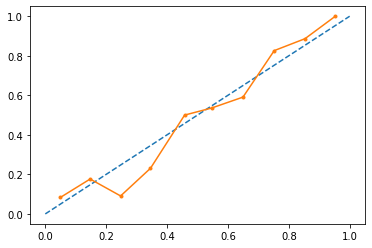

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.80      0.80       152
         1.0       0.80      0.80      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.05, n_estimator :100 max_faetures : 2, max_depth : 4 


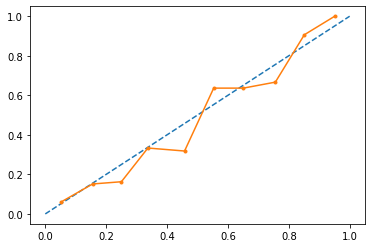

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.83      0.82       152
         1.0       0.83      0.81      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :100 max_faetures : 2, max_depth : 5 


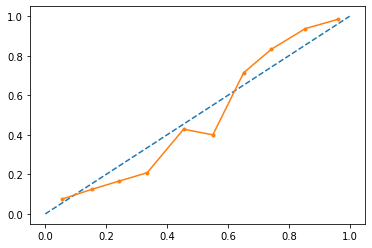

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :100 max_faetures : 3, max_depth : 3 


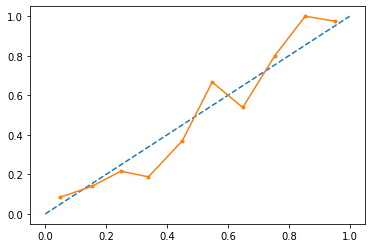

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.05, n_estimator :100 max_faetures : 3, max_depth : 4 


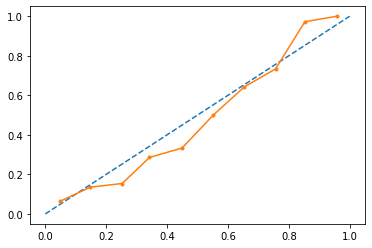

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :100 max_faetures : 3, max_depth : 5 


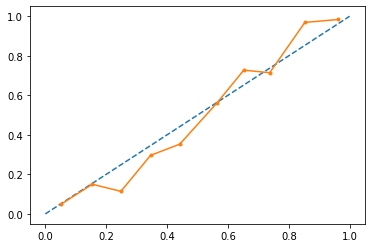

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :100 max_faetures : 4, max_depth : 3 


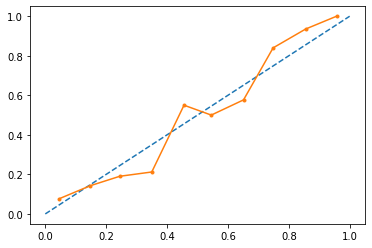

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.81      0.80       152
         1.0       0.80      0.78      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.05, n_estimator :100 max_faetures : 4, max_depth : 4 


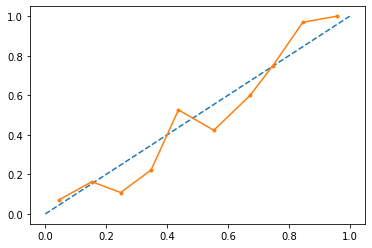

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.82       152
         1.0       0.82      0.81      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :100 max_faetures : 4, max_depth : 5 


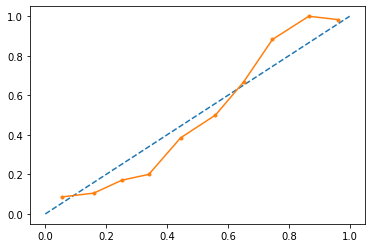

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :100 max_faetures : 5, max_depth : 3 


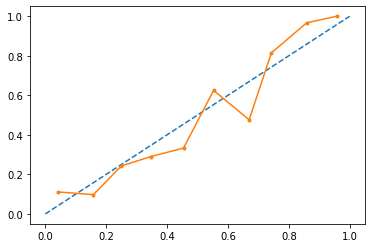

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.82      0.80       152
         1.0       0.81      0.78      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.05, n_estimator :100 max_faetures : 5, max_depth : 4 


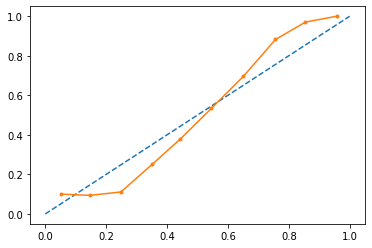

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.89      0.85       152
         1.0       0.88      0.81      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :100 max_faetures : 5, max_depth : 5 


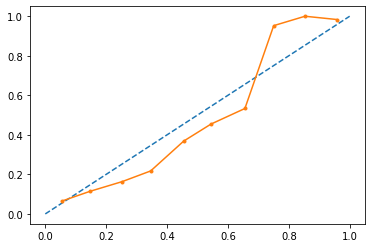

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.83      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :120 max_faetures : 2, max_depth : 3 


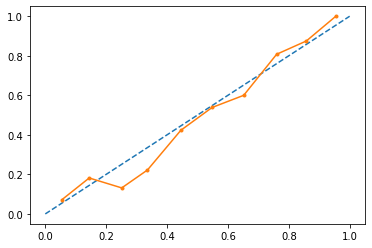

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.80      0.80       152
         1.0       0.80      0.80      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.05, n_estimator :120 max_faetures : 2, max_depth : 4 


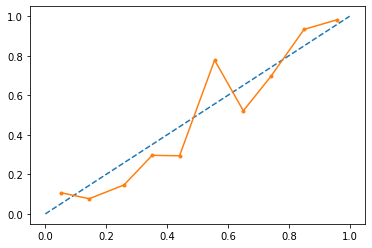

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :120 max_faetures : 2, max_depth : 5 


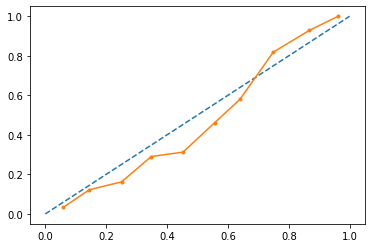

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :120 max_faetures : 3, max_depth : 3 


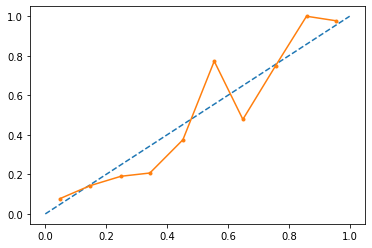

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.83      0.82       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :120 max_faetures : 3, max_depth : 4 


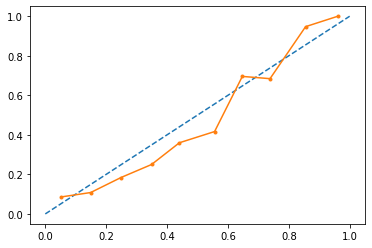

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :120 max_faetures : 3, max_depth : 5 


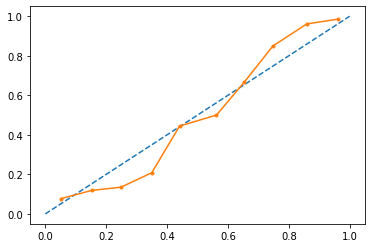

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :120 max_faetures : 4, max_depth : 3 


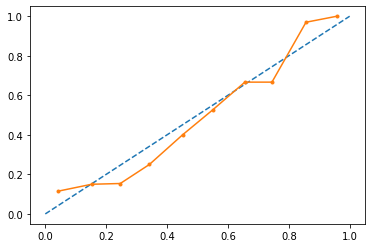

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.82      0.81       152
         1.0       0.81      0.79      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.05, n_estimator :120 max_faetures : 4, max_depth : 4 


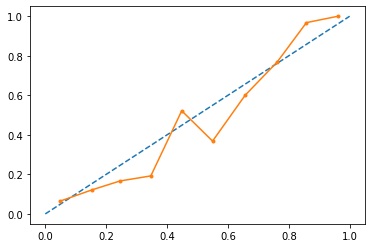

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :120 max_faetures : 4, max_depth : 5 


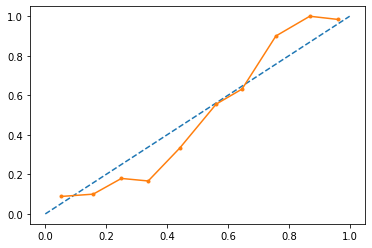

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :120 max_faetures : 5, max_depth : 3 


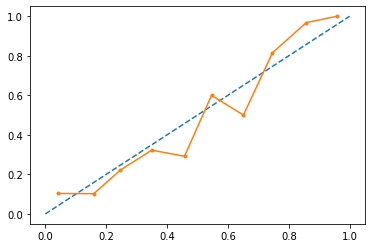

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.83      0.81       152
         1.0       0.82      0.79      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.05, n_estimator :120 max_faetures : 5, max_depth : 4 


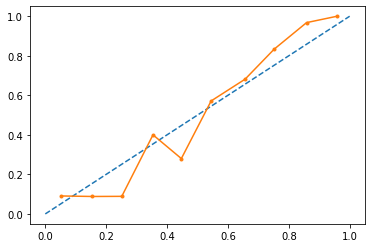

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.86       152
         1.0       0.87      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :120 max_faetures : 5, max_depth : 5 


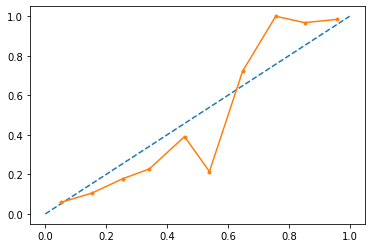

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.86       152
         1.0       0.87      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :150 max_faetures : 2, max_depth : 3 


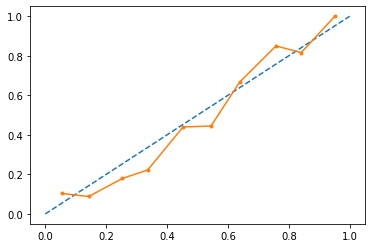

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.81       152
         1.0       0.81      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.05, n_estimator :150 max_faetures : 2, max_depth : 4 


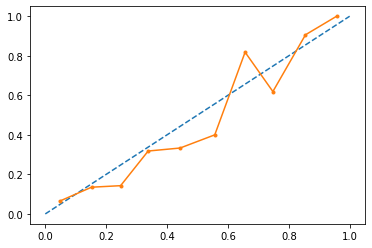

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :150 max_faetures : 2, max_depth : 5 


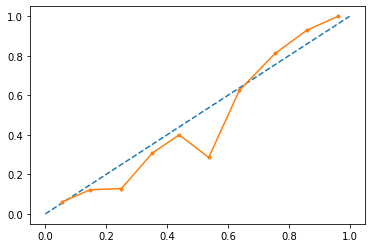

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :150 max_faetures : 3, max_depth : 3 


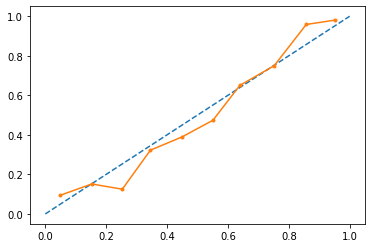

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.81       152
         1.0       0.81      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.05, n_estimator :150 max_faetures : 3, max_depth : 4 


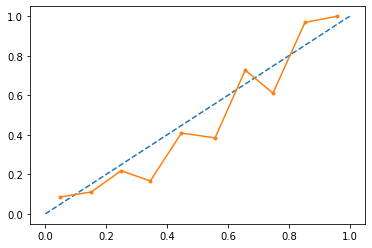

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :150 max_faetures : 3, max_depth : 5 


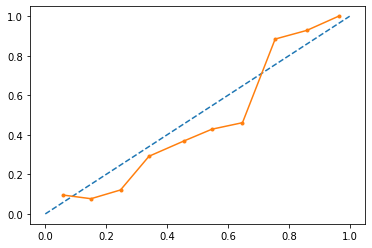

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :150 max_faetures : 4, max_depth : 3 


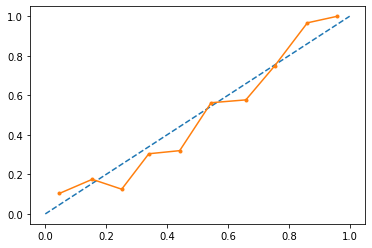

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :150 max_faetures : 4, max_depth : 4 


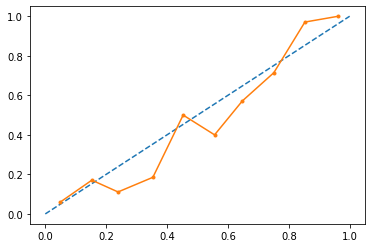

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :150 max_faetures : 4, max_depth : 5 


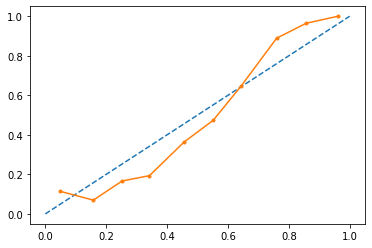

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :150 max_faetures : 5, max_depth : 3 


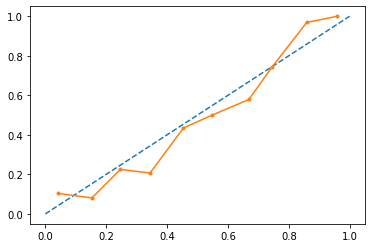

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.81      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :150 max_faetures : 5, max_depth : 4 


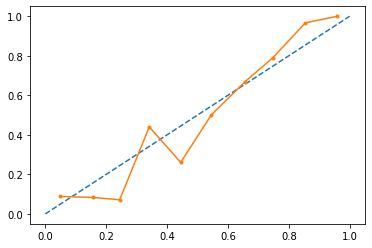

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :150 max_faetures : 5, max_depth : 5 


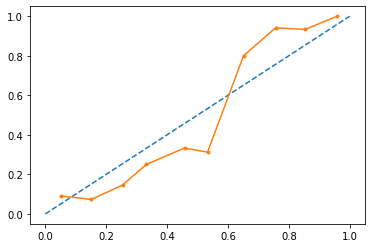

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :180 max_faetures : 2, max_depth : 3 


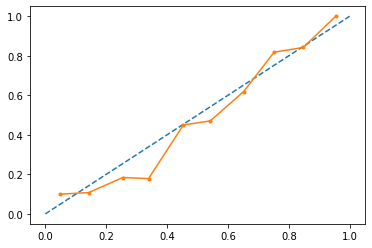

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :180 max_faetures : 2, max_depth : 4 


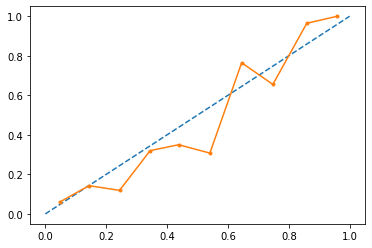

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :180 max_faetures : 2, max_depth : 5 


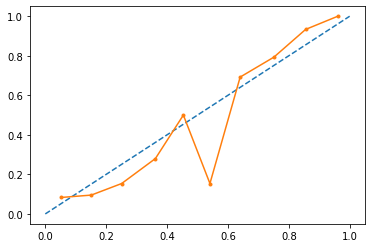

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :180 max_faetures : 3, max_depth : 3 


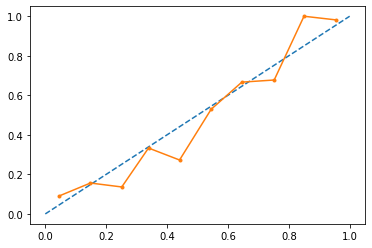

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.83      0.82      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :180 max_faetures : 3, max_depth : 4 


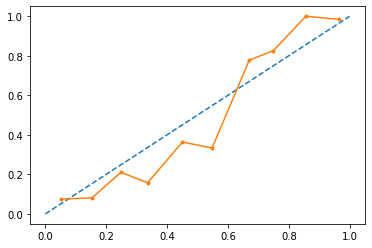

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :180 max_faetures : 3, max_depth : 5 


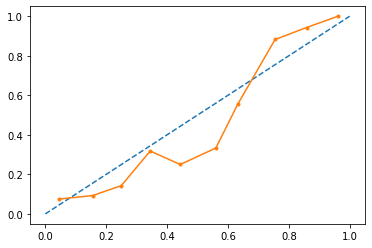

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :180 max_faetures : 4, max_depth : 3 


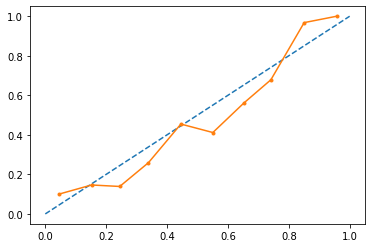

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.05, n_estimator :180 max_faetures : 4, max_depth : 4 


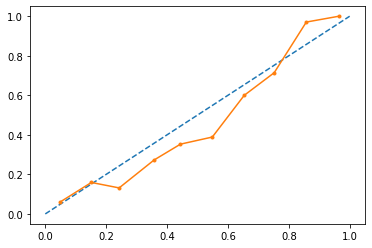

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.84       152
         1.0       0.84      0.83      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :180 max_faetures : 4, max_depth : 5 


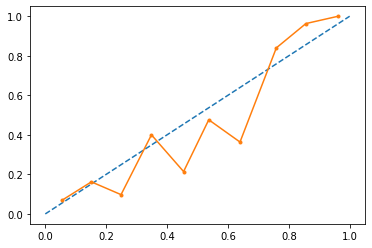

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.85      0.85       152
         1.0       0.85      0.86      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :180 max_faetures : 5, max_depth : 3 


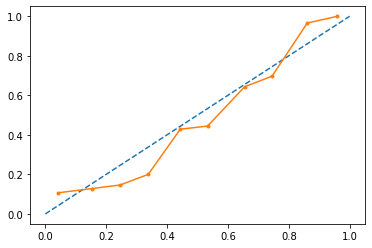

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :180 max_faetures : 5, max_depth : 4 


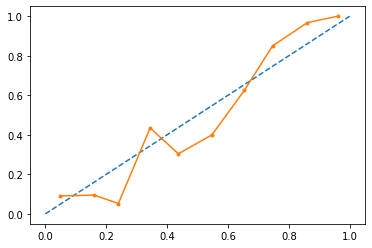

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :180 max_faetures : 5, max_depth : 5 


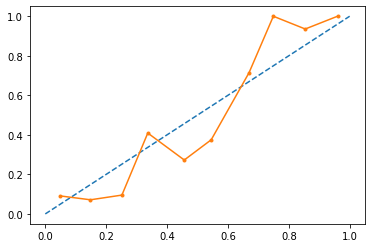

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.89      0.87       152
         1.0       0.89      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.05, n_estimator :200 max_faetures : 2, max_depth : 3 


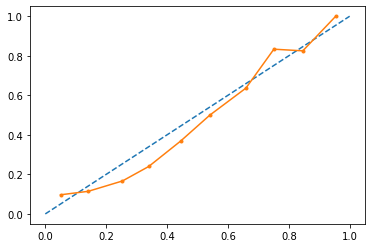

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :200 max_faetures : 2, max_depth : 4 


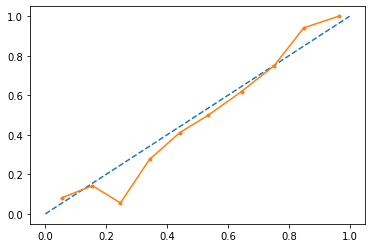

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.84       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :200 max_faetures : 2, max_depth : 5 


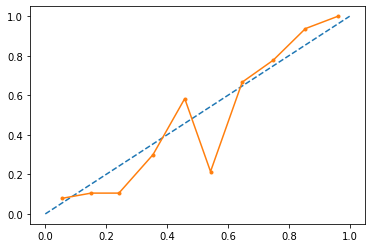

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :200 max_faetures : 3, max_depth : 3 


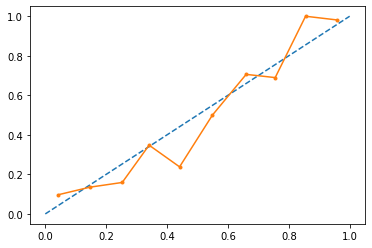

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.83      0.82      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.05, n_estimator :200 max_faetures : 3, max_depth : 4 


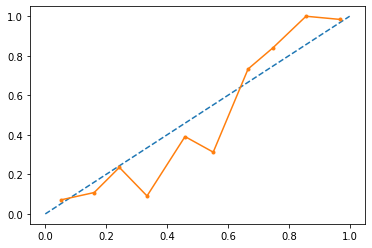

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :200 max_faetures : 3, max_depth : 5 


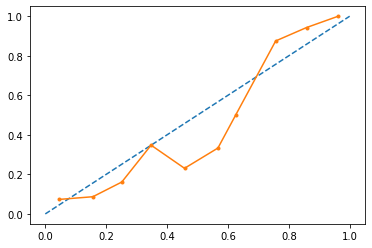

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.05, n_estimator :200 max_faetures : 4, max_depth : 3 


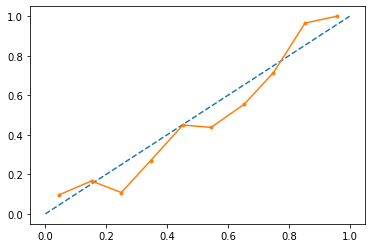

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.83      0.82       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :200 max_faetures : 4, max_depth : 4 


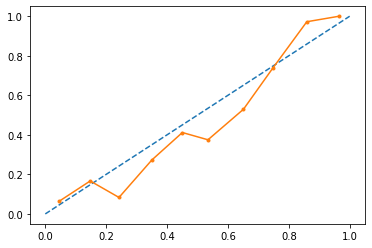

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.84       152
         1.0       0.84      0.83      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.05, n_estimator :200 max_faetures : 4, max_depth : 5 


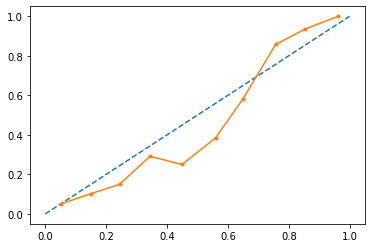

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.86       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :200 max_faetures : 5, max_depth : 3 


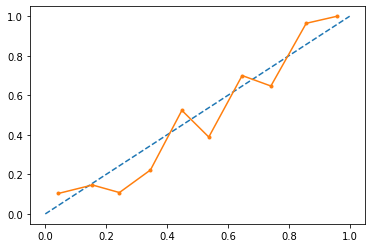

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.82       152
         1.0       0.82      0.81      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.05, n_estimator :200 max_faetures : 5, max_depth : 4 


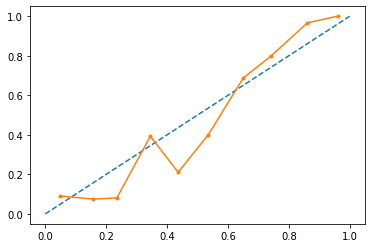

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.05, n_estimator :200 max_faetures : 5, max_depth : 5 


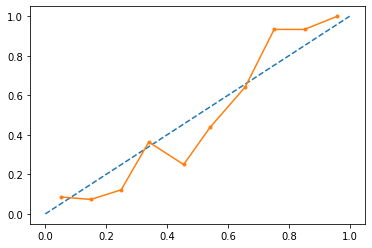

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.89      0.87       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.02, n_estimator :100 max_faetures : 2, max_depth : 3 


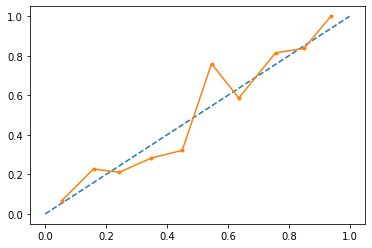

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.79      0.78       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :100 max_faetures : 2, max_depth : 4 


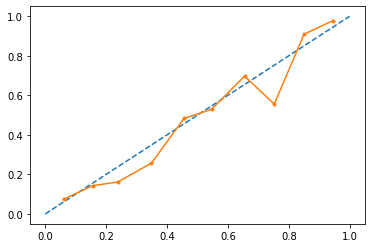

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :100 max_faetures : 2, max_depth : 5 


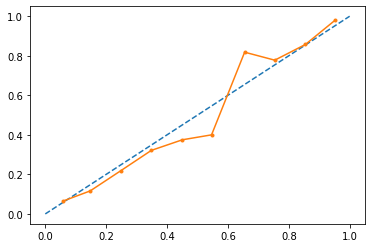

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.83      0.82       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :100 max_faetures : 3, max_depth : 3 


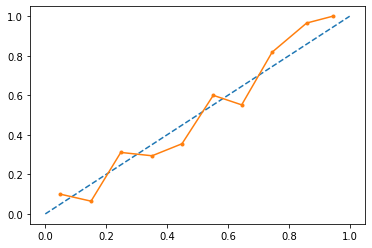

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.79      0.75      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :100 max_faetures : 3, max_depth : 4 


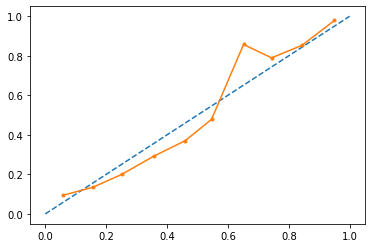

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.84      0.82       152
         1.0       0.83      0.80      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :100 max_faetures : 3, max_depth : 5 


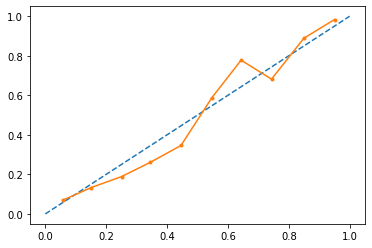

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :100 max_faetures : 4, max_depth : 3 


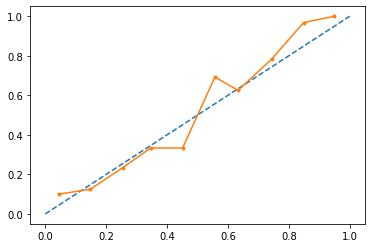

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.79      0.74      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.02, n_estimator :100 max_faetures : 4, max_depth : 4 


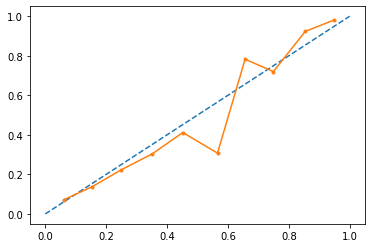

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.84      0.81       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.02, n_estimator :100 max_faetures : 4, max_depth : 5 


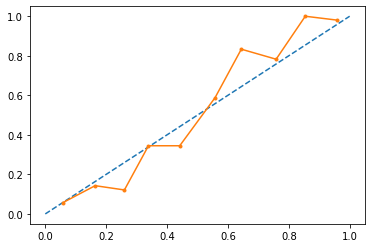

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.89      0.85       152
         1.0       0.88      0.80      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.02, n_estimator :100 max_faetures : 5, max_depth : 3 


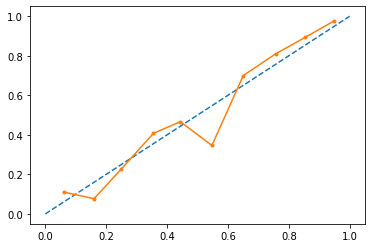

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.02, n_estimator :100 max_faetures : 5, max_depth : 4 


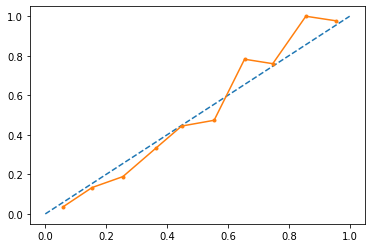

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :100 max_faetures : 5, max_depth : 5 


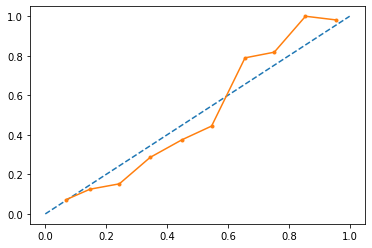

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.88      0.84       152
         1.0       0.86      0.79      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.02, n_estimator :120 max_faetures : 2, max_depth : 3 


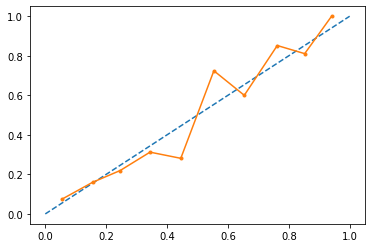

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.80      0.80       152
         1.0       0.80      0.79      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.02, n_estimator :120 max_faetures : 2, max_depth : 4 


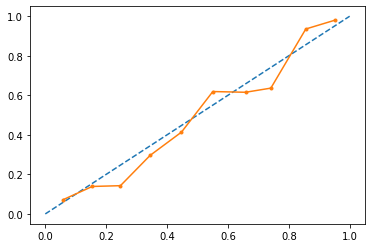

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.80      0.81       152
         1.0       0.80      0.81      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :120 max_faetures : 2, max_depth : 5 


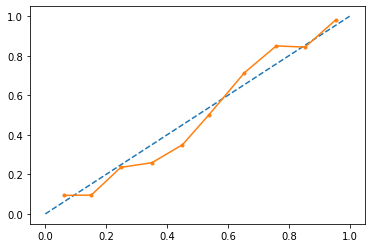

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :120 max_faetures : 3, max_depth : 3 


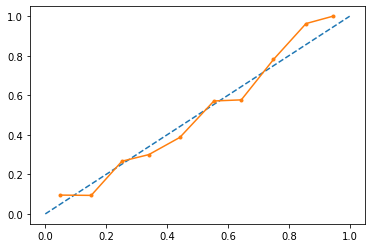

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.79      0.77       152
         1.0       0.78      0.75      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.02, n_estimator :120 max_faetures : 3, max_depth : 4 


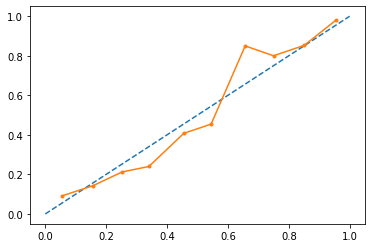

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.83      0.81       152
         1.0       0.82      0.79      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :120 max_faetures : 3, max_depth : 5 


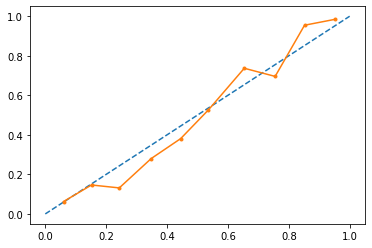

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :120 max_faetures : 4, max_depth : 3 


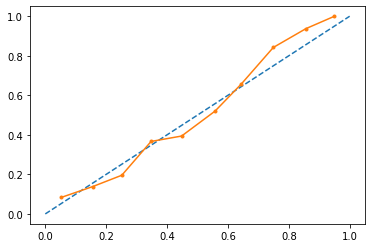

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :120 max_faetures : 4, max_depth : 4 


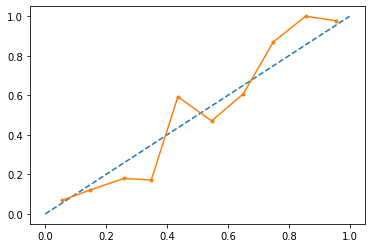

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.81       152
         1.0       0.83      0.77      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :120 max_faetures : 4, max_depth : 5 


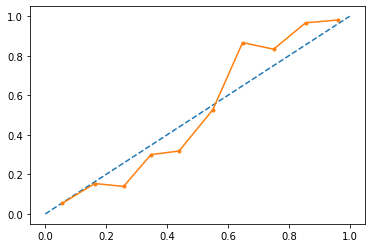

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.02, n_estimator :120 max_faetures : 5, max_depth : 3 


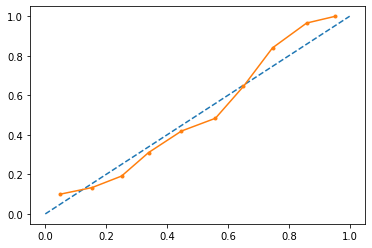

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.79      0.78       152
         1.0       0.78      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :120 max_faetures : 5, max_depth : 4 


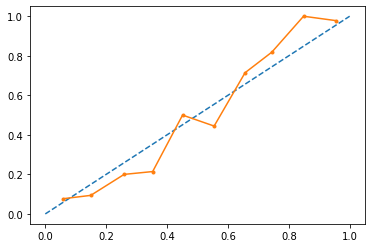

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :120 max_faetures : 5, max_depth : 5 


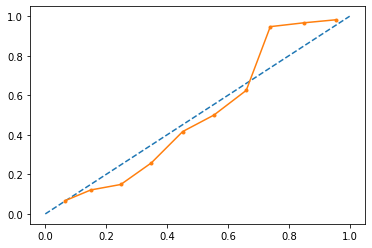

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.88      0.84       152
         1.0       0.86      0.80      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :150 max_faetures : 2, max_depth : 3 


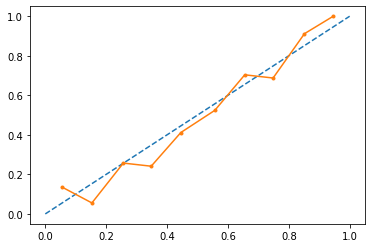

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.79      0.78       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :150 max_faetures : 2, max_depth : 4 


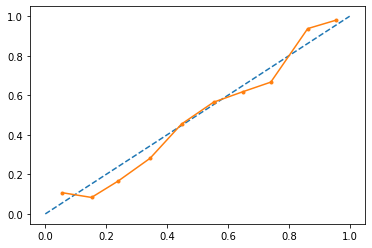

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.81      0.80       152
         1.0       0.81      0.80      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.02, n_estimator :150 max_faetures : 2, max_depth : 5 


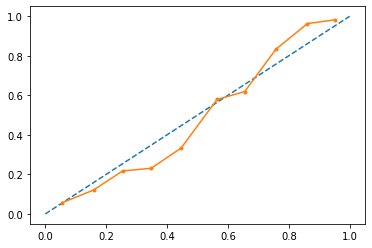

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :150 max_faetures : 3, max_depth : 3 


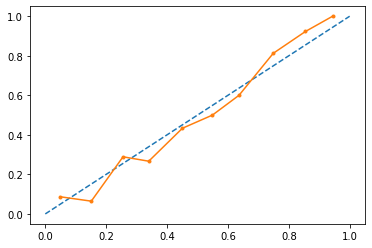

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :150 max_faetures : 3, max_depth : 4 


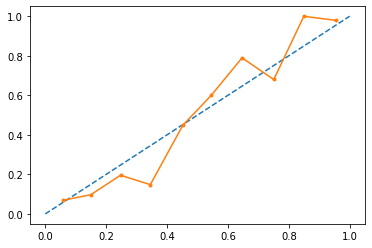

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.80      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :150 max_faetures : 3, max_depth : 5 


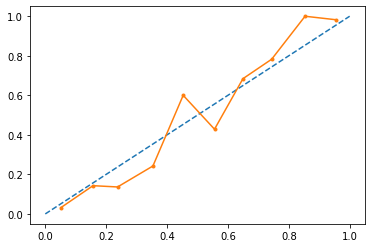

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.87      0.84       152
         1.0       0.86      0.79      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.02, n_estimator :150 max_faetures : 4, max_depth : 3 


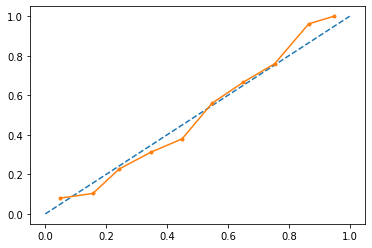

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.80      0.77      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :150 max_faetures : 4, max_depth : 4 


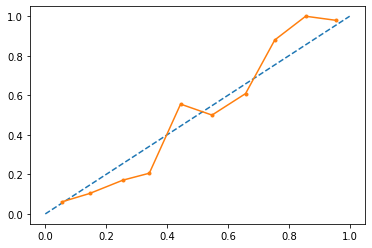

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.85      0.82       152
         1.0       0.84      0.79      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :150 max_faetures : 4, max_depth : 5 


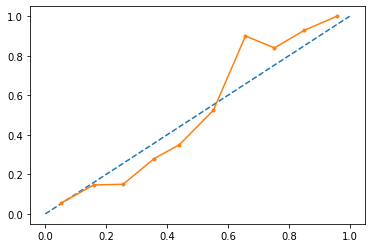

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.89      0.86       152
         1.0       0.88      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.02, n_estimator :150 max_faetures : 5, max_depth : 3 


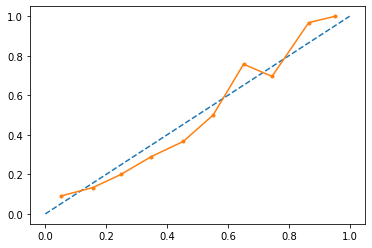

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.02, n_estimator :150 max_faetures : 5, max_depth : 4 


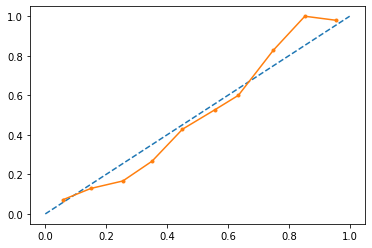

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.85      0.83       152
         1.0       0.84      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :150 max_faetures : 5, max_depth : 5 


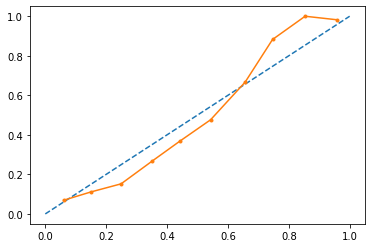

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :180 max_faetures : 2, max_depth : 3 


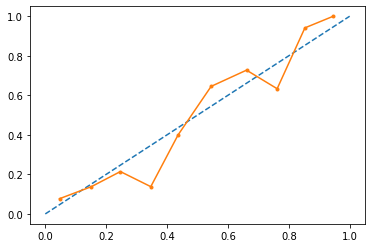

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.80      0.81       152
         1.0       0.80      0.81      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :180 max_faetures : 2, max_depth : 4 


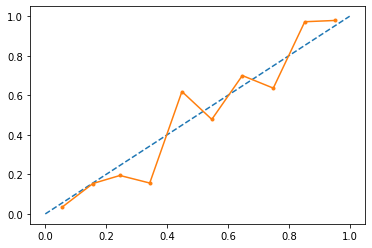

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.81      0.80      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :180 max_faetures : 2, max_depth : 5 


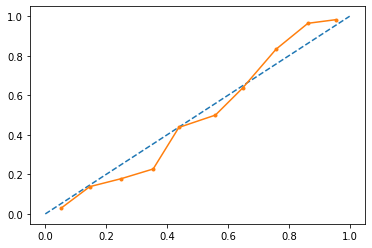

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :180 max_faetures : 3, max_depth : 3 


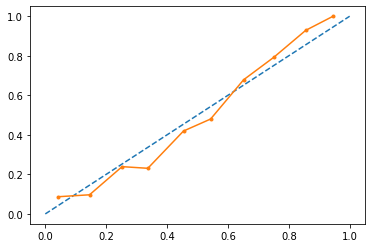

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :180 max_faetures : 3, max_depth : 4 


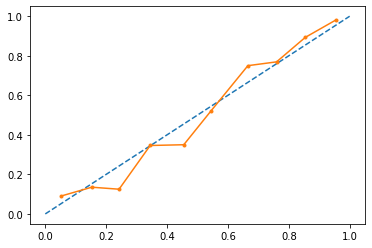

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.83      0.82       152
         1.0       0.83      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :180 max_faetures : 3, max_depth : 5 


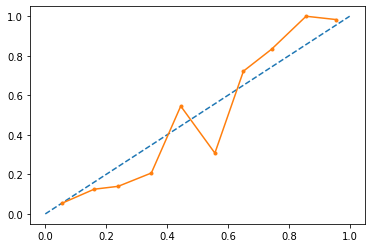

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.84       152
         1.0       0.87      0.80      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :180 max_faetures : 4, max_depth : 3 


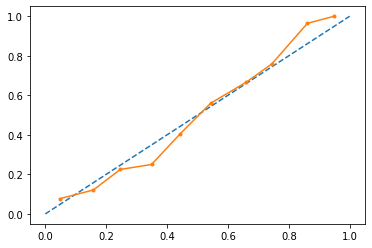

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.82      0.80       152
         1.0       0.81      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :180 max_faetures : 4, max_depth : 4 


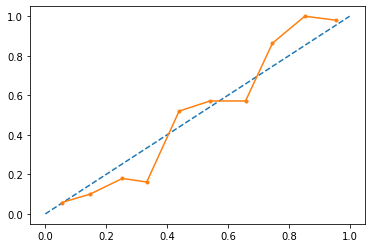

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.02, n_estimator :180 max_faetures : 4, max_depth : 5 


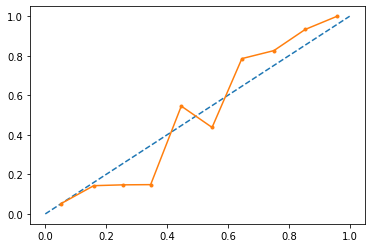

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.02, n_estimator :180 max_faetures : 5, max_depth : 3 


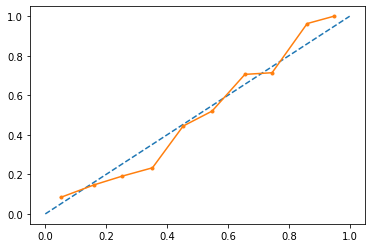

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.80      0.78      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :180 max_faetures : 5, max_depth : 4 


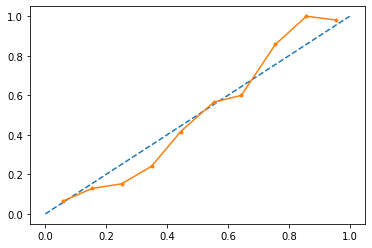

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :180 max_faetures : 5, max_depth : 5 


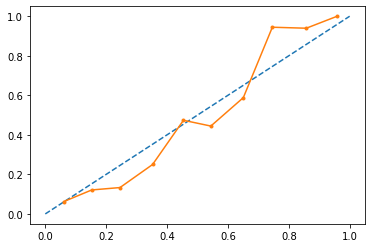

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :200 max_faetures : 2, max_depth : 3 


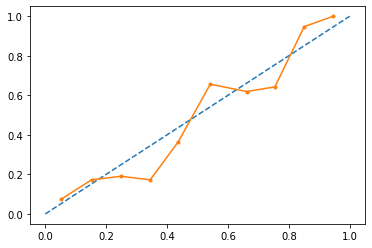

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.80      0.80       152
         1.0       0.80      0.82      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :200 max_faetures : 2, max_depth : 4 


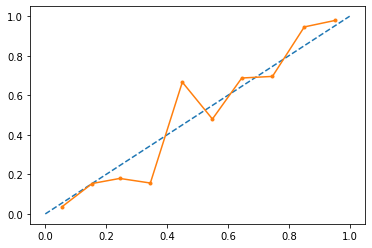

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.81      0.80      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.02, n_estimator :200 max_faetures : 2, max_depth : 5 


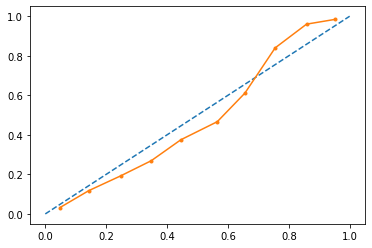

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :200 max_faetures : 3, max_depth : 3 


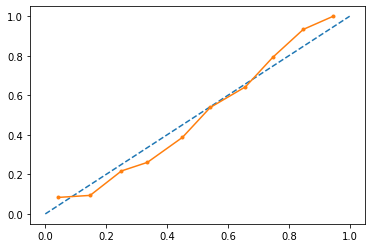

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.80      0.79       152
         1.0       0.80      0.78      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :200 max_faetures : 3, max_depth : 4 


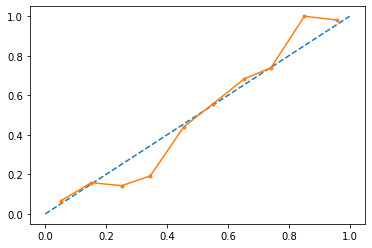

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.86      0.84       152
         1.0       0.85      0.80      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.02, n_estimator :200 max_faetures : 3, max_depth : 5 


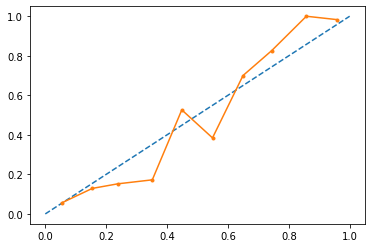

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.02, n_estimator :200 max_faetures : 4, max_depth : 3 


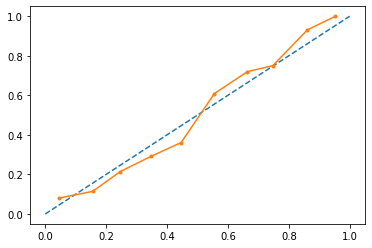

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.83      0.81       152
         1.0       0.82      0.77      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.02, n_estimator :200 max_faetures : 4, max_depth : 4 


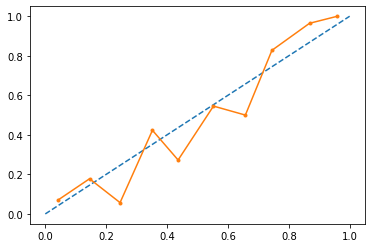

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.81      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.02, n_estimator :200 max_faetures : 4, max_depth : 5 


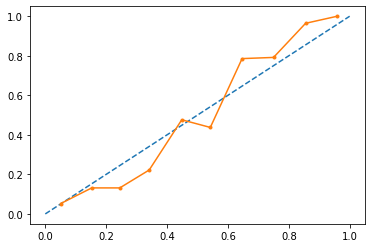

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.02, n_estimator :200 max_faetures : 5, max_depth : 3 


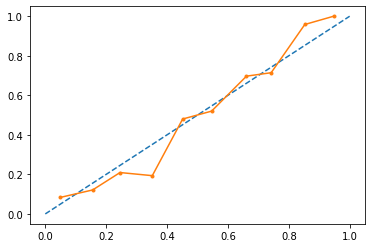

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.80      0.79       152
         1.0       0.80      0.78      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.02, n_estimator :200 max_faetures : 5, max_depth : 4 


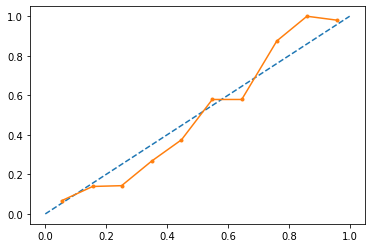

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.86      0.84       152
         1.0       0.85      0.80      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.02, n_estimator :200 max_faetures : 5, max_depth : 5 


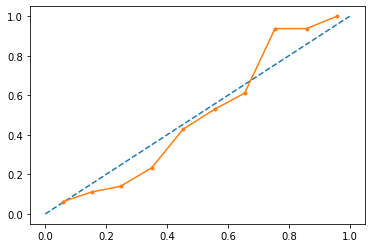

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.01, n_estimator :100 max_faetures : 2, max_depth : 3 


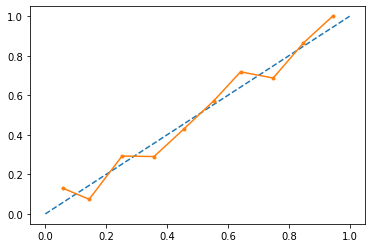

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.74      0.75       152
         1.0       0.75      0.76      0.76       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.01, n_estimator :100 max_faetures : 2, max_depth : 4 


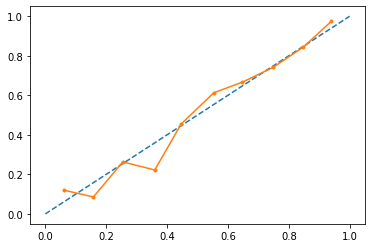

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.79      0.78       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :100 max_faetures : 2, max_depth : 5 


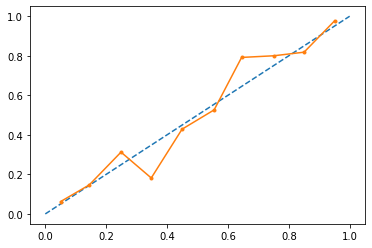

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.81      0.80      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :100 max_faetures : 3, max_depth : 3 


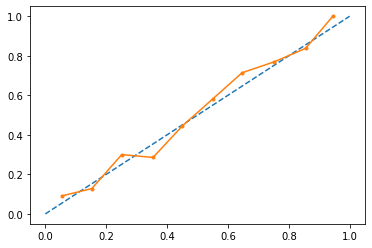

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.76      0.76       152
         1.0       0.76      0.76      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.01, n_estimator :100 max_faetures : 3, max_depth : 4 


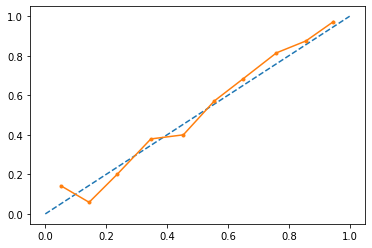

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.78       152
         1.0       0.78      0.76      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :100 max_faetures : 3, max_depth : 5 


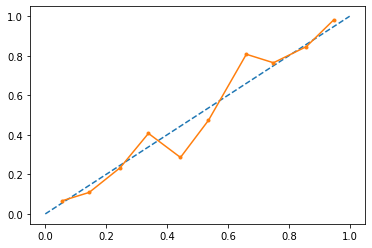

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :100 max_faetures : 4, max_depth : 3 


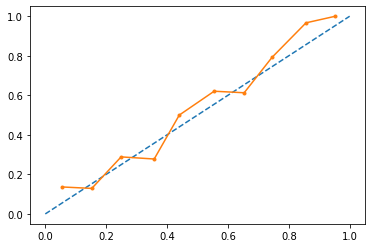

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.81      0.77       152
         1.0       0.79      0.71      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.01, n_estimator :100 max_faetures : 4, max_depth : 4 


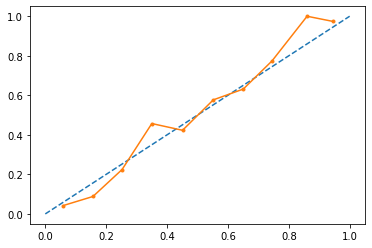

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.82      0.79       152
         1.0       0.80      0.75      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :100 max_faetures : 4, max_depth : 5 


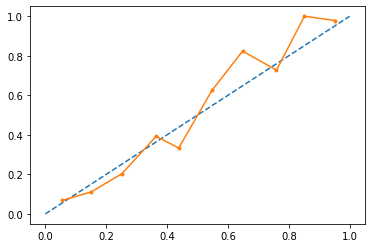

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.88      0.83       152
         1.0       0.86      0.77      0.81       152

    accuracy                           0.82       304
   macro avg       0.83      0.82      0.82       304
weighted avg       0.83      0.82      0.82       304

learning rate: 0.01, n_estimator :100 max_faetures : 5, max_depth : 3 


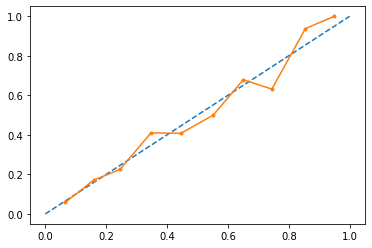

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.01, n_estimator :100 max_faetures : 5, max_depth : 4 


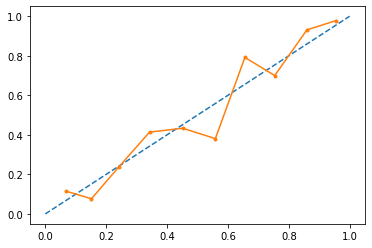

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.80      0.78       152
         1.0       0.79      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :100 max_faetures : 5, max_depth : 5 


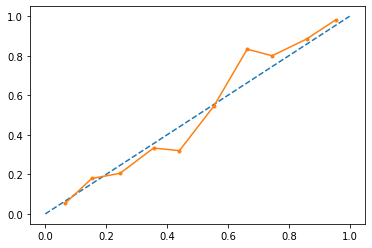

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.88      0.83       152
         1.0       0.86      0.78      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.01, n_estimator :120 max_faetures : 2, max_depth : 3 


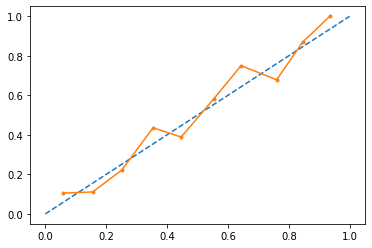

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.77      0.72      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.01, n_estimator :120 max_faetures : 2, max_depth : 4 


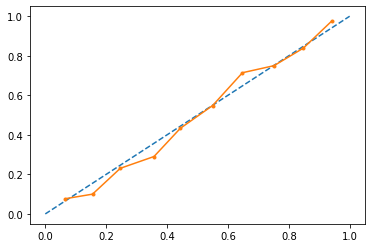

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.78      0.78       152
         1.0       0.78      0.78      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :120 max_faetures : 2, max_depth : 5 


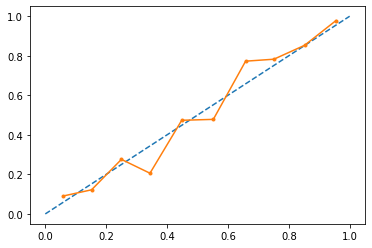

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.81      0.81       152
         1.0       0.81      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :120 max_faetures : 3, max_depth : 3 


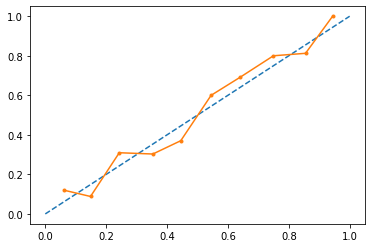

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.76      0.76       152
         1.0       0.76      0.75      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.01, n_estimator :120 max_faetures : 3, max_depth : 4 


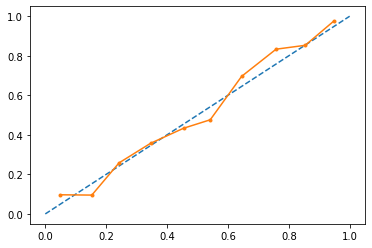

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.79      0.78       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :120 max_faetures : 3, max_depth : 5 


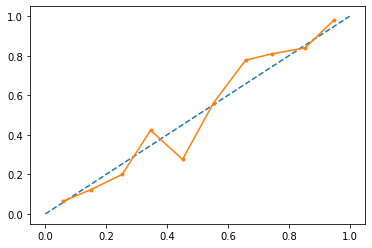

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.85      0.82       152
         1.0       0.84      0.78      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :120 max_faetures : 4, max_depth : 3 


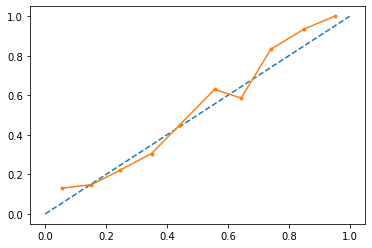

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.80      0.77       152
         1.0       0.78      0.72      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.01, n_estimator :120 max_faetures : 4, max_depth : 4 


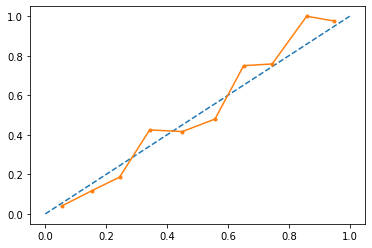

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.81      0.75      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.01, n_estimator :120 max_faetures : 4, max_depth : 5 


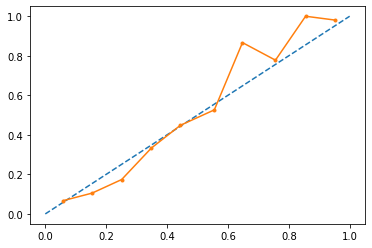

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.87      0.83       152
         1.0       0.85      0.77      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :120 max_faetures : 5, max_depth : 3 


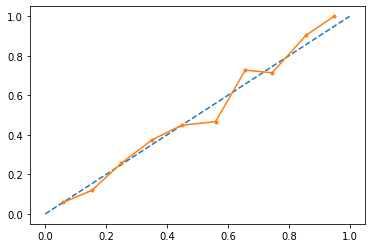

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.01, n_estimator :120 max_faetures : 5, max_depth : 4 


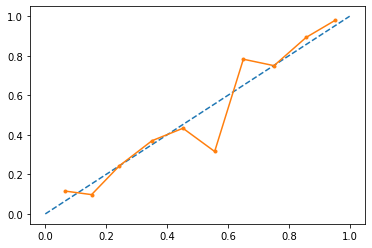

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.81      0.79       152
         1.0       0.80      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :120 max_faetures : 5, max_depth : 5 


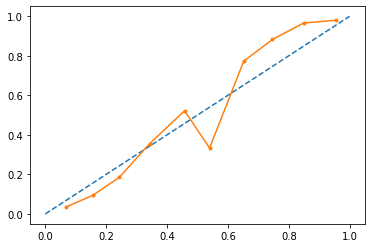

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :150 max_faetures : 2, max_depth : 3 


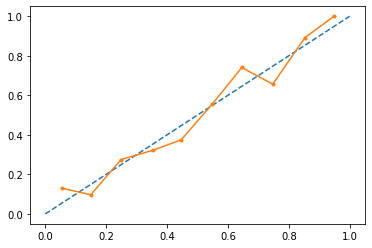

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.76      0.77       152
         1.0       0.76      0.77      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :150 max_faetures : 2, max_depth : 4 


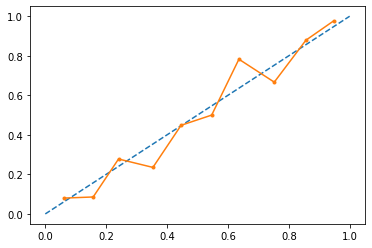

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.79       152
         1.0       0.79      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :150 max_faetures : 2, max_depth : 5 


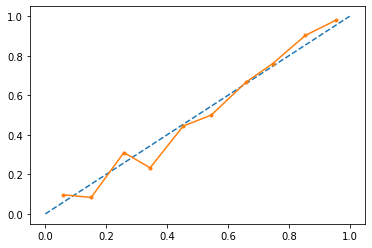

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.82       152
         1.0       0.82      0.81      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :150 max_faetures : 3, max_depth : 3 


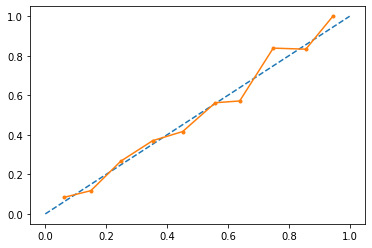

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.78      0.77       152
         1.0       0.78      0.75      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :150 max_faetures : 3, max_depth : 4 


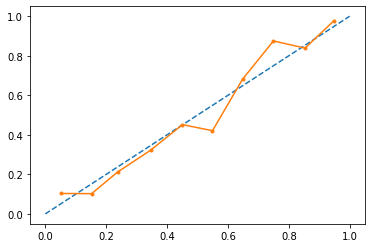

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.79      0.78       152
         1.0       0.78      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :150 max_faetures : 3, max_depth : 5 


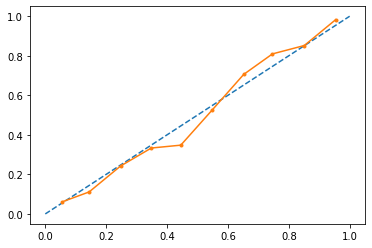

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.84      0.82       152
         1.0       0.83      0.80      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :150 max_faetures : 4, max_depth : 3 


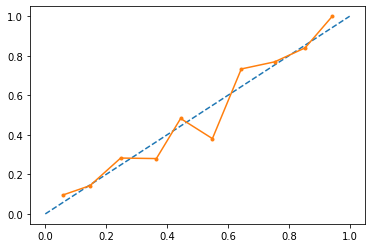

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.78      0.76       152
         1.0       0.77      0.74      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.01, n_estimator :150 max_faetures : 4, max_depth : 4 


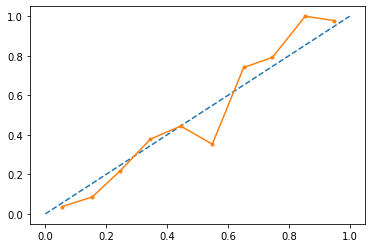

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.81       152
         1.0       0.83      0.75      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.01, n_estimator :150 max_faetures : 4, max_depth : 5 


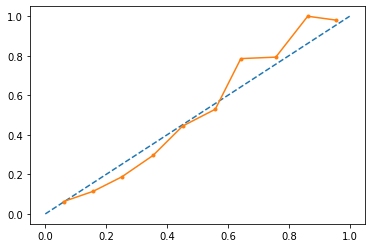

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.88      0.84       152
         1.0       0.87      0.78      0.82       152

    accuracy                           0.83       304
   macro avg       0.84      0.83      0.83       304
weighted avg       0.84      0.83      0.83       304

learning rate: 0.01, n_estimator :150 max_faetures : 5, max_depth : 3 


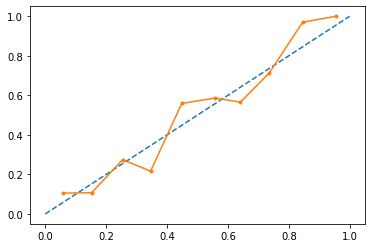

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.80      0.77       152
         1.0       0.78      0.72      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.01, n_estimator :150 max_faetures : 5, max_depth : 4 


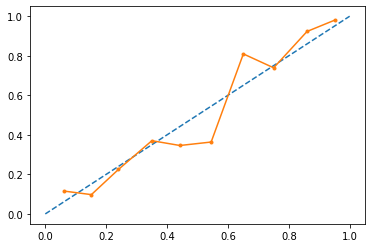

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.82      0.80       152
         1.0       0.81      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.01, n_estimator :150 max_faetures : 5, max_depth : 5 


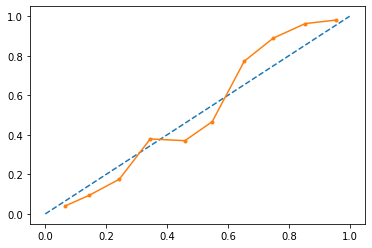

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.88      0.83       152
         1.0       0.86      0.77      0.81       152

    accuracy                           0.82       304
   macro avg       0.83      0.82      0.82       304
weighted avg       0.83      0.82      0.82       304

learning rate: 0.01, n_estimator :180 max_faetures : 2, max_depth : 3 


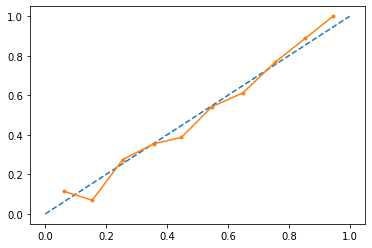

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.78      0.77       152
         1.0       0.77      0.76      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :180 max_faetures : 2, max_depth : 4 


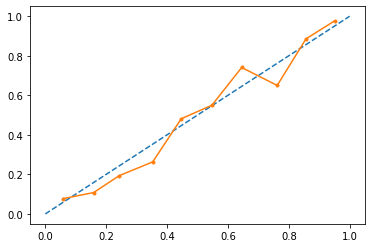

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.81      0.80       152
         1.0       0.80      0.78      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.01, n_estimator :180 max_faetures : 2, max_depth : 5 


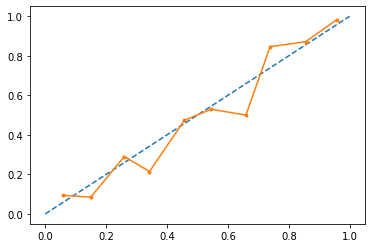

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.82       152
         1.0       0.82      0.81      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :180 max_faetures : 3, max_depth : 3 


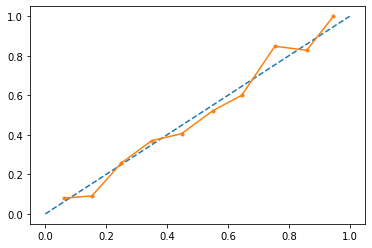

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.77       152
         1.0       0.77      0.76      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :180 max_faetures : 3, max_depth : 4 


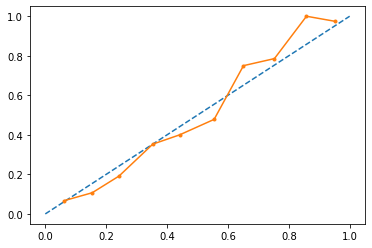

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.84      0.81       152
         1.0       0.83      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.01, n_estimator :180 max_faetures : 3, max_depth : 5 


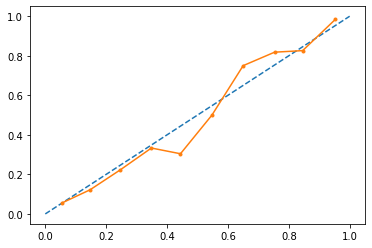

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.83       152
         1.0       0.84      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.01, n_estimator :180 max_faetures : 4, max_depth : 3 


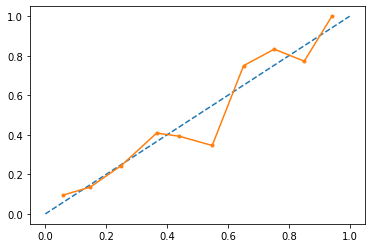

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.78      0.77       152
         1.0       0.77      0.76      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :180 max_faetures : 4, max_depth : 4 


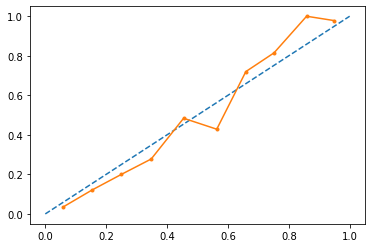

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :180 max_faetures : 4, max_depth : 5 


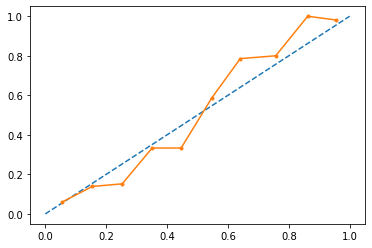

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.80      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.01, n_estimator :180 max_faetures : 5, max_depth : 3 


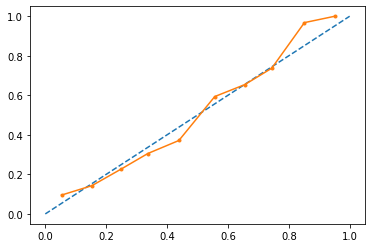

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.80      0.78       152
         1.0       0.79      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :180 max_faetures : 5, max_depth : 4 


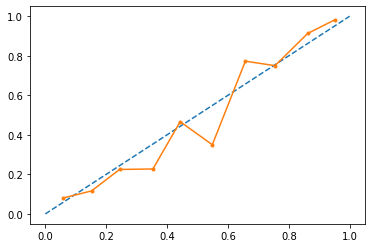

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.82      0.80       152
         1.0       0.81      0.78      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.01, n_estimator :180 max_faetures : 5, max_depth : 5 


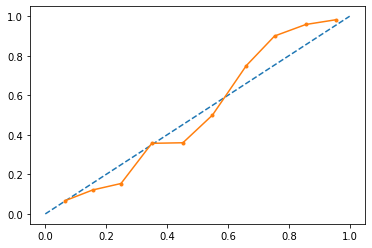

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.89      0.84       152
         1.0       0.88      0.78      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.01, n_estimator :200 max_faetures : 2, max_depth : 3 


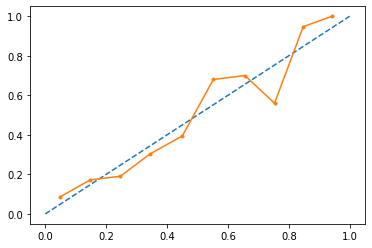

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :200 max_faetures : 2, max_depth : 4 


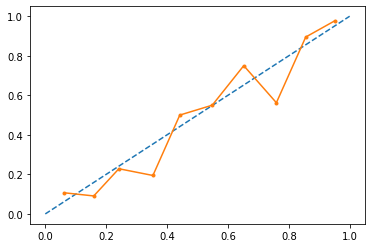

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.81      0.80       152
         1.0       0.80      0.78      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.01, n_estimator :200 max_faetures : 2, max_depth : 5 


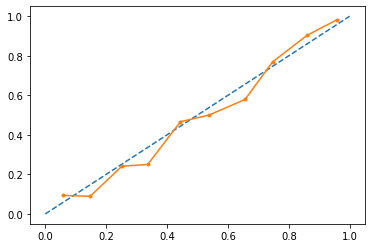

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.81       152
         1.0       0.81      0.81      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :200 max_faetures : 3, max_depth : 3 


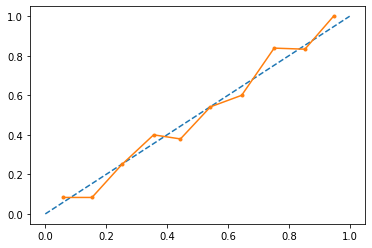

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.78       152
         1.0       0.78      0.76      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :200 max_faetures : 3, max_depth : 4 


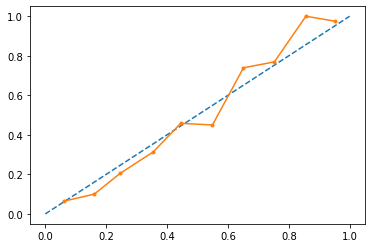

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.82       152
         1.0       0.83      0.78      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :200 max_faetures : 3, max_depth : 5 


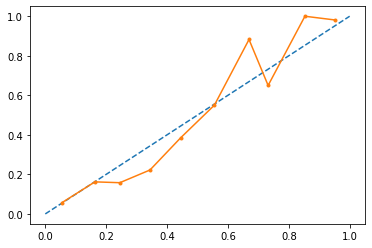

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.01, n_estimator :200 max_faetures : 4, max_depth : 3 


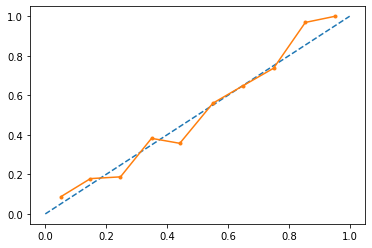

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.79      0.75      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.01, n_estimator :200 max_faetures : 4, max_depth : 4 


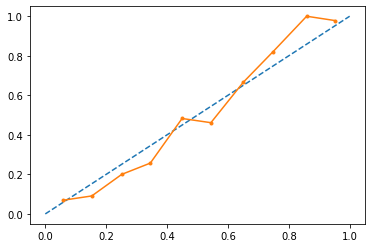

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.86      0.82       152
         1.0       0.84      0.77      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :200 max_faetures : 4, max_depth : 5 


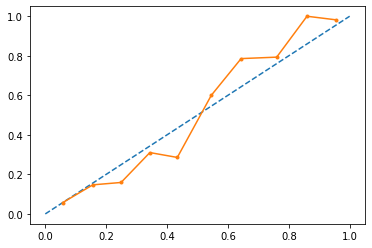

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.01, n_estimator :200 max_faetures : 5, max_depth : 3 


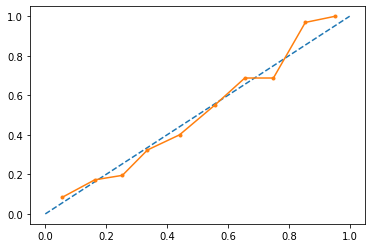

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.79      0.74      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.01, n_estimator :200 max_faetures : 5, max_depth : 4 


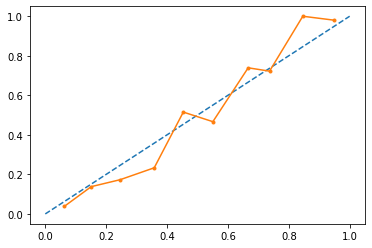

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.75      0.79       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.01, n_estimator :200 max_faetures : 5, max_depth : 5 


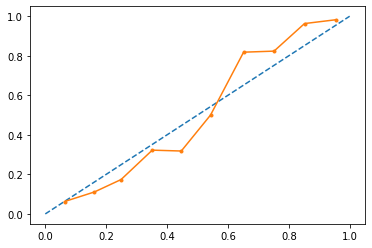

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.89      0.85       152
         1.0       0.88      0.80      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.008, n_estimator :100 max_faetures : 2, max_depth : 3 


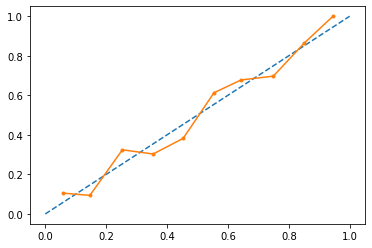

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.75      0.75       152
         1.0       0.75      0.76      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :100 max_faetures : 2, max_depth : 4 


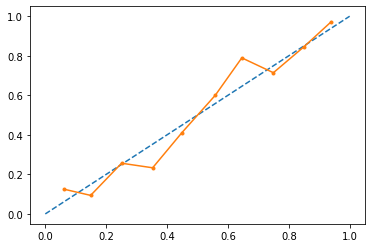

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.008, n_estimator :100 max_faetures : 2, max_depth : 5 


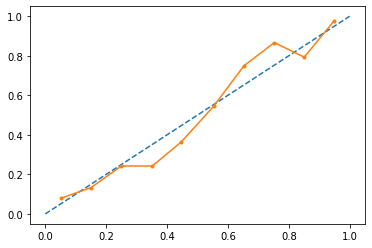

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.83      0.82       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :100 max_faetures : 3, max_depth : 3 


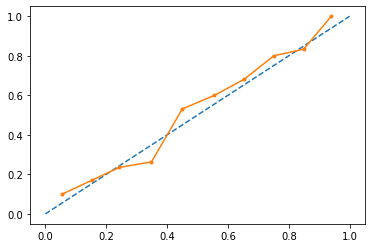

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :100 max_faetures : 3, max_depth : 4 


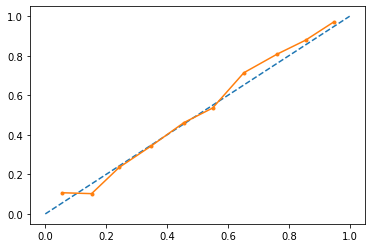

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.78       152
         1.0       0.78      0.77      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.008, n_estimator :100 max_faetures : 3, max_depth : 5 


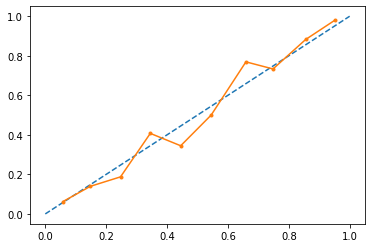

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.81       152
         1.0       0.83      0.78      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :100 max_faetures : 4, max_depth : 3 


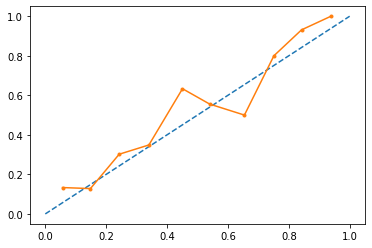

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       152
         1.0       0.75      0.67      0.71       152

    accuracy                           0.72       304
   macro avg       0.73      0.72      0.72       304
weighted avg       0.73      0.72      0.72       304

learning rate: 0.008, n_estimator :100 max_faetures : 4, max_depth : 4 


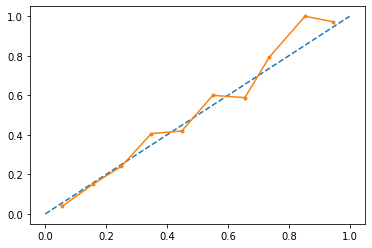

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.83      0.79       152
         1.0       0.81      0.74      0.77       152

    accuracy                           0.78       304
   macro avg       0.79      0.78      0.78       304
weighted avg       0.79      0.78      0.78       304

learning rate: 0.008, n_estimator :100 max_faetures : 4, max_depth : 5 


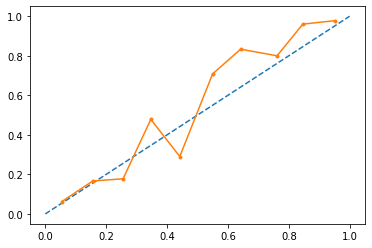

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.87      0.82       152
         1.0       0.85      0.76      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.008, n_estimator :100 max_faetures : 5, max_depth : 3 


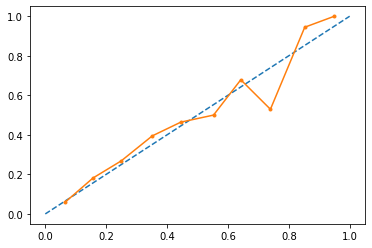

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.78      0.75       152
         1.0       0.76      0.71      0.73       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.008, n_estimator :100 max_faetures : 5, max_depth : 4 


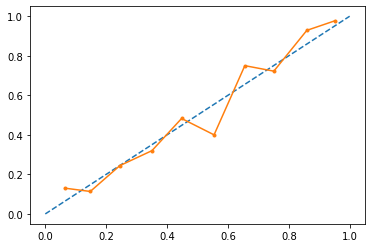

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.78      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.008, n_estimator :100 max_faetures : 5, max_depth : 5 


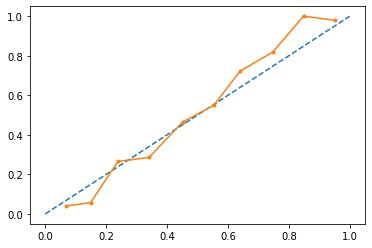

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.75      0.79       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :120 max_faetures : 2, max_depth : 3 


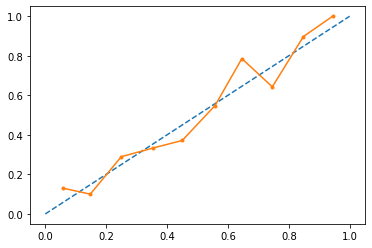

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.76      0.76       152
         1.0       0.76      0.76      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :120 max_faetures : 2, max_depth : 4 


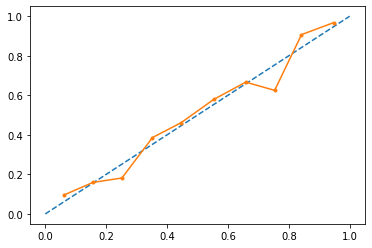

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.80      0.77       152
         1.0       0.79      0.72      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :120 max_faetures : 2, max_depth : 5 


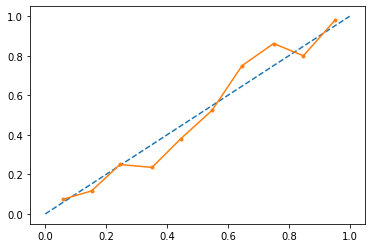

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :120 max_faetures : 3, max_depth : 3 


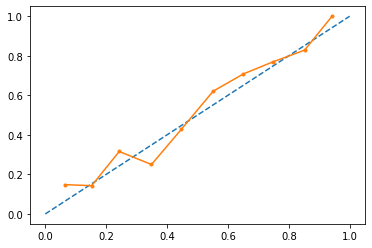

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :120 max_faetures : 3, max_depth : 4 


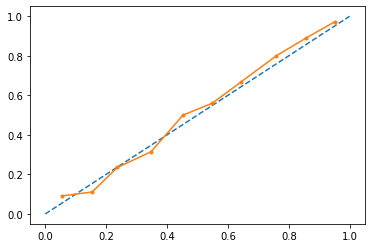

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.81      0.79       152
         1.0       0.80      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :120 max_faetures : 3, max_depth : 5 


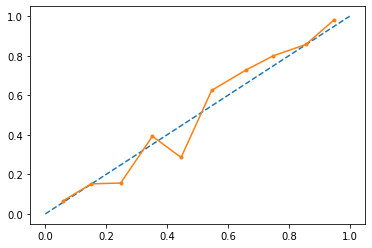

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.85      0.82       152
         1.0       0.84      0.78      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.008, n_estimator :120 max_faetures : 4, max_depth : 3 


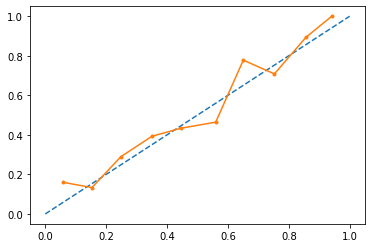

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.76      0.75       152
         1.0       0.75      0.72      0.73       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.008, n_estimator :120 max_faetures : 4, max_depth : 4 


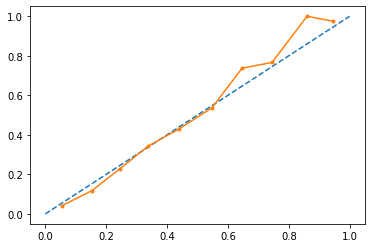

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.82      0.79       152
         1.0       0.81      0.75      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :120 max_faetures : 4, max_depth : 5 


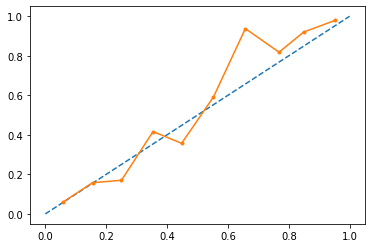

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.87      0.83       152
         1.0       0.86      0.78      0.81       152

    accuracy                           0.82       304
   macro avg       0.83      0.82      0.82       304
weighted avg       0.83      0.82      0.82       304

learning rate: 0.008, n_estimator :120 max_faetures : 5, max_depth : 3 


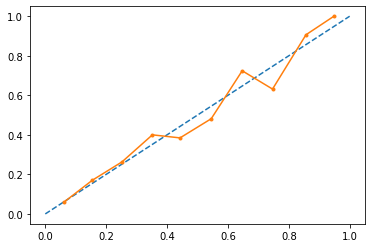

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.77      0.73      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :120 max_faetures : 5, max_depth : 4 


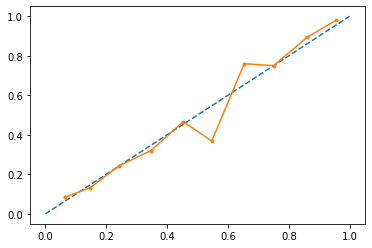

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.80      0.77       152
         1.0       0.78      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.008, n_estimator :120 max_faetures : 5, max_depth : 5 


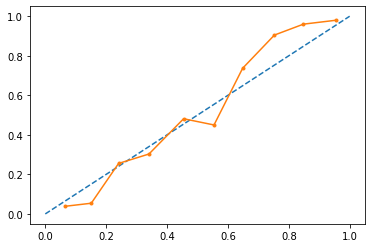

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.84      0.81       152
         1.0       0.83      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.008, n_estimator :150 max_faetures : 2, max_depth : 3 


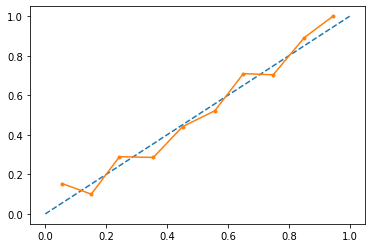

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.75      0.74      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :150 max_faetures : 2, max_depth : 4 


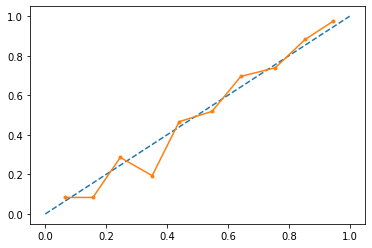

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :150 max_faetures : 2, max_depth : 5 


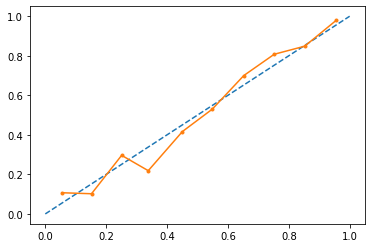

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.83      0.82       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :150 max_faetures : 3, max_depth : 3 


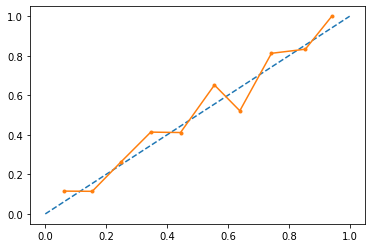

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.79      0.77       152
         1.0       0.78      0.74      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :150 max_faetures : 3, max_depth : 4 


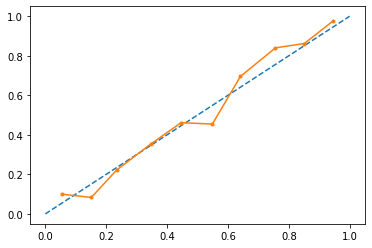

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.008, n_estimator :150 max_faetures : 3, max_depth : 5 


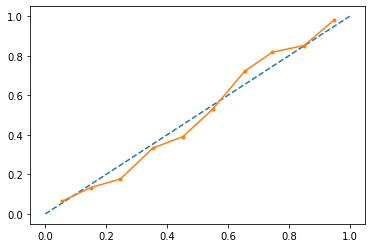

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.84      0.82       152
         1.0       0.83      0.79      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.008, n_estimator :150 max_faetures : 4, max_depth : 3 


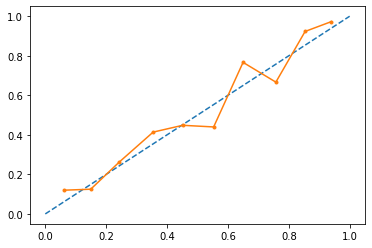

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.77      0.73      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :150 max_faetures : 4, max_depth : 4 


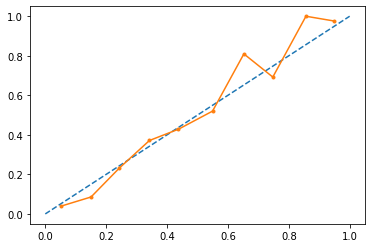

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.82      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :150 max_faetures : 4, max_depth : 5 


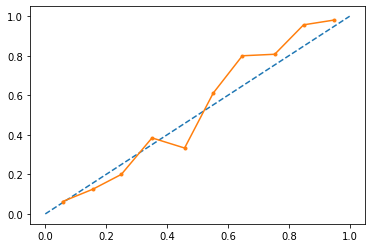

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.87      0.84       152
         1.0       0.86      0.80      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.008, n_estimator :150 max_faetures : 5, max_depth : 3 


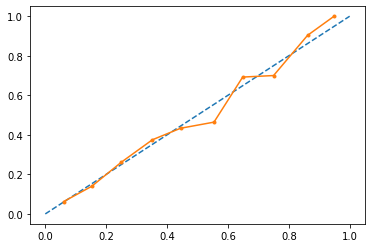

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.77      0.73      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :150 max_faetures : 5, max_depth : 4 


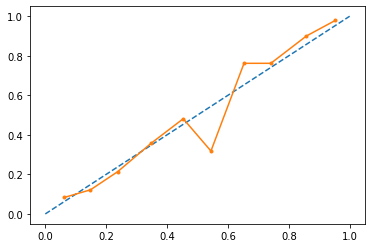

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.008, n_estimator :150 max_faetures : 5, max_depth : 5 


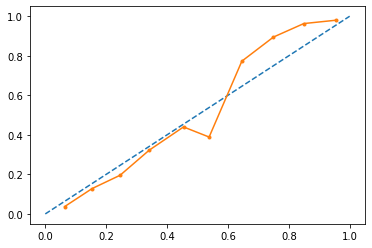

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.85      0.81       152
         1.0       0.83      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :180 max_faetures : 2, max_depth : 3 


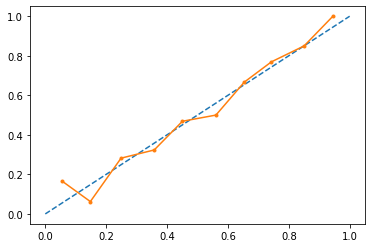

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :180 max_faetures : 2, max_depth : 4 


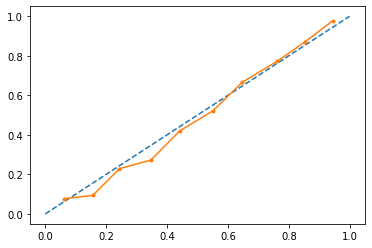

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.80      0.77      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :180 max_faetures : 2, max_depth : 5 


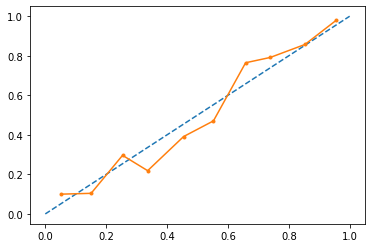

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.81      0.80      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :180 max_faetures : 3, max_depth : 3 


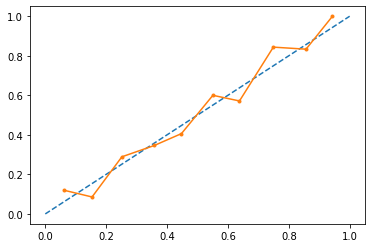

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :180 max_faetures : 3, max_depth : 4 


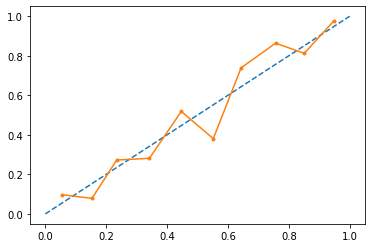

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.008, n_estimator :180 max_faetures : 3, max_depth : 5 


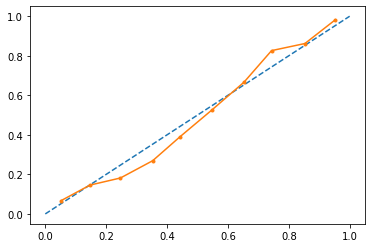

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.83       152
         1.0       0.84      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.008, n_estimator :180 max_faetures : 4, max_depth : 3 


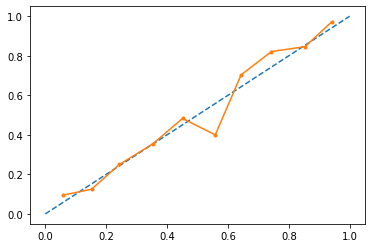

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :180 max_faetures : 4, max_depth : 4 


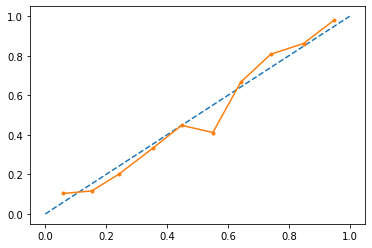

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.83      0.80       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.008, n_estimator :180 max_faetures : 4, max_depth : 5 


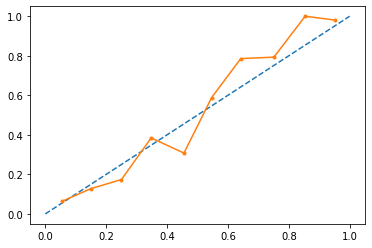

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.89      0.85       152
         1.0       0.88      0.80      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.008, n_estimator :180 max_faetures : 5, max_depth : 3 


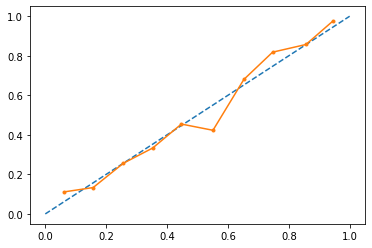

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :180 max_faetures : 5, max_depth : 4 


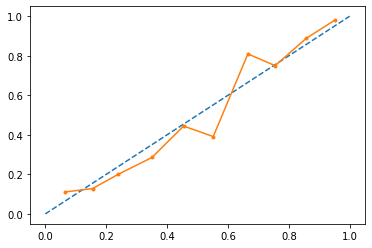

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.82      0.80       152
         1.0       0.81      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :180 max_faetures : 5, max_depth : 5 


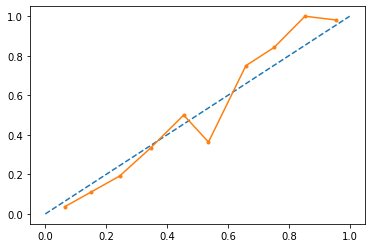

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.85      0.82       152
         1.0       0.84      0.77      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :200 max_faetures : 2, max_depth : 3 


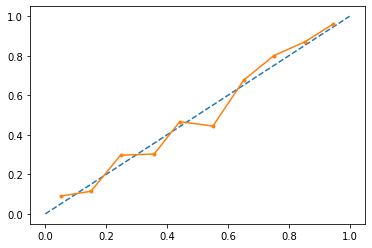

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.76      0.76       152
         1.0       0.76      0.75      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :200 max_faetures : 2, max_depth : 4 


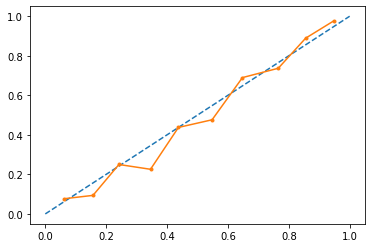

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.008, n_estimator :200 max_faetures : 2, max_depth : 5 


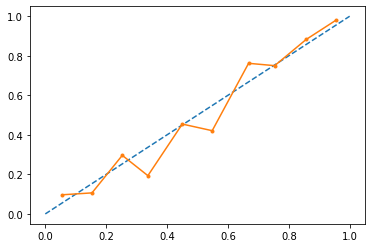

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.82      0.79      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.008, n_estimator :200 max_faetures : 3, max_depth : 3 


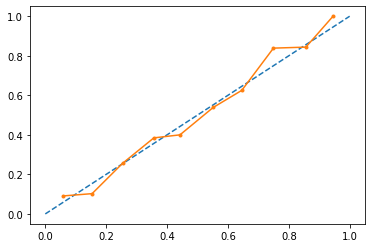

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.78      0.77       152
         1.0       0.77      0.75      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.008, n_estimator :200 max_faetures : 3, max_depth : 4 


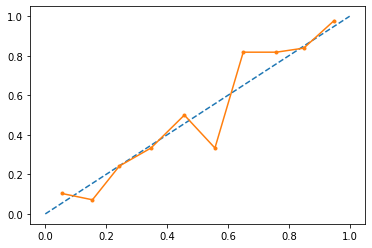

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.79      0.78       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.008, n_estimator :200 max_faetures : 3, max_depth : 5 


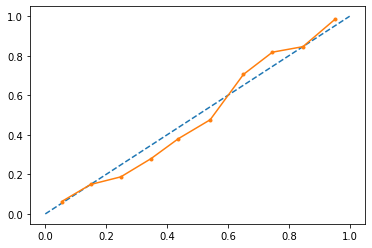

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.84      0.82       152
         1.0       0.83      0.80      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.008, n_estimator :200 max_faetures : 4, max_depth : 3 


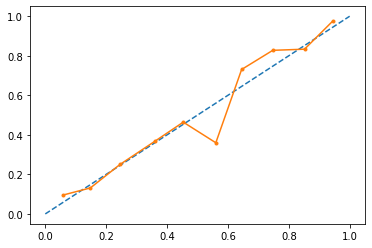

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.76      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.008, n_estimator :200 max_faetures : 4, max_depth : 4 


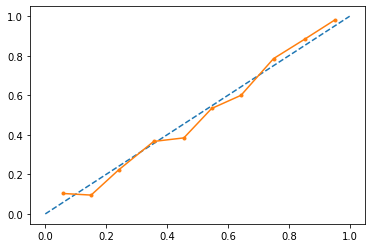

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.83      0.81       152
         1.0       0.82      0.77      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.008, n_estimator :200 max_faetures : 4, max_depth : 5 


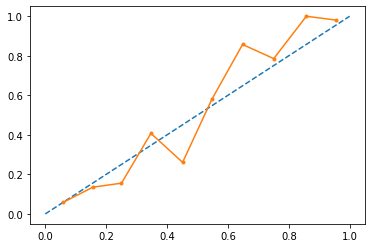

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.89      0.85       152
         1.0       0.88      0.80      0.83       152

    accuracy                           0.84       304
   macro avg       0.85      0.84      0.84       304
weighted avg       0.85      0.84      0.84       304

learning rate: 0.008, n_estimator :200 max_faetures : 5, max_depth : 3 


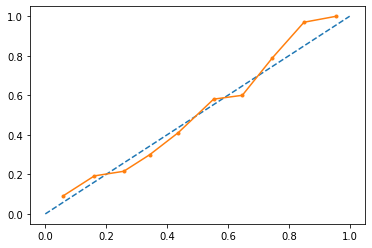

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.80      0.77       152
         1.0       0.78      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.008, n_estimator :200 max_faetures : 5, max_depth : 4 


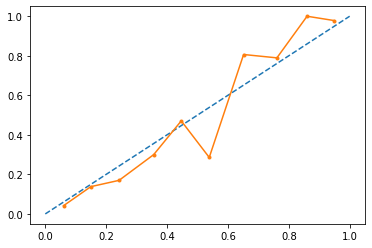

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.86      0.81       152
         1.0       0.84      0.74      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.008, n_estimator :200 max_faetures : 5, max_depth : 5 


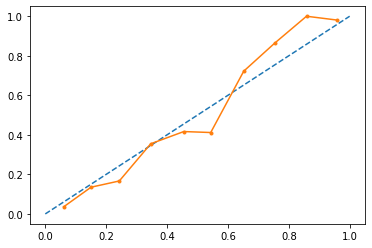

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.87      0.83       152
         1.0       0.86      0.78      0.81       152

    accuracy                           0.82       304
   macro avg       0.83      0.82      0.82       304
weighted avg       0.83      0.82      0.82       304

learning rate: 0.005, n_estimator :100 max_faetures : 2, max_depth : 3 


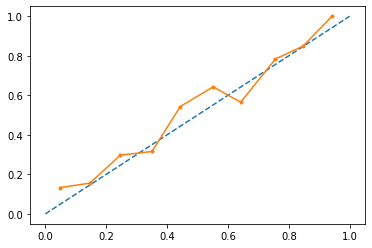

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.74      0.72       152
         1.0       0.73      0.69      0.71       152

    accuracy                           0.72       304
   macro avg       0.72      0.72      0.72       304
weighted avg       0.72      0.72      0.72       304

learning rate: 0.005, n_estimator :100 max_faetures : 2, max_depth : 4 


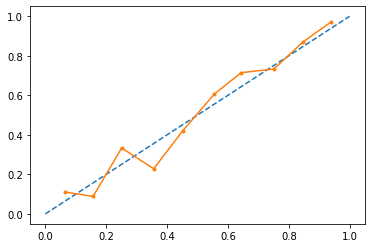

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.77       152
         1.0       0.77      0.76      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.005, n_estimator :100 max_faetures : 2, max_depth : 5 


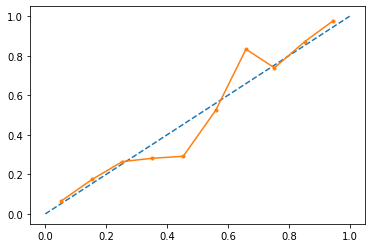

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.81      0.80       152
         1.0       0.81      0.79      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :100 max_faetures : 3, max_depth : 3 


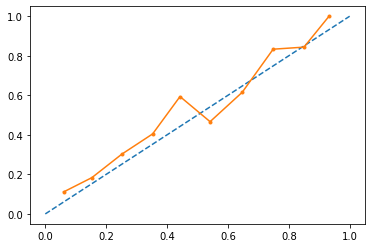

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.80      0.74       152
         1.0       0.76      0.64      0.70       152

    accuracy                           0.72       304
   macro avg       0.73      0.72      0.72       304
weighted avg       0.73      0.72      0.72       304

learning rate: 0.005, n_estimator :100 max_faetures : 3, max_depth : 4 


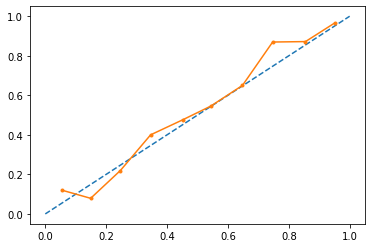

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.78       152
         1.0       0.78      0.77      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.005, n_estimator :100 max_faetures : 3, max_depth : 5 


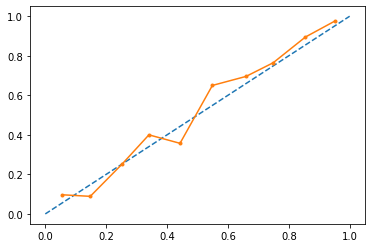

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.83      0.80       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :100 max_faetures : 4, max_depth : 3 


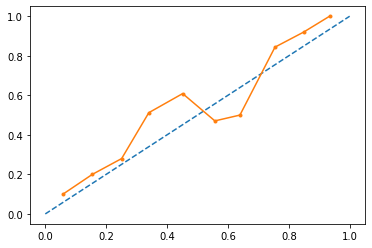

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       152
         1.0       0.73      0.63      0.68       152

    accuracy                           0.70       304
   macro avg       0.70      0.70      0.70       304
weighted avg       0.70      0.70      0.70       304

learning rate: 0.005, n_estimator :100 max_faetures : 4, max_depth : 4 


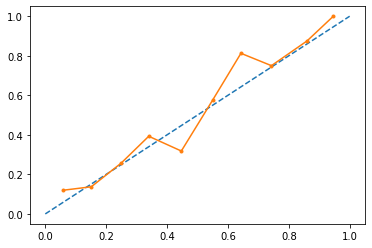

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.79      0.79       152
         1.0       0.79      0.78      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.005, n_estimator :100 max_faetures : 4, max_depth : 5 


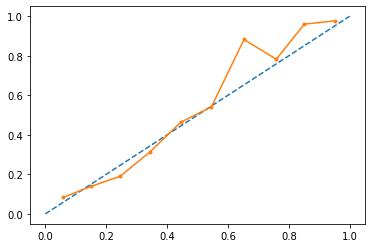

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.75      0.79       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :100 max_faetures : 5, max_depth : 3 


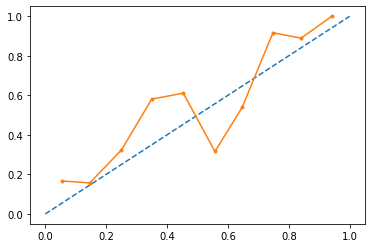

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       152
         1.0       0.72      0.62      0.67       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.005, n_estimator :100 max_faetures : 5, max_depth : 4 


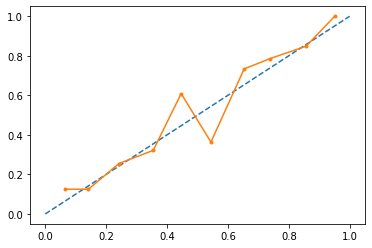

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :100 max_faetures : 5, max_depth : 5 


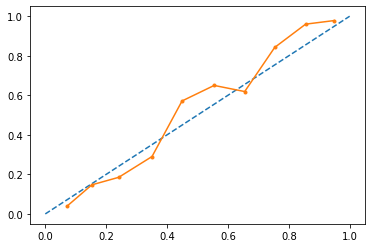

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.80       152
         1.0       0.83      0.73      0.78       152

    accuracy                           0.79       304
   macro avg       0.80      0.79      0.79       304
weighted avg       0.80      0.79      0.79       304

learning rate: 0.005, n_estimator :120 max_faetures : 2, max_depth : 3 


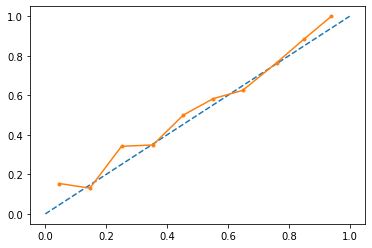

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.77      0.74       152
         1.0       0.75      0.70      0.72       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.005, n_estimator :120 max_faetures : 2, max_depth : 4 


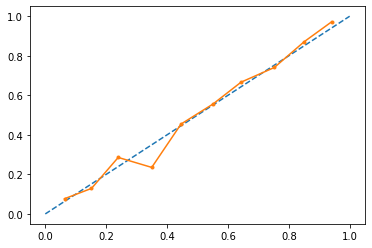

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.77      0.76       152
         1.0       0.77      0.76      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.005, n_estimator :120 max_faetures : 2, max_depth : 5 


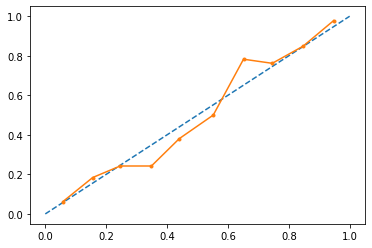

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.82      0.81       152
         1.0       0.81      0.79      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :120 max_faetures : 3, max_depth : 3 


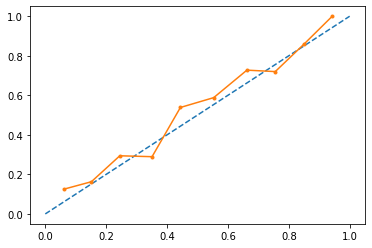

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.75      0.74       152
         1.0       0.74      0.73      0.74       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.005, n_estimator :120 max_faetures : 3, max_depth : 4 


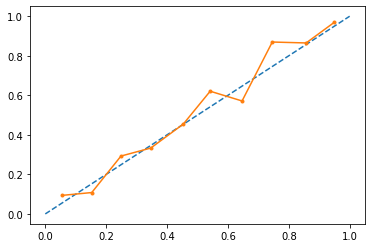

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.79      0.78       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.005, n_estimator :120 max_faetures : 3, max_depth : 5 


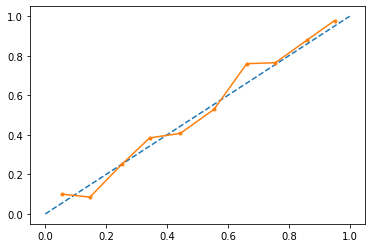

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.84      0.81       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :120 max_faetures : 4, max_depth : 3 


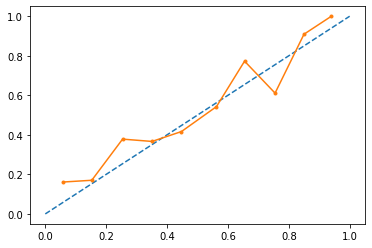

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :120 max_faetures : 4, max_depth : 4 


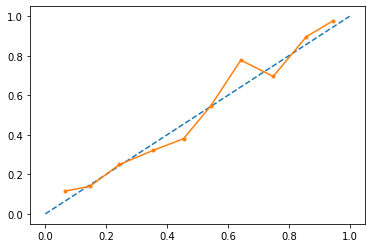

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.78      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.005, n_estimator :120 max_faetures : 4, max_depth : 5 


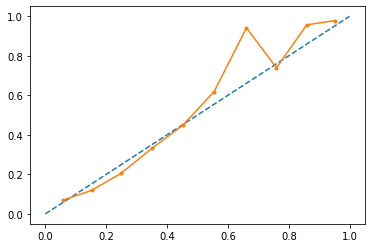

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.85      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.82      0.81      0.81       304
weighted avg       0.82      0.81      0.81       304

learning rate: 0.005, n_estimator :120 max_faetures : 5, max_depth : 3 


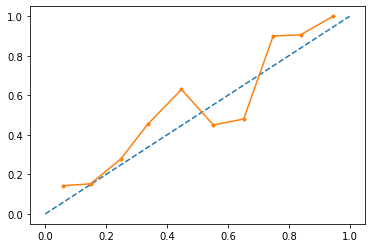

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       152
         1.0       0.73      0.64      0.69       152

    accuracy                           0.70       304
   macro avg       0.71      0.70      0.70       304
weighted avg       0.71      0.70      0.70       304

learning rate: 0.005, n_estimator :120 max_faetures : 5, max_depth : 4 


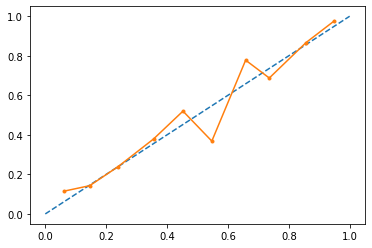

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.80      0.77       152
         1.0       0.78      0.73      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.005, n_estimator :120 max_faetures : 5, max_depth : 5 


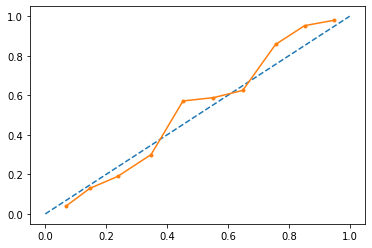

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.75      0.79       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :150 max_faetures : 2, max_depth : 3 


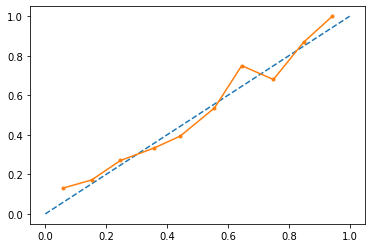

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.75      0.73      0.74       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.005, n_estimator :150 max_faetures : 2, max_depth : 4 


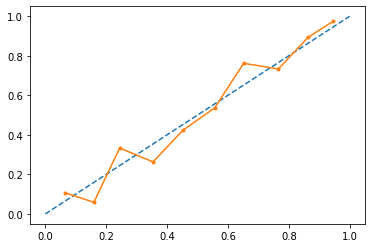

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.78      0.78       152
         1.0       0.78      0.78      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.005, n_estimator :150 max_faetures : 2, max_depth : 5 


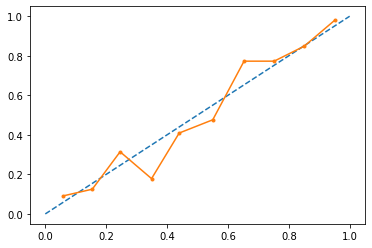

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.82      0.79      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :150 max_faetures : 3, max_depth : 3 


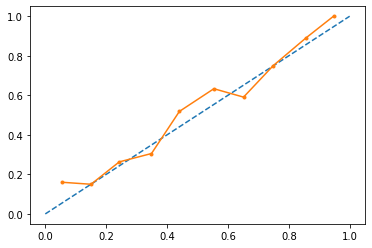

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.77      0.72      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :150 max_faetures : 3, max_depth : 4 


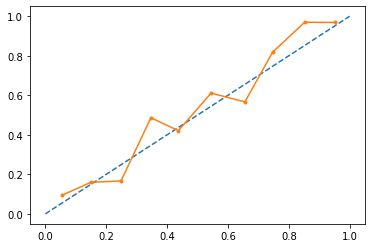

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.82      0.78       152
         1.0       0.80      0.72      0.76       152

    accuracy                           0.77       304
   macro avg       0.78      0.77      0.77       304
weighted avg       0.78      0.77      0.77       304

learning rate: 0.005, n_estimator :150 max_faetures : 3, max_depth : 5 


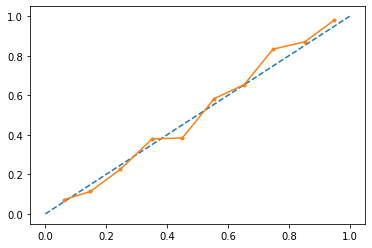

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.80       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :150 max_faetures : 4, max_depth : 3 


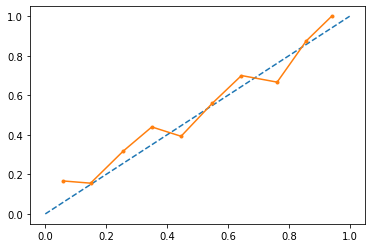

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.77      0.75       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :150 max_faetures : 4, max_depth : 4 


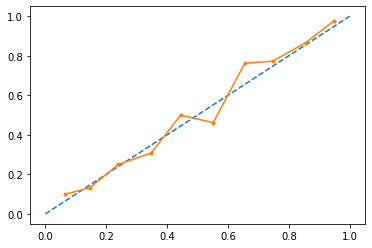

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.81      0.79       152
         1.0       0.80      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.005, n_estimator :150 max_faetures : 4, max_depth : 5 


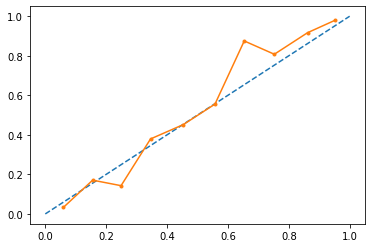

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.86      0.82       152
         1.0       0.85      0.77      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.005, n_estimator :150 max_faetures : 5, max_depth : 3 


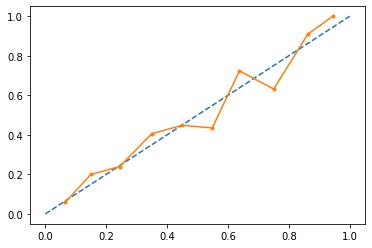

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.79      0.76       152
         1.0       0.77      0.71      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :150 max_faetures : 5, max_depth : 4 


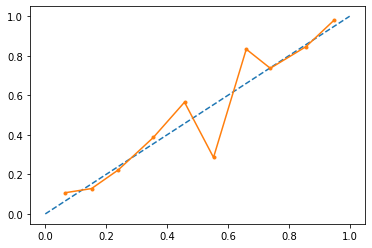

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.78      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.005, n_estimator :150 max_faetures : 5, max_depth : 5 


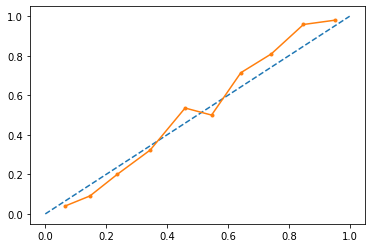

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.84      0.75      0.79       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :180 max_faetures : 2, max_depth : 3 


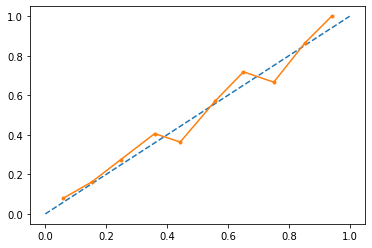

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.75      0.73      0.74       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.005, n_estimator :180 max_faetures : 2, max_depth : 4 


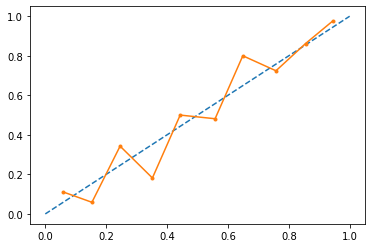

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.77       152
         1.0       0.77      0.76      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.005, n_estimator :180 max_faetures : 2, max_depth : 5 


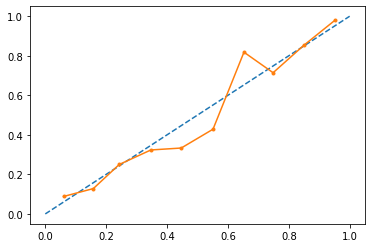

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.81      0.80       152
         1.0       0.81      0.79      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :180 max_faetures : 3, max_depth : 3 


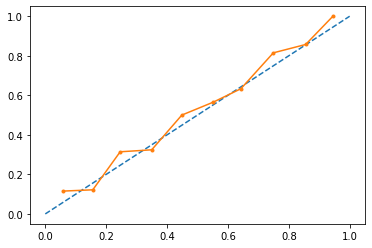

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.76      0.73      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :180 max_faetures : 3, max_depth : 4 


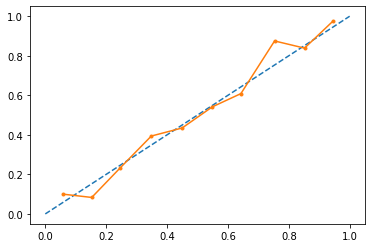

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.80      0.77      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.005, n_estimator :180 max_faetures : 3, max_depth : 5 


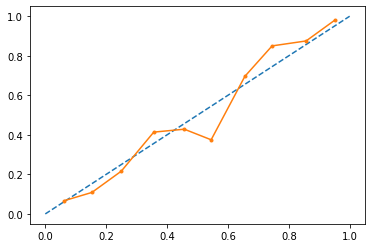

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.81       152
         1.0       0.83      0.78      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :180 max_faetures : 4, max_depth : 3 


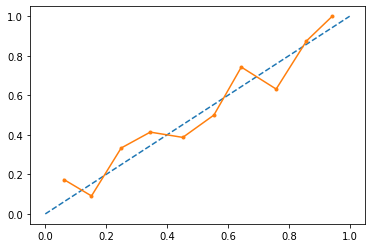

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.75      0.73      0.74       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.005, n_estimator :180 max_faetures : 4, max_depth : 4 


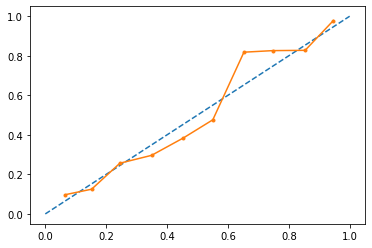

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.82      0.80       152
         1.0       0.81      0.78      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :180 max_faetures : 4, max_depth : 5 


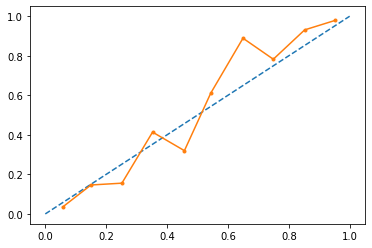

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.88      0.84       152
         1.0       0.86      0.79      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.005, n_estimator :180 max_faetures : 5, max_depth : 3 


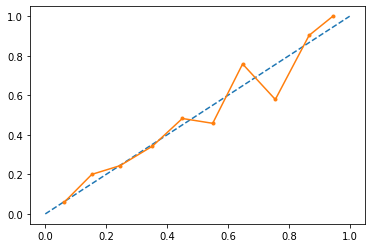

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :180 max_faetures : 5, max_depth : 4 


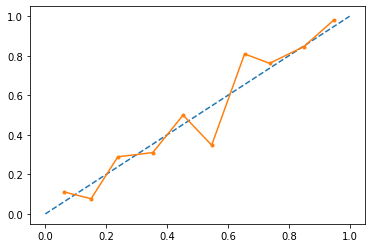

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.81      0.79       152
         1.0       0.80      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.005, n_estimator :180 max_faetures : 5, max_depth : 5 


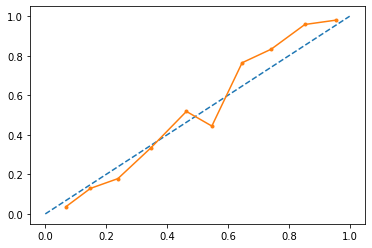

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.86      0.82       152
         1.0       0.85      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.82      0.81      0.81       304
weighted avg       0.82      0.81      0.81       304

learning rate: 0.005, n_estimator :200 max_faetures : 2, max_depth : 3 


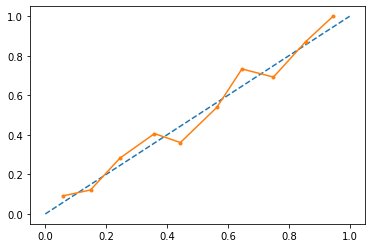

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.75      0.74       152
         1.0       0.74      0.72      0.73       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.005, n_estimator :200 max_faetures : 2, max_depth : 4 


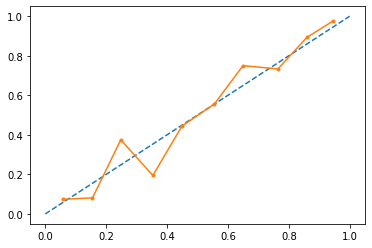

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.78      0.78       152
         1.0       0.78      0.77      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.005, n_estimator :200 max_faetures : 2, max_depth : 5 


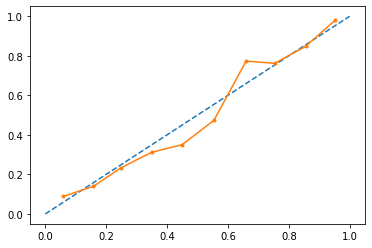

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.82      0.81       152
         1.0       0.82      0.79      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :200 max_faetures : 3, max_depth : 3 


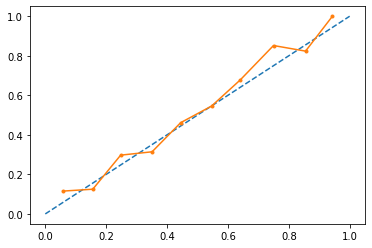

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.76      0.73      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :200 max_faetures : 3, max_depth : 4 


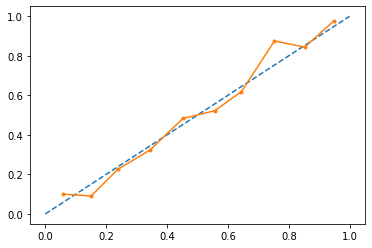

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.79      0.78       152
         1.0       0.78      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.005, n_estimator :200 max_faetures : 3, max_depth : 5 


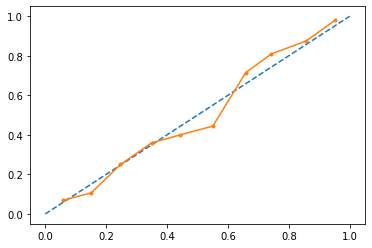

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.81       152
         1.0       0.83      0.78      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.005, n_estimator :200 max_faetures : 4, max_depth : 3 


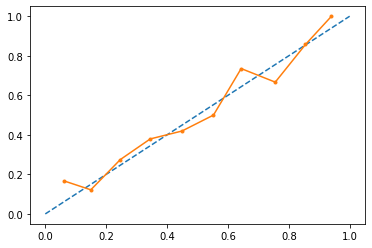

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.76      0.75       152
         1.0       0.76      0.73      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :200 max_faetures : 4, max_depth : 4 


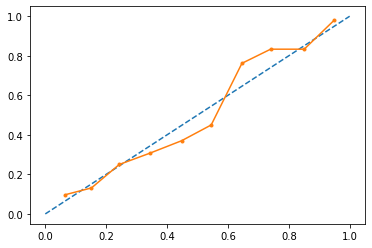

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.82      0.80       152
         1.0       0.81      0.78      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.005, n_estimator :200 max_faetures : 4, max_depth : 5 


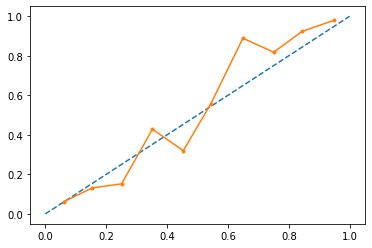

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.80      0.88      0.84       152
         1.0       0.87      0.78      0.82       152

    accuracy                           0.83       304
   macro avg       0.84      0.83      0.83       304
weighted avg       0.84      0.83      0.83       304

learning rate: 0.005, n_estimator :200 max_faetures : 5, max_depth : 3 


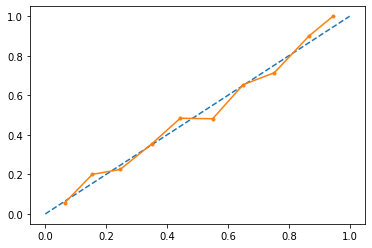

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.78      0.76       152
         1.0       0.77      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.005, n_estimator :200 max_faetures : 5, max_depth : 4 


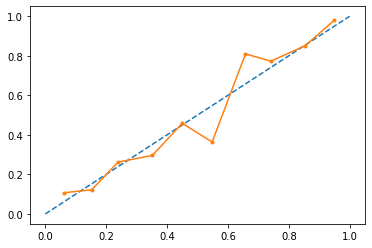

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.82      0.80       152
         1.0       0.81      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.005, n_estimator :200 max_faetures : 5, max_depth : 5 


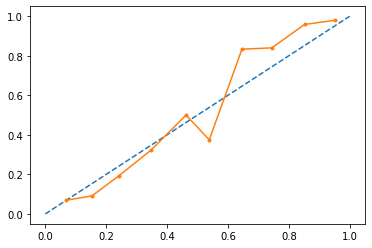

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.85      0.82       152
         1.0       0.84      0.77      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.002, n_estimator :100 max_faetures : 2, max_depth : 3 


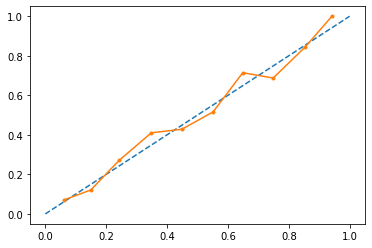

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.73      0.73       152
         1.0       0.73      0.72      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.002, n_estimator :100 max_faetures : 2, max_depth : 4 


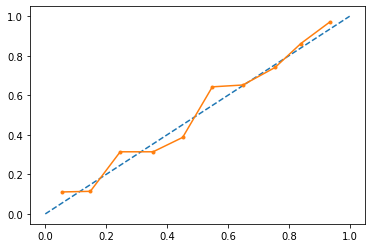

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.78      0.77       152
         1.0       0.77      0.76      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.002, n_estimator :100 max_faetures : 2, max_depth : 5 


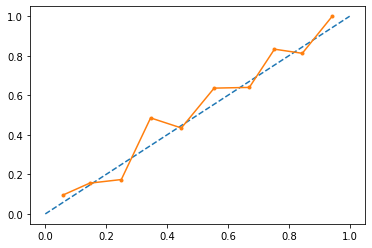

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.82      0.78       152
         1.0       0.80      0.72      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.002, n_estimator :100 max_faetures : 3, max_depth : 3 


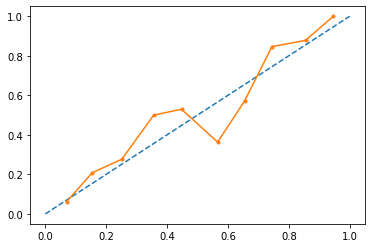

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.79      0.73       152
         1.0       0.75      0.62      0.68       152

    accuracy                           0.71       304
   macro avg       0.71      0.71      0.71       304
weighted avg       0.71      0.71      0.71       304

learning rate: 0.002, n_estimator :100 max_faetures : 3, max_depth : 4 


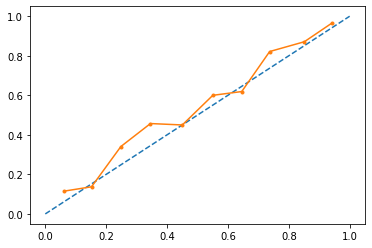

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.81      0.77       152
         1.0       0.79      0.70      0.74       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :100 max_faetures : 3, max_depth : 5 


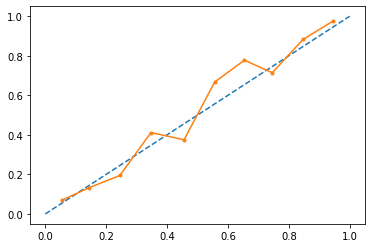

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.81      0.79       152
         1.0       0.80      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :100 max_faetures : 4, max_depth : 3 


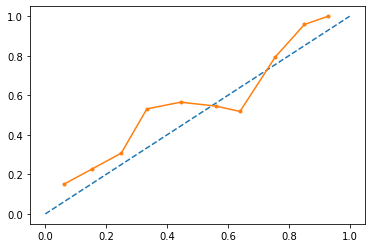

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       152
         1.0       0.72      0.63      0.67       152

    accuracy                           0.69       304
   macro avg       0.70      0.69      0.69       304
weighted avg       0.70      0.69      0.69       304

learning rate: 0.002, n_estimator :100 max_faetures : 4, max_depth : 4 


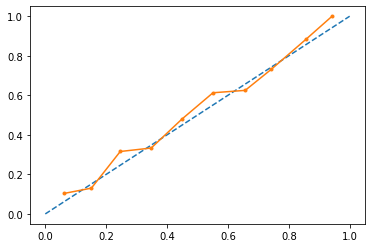

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.78      0.74      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.002, n_estimator :100 max_faetures : 4, max_depth : 5 


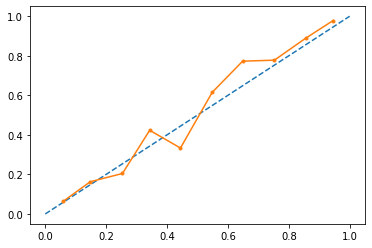

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.83      0.81       152
         1.0       0.82      0.78      0.80       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.002, n_estimator :100 max_faetures : 5, max_depth : 3 


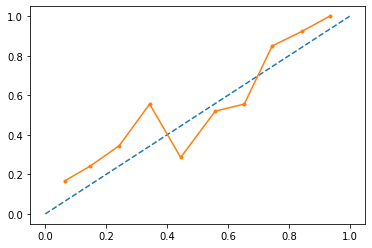

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.60      0.65       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.002, n_estimator :100 max_faetures : 5, max_depth : 4 


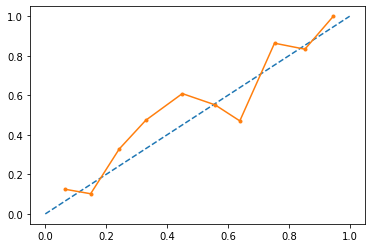

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.78      0.75       152
         1.0       0.76      0.70      0.73       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.002, n_estimator :100 max_faetures : 5, max_depth : 5 


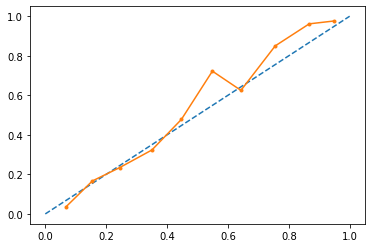

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.80       152
         1.0       0.83      0.73      0.78       152

    accuracy                           0.79       304
   macro avg       0.80      0.79      0.79       304
weighted avg       0.80      0.79      0.79       304

learning rate: 0.002, n_estimator :120 max_faetures : 2, max_depth : 3 


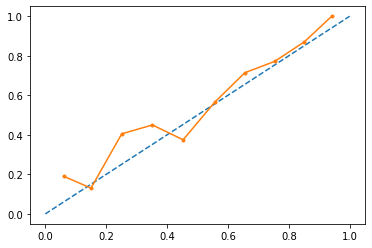

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.73      0.71       152
         1.0       0.71      0.66      0.69       152

    accuracy                           0.70       304
   macro avg       0.70      0.70      0.70       304
weighted avg       0.70      0.70      0.70       304

learning rate: 0.002, n_estimator :120 max_faetures : 2, max_depth : 4 


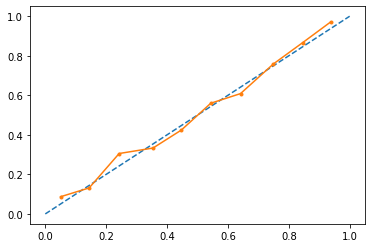

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.77      0.75      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :120 max_faetures : 2, max_depth : 5 


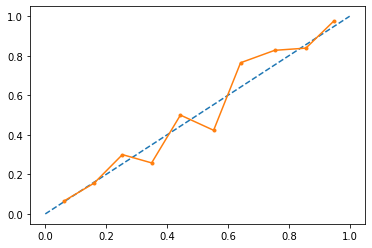

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.002, n_estimator :120 max_faetures : 3, max_depth : 3 


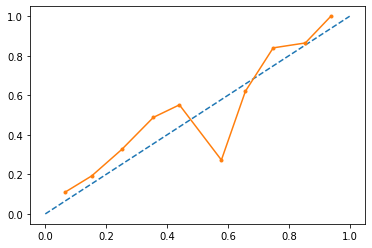

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.80      0.74       152
         1.0       0.76      0.62      0.69       152

    accuracy                           0.71       304
   macro avg       0.72      0.71      0.71       304
weighted avg       0.72      0.71      0.71       304

learning rate: 0.002, n_estimator :120 max_faetures : 3, max_depth : 4 


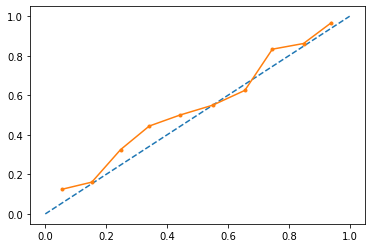

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       152
         1.0       0.79      0.70      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :120 max_faetures : 3, max_depth : 5 


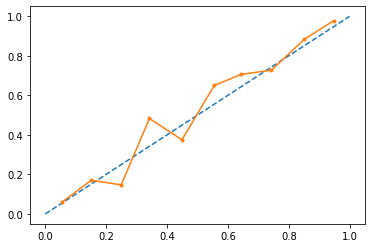

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.82      0.80       152
         1.0       0.81      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :120 max_faetures : 4, max_depth : 3 


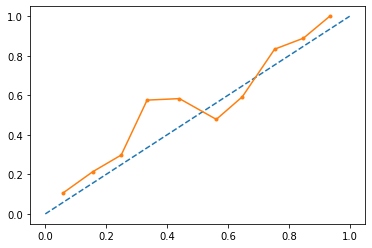

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.62      0.66       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.002, n_estimator :120 max_faetures : 4, max_depth : 4 


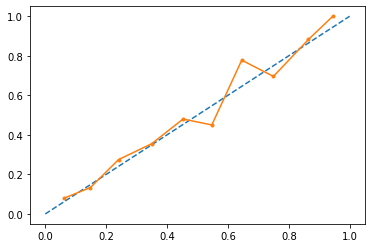

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.002, n_estimator :120 max_faetures : 4, max_depth : 5 


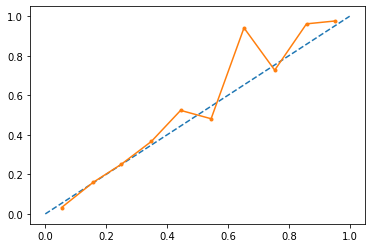

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.80       152
         1.0       0.82      0.74      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :120 max_faetures : 5, max_depth : 3 


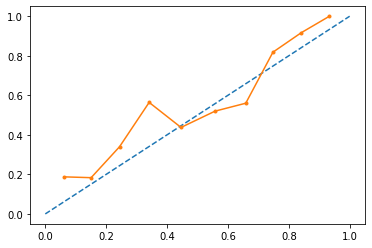

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.61      0.66       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.002, n_estimator :120 max_faetures : 5, max_depth : 4 


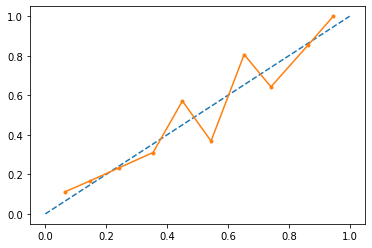

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.002, n_estimator :120 max_faetures : 5, max_depth : 5 


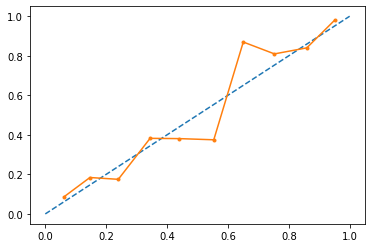

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.81       152
         1.0       0.83      0.75      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.002, n_estimator :150 max_faetures : 2, max_depth : 3 


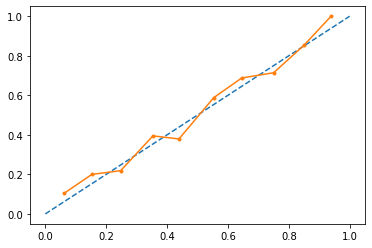

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.74      0.73       152
         1.0       0.74      0.72      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.002, n_estimator :150 max_faetures : 2, max_depth : 4 


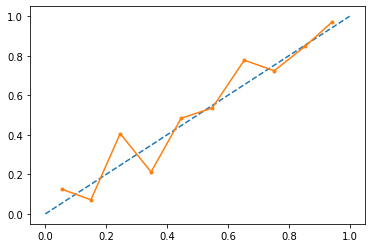

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.78      0.77       152
         1.0       0.77      0.76      0.76       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.002, n_estimator :150 max_faetures : 2, max_depth : 5 


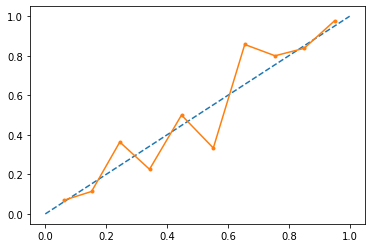

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.80      0.77      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :150 max_faetures : 3, max_depth : 3 


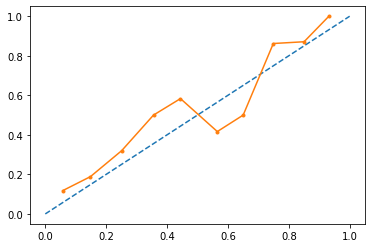

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.78      0.73       152
         1.0       0.74      0.62      0.68       152

    accuracy                           0.70       304
   macro avg       0.71      0.70      0.70       304
weighted avg       0.71      0.70      0.70       304

learning rate: 0.002, n_estimator :150 max_faetures : 3, max_depth : 4 


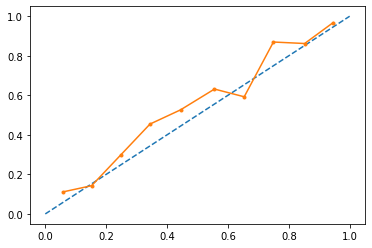

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       152
         1.0       0.78      0.69      0.73       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.002, n_estimator :150 max_faetures : 3, max_depth : 5 


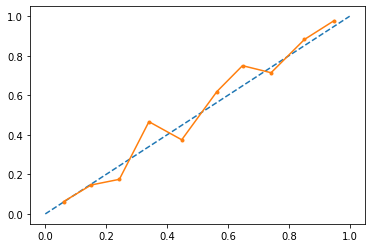

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.82      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :150 max_faetures : 4, max_depth : 3 


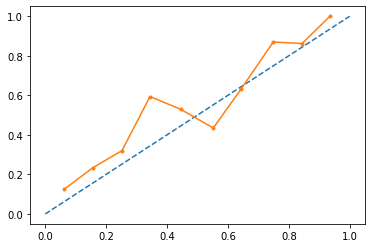

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       152
         1.0       0.71      0.62      0.66       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.002, n_estimator :150 max_faetures : 4, max_depth : 4 


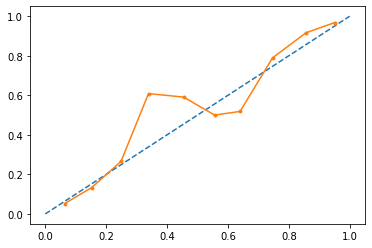

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.74       152
         1.0       0.75      0.68      0.71       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.002, n_estimator :150 max_faetures : 4, max_depth : 5 


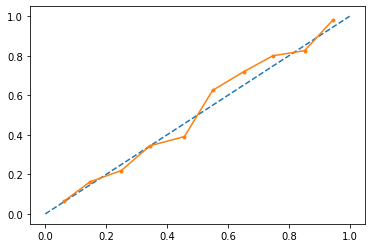

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.81       152
         1.0       0.83      0.78      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.002, n_estimator :150 max_faetures : 5, max_depth : 3 


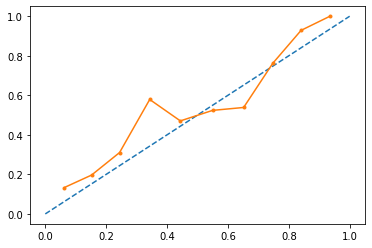

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.61      0.66       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.002, n_estimator :150 max_faetures : 5, max_depth : 4 


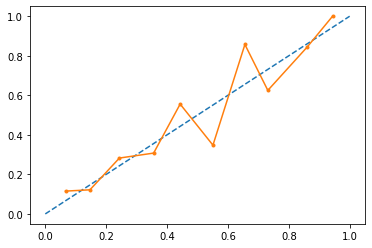

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.78      0.76       152
         1.0       0.77      0.72      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.002, n_estimator :150 max_faetures : 5, max_depth : 5 


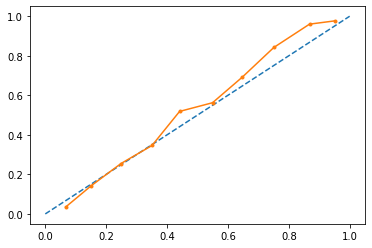

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.85      0.80       152
         1.0       0.83      0.73      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :180 max_faetures : 2, max_depth : 3 


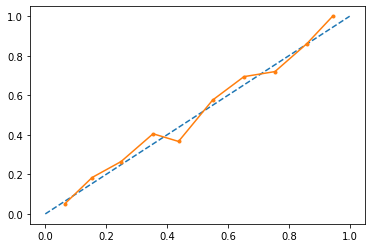

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.74      0.74       152
         1.0       0.74      0.73      0.74       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.002, n_estimator :180 max_faetures : 2, max_depth : 4 


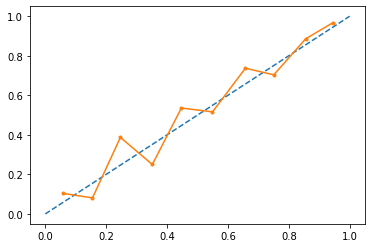

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.77      0.75      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :180 max_faetures : 2, max_depth : 5 


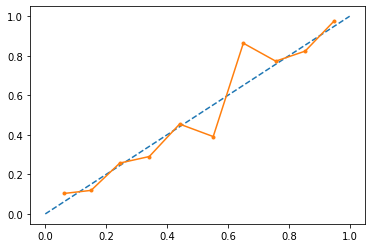

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.81      0.79       152
         1.0       0.80      0.77      0.79       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :180 max_faetures : 3, max_depth : 3 


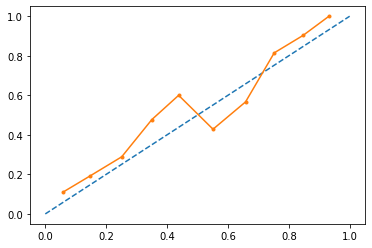

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.79      0.73       152
         1.0       0.75      0.62      0.68       152

    accuracy                           0.71       304
   macro avg       0.71      0.71      0.71       304
weighted avg       0.71      0.71      0.71       304

learning rate: 0.002, n_estimator :180 max_faetures : 3, max_depth : 4 


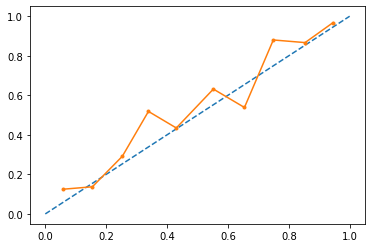

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       152
         1.0       0.78      0.69      0.73       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.002, n_estimator :180 max_faetures : 3, max_depth : 5 


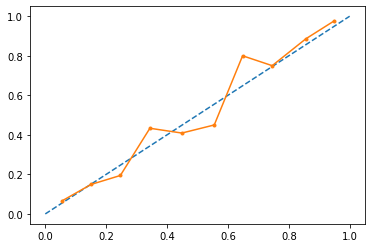

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.84      0.81       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.002, n_estimator :180 max_faetures : 4, max_depth : 3 


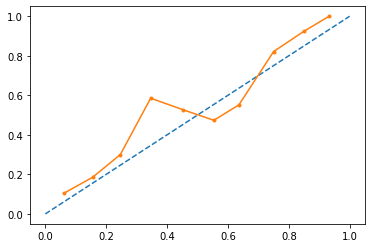

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       152
         1.0       0.73      0.64      0.68       152

    accuracy                           0.70       304
   macro avg       0.70      0.70      0.70       304
weighted avg       0.70      0.70      0.70       304

learning rate: 0.002, n_estimator :180 max_faetures : 4, max_depth : 4 


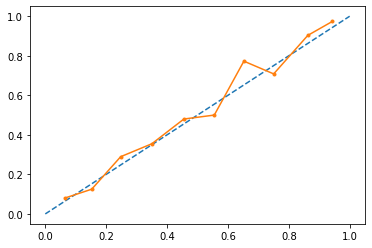

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.002, n_estimator :180 max_faetures : 4, max_depth : 5 


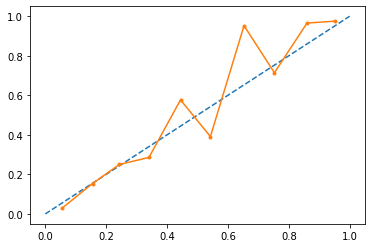

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.81       152
         1.0       0.83      0.75      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.002, n_estimator :180 max_faetures : 5, max_depth : 3 


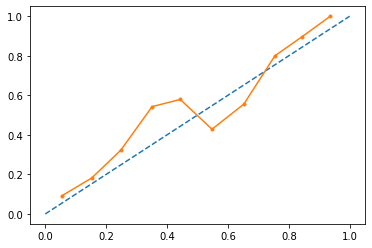

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.77      0.71       152
         1.0       0.73      0.61      0.66       152

    accuracy                           0.69       304
   macro avg       0.70      0.69      0.69       304
weighted avg       0.70      0.69      0.69       304

learning rate: 0.002, n_estimator :180 max_faetures : 5, max_depth : 4 


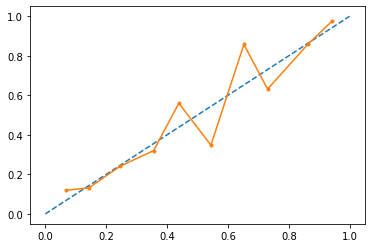

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.79      0.77       152
         1.0       0.78      0.73      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :180 max_faetures : 5, max_depth : 5 


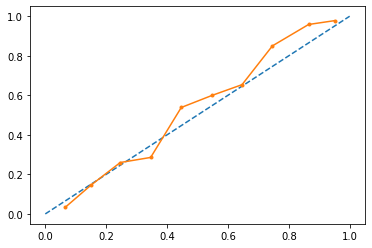

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.80       152
         1.0       0.83      0.72      0.77       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :200 max_faetures : 2, max_depth : 3 


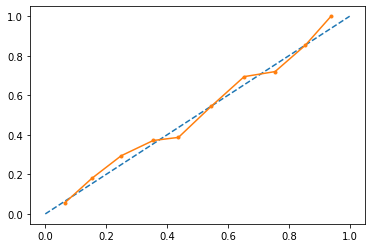

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.74      0.73       152
         1.0       0.74      0.73      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.002, n_estimator :200 max_faetures : 2, max_depth : 4 


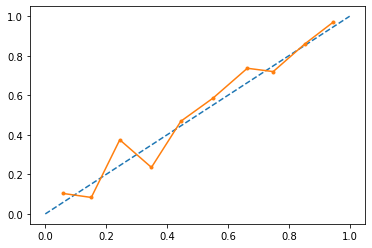

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.77      0.76       152
         1.0       0.77      0.76      0.76       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :200 max_faetures : 2, max_depth : 5 


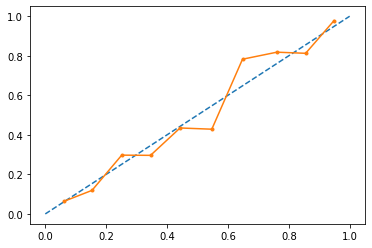

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.81      0.79       152
         1.0       0.80      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :200 max_faetures : 3, max_depth : 3 


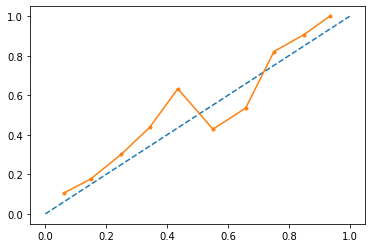

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.79      0.73       152
         1.0       0.75      0.64      0.69       152

    accuracy                           0.71       304
   macro avg       0.72      0.71      0.71       304
weighted avg       0.72      0.71      0.71       304

learning rate: 0.002, n_estimator :200 max_faetures : 3, max_depth : 4 


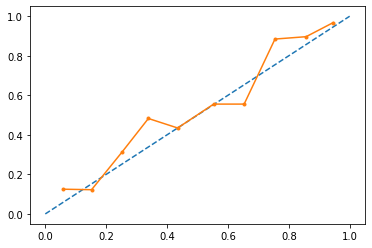

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       152
         1.0       0.78      0.69      0.73       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.002, n_estimator :200 max_faetures : 3, max_depth : 5 


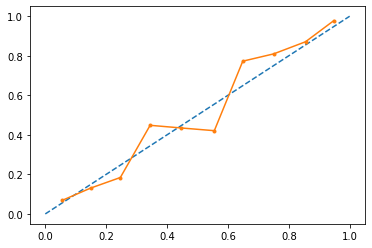

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.82      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.002, n_estimator :200 max_faetures : 4, max_depth : 3 


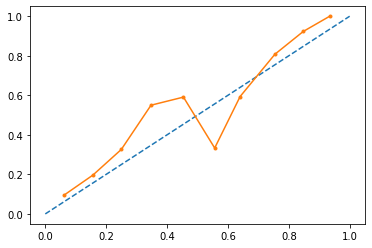

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.71       152
         1.0       0.72      0.64      0.68       152

    accuracy                           0.70       304
   macro avg       0.70      0.70      0.70       304
weighted avg       0.70      0.70      0.70       304

learning rate: 0.002, n_estimator :200 max_faetures : 4, max_depth : 4 


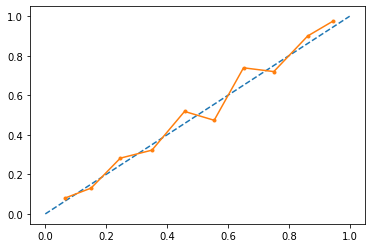

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.80      0.78       152
         1.0       0.79      0.75      0.77       152

    accuracy                           0.77       304
   macro avg       0.77      0.77      0.77       304
weighted avg       0.77      0.77      0.77       304

learning rate: 0.002, n_estimator :200 max_faetures : 4, max_depth : 5 


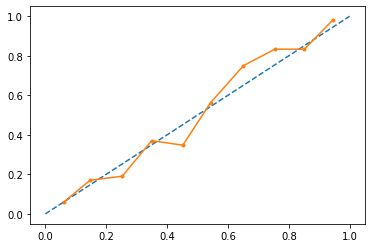

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.79      0.84      0.81       152
         1.0       0.83      0.78      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.002, n_estimator :200 max_faetures : 5, max_depth : 3 


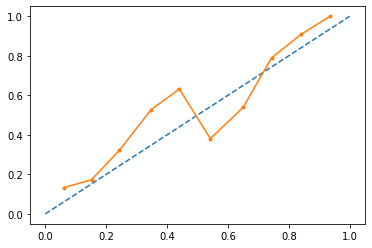

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       152
         1.0       0.73      0.62      0.67       152

    accuracy                           0.69       304
   macro avg       0.70      0.69      0.69       304
weighted avg       0.70      0.69      0.69       304

learning rate: 0.002, n_estimator :200 max_faetures : 5, max_depth : 4 


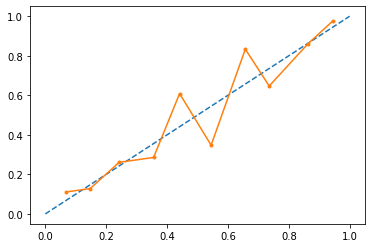

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.79      0.77       152
         1.0       0.78      0.73      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.002, n_estimator :200 max_faetures : 5, max_depth : 5 


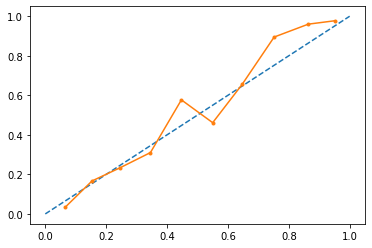

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.80       152
         1.0       0.83      0.72      0.77       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :100 max_faetures : 2, max_depth : 3 


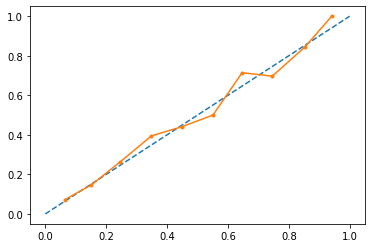

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.73      0.73       152
         1.0       0.73      0.72      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :100 max_faetures : 2, max_depth : 4 


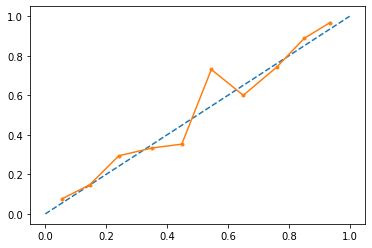

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.001, n_estimator :100 max_faetures : 2, max_depth : 5 


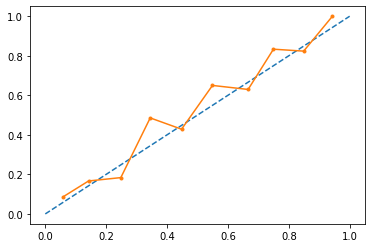

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.81      0.77       152
         1.0       0.79      0.72      0.75       152

    accuracy                           0.76       304
   macro avg       0.77      0.76      0.76       304
weighted avg       0.77      0.76      0.76       304

learning rate: 0.001, n_estimator :100 max_faetures : 3, max_depth : 3 


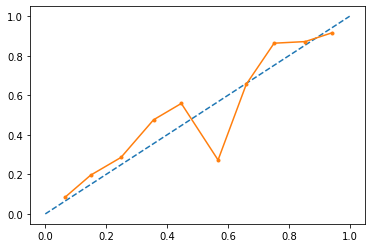

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.78      0.73       152
         1.0       0.74      0.62      0.68       152

    accuracy                           0.70       304
   macro avg       0.71      0.70      0.70       304
weighted avg       0.71      0.70      0.70       304

learning rate: 0.001, n_estimator :100 max_faetures : 3, max_depth : 4 


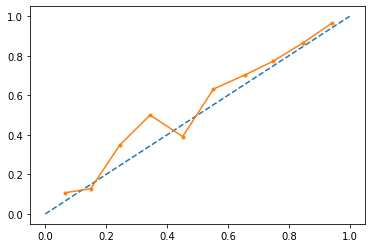

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.81      0.77       152
         1.0       0.79      0.70      0.74       152

    accuracy                           0.75       304
   macro avg       0.76      0.75      0.75       304
weighted avg       0.76      0.75      0.75       304

learning rate: 0.001, n_estimator :100 max_faetures : 3, max_depth : 5 


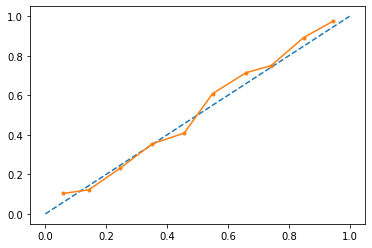

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.001, n_estimator :100 max_faetures : 4, max_depth : 3 


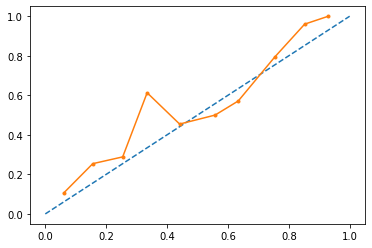

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       152
         1.0       0.72      0.62      0.67       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.001, n_estimator :100 max_faetures : 4, max_depth : 4 


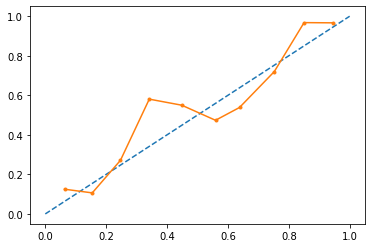

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.75       152
         1.0       0.76      0.68      0.72       152

    accuracy                           0.73       304
   macro avg       0.74      0.73      0.73       304
weighted avg       0.74      0.73      0.73       304

learning rate: 0.001, n_estimator :100 max_faetures : 4, max_depth : 5 


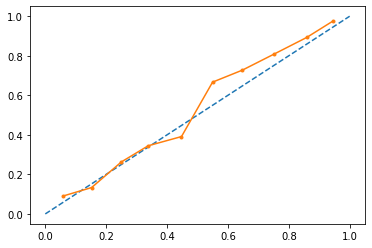

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.83      0.80       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.001, n_estimator :100 max_faetures : 5, max_depth : 3 


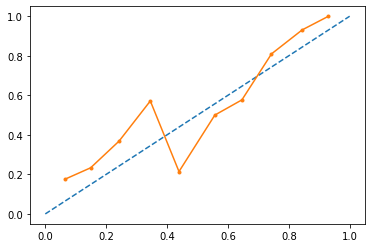

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.60      0.65       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.001, n_estimator :100 max_faetures : 5, max_depth : 4 


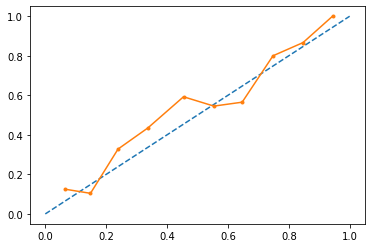

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.77      0.74       152
         1.0       0.75      0.70      0.72       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :100 max_faetures : 5, max_depth : 5 


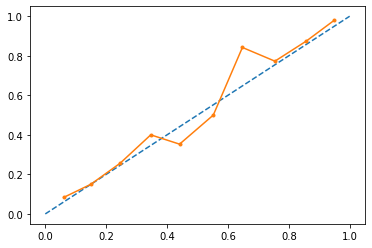

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.81      0.75      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :120 max_faetures : 2, max_depth : 3 


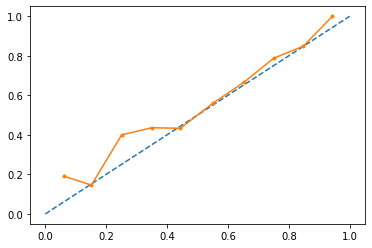

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.73      0.71       152
         1.0       0.71      0.66      0.69       152

    accuracy                           0.70       304
   macro avg       0.70      0.70      0.70       304
weighted avg       0.70      0.70      0.70       304

learning rate: 0.001, n_estimator :120 max_faetures : 2, max_depth : 4 


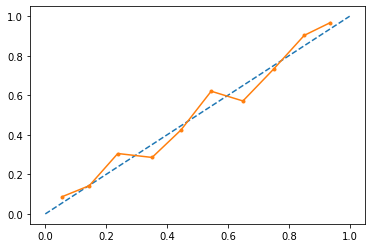

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.76      0.75       152
         1.0       0.75      0.75      0.75       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.001, n_estimator :120 max_faetures : 2, max_depth : 5 


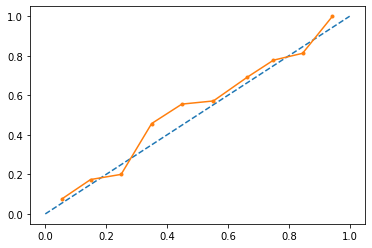

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.81      0.77       152
         1.0       0.79      0.71      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.001, n_estimator :120 max_faetures : 3, max_depth : 3 


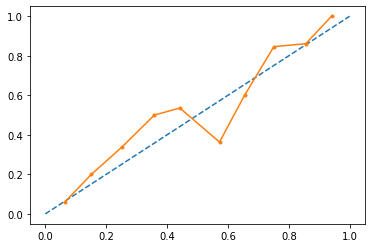

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.80      0.73       152
         1.0       0.75      0.61      0.67       152

    accuracy                           0.70       304
   macro avg       0.71      0.70      0.70       304
weighted avg       0.71      0.70      0.70       304

learning rate: 0.001, n_estimator :120 max_faetures : 3, max_depth : 4 


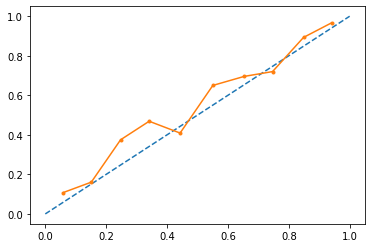

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       152
         1.0       0.79      0.70      0.74       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.001, n_estimator :120 max_faetures : 3, max_depth : 5 


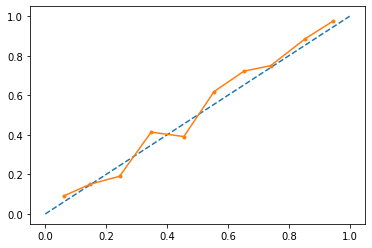

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.82      0.80       152
         1.0       0.81      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :120 max_faetures : 4, max_depth : 3 


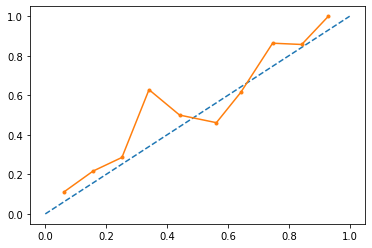

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       152
         1.0       0.72      0.62      0.67       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.001, n_estimator :120 max_faetures : 4, max_depth : 4 


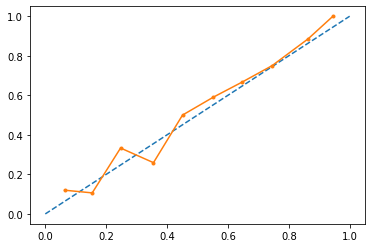

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.77       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.001, n_estimator :120 max_faetures : 4, max_depth : 5 


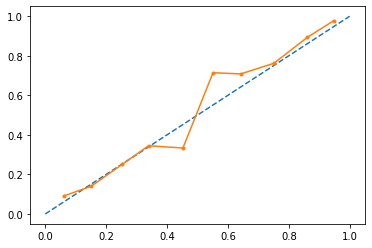

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.82      0.79       152
         1.0       0.81      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :120 max_faetures : 5, max_depth : 3 


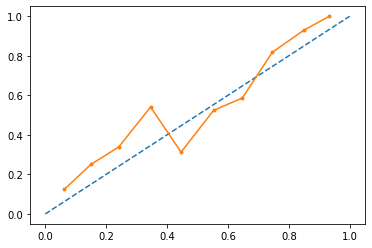

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.60      0.65       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.001, n_estimator :120 max_faetures : 5, max_depth : 4 


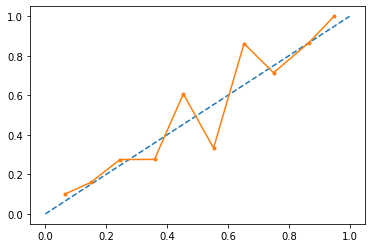

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.78      0.75       152
         1.0       0.76      0.72      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.001, n_estimator :120 max_faetures : 5, max_depth : 5 


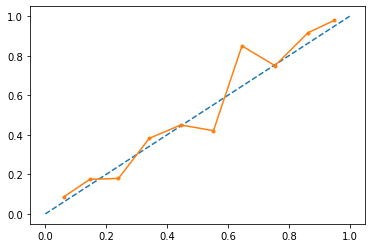

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.80       152
         1.0       0.82      0.75      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :150 max_faetures : 2, max_depth : 3 


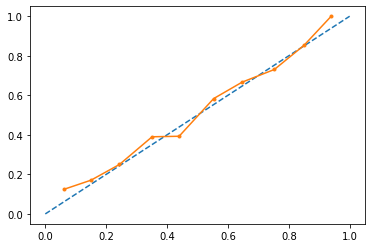

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.74      0.74       152
         1.0       0.74      0.72      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :150 max_faetures : 2, max_depth : 4 


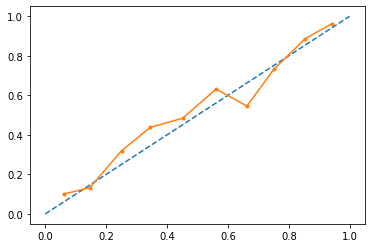

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.79      0.75       152
         1.0       0.77      0.69      0.73       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.001, n_estimator :150 max_faetures : 2, max_depth : 5 


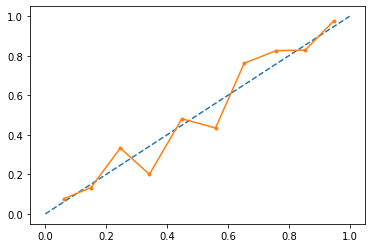

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.78       152
         1.0       0.79      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.001, n_estimator :150 max_faetures : 3, max_depth : 3 


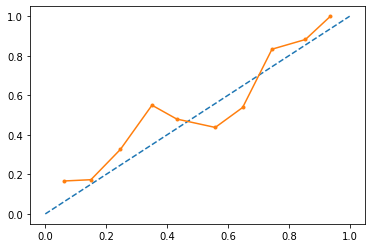

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.79      0.72       152
         1.0       0.74      0.61      0.67       152

    accuracy                           0.70       304
   macro avg       0.70      0.70      0.69       304
weighted avg       0.70      0.70      0.69       304

learning rate: 0.001, n_estimator :150 max_faetures : 3, max_depth : 4 


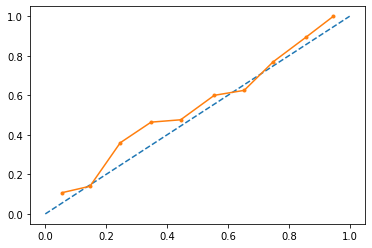

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.81      0.77       152
         1.0       0.79      0.70      0.74       152

    accuracy                           0.75       304
   macro avg       0.76      0.75      0.75       304
weighted avg       0.76      0.75      0.75       304

learning rate: 0.001, n_estimator :150 max_faetures : 3, max_depth : 5 


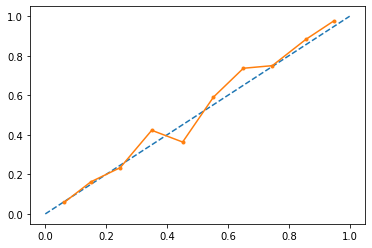

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.82      0.79       152
         1.0       0.80      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :150 max_faetures : 4, max_depth : 3 


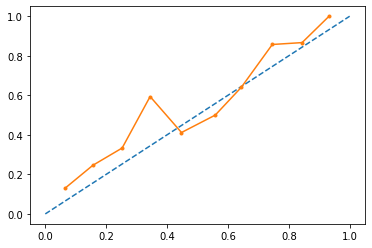

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       152
         1.0       0.71      0.61      0.65       152

    accuracy                           0.68       304
   macro avg       0.68      0.68      0.68       304
weighted avg       0.68      0.68      0.68       304

learning rate: 0.001, n_estimator :150 max_faetures : 4, max_depth : 4 


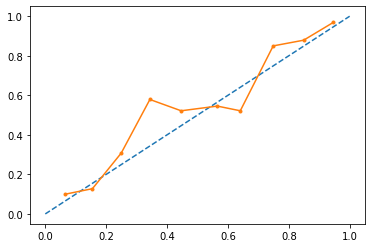

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       152
         1.0       0.76      0.67      0.71       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :150 max_faetures : 4, max_depth : 5 


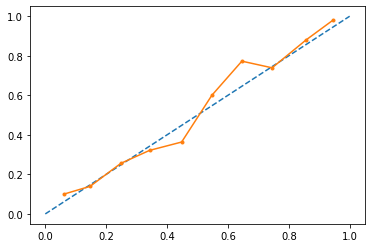

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.85      0.81       152
         1.0       0.83      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.001, n_estimator :150 max_faetures : 5, max_depth : 3 


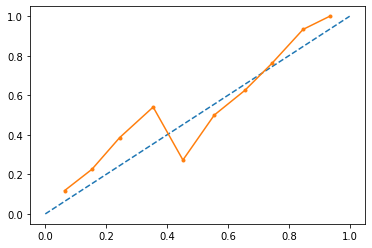

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.60      0.65       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.001, n_estimator :150 max_faetures : 5, max_depth : 4 


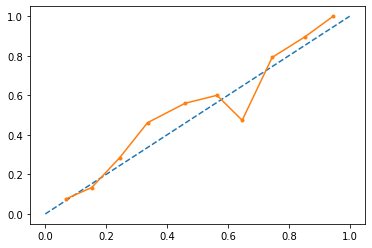

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.75       152
         1.0       0.76      0.68      0.72       152

    accuracy                           0.73       304
   macro avg       0.74      0.73      0.73       304
weighted avg       0.74      0.73      0.73       304

learning rate: 0.001, n_estimator :150 max_faetures : 5, max_depth : 5 


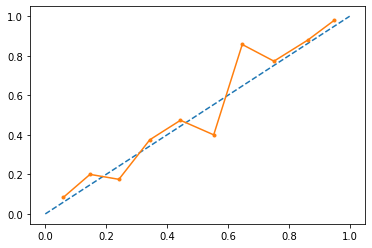

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.81      0.75      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :180 max_faetures : 2, max_depth : 3 


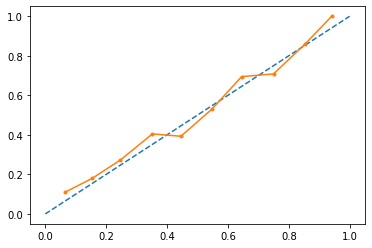

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.74      0.73       152
         1.0       0.73      0.72      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :180 max_faetures : 2, max_depth : 4 


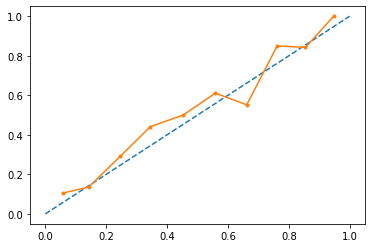

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.79      0.75       152
         1.0       0.77      0.70      0.73       152

    accuracy                           0.74       304
   macro avg       0.75      0.74      0.74       304
weighted avg       0.75      0.74      0.74       304

learning rate: 0.001, n_estimator :180 max_faetures : 2, max_depth : 5 


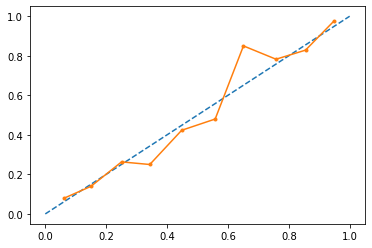

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.80      0.79       152
         1.0       0.79      0.77      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.001, n_estimator :180 max_faetures : 3, max_depth : 3 


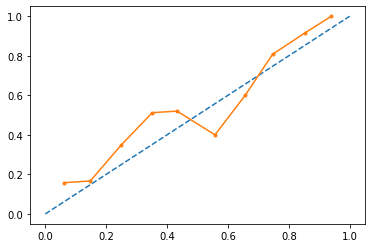

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.78      0.72       152
         1.0       0.74      0.61      0.66       152

    accuracy                           0.69       304
   macro avg       0.70      0.69      0.69       304
weighted avg       0.70      0.69      0.69       304

learning rate: 0.001, n_estimator :180 max_faetures : 3, max_depth : 4 


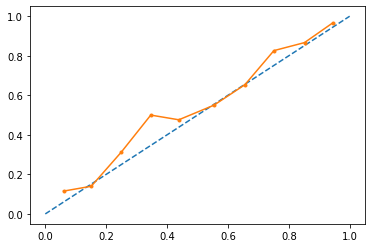

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       152
         1.0       0.79      0.70      0.74       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.001, n_estimator :180 max_faetures : 3, max_depth : 5 


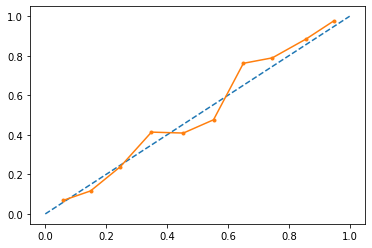

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.81      0.79       152
         1.0       0.80      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :180 max_faetures : 4, max_depth : 3 


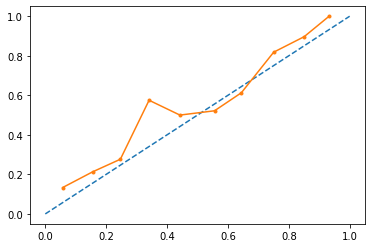

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.62      0.66       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.001, n_estimator :180 max_faetures : 4, max_depth : 4 


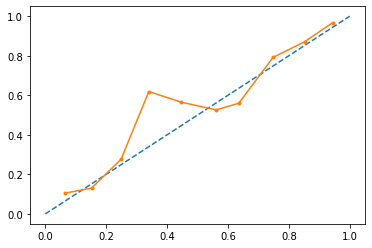

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       152
         1.0       0.76      0.67      0.71       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :180 max_faetures : 4, max_depth : 5 


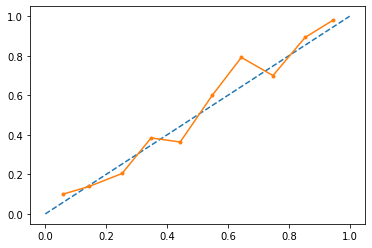

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.85      0.81       152
         1.0       0.83      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.001, n_estimator :180 max_faetures : 5, max_depth : 3 


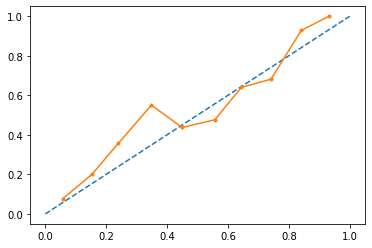

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       152
         1.0       0.72      0.61      0.66       152

    accuracy                           0.68       304
   macro avg       0.69      0.68      0.68       304
weighted avg       0.69      0.68      0.68       304

learning rate: 0.001, n_estimator :180 max_faetures : 5, max_depth : 4 


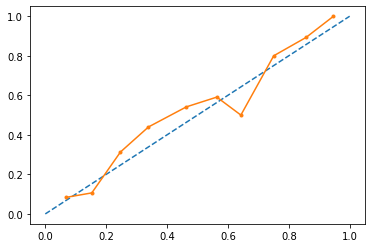

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.78      0.75       152
         1.0       0.76      0.70      0.73       152

    accuracy                           0.74       304
   macro avg       0.74      0.74      0.74       304
weighted avg       0.74      0.74      0.74       304

learning rate: 0.001, n_estimator :180 max_faetures : 5, max_depth : 5 


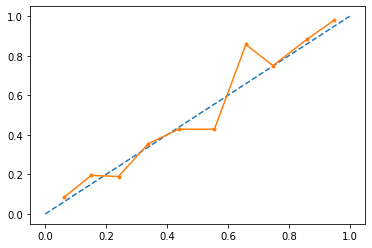

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.80       152
         1.0       0.82      0.76      0.79       152

    accuracy                           0.80       304
   macro avg       0.80      0.80      0.80       304
weighted avg       0.80      0.80      0.80       304

learning rate: 0.001, n_estimator :200 max_faetures : 2, max_depth : 3 


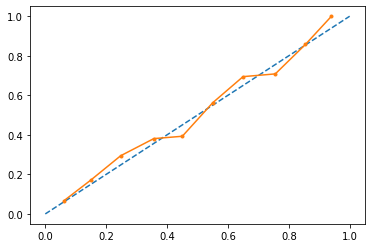

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.74      0.73       152
         1.0       0.74      0.73      0.73       152

    accuracy                           0.73       304
   macro avg       0.73      0.73      0.73       304
weighted avg       0.73      0.73      0.73       304

learning rate: 0.001, n_estimator :200 max_faetures : 2, max_depth : 4 


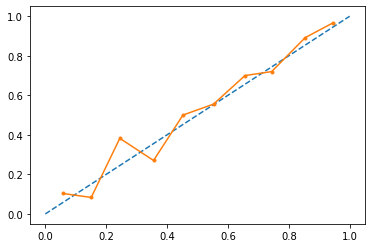

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.77      0.76       152
         1.0       0.76      0.74      0.75       152

    accuracy                           0.76       304
   macro avg       0.76      0.76      0.76       304
weighted avg       0.76      0.76      0.76       304

learning rate: 0.001, n_estimator :200 max_faetures : 2, max_depth : 5 


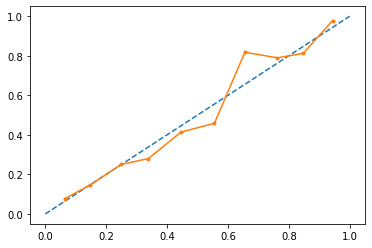

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.80      0.79       152
         1.0       0.79      0.76      0.78       152

    accuracy                           0.78       304
   macro avg       0.78      0.78      0.78       304
weighted avg       0.78      0.78      0.78       304

learning rate: 0.001, n_estimator :200 max_faetures : 3, max_depth : 3 


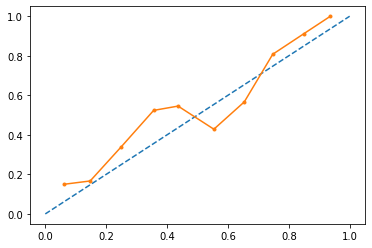

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.80      0.73       152
         1.0       0.75      0.62      0.68       152

    accuracy                           0.71       304
   macro avg       0.71      0.71      0.70       304
weighted avg       0.71      0.71      0.70       304

learning rate: 0.001, n_estimator :200 max_faetures : 3, max_depth : 4 


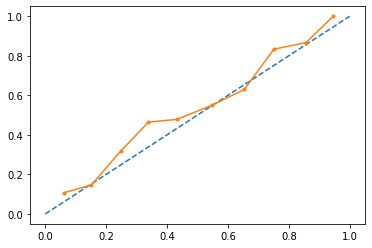

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.81      0.77       152
         1.0       0.79      0.70      0.74       152

    accuracy                           0.75       304
   macro avg       0.76      0.75      0.75       304
weighted avg       0.76      0.75      0.75       304

learning rate: 0.001, n_estimator :200 max_faetures : 3, max_depth : 5 


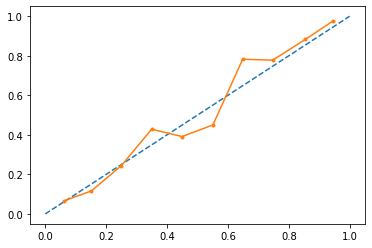

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.83      0.80       152
         1.0       0.82      0.76      0.78       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.001, n_estimator :200 max_faetures : 4, max_depth : 3 


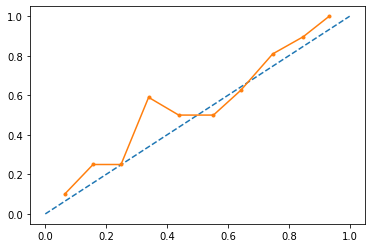

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       152
         1.0       0.72      0.62      0.67       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.001, n_estimator :200 max_faetures : 4, max_depth : 4 


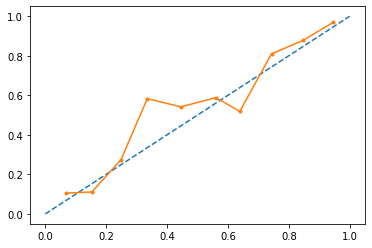

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.75       152
         1.0       0.76      0.68      0.72       152

    accuracy                           0.73       304
   macro avg       0.74      0.73      0.73       304
weighted avg       0.74      0.73      0.73       304

learning rate: 0.001, n_estimator :200 max_faetures : 4, max_depth : 5 


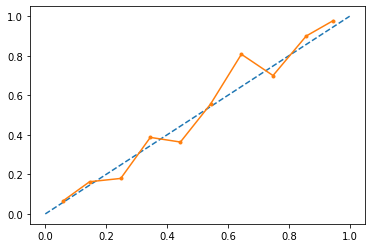

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.85      0.81       152
         1.0       0.83      0.76      0.80       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 0.001, n_estimator :200 max_faetures : 5, max_depth : 3 


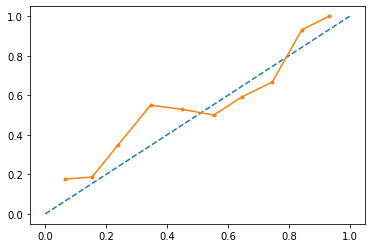

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.77      0.71       152
         1.0       0.72      0.61      0.66       152

    accuracy                           0.69       304
   macro avg       0.69      0.69      0.69       304
weighted avg       0.69      0.69      0.69       304

learning rate: 0.001, n_estimator :200 max_faetures : 5, max_depth : 4 


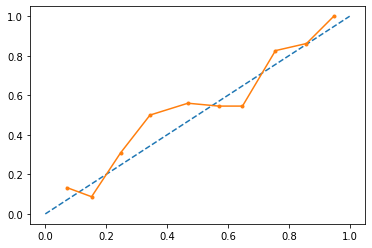

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.78      0.76       152
         1.0       0.77      0.71      0.74       152

    accuracy                           0.75       304
   macro avg       0.75      0.75      0.75       304
weighted avg       0.75      0.75      0.75       304

learning rate: 0.001, n_estimator :200 max_faetures : 5, max_depth : 5 


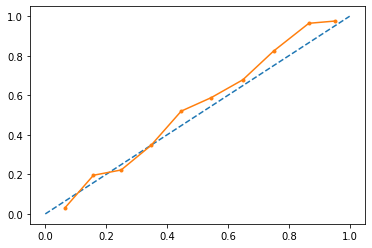

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.84      0.80       152
         1.0       0.82      0.73      0.77       152

    accuracy                           0.79       304
   macro avg       0.79      0.79      0.79       304
weighted avg       0.79      0.79      0.79       304

learning rate: 0.1, n_estimator :100 max_faetures : 2, max_depth : 3 


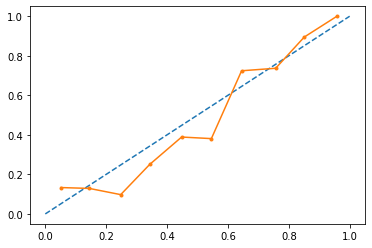

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.81      0.81       152
         1.0       0.81      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.1, n_estimator :100 max_faetures : 2, max_depth : 4 


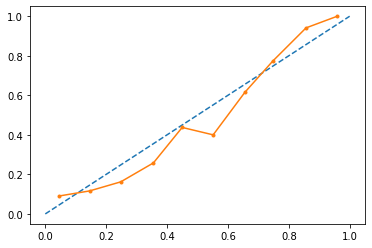

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :100 max_faetures : 2, max_depth : 5 


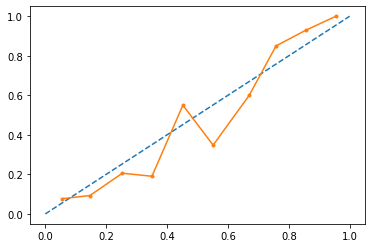

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.84      0.81      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :100 max_faetures : 3, max_depth : 3 


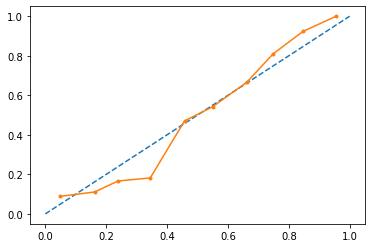

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :100 max_faetures : 3, max_depth : 4 


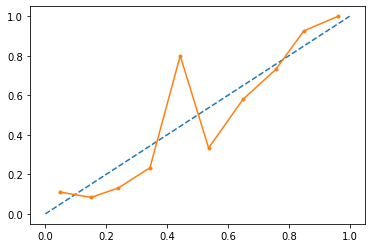

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.81      0.81       152
         1.0       0.81      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.1, n_estimator :100 max_faetures : 3, max_depth : 5 


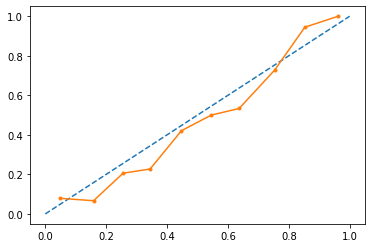

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :100 max_faetures : 4, max_depth : 3 


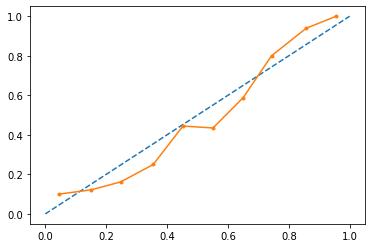

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.1, n_estimator :100 max_faetures : 4, max_depth : 4 


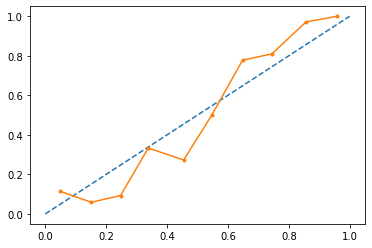

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.89      0.87       152
         1.0       0.89      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.1, n_estimator :100 max_faetures : 4, max_depth : 5 


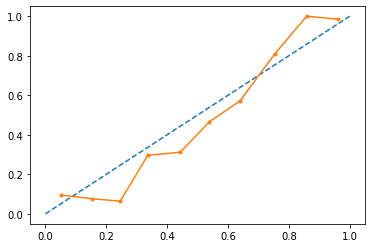

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :100 max_faetures : 5, max_depth : 3 


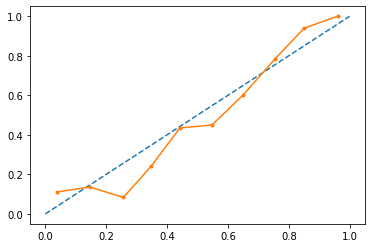

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.83      0.82      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :100 max_faetures : 5, max_depth : 4 


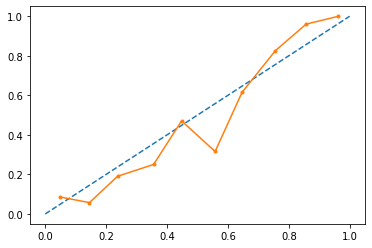

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :100 max_faetures : 5, max_depth : 5 


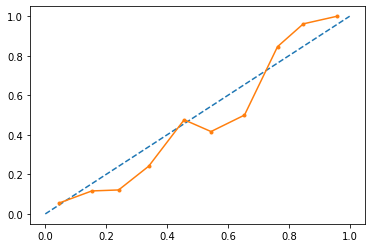

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :120 max_faetures : 2, max_depth : 3 


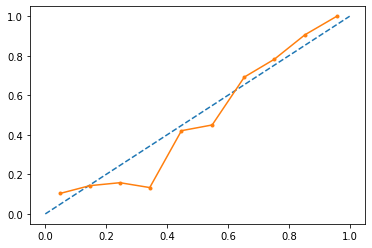

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.82      0.83       152
         1.0       0.82      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :120 max_faetures : 2, max_depth : 4 


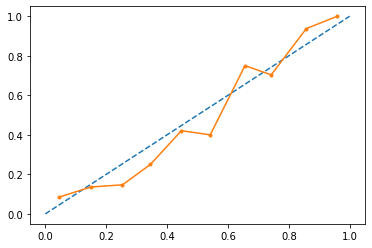

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :120 max_faetures : 2, max_depth : 5 


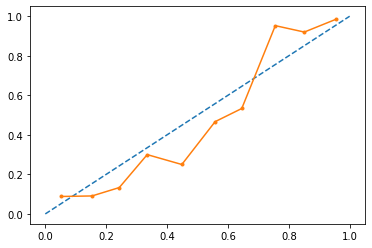

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :120 max_faetures : 3, max_depth : 3 


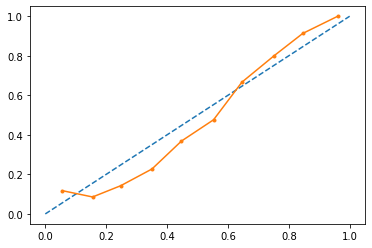

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :120 max_faetures : 3, max_depth : 4 


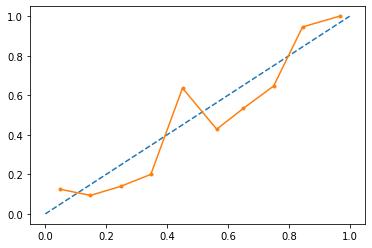

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.82      0.83       152
         1.0       0.82      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :120 max_faetures : 3, max_depth : 5 


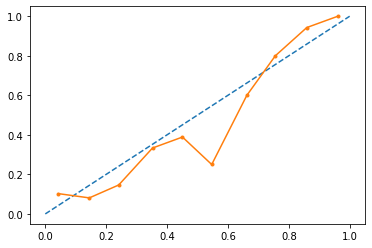

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :120 max_faetures : 4, max_depth : 3 


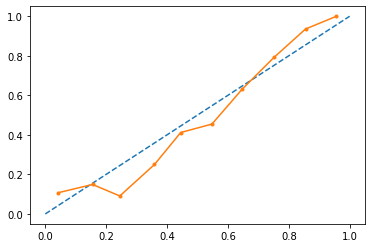

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.83      0.83       152
         1.0       0.83      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :120 max_faetures : 4, max_depth : 4 


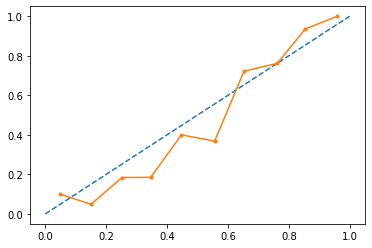

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.84      0.84       152
         1.0       0.84      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :120 max_faetures : 4, max_depth : 5 


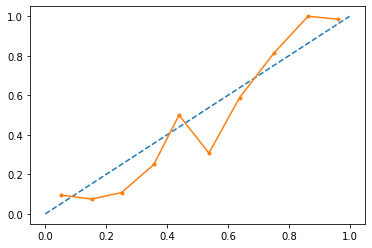

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :120 max_faetures : 5, max_depth : 3 


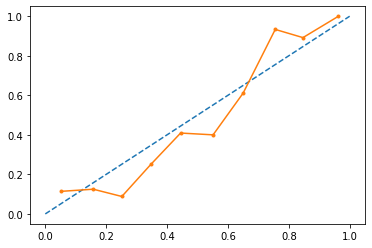

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :120 max_faetures : 5, max_depth : 4 


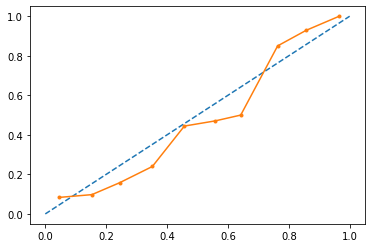

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :120 max_faetures : 5, max_depth : 5 


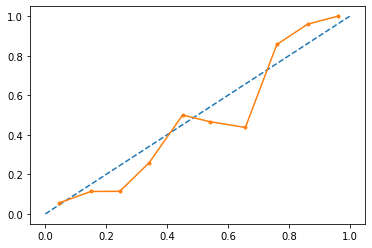

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :150 max_faetures : 2, max_depth : 3 


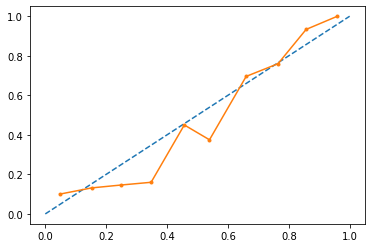

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.83      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :150 max_faetures : 2, max_depth : 4 


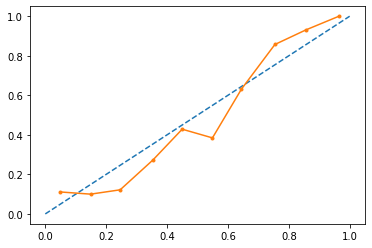

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :150 max_faetures : 2, max_depth : 5 


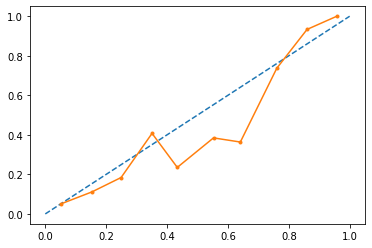

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :150 max_faetures : 3, max_depth : 3 


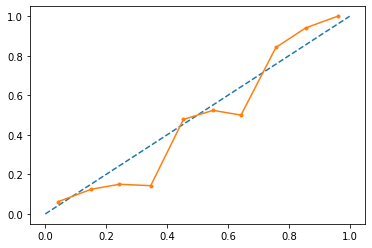

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :150 max_faetures : 3, max_depth : 4 


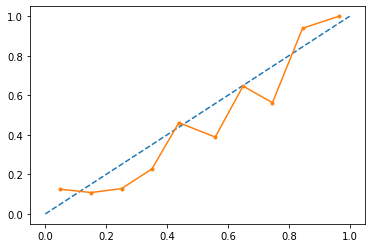

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.83      0.83       152
         1.0       0.83      0.84      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :150 max_faetures : 3, max_depth : 5 


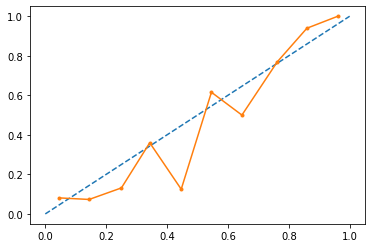

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.89      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.1, n_estimator :150 max_faetures : 4, max_depth : 3 


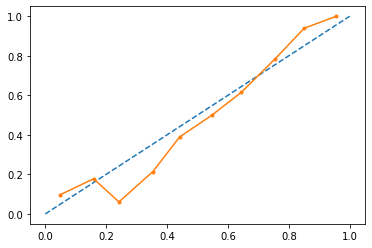

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :150 max_faetures : 4, max_depth : 4 


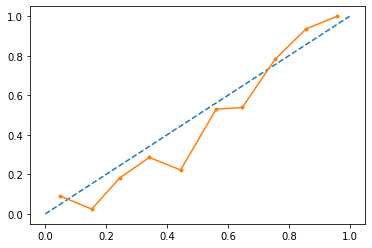

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :150 max_faetures : 4, max_depth : 5 


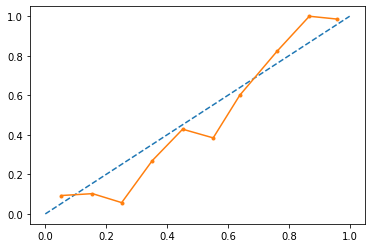

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.87       152
         1.0       0.88      0.85      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.1, n_estimator :150 max_faetures : 5, max_depth : 3 


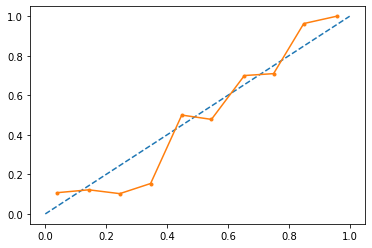

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :150 max_faetures : 5, max_depth : 4 


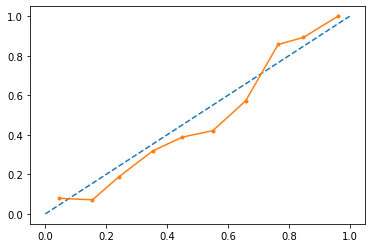

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :150 max_faetures : 5, max_depth : 5 


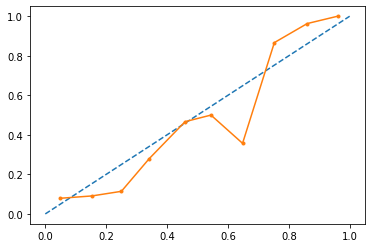

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :180 max_faetures : 2, max_depth : 3 


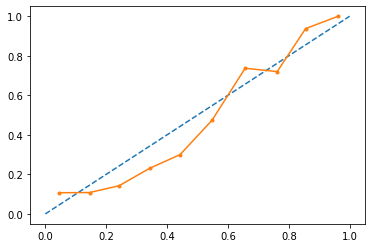

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :180 max_faetures : 2, max_depth : 4 


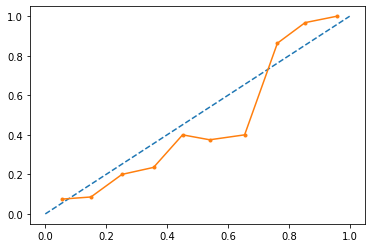

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :180 max_faetures : 2, max_depth : 5 


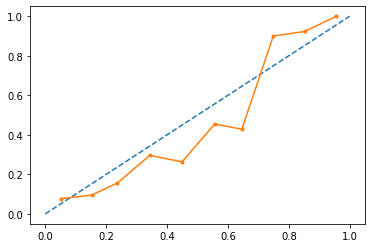

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :180 max_faetures : 3, max_depth : 3 


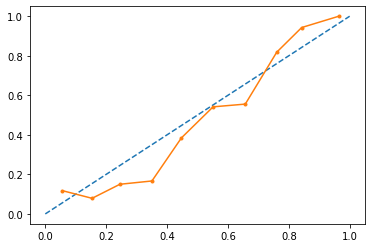

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.84      0.84       152
         1.0       0.84      0.86      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :180 max_faetures : 3, max_depth : 4 


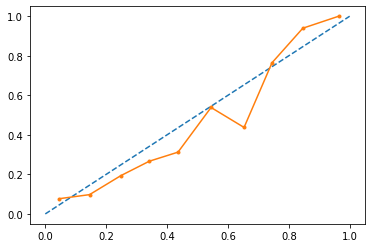

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.83      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :180 max_faetures : 3, max_depth : 5 


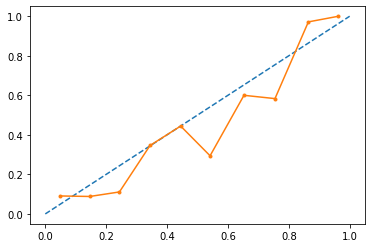

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :180 max_faetures : 4, max_depth : 3 


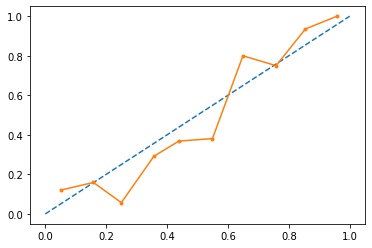

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :180 max_faetures : 4, max_depth : 4 


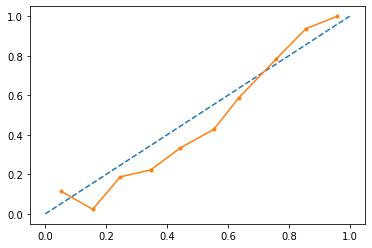

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :180 max_faetures : 4, max_depth : 5 


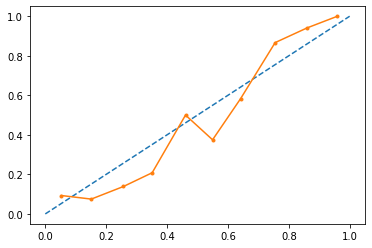

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :180 max_faetures : 5, max_depth : 3 


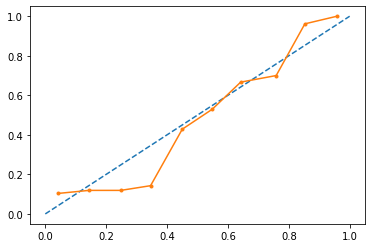

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :180 max_faetures : 5, max_depth : 4 


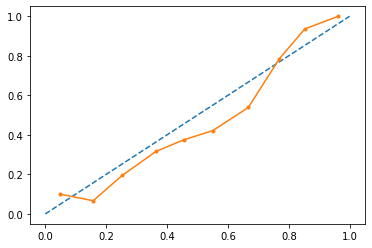

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :180 max_faetures : 5, max_depth : 5 


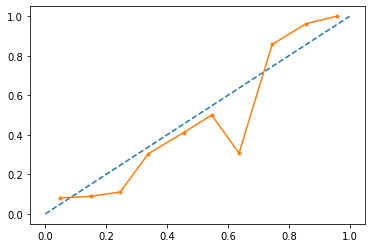

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :200 max_faetures : 2, max_depth : 3 


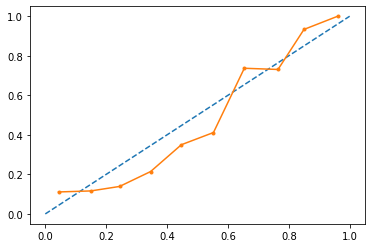

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.84       152
         1.0       0.84      0.83      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :200 max_faetures : 2, max_depth : 4 


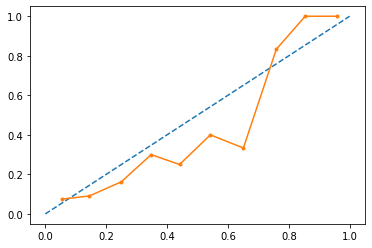

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :200 max_faetures : 2, max_depth : 5 


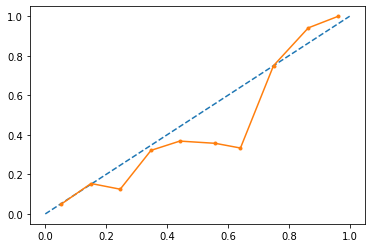

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :200 max_faetures : 3, max_depth : 3 


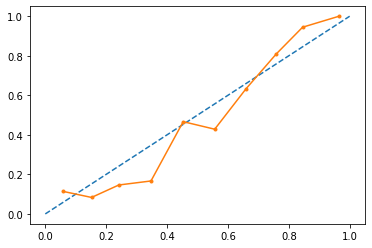

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :200 max_faetures : 3, max_depth : 4 


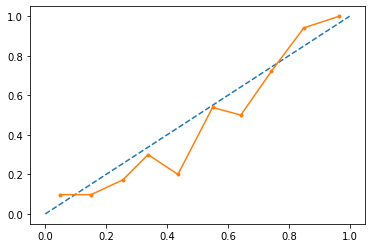

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :200 max_faetures : 3, max_depth : 5 


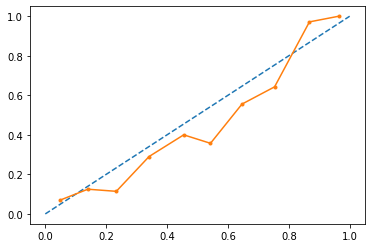

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :200 max_faetures : 4, max_depth : 3 


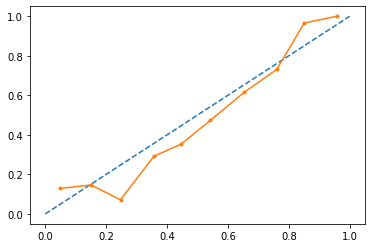

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :200 max_faetures : 4, max_depth : 4 


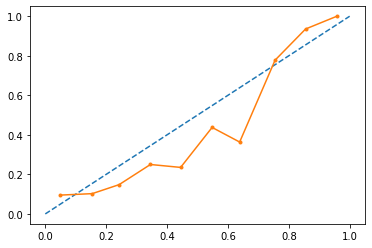

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.1, n_estimator :200 max_faetures : 4, max_depth : 5 


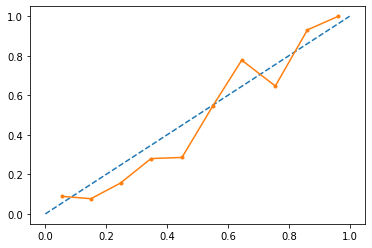

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.89      0.87       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.1, n_estimator :200 max_faetures : 5, max_depth : 3 


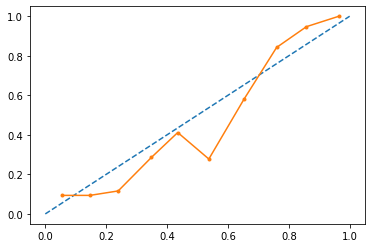

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.83      0.83       152
         1.0       0.83      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.1, n_estimator :200 max_faetures : 5, max_depth : 4 


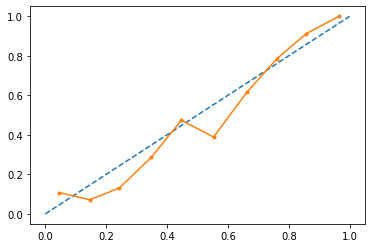

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.1, n_estimator :200 max_faetures : 5, max_depth : 5 


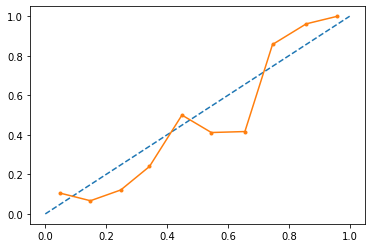

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :100 max_faetures : 2, max_depth : 3 


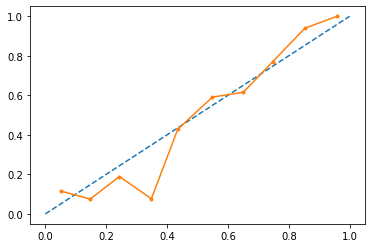

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :100 max_faetures : 2, max_depth : 4 


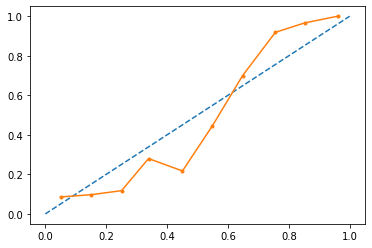

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.87       152
         1.0       0.88      0.85      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :100 max_faetures : 2, max_depth : 5 


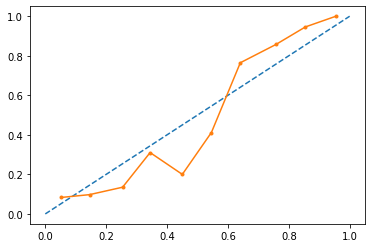

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :100 max_faetures : 3, max_depth : 3 


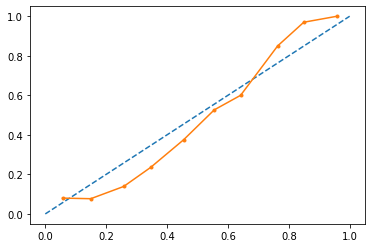

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :100 max_faetures : 3, max_depth : 4 


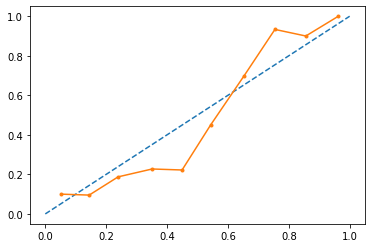

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.86       152
         1.0       0.86      0.85      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :100 max_faetures : 3, max_depth : 5 


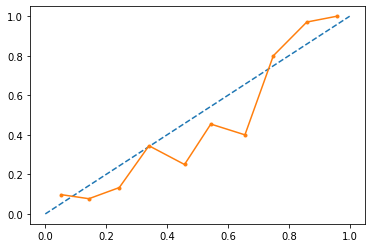

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :100 max_faetures : 4, max_depth : 3 


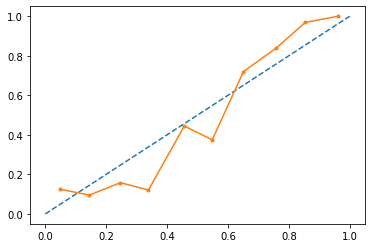

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :100 max_faetures : 4, max_depth : 4 


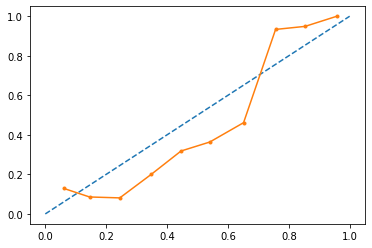

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :100 max_faetures : 4, max_depth : 5 


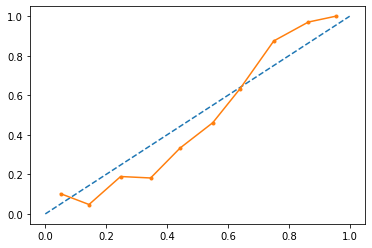

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.89      0.87       152
         1.0       0.88      0.85      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :100 max_faetures : 5, max_depth : 3 


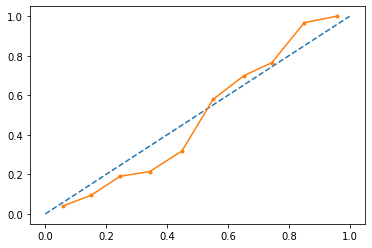

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :100 max_faetures : 5, max_depth : 4 


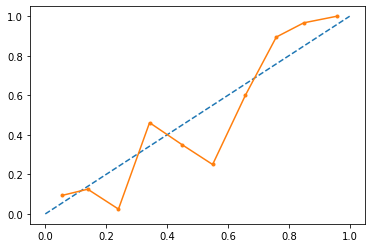

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :100 max_faetures : 5, max_depth : 5 


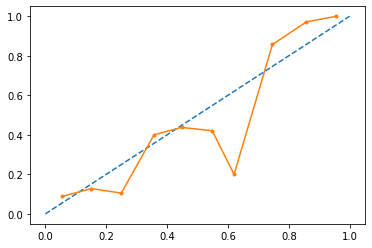

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :120 max_faetures : 2, max_depth : 3 


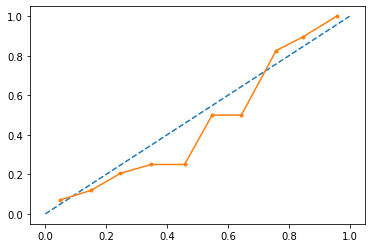

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :120 max_faetures : 2, max_depth : 4 


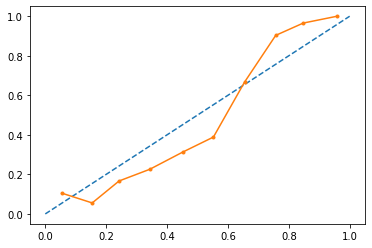

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :120 max_faetures : 2, max_depth : 5 


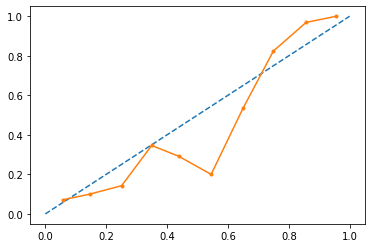

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 3, max_depth : 3 


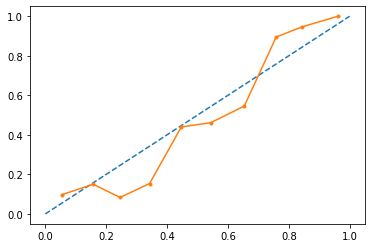

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :120 max_faetures : 3, max_depth : 4 


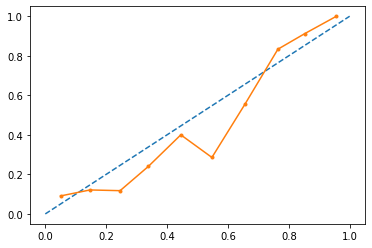

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 3, max_depth : 5 


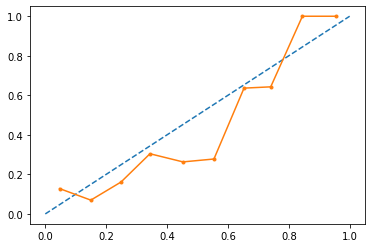

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 4, max_depth : 3 


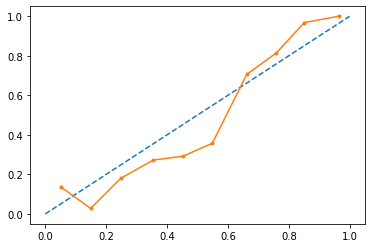

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 4, max_depth : 4 


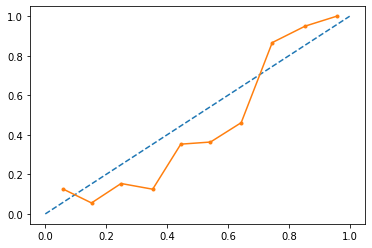

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.84      0.85       152
         1.0       0.85      0.86      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 4, max_depth : 5 


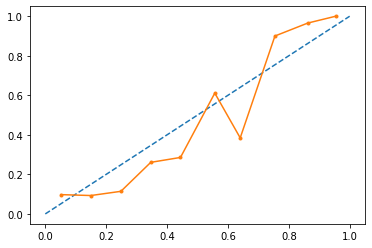

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :120 max_faetures : 5, max_depth : 3 


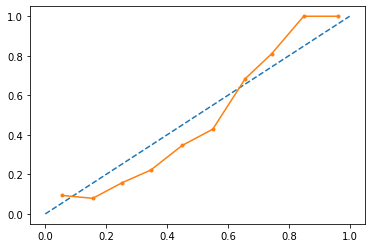

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.86       152
         1.0       0.87      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 5, max_depth : 4 


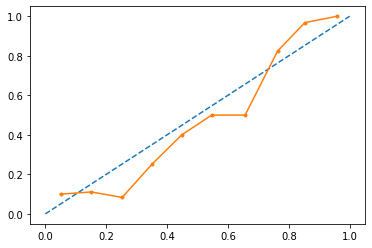

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.90      0.86       152
         1.0       0.89      0.81      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.85       304
weighted avg       0.86      0.86      0.85       304

learning rate: 0.2, n_estimator :120 max_faetures : 5, max_depth : 5 


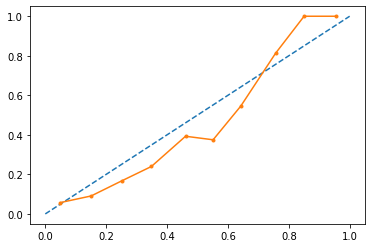

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :150 max_faetures : 2, max_depth : 3 


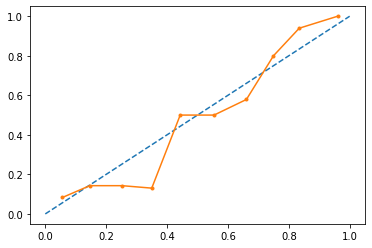

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :150 max_faetures : 2, max_depth : 4 


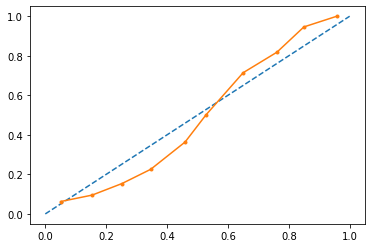

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.91      0.87       152
         1.0       0.91      0.82      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :150 max_faetures : 2, max_depth : 5 


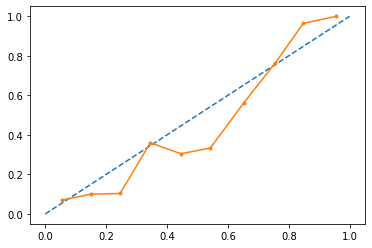

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :150 max_faetures : 3, max_depth : 3 


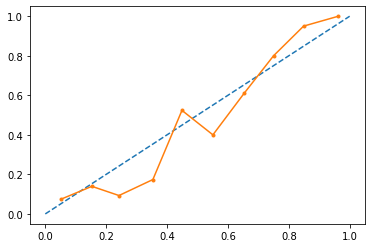

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :150 max_faetures : 3, max_depth : 4 


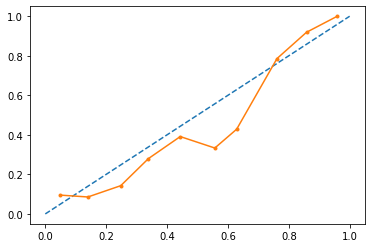

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :150 max_faetures : 3, max_depth : 5 


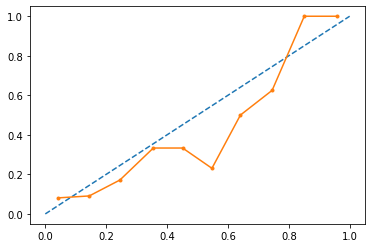

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :150 max_faetures : 4, max_depth : 3 


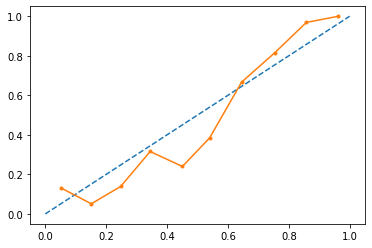

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :150 max_faetures : 4, max_depth : 4 


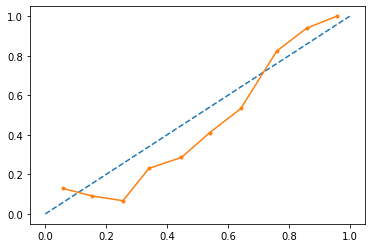

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :150 max_faetures : 4, max_depth : 5 


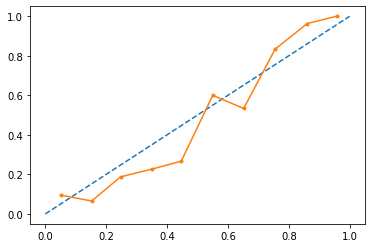

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.89      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :150 max_faetures : 5, max_depth : 3 


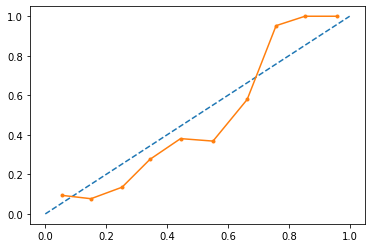

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :150 max_faetures : 5, max_depth : 4 


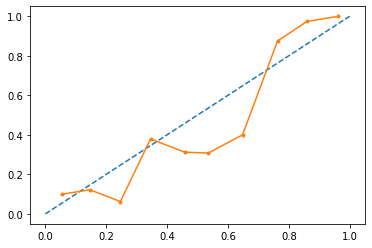

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :150 max_faetures : 5, max_depth : 5 


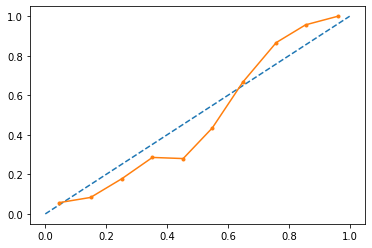

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :180 max_faetures : 2, max_depth : 3 


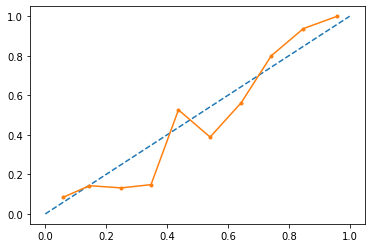

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :180 max_faetures : 2, max_depth : 4 


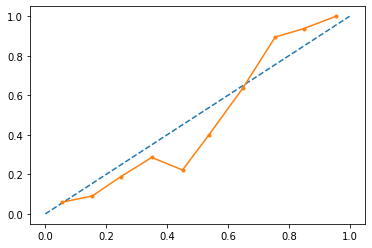

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :180 max_faetures : 2, max_depth : 5 


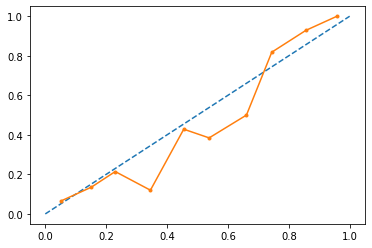

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.89      0.86       152
         1.0       0.88      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :180 max_faetures : 3, max_depth : 3 


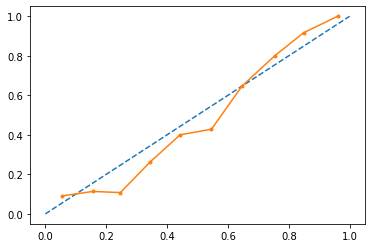

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :180 max_faetures : 3, max_depth : 4 


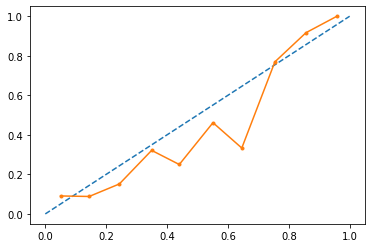

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :180 max_faetures : 3, max_depth : 5 


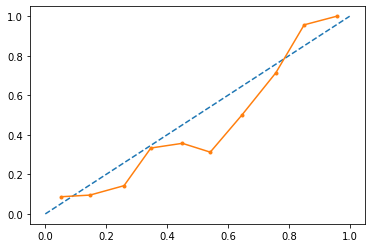

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :180 max_faetures : 4, max_depth : 3 


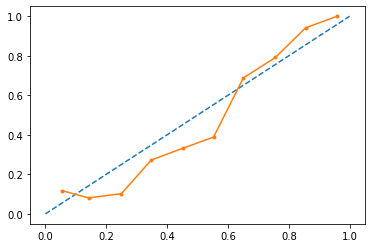

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :180 max_faetures : 4, max_depth : 4 


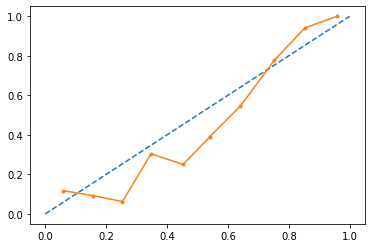

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :180 max_faetures : 4, max_depth : 5 


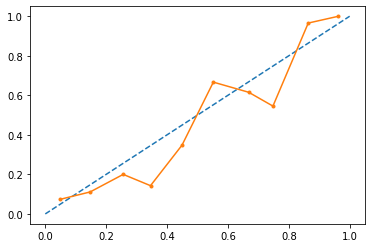

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.90      0.87       152
         1.0       0.89      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :180 max_faetures : 5, max_depth : 3 


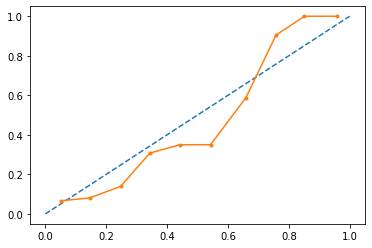

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :180 max_faetures : 5, max_depth : 4 


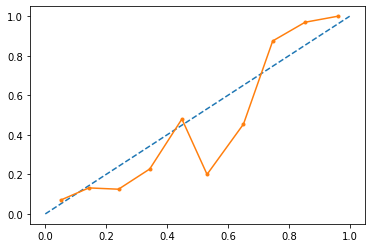

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :180 max_faetures : 5, max_depth : 5 


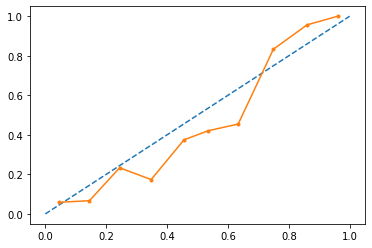

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :200 max_faetures : 2, max_depth : 3 


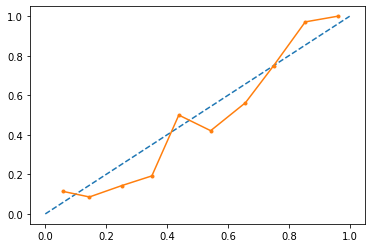

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :200 max_faetures : 2, max_depth : 4 


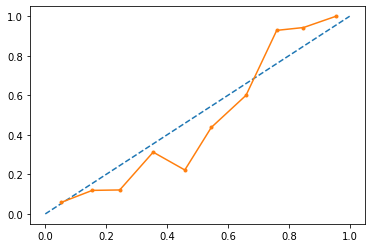

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :200 max_faetures : 2, max_depth : 5 


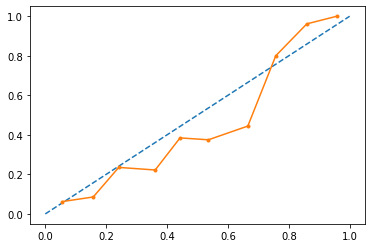

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :200 max_faetures : 3, max_depth : 3 


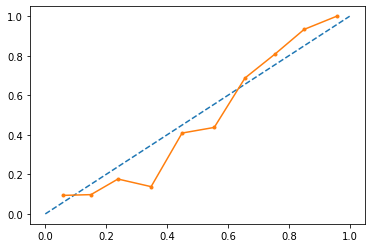

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :200 max_faetures : 3, max_depth : 4 


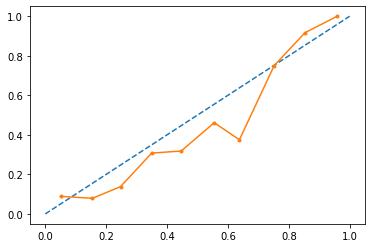

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :200 max_faetures : 3, max_depth : 5 


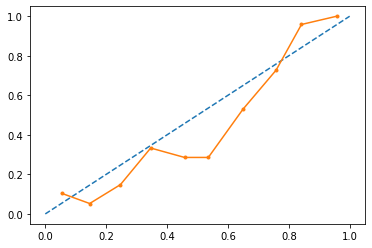

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :200 max_faetures : 4, max_depth : 3 


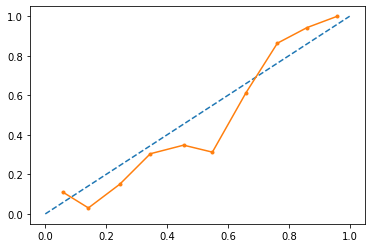

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.84       152
         1.0       0.84      0.83      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.2, n_estimator :200 max_faetures : 4, max_depth : 4 


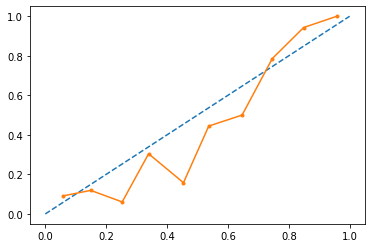

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.87       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :200 max_faetures : 4, max_depth : 5 


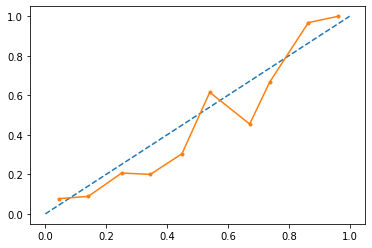

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.89      0.87       152
         1.0       0.89      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.2, n_estimator :200 max_faetures : 5, max_depth : 3 


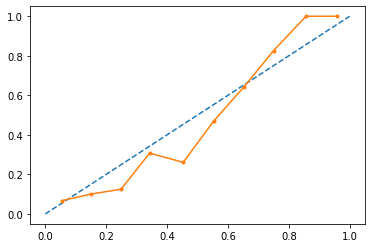

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.2, n_estimator :200 max_faetures : 5, max_depth : 4 


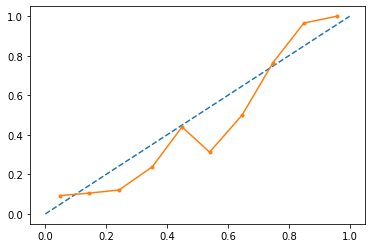

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.2, n_estimator :200 max_faetures : 5, max_depth : 5 


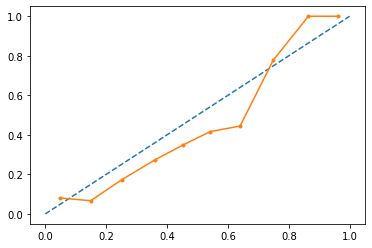

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :100 max_faetures : 2, max_depth : 3 


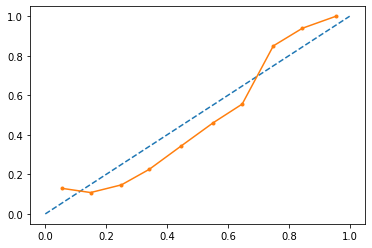

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.87      0.84       152
         1.0       0.86      0.80      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :100 max_faetures : 2, max_depth : 4 


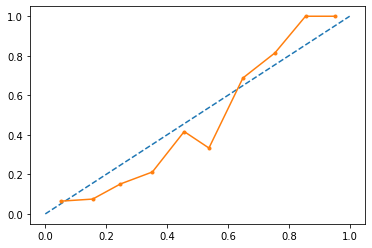

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :100 max_faetures : 2, max_depth : 5 


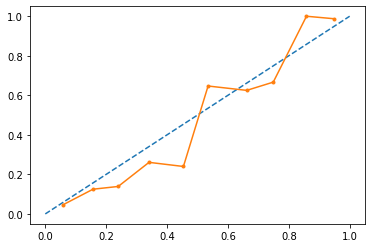

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.89      0.87       152
         1.0       0.89      0.85      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.3, n_estimator :100 max_faetures : 3, max_depth : 3 


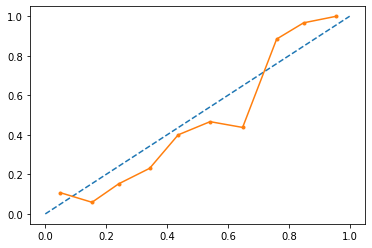

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :100 max_faetures : 3, max_depth : 4 


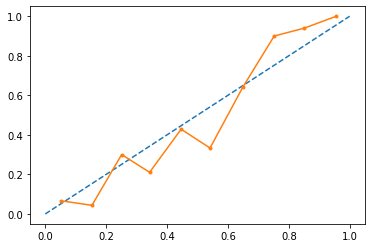

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.83      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :100 max_faetures : 3, max_depth : 5 


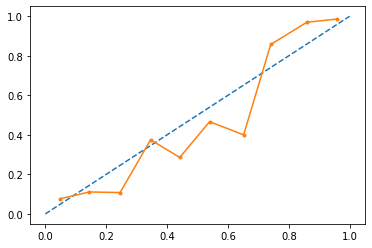

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :100 max_faetures : 4, max_depth : 3 


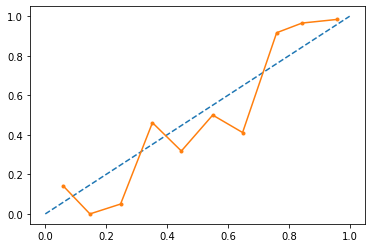

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :100 max_faetures : 4, max_depth : 4 


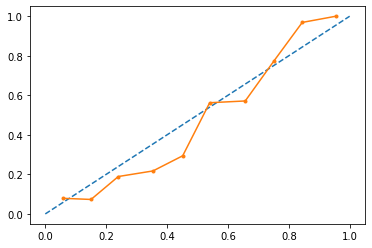

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :100 max_faetures : 4, max_depth : 5 


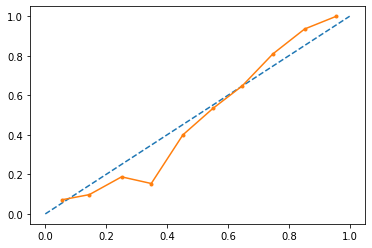

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :100 max_faetures : 5, max_depth : 3 


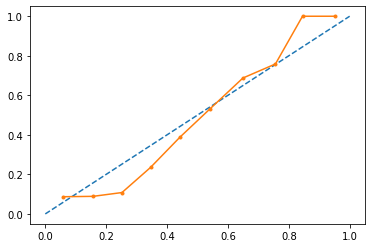

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :100 max_faetures : 5, max_depth : 4 


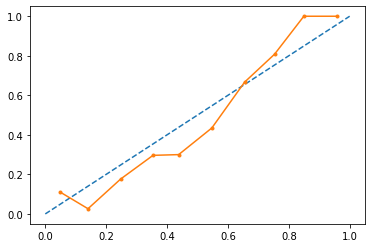

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :100 max_faetures : 5, max_depth : 5 


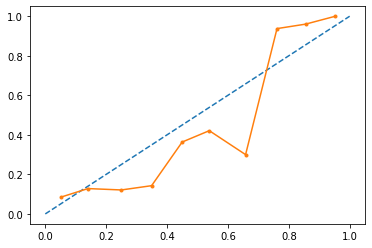

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :120 max_faetures : 2, max_depth : 3 


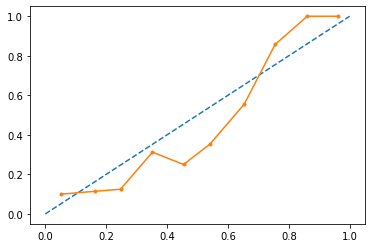

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :120 max_faetures : 2, max_depth : 4 


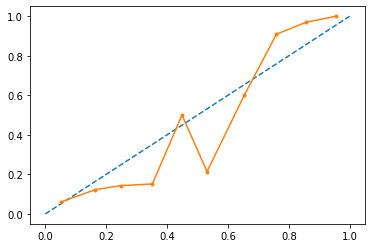

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :120 max_faetures : 2, max_depth : 5 


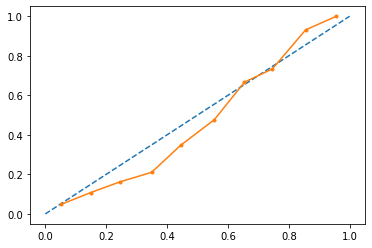

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :120 max_faetures : 3, max_depth : 3 


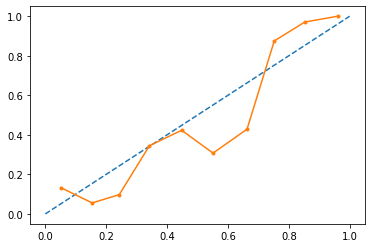

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.86      0.83       152
         1.0       0.85      0.80      0.82       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.3, n_estimator :120 max_faetures : 3, max_depth : 4 


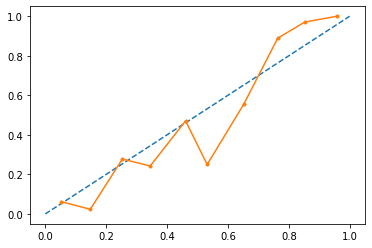

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.84       152
         1.0       0.86      0.81      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :120 max_faetures : 3, max_depth : 5 


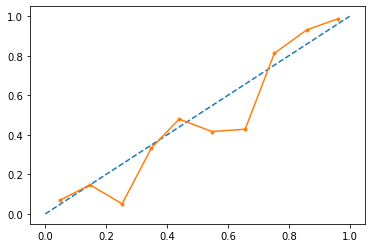

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :120 max_faetures : 4, max_depth : 3 


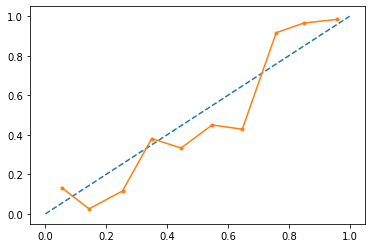

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.84       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :120 max_faetures : 4, max_depth : 4 


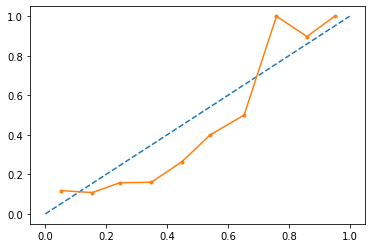

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :120 max_faetures : 4, max_depth : 5 


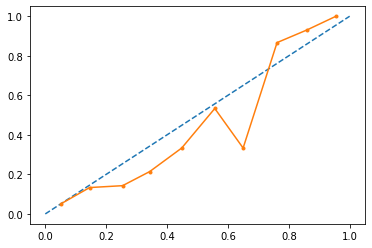

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :120 max_faetures : 5, max_depth : 3 


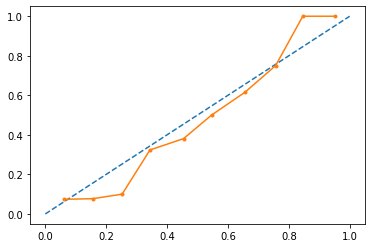

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :120 max_faetures : 5, max_depth : 4 


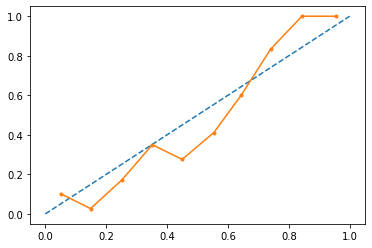

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :120 max_faetures : 5, max_depth : 5 


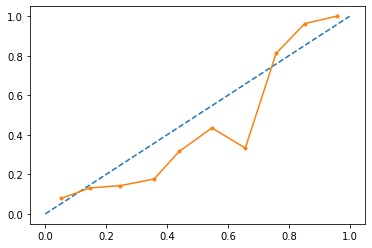

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :150 max_faetures : 2, max_depth : 3 


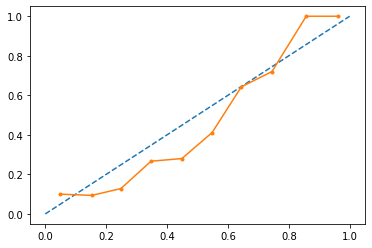

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :150 max_faetures : 2, max_depth : 4 


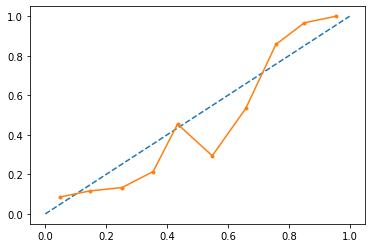

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :150 max_faetures : 2, max_depth : 5 


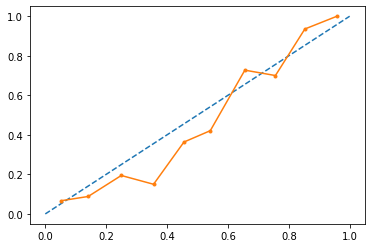

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :150 max_faetures : 3, max_depth : 3 


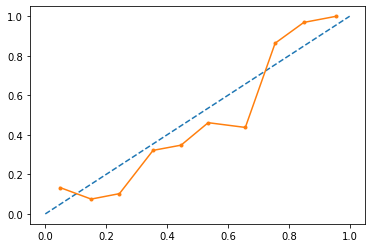

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :150 max_faetures : 3, max_depth : 4 


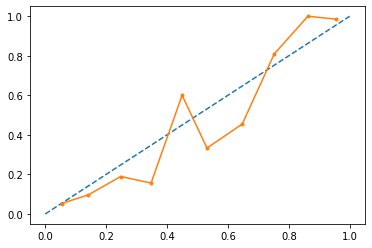

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.85      0.83       152
         1.0       0.84      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.3, n_estimator :150 max_faetures : 3, max_depth : 5 


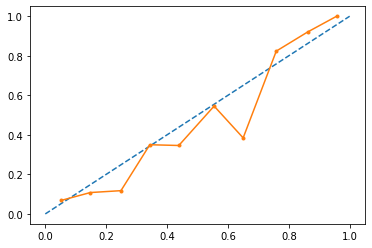

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.86       152
         1.0       0.87      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :150 max_faetures : 4, max_depth : 3 


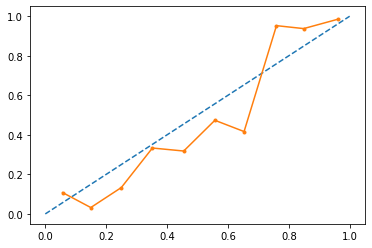

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :150 max_faetures : 4, max_depth : 4 


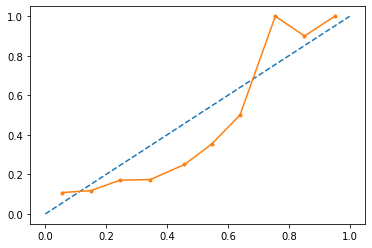

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.86       152
         1.0       0.86      0.85      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :150 max_faetures : 4, max_depth : 5 


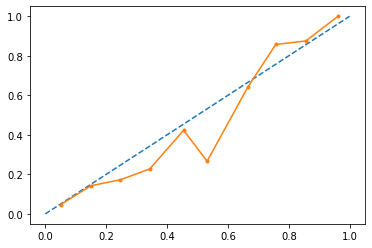

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.84       152
         1.0       0.87      0.80      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :150 max_faetures : 5, max_depth : 3 


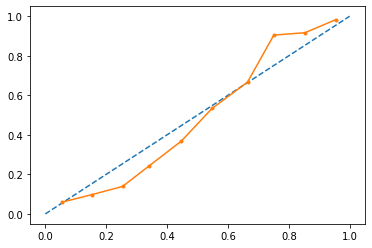

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :150 max_faetures : 5, max_depth : 4 


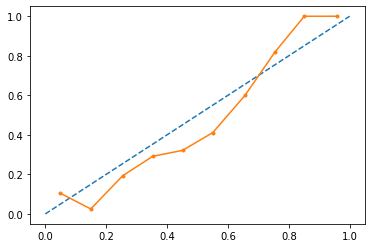

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.86       152
         1.0       0.87      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :150 max_faetures : 5, max_depth : 5 


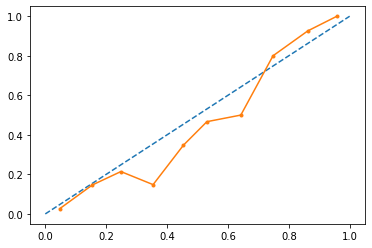

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :180 max_faetures : 2, max_depth : 3 


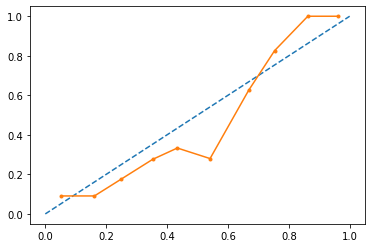

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.82      0.83       152
         1.0       0.82      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.3, n_estimator :180 max_faetures : 2, max_depth : 4 


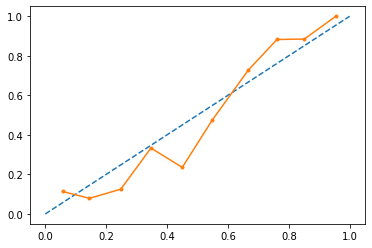

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :180 max_faetures : 2, max_depth : 5 


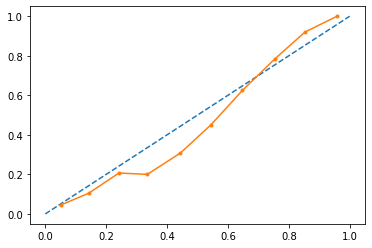

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :180 max_faetures : 3, max_depth : 3 


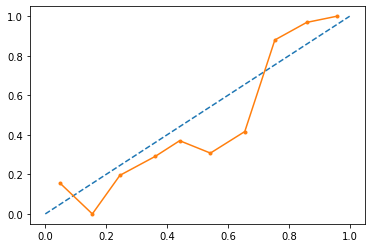

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.87      0.84       152
         1.0       0.86      0.80      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :180 max_faetures : 3, max_depth : 4 


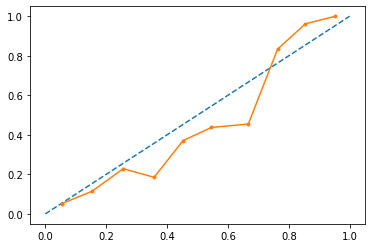

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :180 max_faetures : 3, max_depth : 5 


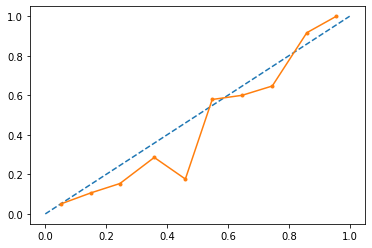

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.87      0.86      0.86       152
         1.0       0.86      0.87      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :180 max_faetures : 4, max_depth : 3 


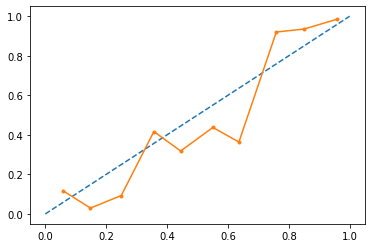

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.83      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :180 max_faetures : 4, max_depth : 4 


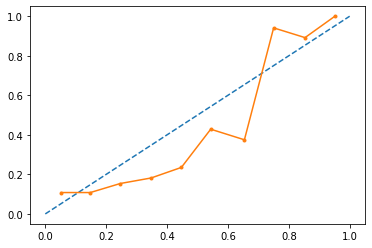

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :180 max_faetures : 4, max_depth : 5 


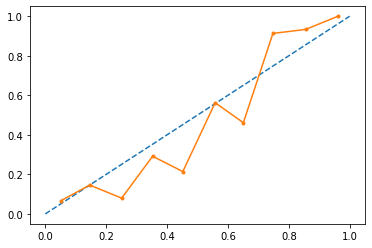

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.3, n_estimator :180 max_faetures : 5, max_depth : 3 


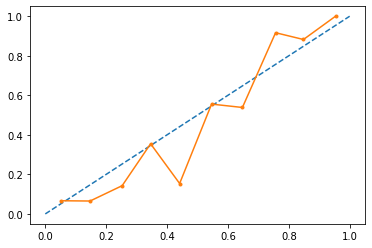

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :180 max_faetures : 5, max_depth : 4 


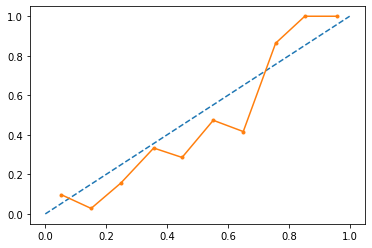

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :180 max_faetures : 5, max_depth : 5 


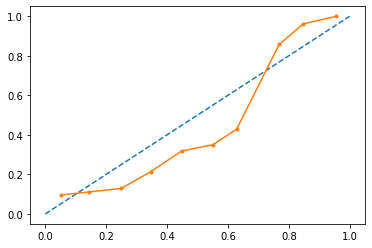

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.86       152
         1.0       0.86      0.85      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :200 max_faetures : 2, max_depth : 3 


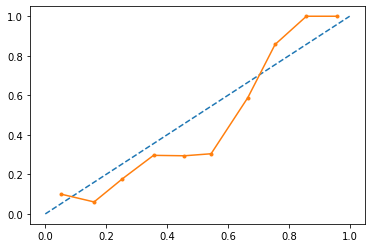

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.83      0.83       152
         1.0       0.83      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.3, n_estimator :200 max_faetures : 2, max_depth : 4 


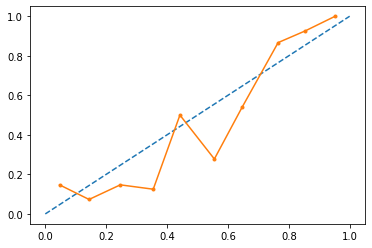

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.85      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.3, n_estimator :200 max_faetures : 2, max_depth : 5 


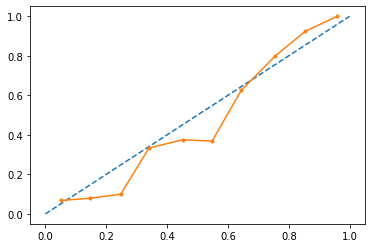

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :200 max_faetures : 3, max_depth : 3 


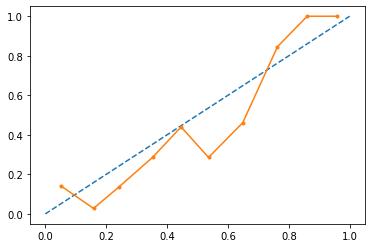

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.86      0.84       152
         1.0       0.85      0.80      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.3, n_estimator :200 max_faetures : 3, max_depth : 4 


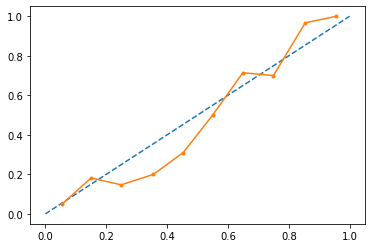

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.89      0.86       152
         1.0       0.88      0.82      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :200 max_faetures : 3, max_depth : 5 


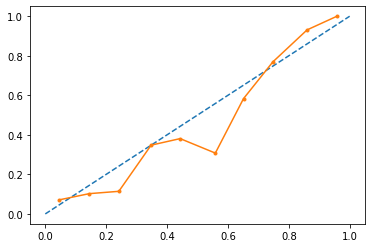

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.3, n_estimator :200 max_faetures : 4, max_depth : 3 


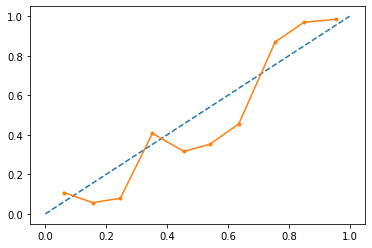

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.3, n_estimator :200 max_faetures : 4, max_depth : 4 


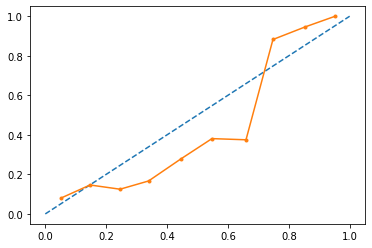

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :200 max_faetures : 4, max_depth : 5 


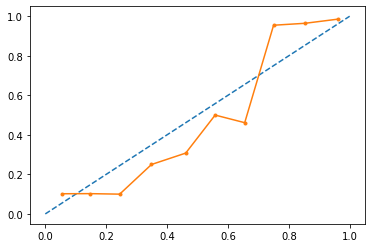

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.3, n_estimator :200 max_faetures : 5, max_depth : 3 


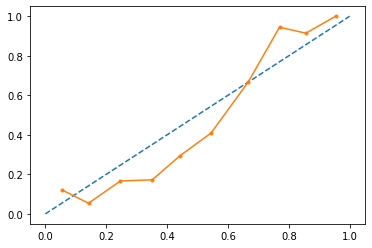

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :200 max_faetures : 5, max_depth : 4 


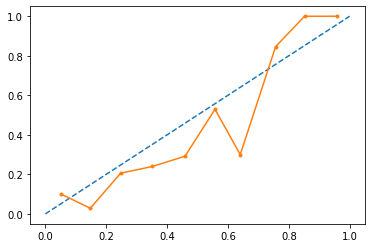

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.3, n_estimator :200 max_faetures : 5, max_depth : 5 


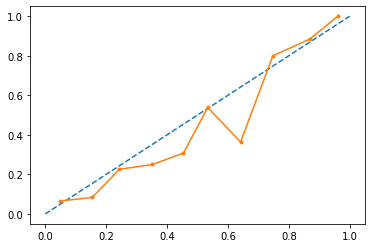

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :100 max_faetures : 2, max_depth : 3 


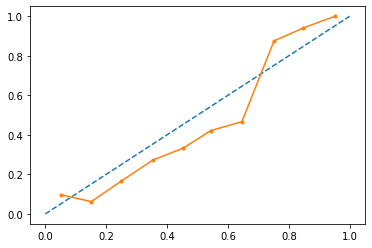

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.85      0.83       152
         1.0       0.84      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :100 max_faetures : 2, max_depth : 4 


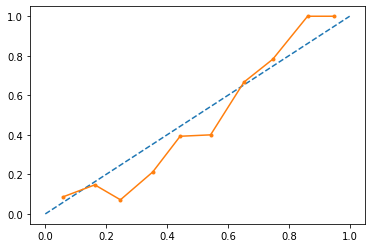

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :100 max_faetures : 2, max_depth : 5 


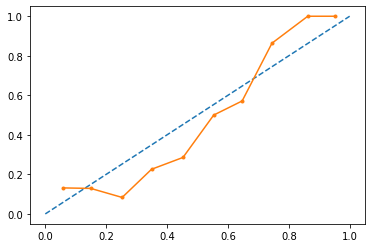

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.90      0.87       152
         1.0       0.89      0.82      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :100 max_faetures : 3, max_depth : 3 


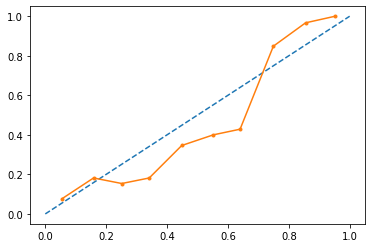

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.85      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :100 max_faetures : 3, max_depth : 4 


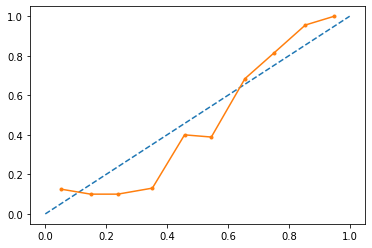

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :100 max_faetures : 3, max_depth : 5 


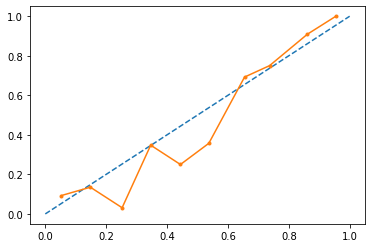

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :100 max_faetures : 4, max_depth : 3 


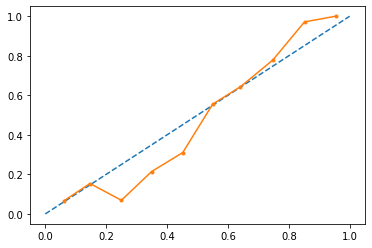

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :100 max_faetures : 4, max_depth : 4 


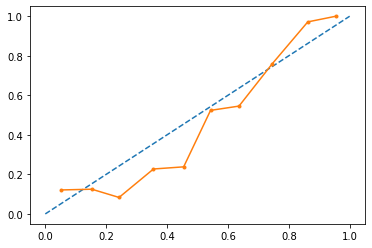

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :100 max_faetures : 4, max_depth : 5 


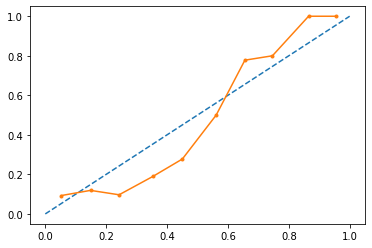

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :100 max_faetures : 5, max_depth : 3 


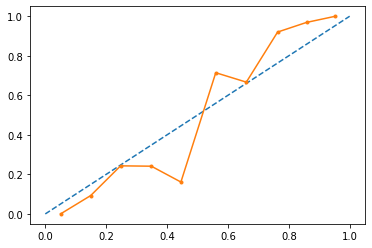

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.91      0.88       152
         1.0       0.90      0.84      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :100 max_faetures : 5, max_depth : 4 


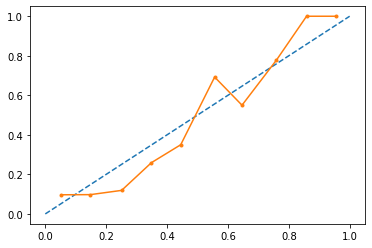

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.89      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :100 max_faetures : 5, max_depth : 5 


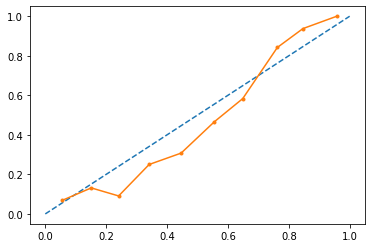

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :120 max_faetures : 2, max_depth : 3 


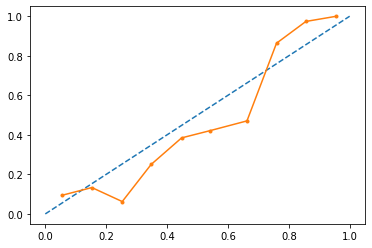

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.85      0.83       152
         1.0       0.84      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :120 max_faetures : 2, max_depth : 4 


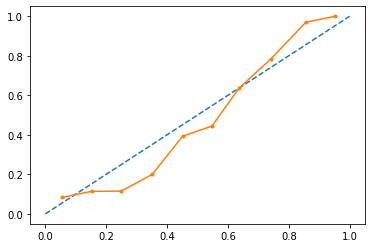

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :120 max_faetures : 2, max_depth : 5 


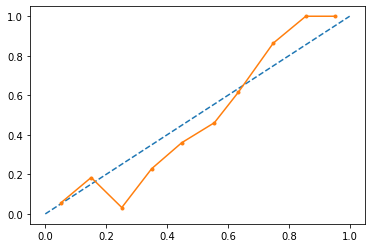

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.89      0.86       152
         1.0       0.89      0.82      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :120 max_faetures : 3, max_depth : 3 


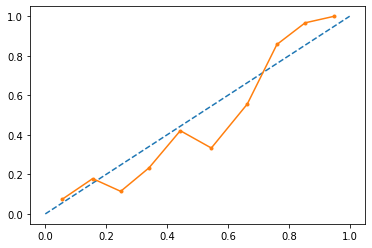

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 0.5, n_estimator :120 max_faetures : 3, max_depth : 4 


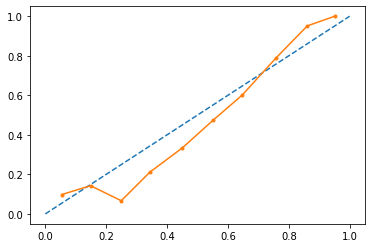

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.86      0.86       152
         1.0       0.86      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :120 max_faetures : 3, max_depth : 5 


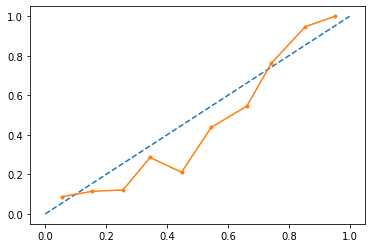

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.86       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :120 max_faetures : 4, max_depth : 3 


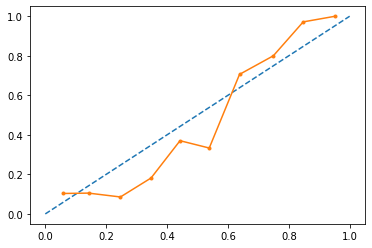

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :120 max_faetures : 4, max_depth : 4 


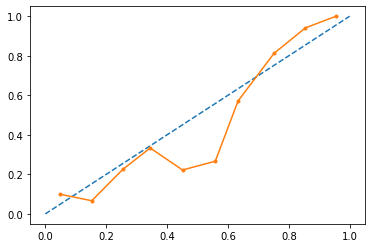

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :120 max_faetures : 4, max_depth : 5 


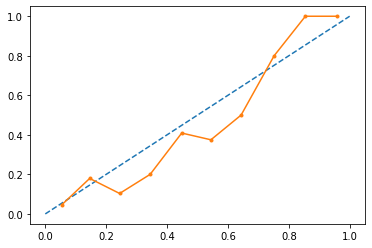

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :120 max_faetures : 5, max_depth : 3 


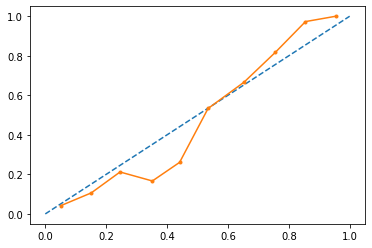

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :120 max_faetures : 5, max_depth : 4 


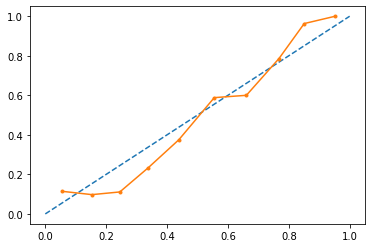

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :120 max_faetures : 5, max_depth : 5 


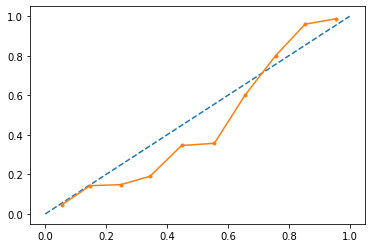

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :150 max_faetures : 2, max_depth : 3 


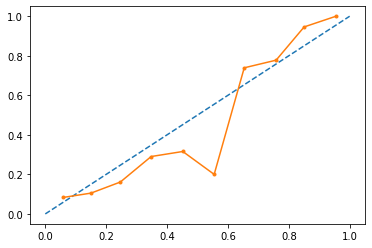

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :150 max_faetures : 2, max_depth : 4 


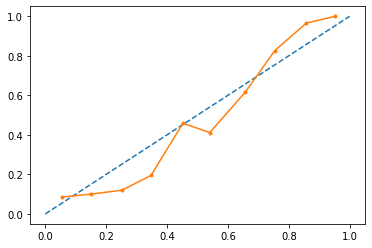

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :150 max_faetures : 2, max_depth : 5 


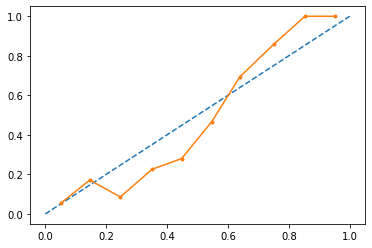

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.90      0.87       152
         1.0       0.89      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :150 max_faetures : 3, max_depth : 3 


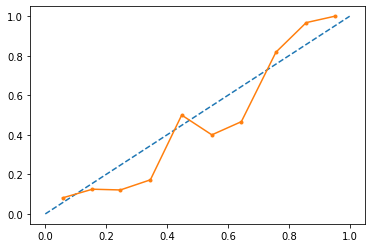

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.82      0.83       152
         1.0       0.82      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :150 max_faetures : 3, max_depth : 4 


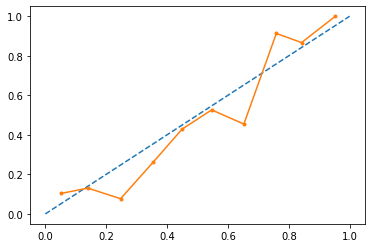

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :150 max_faetures : 3, max_depth : 5 


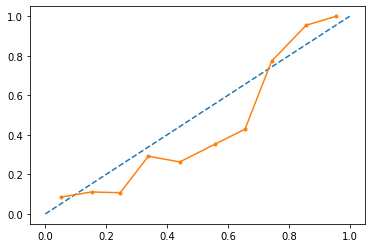

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.86       152
         1.0       0.86      0.85      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :150 max_faetures : 4, max_depth : 3 


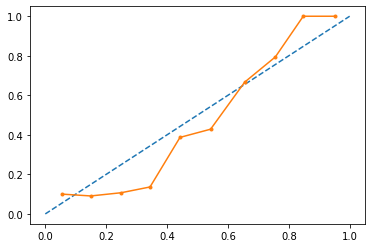

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :150 max_faetures : 4, max_depth : 4 


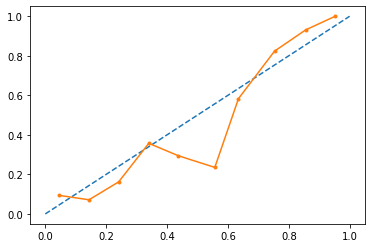

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :150 max_faetures : 4, max_depth : 5 


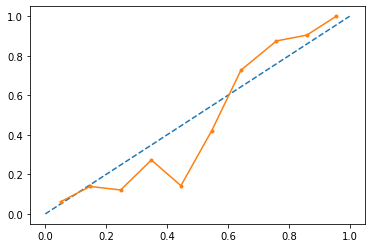

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.87      0.88      0.88       152
         1.0       0.88      0.87      0.87       152

    accuracy                           0.88       304
   macro avg       0.88      0.88      0.87       304
weighted avg       0.88      0.88      0.87       304

learning rate: 0.5, n_estimator :150 max_faetures : 5, max_depth : 3 


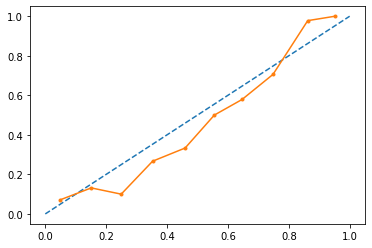

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.84       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :150 max_faetures : 5, max_depth : 4 


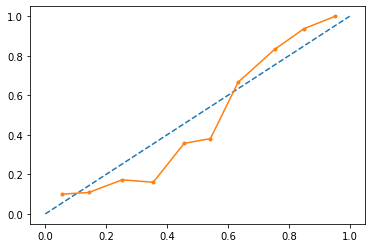

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :150 max_faetures : 5, max_depth : 5 


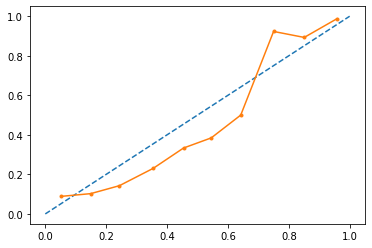

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :180 max_faetures : 2, max_depth : 3 


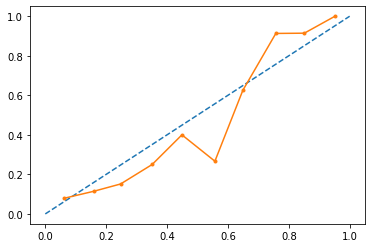

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :180 max_faetures : 2, max_depth : 4 


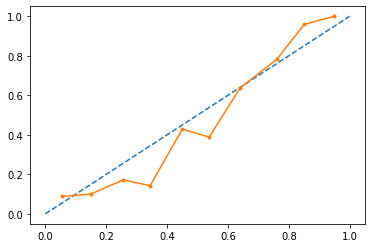

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :180 max_faetures : 2, max_depth : 5 


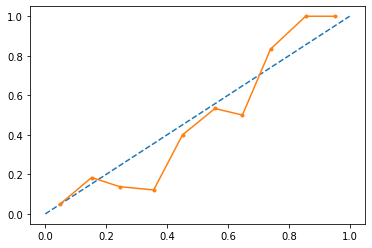

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :180 max_faetures : 3, max_depth : 3 


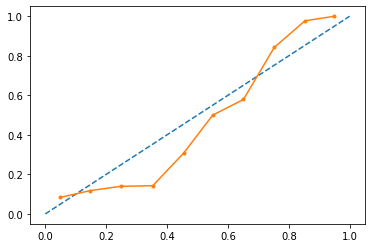

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :180 max_faetures : 3, max_depth : 4 


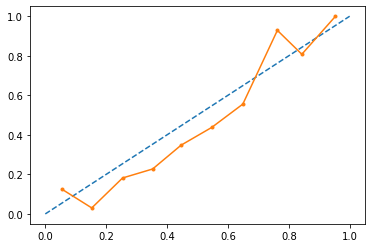

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :180 max_faetures : 3, max_depth : 5 


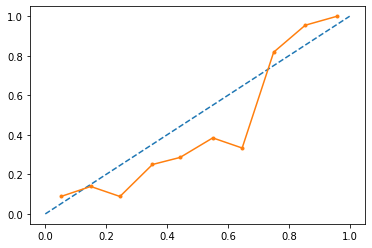

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :180 max_faetures : 4, max_depth : 3 


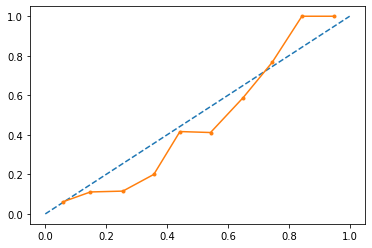

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :180 max_faetures : 4, max_depth : 4 


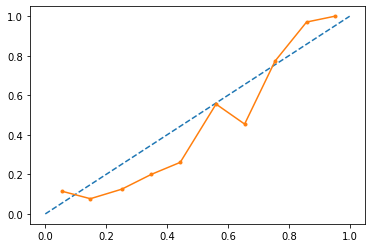

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.86       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :180 max_faetures : 4, max_depth : 5 


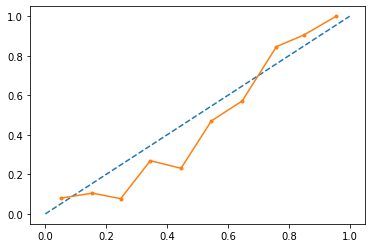

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.87      0.88      0.87       152
         1.0       0.87      0.87      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :180 max_faetures : 5, max_depth : 3 


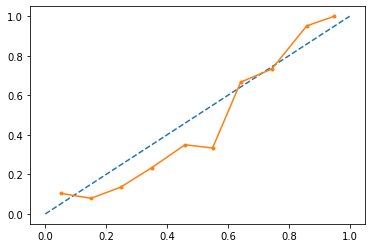

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.84       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :180 max_faetures : 5, max_depth : 4 


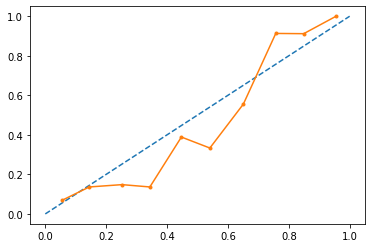

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.86       152
         1.0       0.86      0.85      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :180 max_faetures : 5, max_depth : 5 


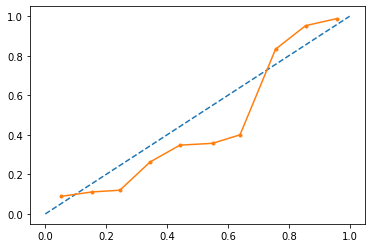

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :200 max_faetures : 2, max_depth : 3 


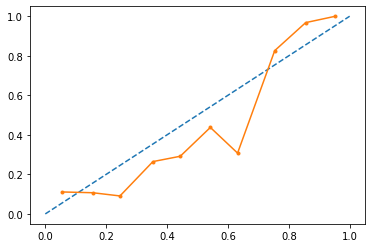

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 0.5, n_estimator :200 max_faetures : 2, max_depth : 4 


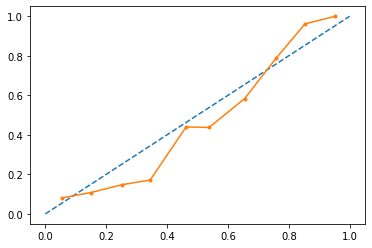

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.88      0.85       152
         1.0       0.87      0.81      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :200 max_faetures : 2, max_depth : 5 


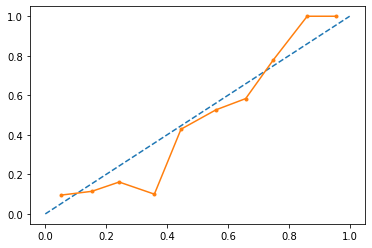

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :200 max_faetures : 3, max_depth : 3 


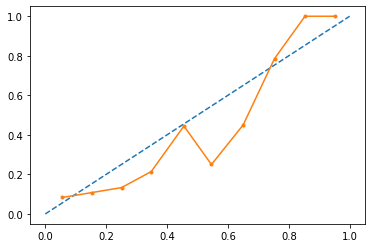

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.86      0.84       152
         1.0       0.85      0.81      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 0.5, n_estimator :200 max_faetures : 3, max_depth : 4 


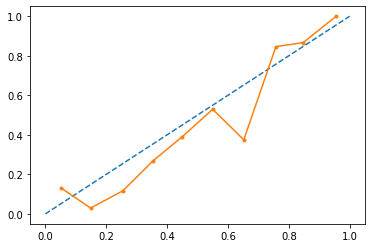

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :200 max_faetures : 3, max_depth : 5 


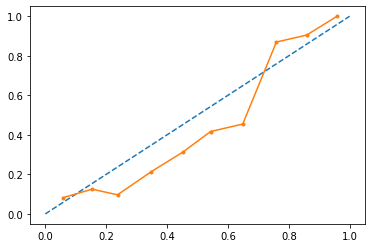

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.88      0.87       152
         1.0       0.88      0.86      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :200 max_faetures : 4, max_depth : 3 


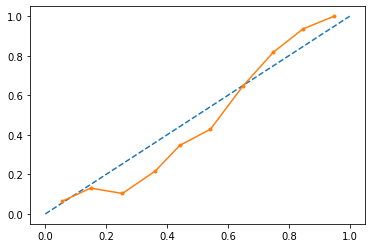

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :200 max_faetures : 4, max_depth : 4 


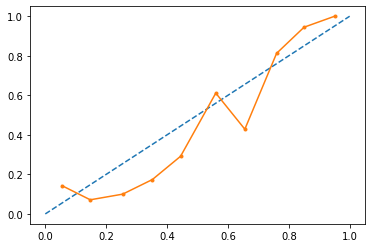

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.86       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 0.5, n_estimator :200 max_faetures : 4, max_depth : 5 


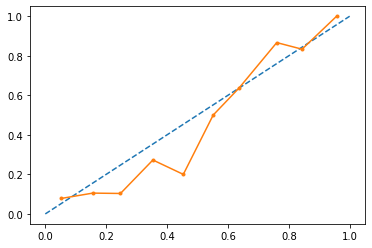

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.87      0.89      0.88       152
         1.0       0.89      0.87      0.88       152

    accuracy                           0.88       304
   macro avg       0.88      0.88      0.88       304
weighted avg       0.88      0.88      0.88       304

learning rate: 0.5, n_estimator :200 max_faetures : 5, max_depth : 3 


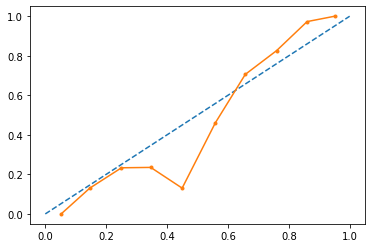

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.89      0.87       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 0.5, n_estimator :200 max_faetures : 5, max_depth : 4 


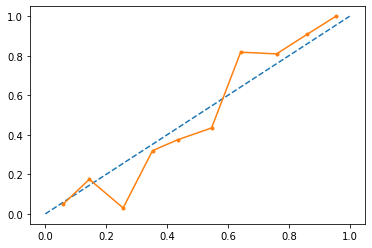

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 0.5, n_estimator :200 max_faetures : 5, max_depth : 5 


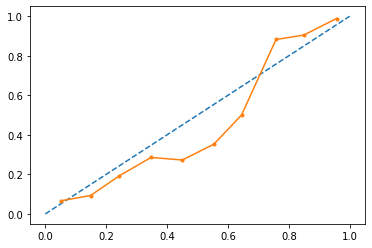

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :100 max_faetures : 2, max_depth : 3 


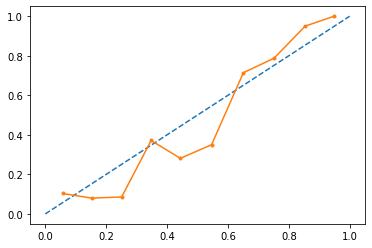

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.83      0.82       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 1, n_estimator :100 max_faetures : 2, max_depth : 4 


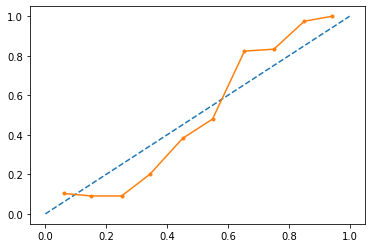

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :100 max_faetures : 2, max_depth : 5 


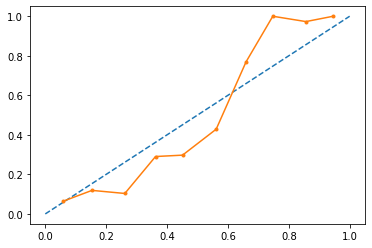

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.92      0.87       152
         1.0       0.91      0.80      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :100 max_faetures : 3, max_depth : 3 


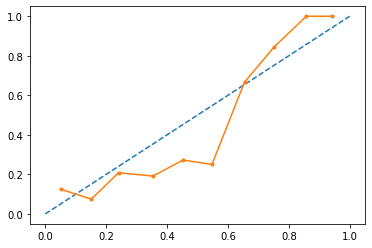

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.85       152
         1.0       0.87      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :100 max_faetures : 3, max_depth : 4 


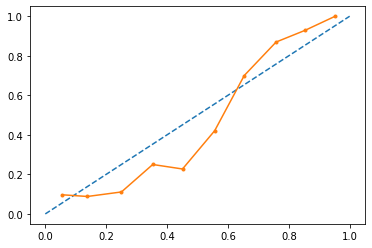

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.87      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :100 max_faetures : 3, max_depth : 5 


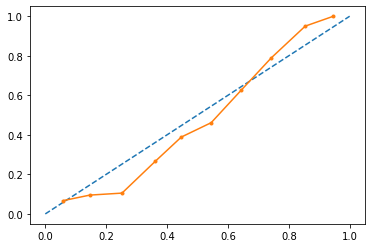

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :100 max_faetures : 4, max_depth : 3 


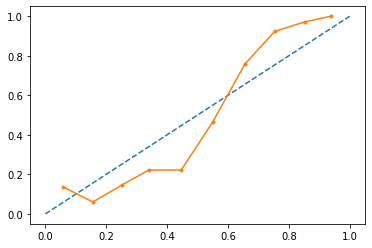

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.84      0.84       152
         1.0       0.84      0.85      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :100 max_faetures : 4, max_depth : 4 


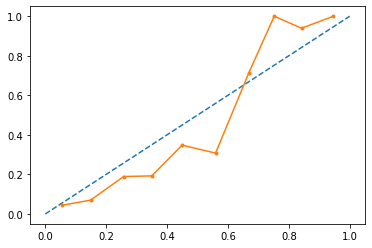

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.84      0.84       152
         1.0       0.84      0.84      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :100 max_faetures : 4, max_depth : 5 


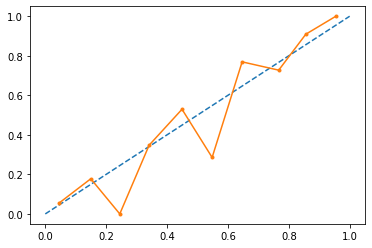

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 1, n_estimator :100 max_faetures : 5, max_depth : 3 


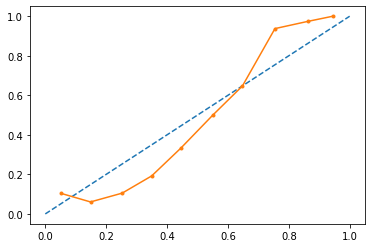

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :100 max_faetures : 5, max_depth : 4 


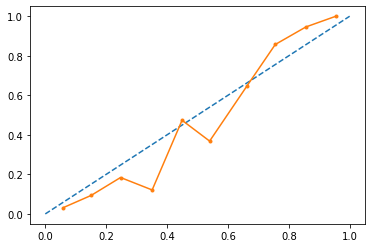

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :100 max_faetures : 5, max_depth : 5 


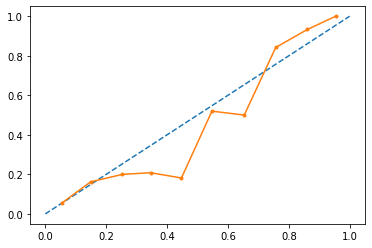

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.85      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :120 max_faetures : 2, max_depth : 3 


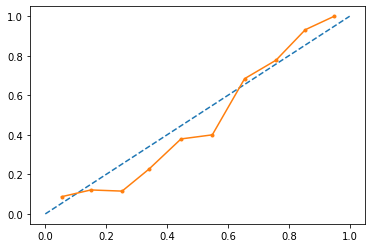

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.81      0.82      0.81       152
         1.0       0.82      0.80      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 1, n_estimator :120 max_faetures : 2, max_depth : 4 


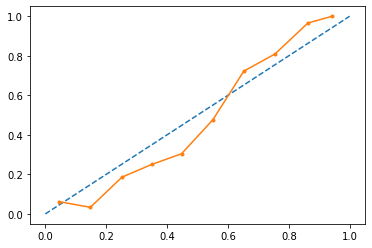

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :120 max_faetures : 2, max_depth : 5 


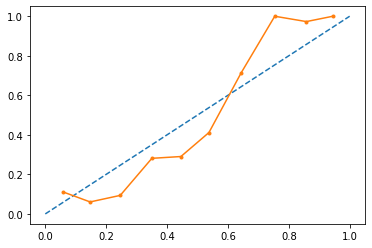

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.91      0.87       152
         1.0       0.90      0.82      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.86       304
weighted avg       0.87      0.87      0.86       304

learning rate: 1, n_estimator :120 max_faetures : 3, max_depth : 3 


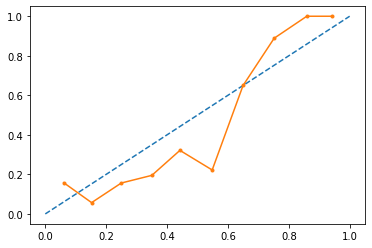

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :120 max_faetures : 3, max_depth : 4 


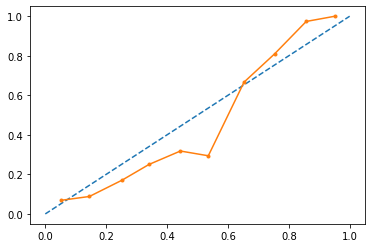

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.84       152
         1.0       0.84      0.83      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :120 max_faetures : 3, max_depth : 5 


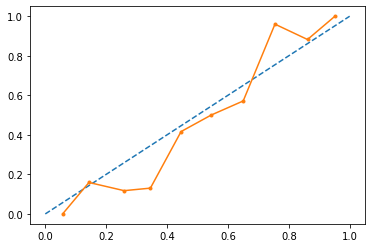

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.86       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :120 max_faetures : 4, max_depth : 3 


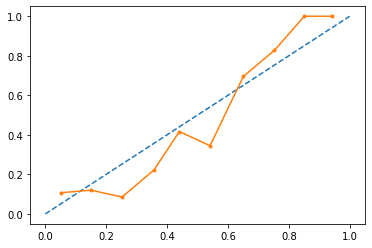

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.80      0.81       152
         1.0       0.80      0.82      0.81       152

    accuracy                           0.81       304
   macro avg       0.81      0.81      0.81       304
weighted avg       0.81      0.81      0.81       304

learning rate: 1, n_estimator :120 max_faetures : 4, max_depth : 4 


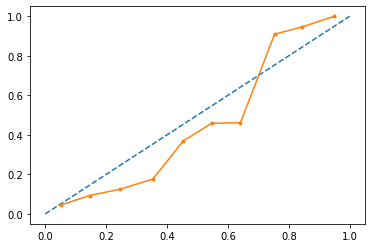

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.84      0.84       152
         1.0       0.84      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :120 max_faetures : 4, max_depth : 5 


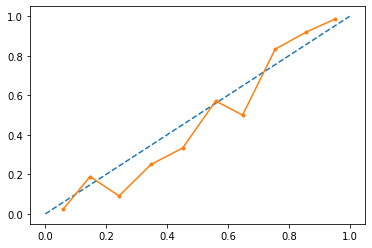

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :120 max_faetures : 5, max_depth : 3 


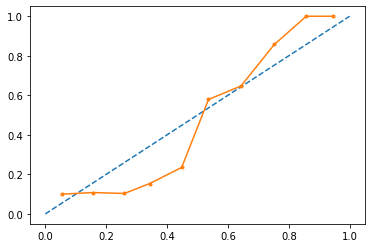

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.89      0.87       152
         1.0       0.88      0.85      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 1, n_estimator :120 max_faetures : 5, max_depth : 4 


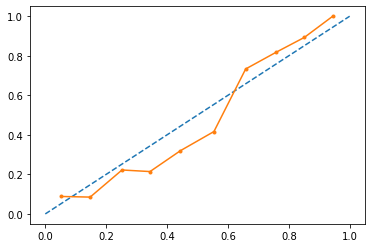

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.88      0.86       152
         1.0       0.87      0.82      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :120 max_faetures : 5, max_depth : 5 


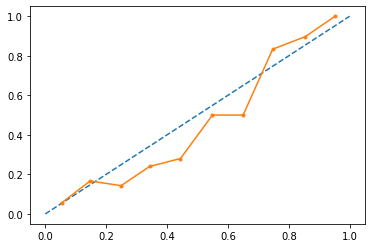

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.85       152
         1.0       0.86      0.83      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :150 max_faetures : 2, max_depth : 3 


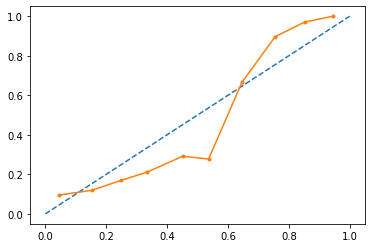

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.84      0.83       152
         1.0       0.83      0.83      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 1, n_estimator :150 max_faetures : 2, max_depth : 4 


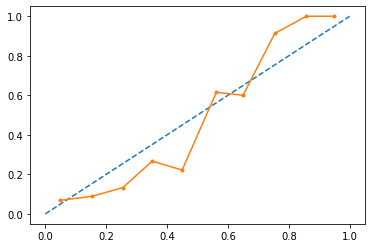

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.90      0.88       152
         1.0       0.90      0.84      0.87       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 1, n_estimator :150 max_faetures : 2, max_depth : 5 


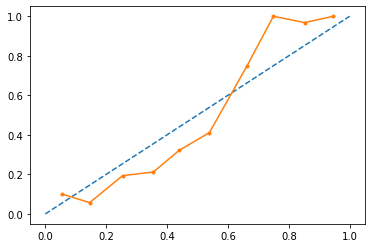

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.92      0.88       152
         1.0       0.91      0.82      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 1, n_estimator :150 max_faetures : 3, max_depth : 3 


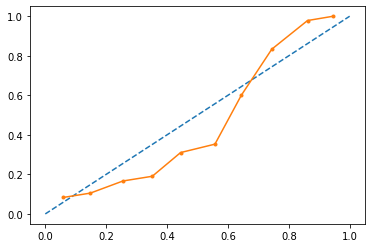

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.82      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :150 max_faetures : 3, max_depth : 4 


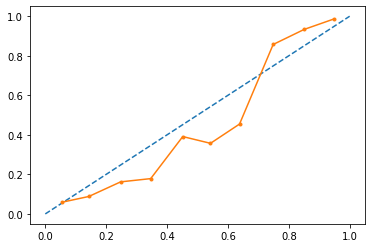

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :150 max_faetures : 3, max_depth : 5 


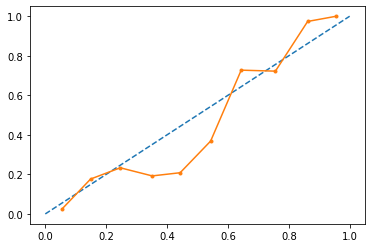

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :150 max_faetures : 4, max_depth : 3 


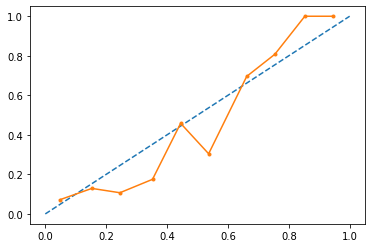

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 1, n_estimator :150 max_faetures : 4, max_depth : 4 


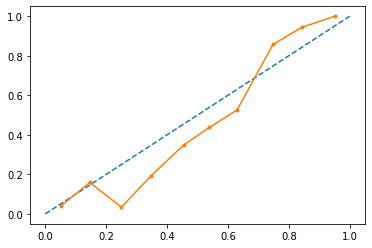

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :150 max_faetures : 4, max_depth : 5 


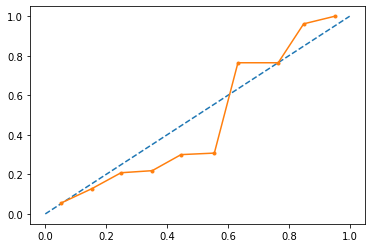

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :150 max_faetures : 5, max_depth : 3 


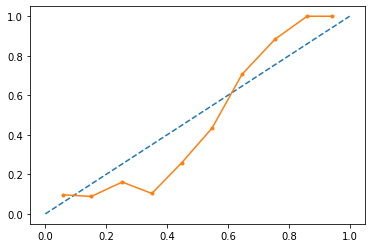

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.86      0.87      0.86       152
         1.0       0.87      0.86      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :150 max_faetures : 5, max_depth : 4 


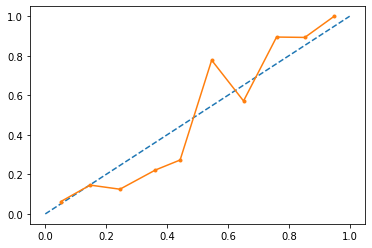

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.89      0.87       152
         1.0       0.89      0.84      0.86       152

    accuracy                           0.87       304
   macro avg       0.87      0.87      0.87       304
weighted avg       0.87      0.87      0.87       304

learning rate: 1, n_estimator :150 max_faetures : 5, max_depth : 5 


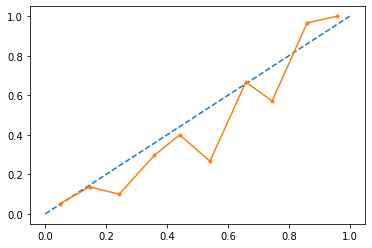

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :180 max_faetures : 2, max_depth : 3 


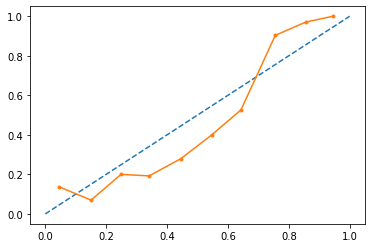

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :180 max_faetures : 2, max_depth : 4 


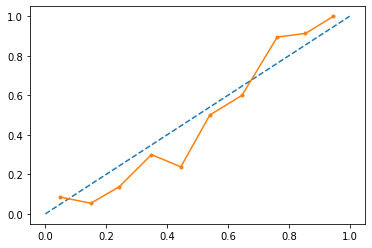

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.85      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :180 max_faetures : 2, max_depth : 5 


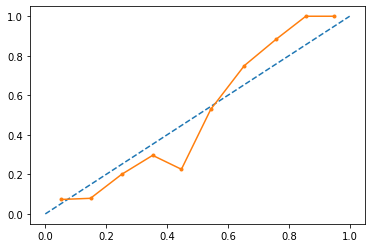

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.92      0.88       152
         1.0       0.91      0.82      0.87       152

    accuracy                           0.87       304
   macro avg       0.88      0.87      0.87       304
weighted avg       0.88      0.87      0.87       304

learning rate: 1, n_estimator :180 max_faetures : 3, max_depth : 3 


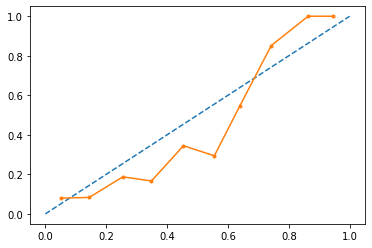

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.87      0.85       152
         1.0       0.86      0.82      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :180 max_faetures : 3, max_depth : 4 


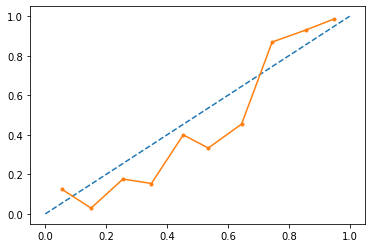

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :180 max_faetures : 3, max_depth : 5 


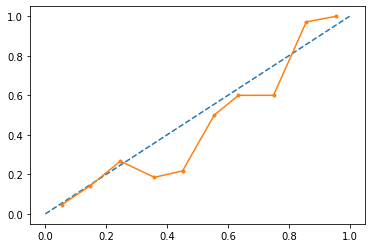

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :180 max_faetures : 4, max_depth : 3 


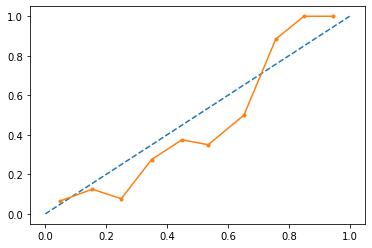

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.82      0.82       152
         1.0       0.82      0.82      0.82       152

    accuracy                           0.82       304
   macro avg       0.82      0.82      0.82       304
weighted avg       0.82      0.82      0.82       304

learning rate: 1, n_estimator :180 max_faetures : 4, max_depth : 4 


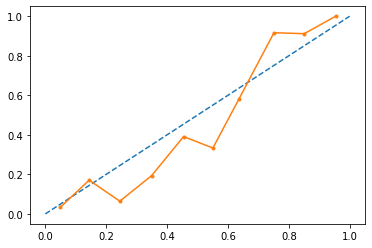

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :180 max_faetures : 4, max_depth : 5 


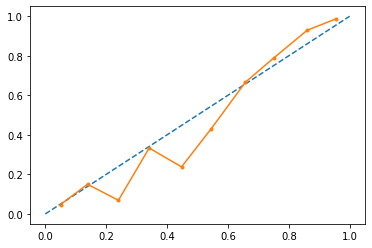

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.87      0.85      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :180 max_faetures : 5, max_depth : 3 


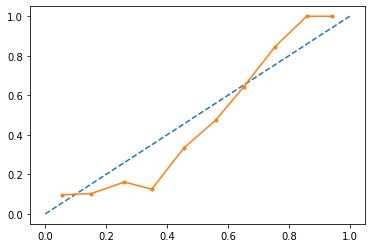

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.88      0.86       152
         1.0       0.88      0.84      0.86       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :180 max_faetures : 5, max_depth : 4 


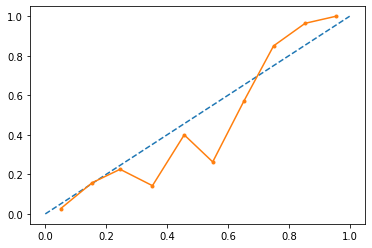

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :180 max_faetures : 5, max_depth : 5 


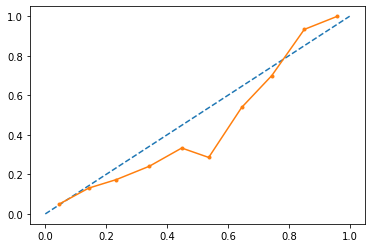

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.86      0.84      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :200 max_faetures : 2, max_depth : 3 


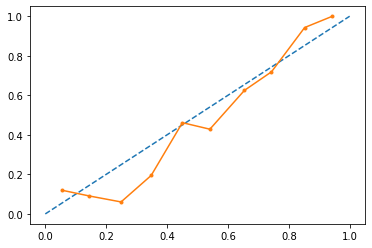

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.83      0.83       152
         1.0       0.83      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 1, n_estimator :200 max_faetures : 2, max_depth : 4 


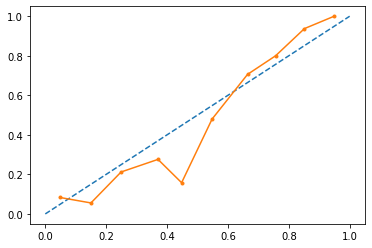

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.86      0.85       152
         1.0       0.85      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :200 max_faetures : 2, max_depth : 5 


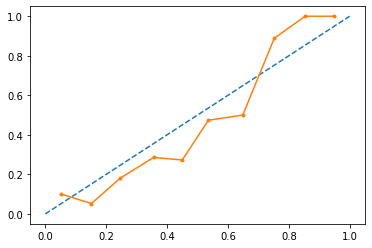

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.89      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :200 max_faetures : 3, max_depth : 3 


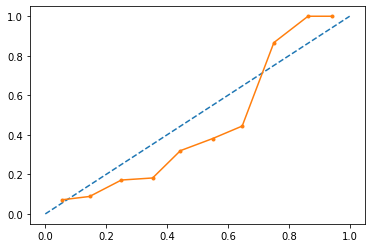

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :200 max_faetures : 3, max_depth : 4 


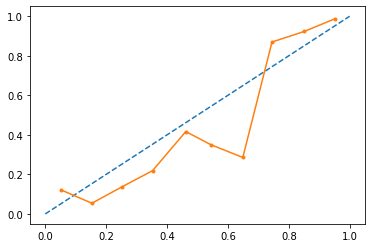

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.85      0.84      0.84       152
         1.0       0.84      0.85      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :200 max_faetures : 3, max_depth : 5 


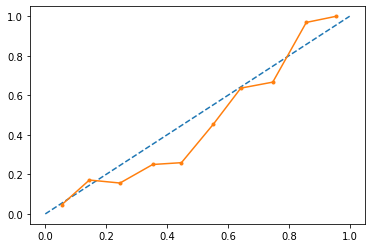

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.89      0.86       152
         1.0       0.88      0.83      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :200 max_faetures : 4, max_depth : 3 


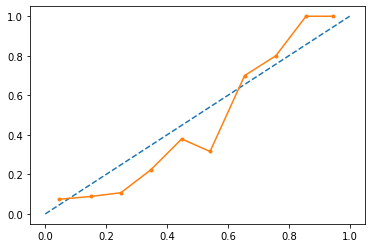

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.82      0.84      0.83       152
         1.0       0.83      0.82      0.83       152

    accuracy                           0.83       304
   macro avg       0.83      0.83      0.83       304
weighted avg       0.83      0.83      0.83       304

learning rate: 1, n_estimator :200 max_faetures : 4, max_depth : 4 


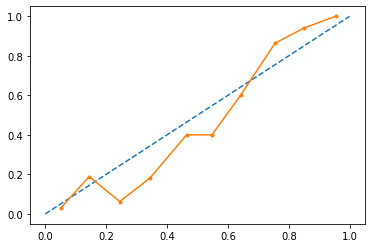

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.86      0.84       152
         1.0       0.85      0.83      0.84       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :200 max_faetures : 4, max_depth : 5 


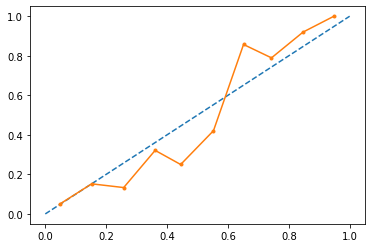

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.88      0.86       152
         1.0       0.87      0.84      0.85       152

    accuracy                           0.86       304
   macro avg       0.86      0.86      0.86       304
weighted avg       0.86      0.86      0.86       304

learning rate: 1, n_estimator :200 max_faetures : 5, max_depth : 3 


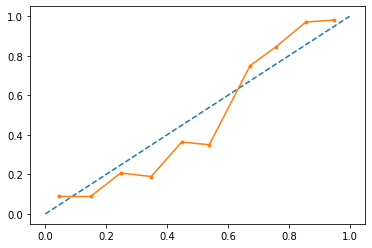

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.83      0.85      0.84       152
         1.0       0.84      0.82      0.83       152

    accuracy                           0.84       304
   macro avg       0.84      0.84      0.84       304
weighted avg       0.84      0.84      0.84       304

learning rate: 1, n_estimator :200 max_faetures : 5, max_depth : 4 


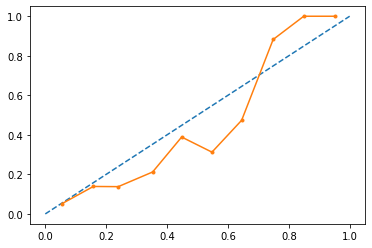

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.86      0.85       152
         1.0       0.85      0.84      0.84       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 1, n_estimator :200 max_faetures : 5, max_depth : 5 


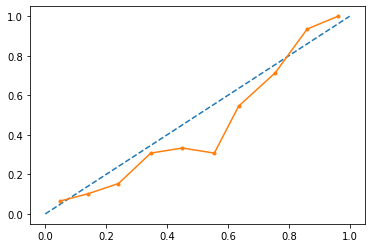

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.84      0.87      0.85       152
         1.0       0.86      0.83      0.85       152

    accuracy                           0.85       304
   macro avg       0.85      0.85      0.85       304
weighted avg       0.85      0.85      0.85       304

learning rate: 2, n_estimator :100 max_faetures : 2, max_depth : 3 


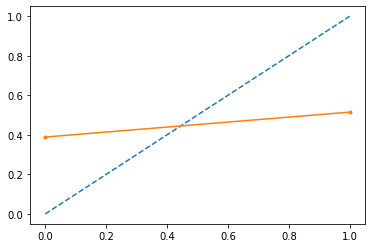

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.61      0.14      0.23       152
         1.0       0.51      0.91      0.66       152

    accuracy                           0.53       304
   macro avg       0.56      0.53      0.45       304
weighted avg       0.56      0.53      0.45       304

learning rate: 2, n_estimator :100 max_faetures : 2, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


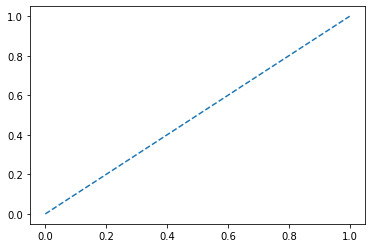

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


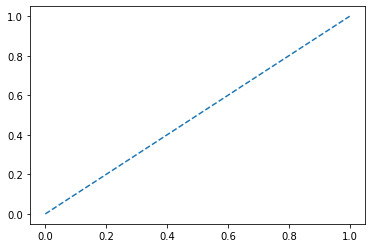

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 3, max_depth : 3 


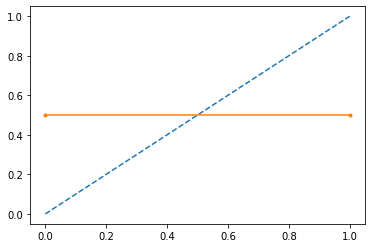

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      0.99      0.67       152
         1.0       0.50      0.01      0.01       152

    accuracy                           0.50       304
   macro avg       0.50      0.50      0.34       304
weighted avg       0.50      0.50      0.34       304

learning rate: 2, n_estimator :100 max_faetures : 3, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


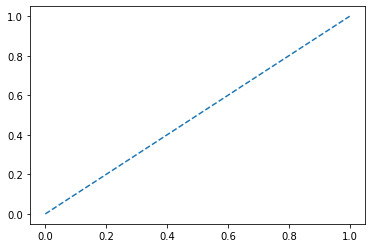

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


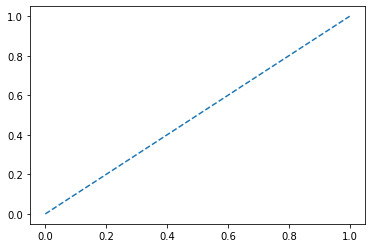

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 4, max_depth : 3 


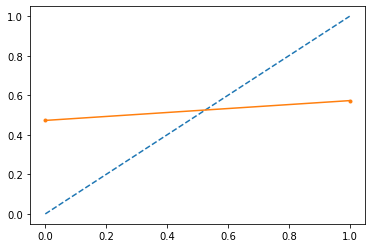

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.53      0.77      0.63       152
         1.0       0.57      0.31      0.40       152

    accuracy                           0.54       304
   macro avg       0.55      0.54      0.51       304
weighted avg       0.55      0.54      0.51       304

learning rate: 2, n_estimator :100 max_faetures : 4, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


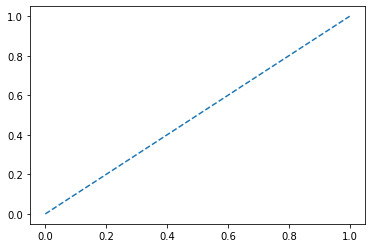

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 4, max_depth : 5 


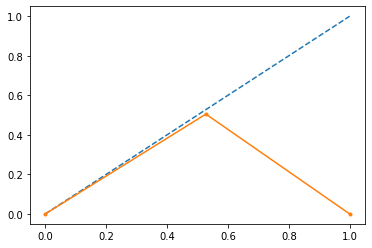

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      0.99      0.66       152
         1.0       0.00      0.00      0.00       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 5, max_depth : 3 


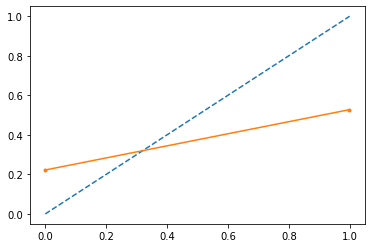

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.14      0.23       152
         1.0       0.53      0.96      0.68       152

    accuracy                           0.55       304
   macro avg       0.65      0.55      0.46       304
weighted avg       0.65      0.55      0.46       304

learning rate: 2, n_estimator :100 max_faetures : 5, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


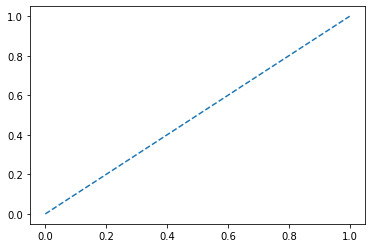

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :100 max_faetures : 5, max_depth : 5 


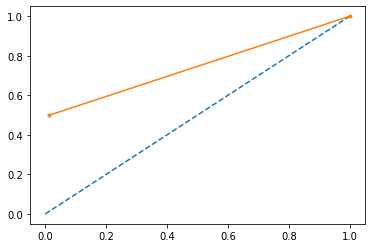

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      1.00      0.67       152
         1.0       1.00      0.02      0.04       152

    accuracy                           0.51       304
   macro avg       0.75      0.51      0.35       304
weighted avg       0.75      0.51      0.35       304

learning rate: 2, n_estimator :120 max_faetures : 2, max_depth : 3 


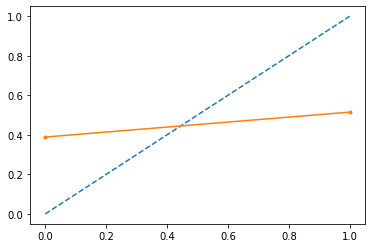

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.61      0.14      0.23       152
         1.0       0.51      0.91      0.66       152

    accuracy                           0.53       304
   macro avg       0.56      0.53      0.45       304
weighted avg       0.56      0.53      0.45       304

learning rate: 2, n_estimator :120 max_faetures : 2, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


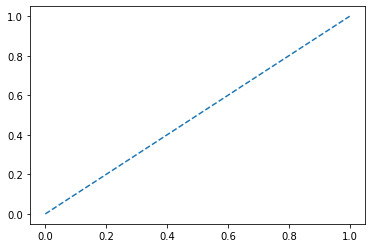

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


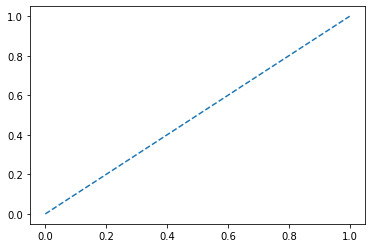

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 3, max_depth : 3 


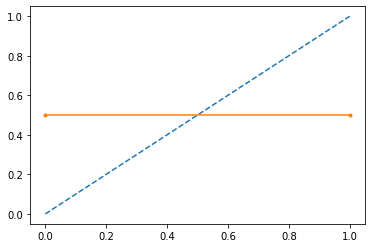

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      0.99      0.67       152
         1.0       0.50      0.01      0.01       152

    accuracy                           0.50       304
   macro avg       0.50      0.50      0.34       304
weighted avg       0.50      0.50      0.34       304

learning rate: 2, n_estimator :120 max_faetures : 3, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


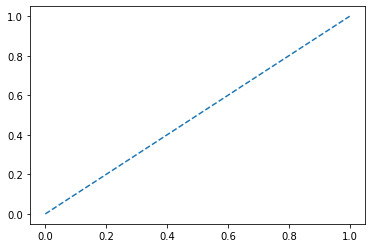

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


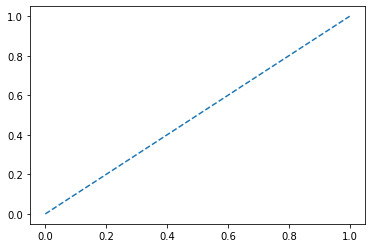

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 4, max_depth : 3 


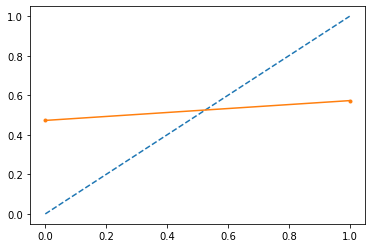

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.53      0.77      0.63       152
         1.0       0.57      0.31      0.40       152

    accuracy                           0.54       304
   macro avg       0.55      0.54      0.51       304
weighted avg       0.55      0.54      0.51       304

learning rate: 2, n_estimator :120 max_faetures : 4, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


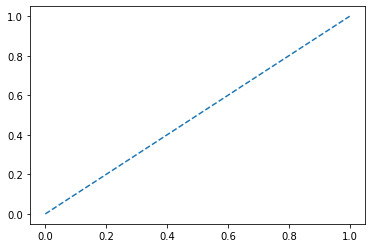

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 4, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


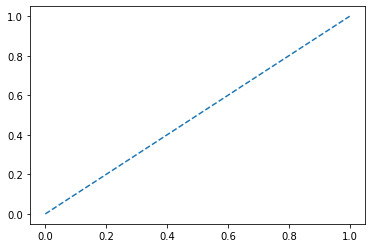

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 5, max_depth : 3 


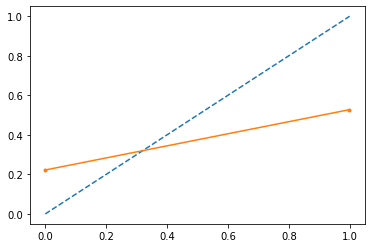

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.14      0.23       152
         1.0       0.53      0.96      0.68       152

    accuracy                           0.55       304
   macro avg       0.65      0.55      0.46       304
weighted avg       0.65      0.55      0.46       304

learning rate: 2, n_estimator :120 max_faetures : 5, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


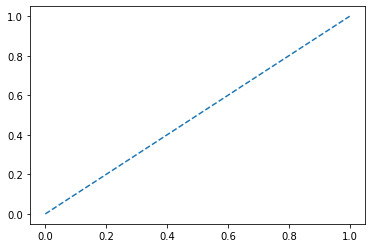

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :120 max_faetures : 5, max_depth : 5 


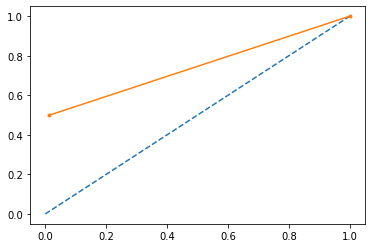

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      1.00      0.67       152
         1.0       1.00      0.02      0.04       152

    accuracy                           0.51       304
   macro avg       0.75      0.51      0.35       304
weighted avg       0.75      0.51      0.35       304

learning rate: 2, n_estimator :150 max_faetures : 2, max_depth : 3 


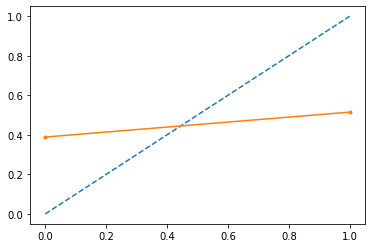

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.61      0.14      0.23       152
         1.0       0.51      0.91      0.66       152

    accuracy                           0.53       304
   macro avg       0.56      0.53      0.45       304
weighted avg       0.56      0.53      0.45       304

learning rate: 2, n_estimator :150 max_faetures : 2, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


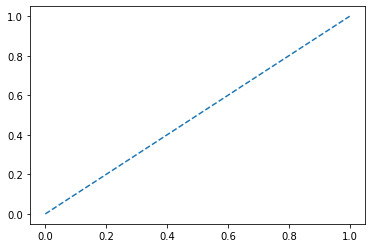

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


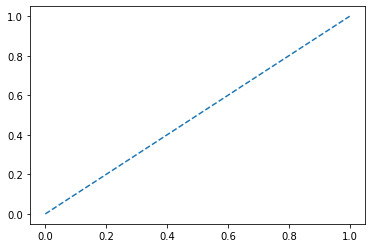

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 3, max_depth : 3 


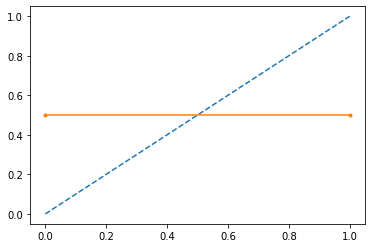

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      0.99      0.67       152
         1.0       0.50      0.01      0.01       152

    accuracy                           0.50       304
   macro avg       0.50      0.50      0.34       304
weighted avg       0.50      0.50      0.34       304

learning rate: 2, n_estimator :150 max_faetures : 3, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


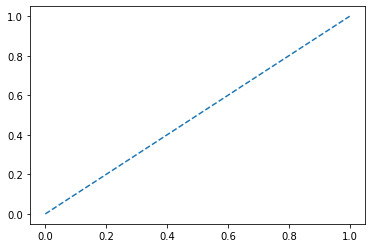

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


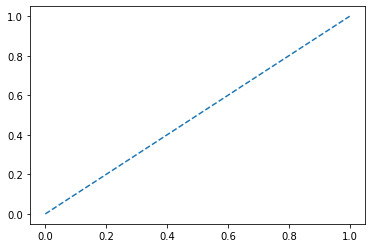

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 4, max_depth : 3 


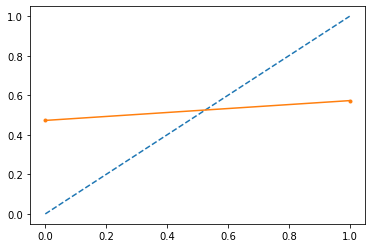

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.53      0.77      0.63       152
         1.0       0.57      0.31      0.40       152

    accuracy                           0.54       304
   macro avg       0.55      0.54      0.51       304
weighted avg       0.55      0.54      0.51       304

learning rate: 2, n_estimator :150 max_faetures : 4, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


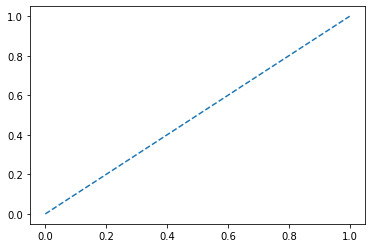

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 4, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


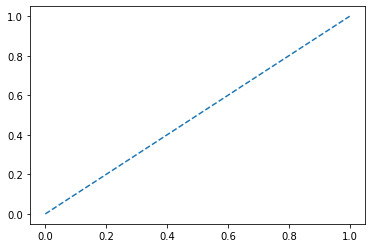

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 5, max_depth : 3 


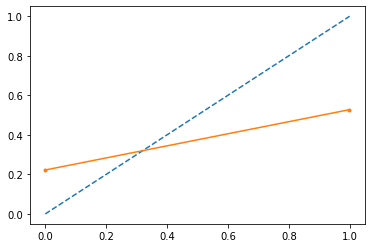

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.14      0.23       152
         1.0       0.53      0.96      0.68       152

    accuracy                           0.55       304
   macro avg       0.65      0.55      0.46       304
weighted avg       0.65      0.55      0.46       304

learning rate: 2, n_estimator :150 max_faetures : 5, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


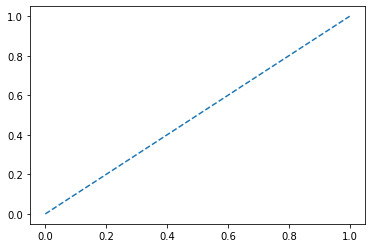

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :150 max_faetures : 5, max_depth : 5 


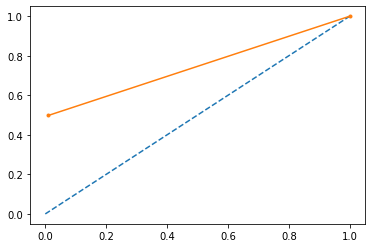

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      1.00      0.67       152
         1.0       1.00      0.01      0.03       152

    accuracy                           0.51       304
   macro avg       0.75      0.51      0.35       304
weighted avg       0.75      0.51      0.35       304

learning rate: 2, n_estimator :180 max_faetures : 2, max_depth : 3 


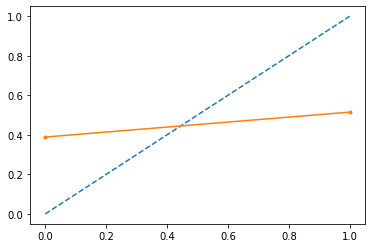

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.61      0.14      0.23       152
         1.0       0.51      0.91      0.66       152

    accuracy                           0.53       304
   macro avg       0.56      0.53      0.45       304
weighted avg       0.56      0.53      0.45       304

learning rate: 2, n_estimator :180 max_faetures : 2, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


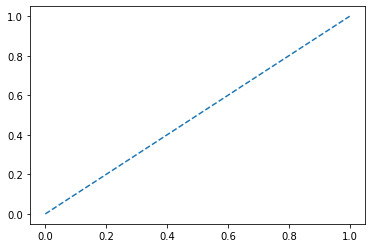

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


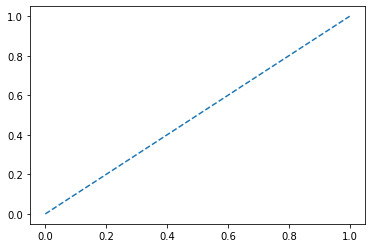

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 3, max_depth : 3 


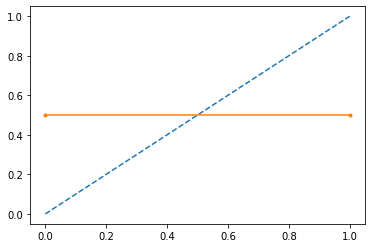

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      0.99      0.67       152
         1.0       0.50      0.01      0.01       152

    accuracy                           0.50       304
   macro avg       0.50      0.50      0.34       304
weighted avg       0.50      0.50      0.34       304

learning rate: 2, n_estimator :180 max_faetures : 3, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


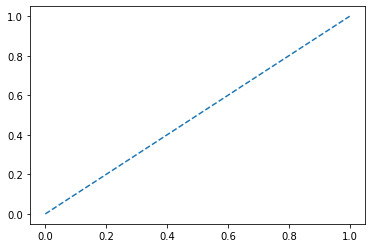

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


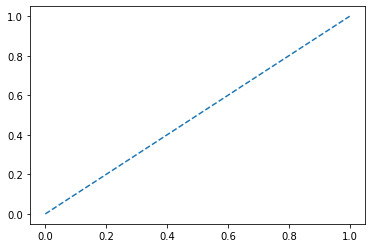

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 4, max_depth : 3 


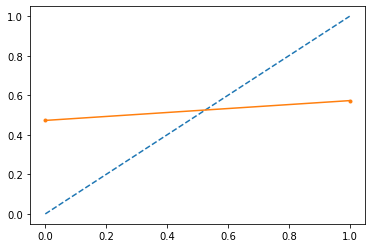

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.53      0.77      0.63       152
         1.0       0.57      0.31      0.40       152

    accuracy                           0.54       304
   macro avg       0.55      0.54      0.51       304
weighted avg       0.55      0.54      0.51       304

learning rate: 2, n_estimator :180 max_faetures : 4, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


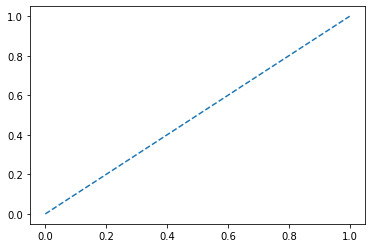

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 4, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


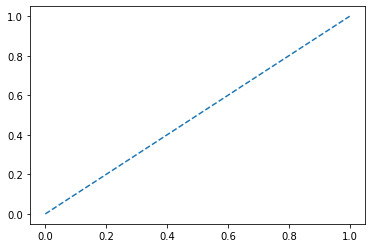

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 5, max_depth : 3 


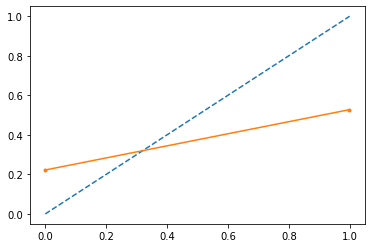

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.14      0.23       152
         1.0       0.53      0.96      0.68       152

    accuracy                           0.55       304
   macro avg       0.65      0.55      0.46       304
weighted avg       0.65      0.55      0.46       304

learning rate: 2, n_estimator :180 max_faetures : 5, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


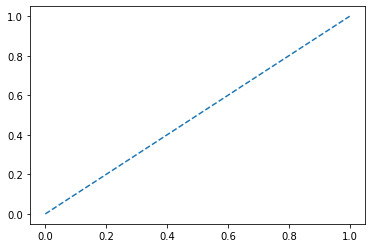

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :180 max_faetures : 5, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


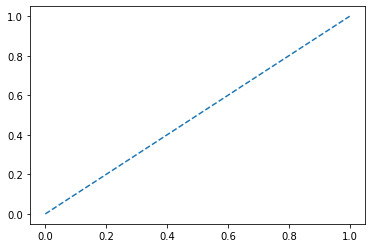

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 2, max_depth : 3 


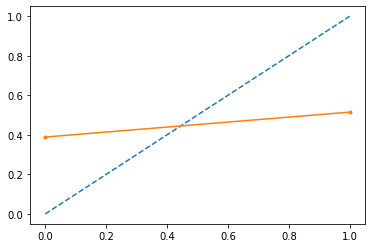

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.61      0.14      0.23       152
         1.0       0.51      0.91      0.66       152

    accuracy                           0.53       304
   macro avg       0.56      0.53      0.45       304
weighted avg       0.56      0.53      0.45       304

learning rate: 2, n_estimator :200 max_faetures : 2, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


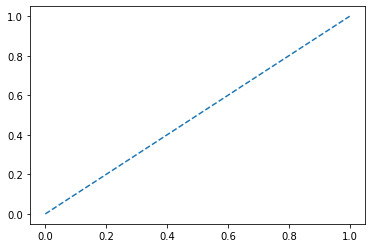

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


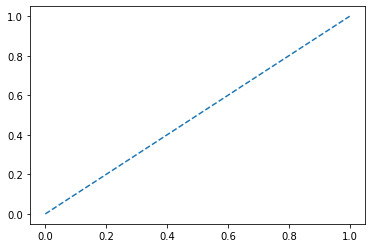

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 3, max_depth : 3 


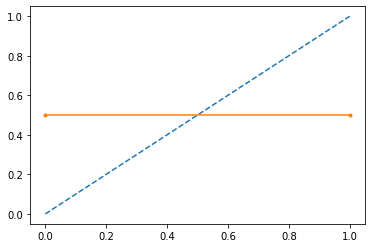

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.50      0.99      0.67       152
         1.0       0.50      0.01      0.01       152

    accuracy                           0.50       304
   macro avg       0.50      0.50      0.34       304
weighted avg       0.50      0.50      0.34       304

learning rate: 2, n_estimator :200 max_faetures : 3, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


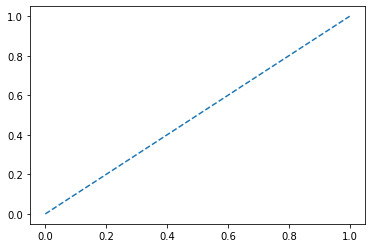

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


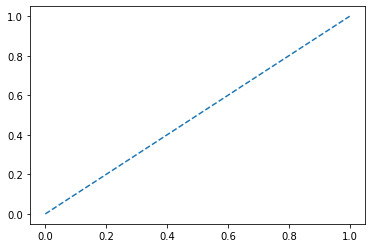

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 4, max_depth : 3 


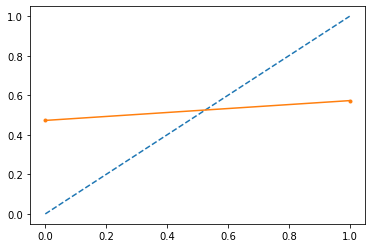

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.53      0.77      0.63       152
         1.0       0.57      0.31      0.40       152

    accuracy                           0.54       304
   macro avg       0.55      0.54      0.51       304
weighted avg       0.55      0.54      0.51       304

learning rate: 2, n_estimator :200 max_faetures : 4, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


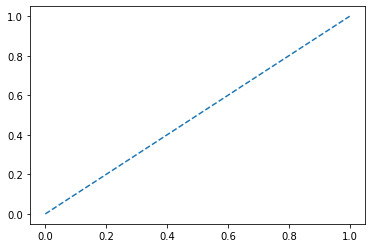

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 4, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


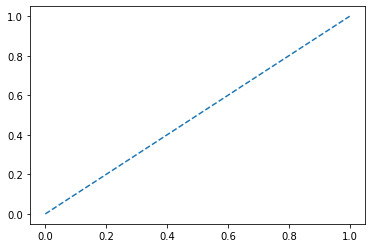

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 5, max_depth : 3 


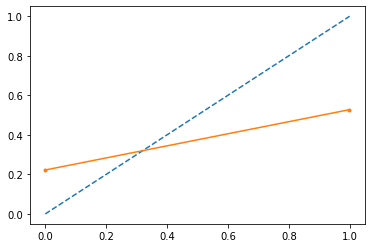

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.78      0.14      0.23       152
         1.0       0.53      0.96      0.68       152

    accuracy                           0.55       304
   macro avg       0.65      0.55      0.46       304
weighted avg       0.65      0.55      0.46       304

learning rate: 2, n_estimator :200 max_faetures : 5, max_depth : 4 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


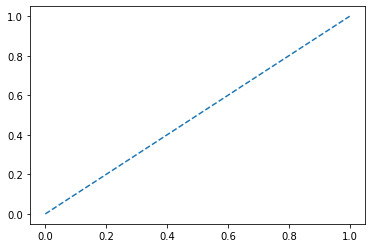

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304

learning rate: 2, n_estimator :200 max_faetures : 5, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


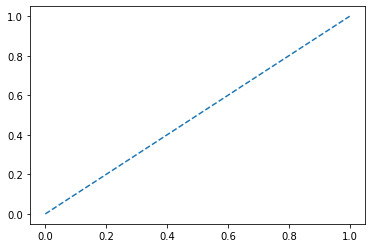

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       152
         1.0       0.50      1.00      0.67       152

    accuracy                           0.50       304
   macro avg       0.25      0.50      0.33       304
weighted avg       0.25      0.50      0.33       304



/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [11]:
X_c, y_c= create_target_set(df_train, 'Sale_MF', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                          'Revenue_MF', 'Revenue_CC','Revenue_CL'])

X_c = feature_selection(X_c, y_c, n=20)

X_S, y_S = SMOTE_analysis(X_c, y_c)

X_train_c, X_test_c, y_train_c, y_test_c = train_and_test_split(X_S, y_S)
    
lr_list = [0.05, 0.02, 0.01,0.008, 0.005, 0.002, 0.001, 0.1, 0.2, 0.3, 0.5, 1, 2]

n_estimators = [100, 120, 150, 180, 200]
max_features = [2,3,4,5]
max_depth = [3,4,5]

for learning_rate in lr_list:
    for n_estimator in n_estimators:
        for max_feature in max_features:
            for depth in max_depth:
                print(f"learning rate: {learning_rate}, n_estimator :{n_estimator} max_faetures : {max_feature}, max_depth : {depth} ")

                estimator_c = model_classification(X_train_c, y_train_c, n_estimators=n_estimator, learning_rate=learning_rate, 
                                             max_features=max_feature, max_depth=depth, random_state=42)

                # predict probabilities
                probs_c = estimator_c.predict_proba(X_test_c)[:,1]
                # reliability diagram
                fop, mpv = calibration_curve(y_test_c, probs_c, n_bins=10, normalize=True)
                # plot perfectly calibrated
                plt.plot([0, 1], [0, 1], linestyle='--')
                # plot model reliability
                plt.plot(mpv, fop, marker='.')
                plt.show()
                prediction_c = estimator_c.predict(X_test_c)

                print("Classification Report: \n", classification_report(y_test_c, prediction_c))

learning rate: 0.05, n_estimator :100 max_features : 2, max_depth : 3 


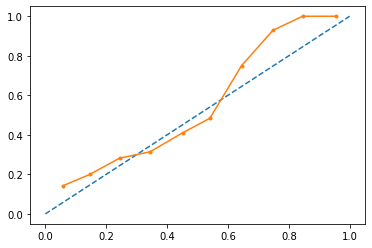

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.79      0.75       133
         1.0       0.76      0.69      0.73       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.05, n_estimator :100 max_features : 2, max_depth : 4 


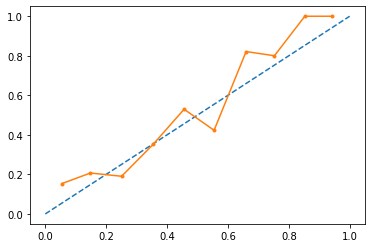

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.76      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.05, n_estimator :100 max_features : 2, max_depth : 5 


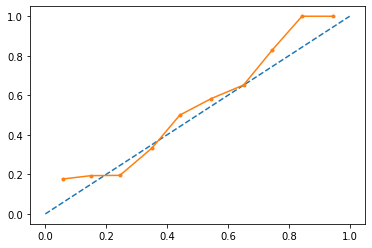

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.05, n_estimator :100 max_features : 3, max_depth : 3 


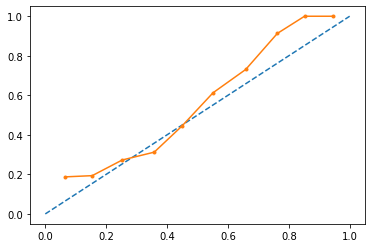

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.80      0.75       133
         1.0       0.77      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.74      0.73      0.73       265
weighted avg       0.74      0.73      0.73       265

learning rate: 0.05, n_estimator :100 max_features : 3, max_depth : 4 


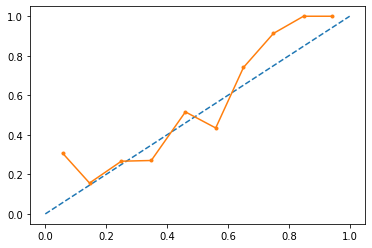

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.82      0.76       133
         1.0       0.78      0.65      0.71       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.73       265

learning rate: 0.05, n_estimator :100 max_features : 3, max_depth : 5 


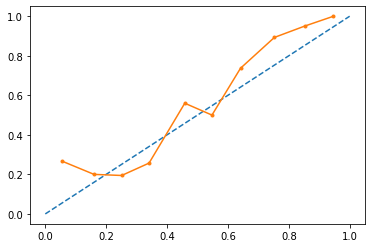

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.77       133
         1.0       0.78      0.69      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.05, n_estimator :100 max_features : 4, max_depth : 3 


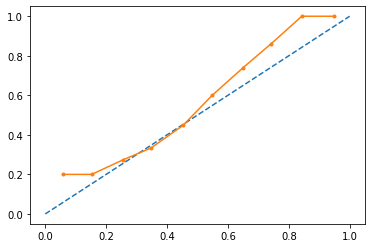

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.83      0.76       133
         1.0       0.79      0.64      0.71       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.73       265

learning rate: 0.05, n_estimator :100 max_features : 4, max_depth : 4 


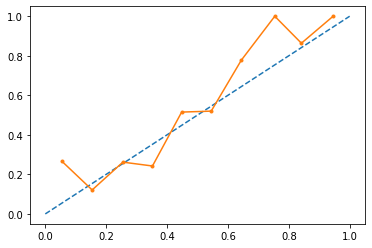

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.76       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.05, n_estimator :100 max_features : 4, max_depth : 5 


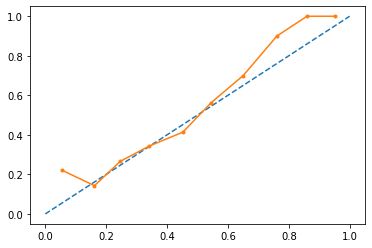

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.82      0.78       133
         1.0       0.80      0.71      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 0.05, n_estimator :100 max_features : 5, max_depth : 3 


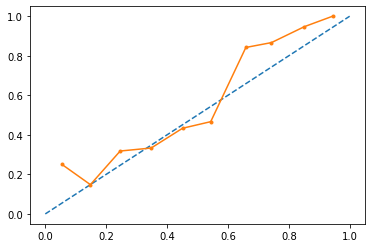

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.75      0.65      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.05, n_estimator :100 max_features : 5, max_depth : 4 


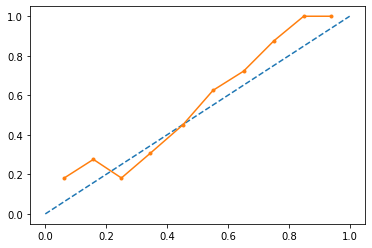

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.80      0.68      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 0.05, n_estimator :100 max_features : 5, max_depth : 5 


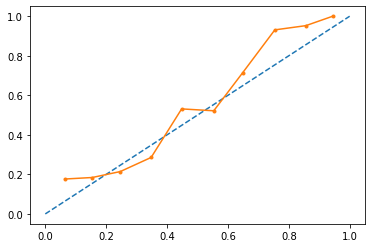

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.05, n_estimator :120 max_features : 2, max_depth : 3 


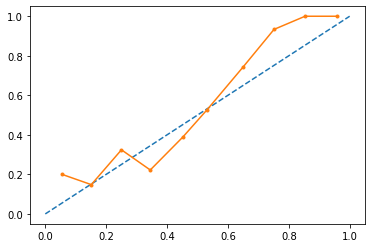

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.78      0.75       133
         1.0       0.76      0.70      0.73       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.05, n_estimator :120 max_features : 2, max_depth : 4 


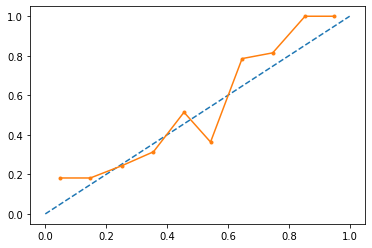

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.80      0.76       133
         1.0       0.78      0.68      0.73       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :120 max_features : 2, max_depth : 5 


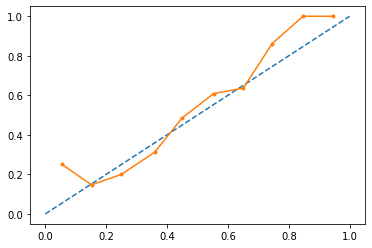

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.76       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.05, n_estimator :120 max_features : 3, max_depth : 3 


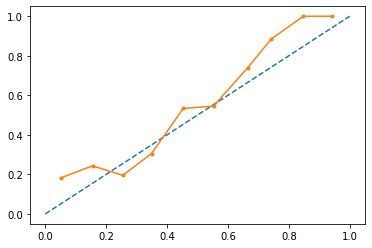

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       133
         1.0       0.78      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :120 max_features : 3, max_depth : 4 


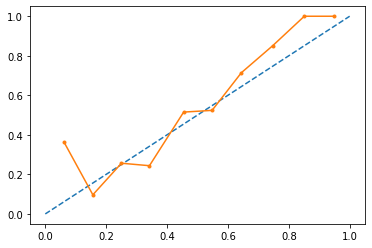

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.05, n_estimator :120 max_features : 3, max_depth : 5 


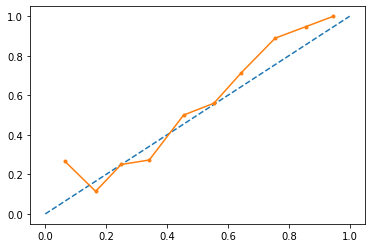

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.05, n_estimator :120 max_features : 4, max_depth : 3 


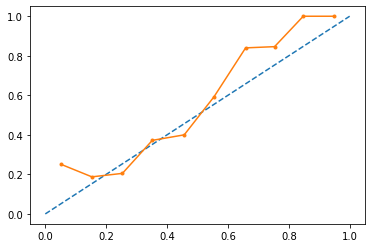

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.76       133
         1.0       0.79      0.66      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :120 max_features : 4, max_depth : 4 


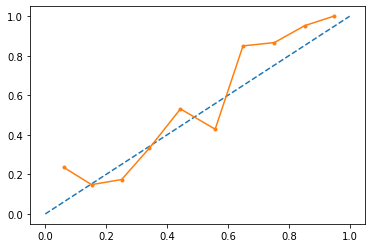

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.84      0.77       133
         1.0       0.81      0.66      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.05, n_estimator :120 max_features : 4, max_depth : 5 


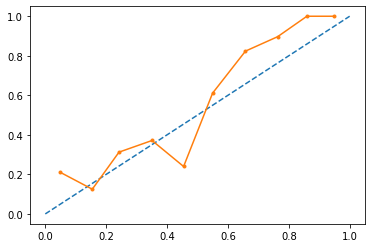

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.79       133
         1.0       0.81      0.71      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.05, n_estimator :120 max_features : 5, max_depth : 3 


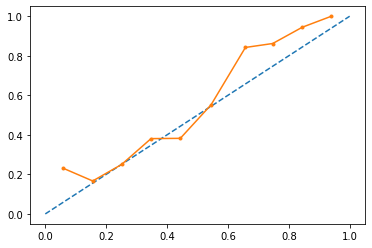

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.80      0.65      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :120 max_features : 5, max_depth : 4 


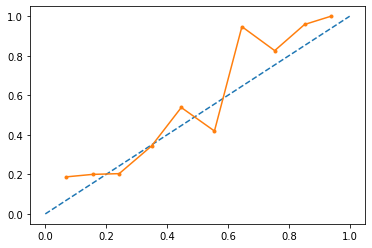

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.76       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.05, n_estimator :120 max_features : 5, max_depth : 5 


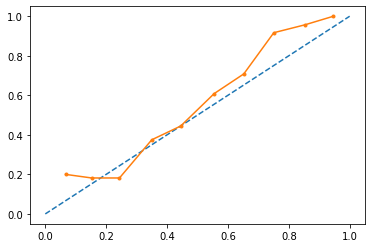

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.05, n_estimator :150 max_features : 2, max_depth : 3 


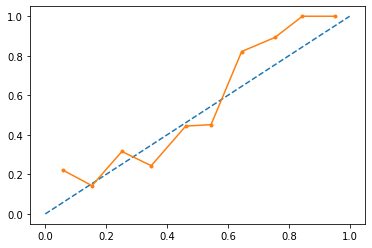

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       133
         1.0       0.78      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :150 max_features : 2, max_depth : 4 


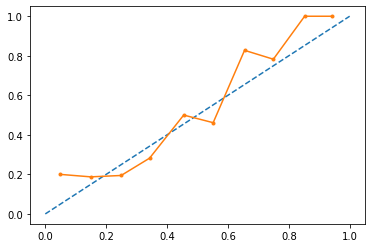

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.82      0.76       133
         1.0       0.79      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :150 max_features : 2, max_depth : 5 


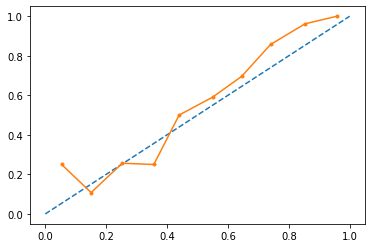

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.05, n_estimator :150 max_features : 3, max_depth : 3 


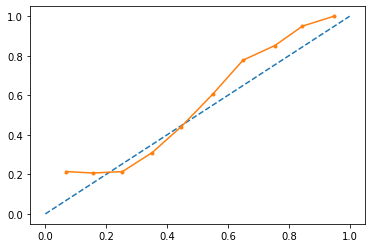

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.81      0.76       133
         1.0       0.78      0.66      0.71       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.73       265

learning rate: 0.05, n_estimator :150 max_features : 3, max_depth : 4 


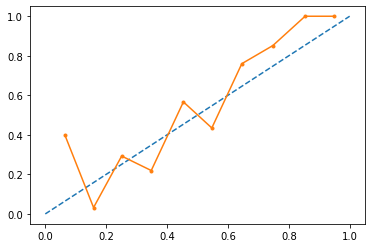

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.79      0.67      0.72       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.05, n_estimator :150 max_features : 3, max_depth : 5 


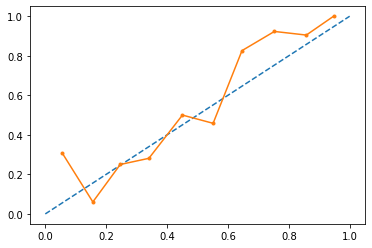

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.05, n_estimator :150 max_features : 4, max_depth : 3 


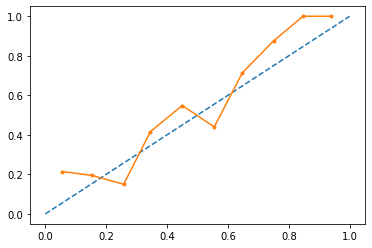

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.79      0.74       133
         1.0       0.75      0.64      0.69       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.05, n_estimator :150 max_features : 4, max_depth : 4 


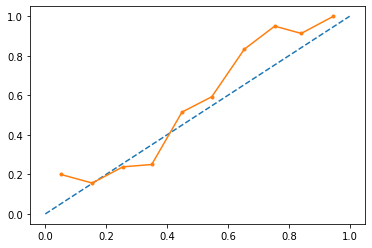

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.77       133
         1.0       0.80      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 0.05, n_estimator :150 max_features : 4, max_depth : 5 


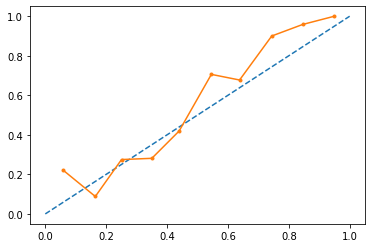

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.05, n_estimator :150 max_features : 5, max_depth : 3 


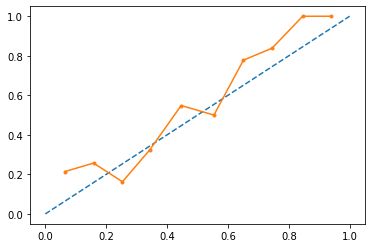

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.81      0.76       133
         1.0       0.78      0.66      0.71       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.73       265

learning rate: 0.05, n_estimator :150 max_features : 5, max_depth : 4 


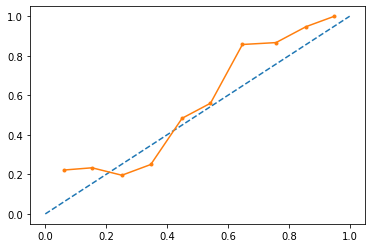

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.05, n_estimator :150 max_features : 5, max_depth : 5 


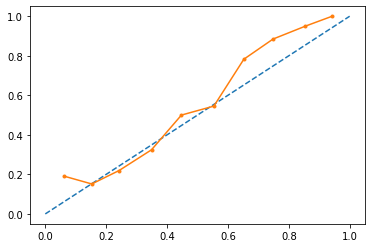

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.05, n_estimator :180 max_features : 2, max_depth : 3 


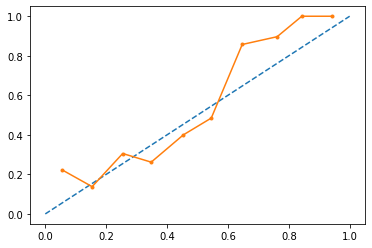

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.77       133
         1.0       0.79      0.68      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.05, n_estimator :180 max_features : 2, max_depth : 4 


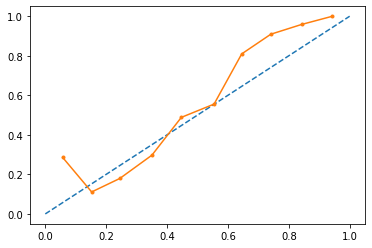

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.80      0.66      0.72       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.05, n_estimator :180 max_features : 2, max_depth : 5 


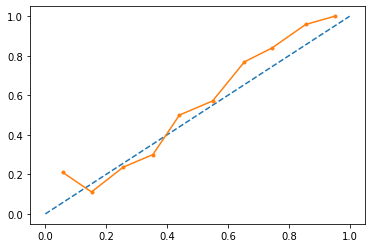

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.05, n_estimator :180 max_features : 3, max_depth : 3 


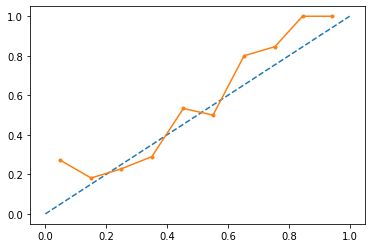

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.82      0.76       133
         1.0       0.78      0.66      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :180 max_features : 3, max_depth : 4 


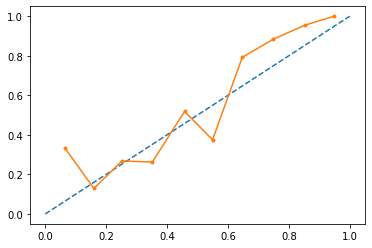

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.82      0.76       133
         1.0       0.79      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :180 max_features : 3, max_depth : 5 


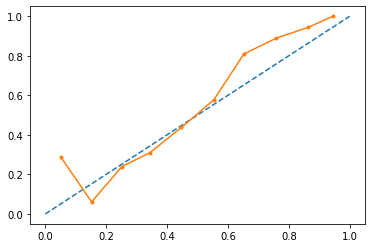

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.05, n_estimator :180 max_features : 4, max_depth : 3 


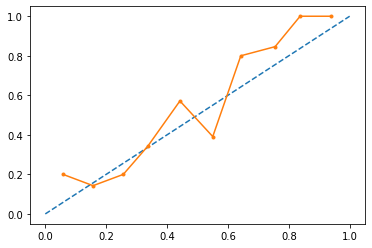

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.80      0.75       133
         1.0       0.77      0.65      0.70       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.05, n_estimator :180 max_features : 4, max_depth : 4 


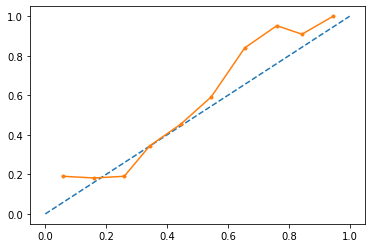

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.80      0.68      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 0.05, n_estimator :180 max_features : 4, max_depth : 5 


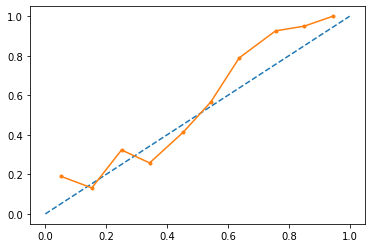

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.83      0.79       133
         1.0       0.81      0.72      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.05, n_estimator :180 max_features : 5, max_depth : 3 


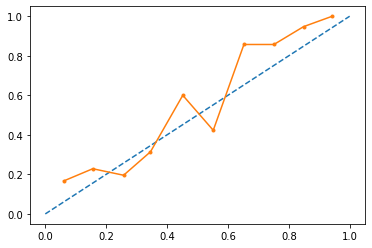

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.82      0.76       133
         1.0       0.79      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :180 max_features : 5, max_depth : 4 


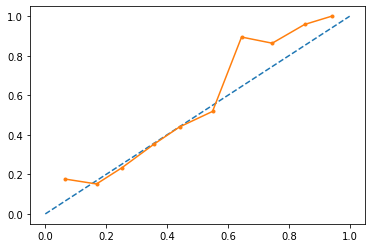

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.05, n_estimator :180 max_features : 5, max_depth : 5 


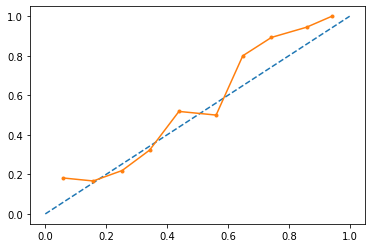

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.05, n_estimator :200 max_features : 2, max_depth : 3 


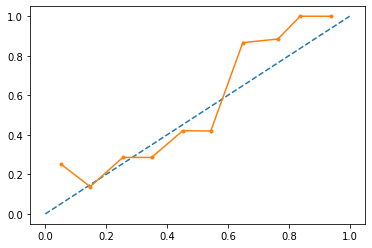

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.81      0.76       133
         1.0       0.78      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.05, n_estimator :200 max_features : 2, max_depth : 4 


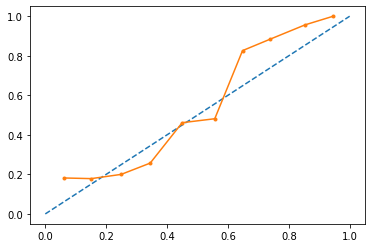

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.80      0.68      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 0.05, n_estimator :200 max_features : 2, max_depth : 5 


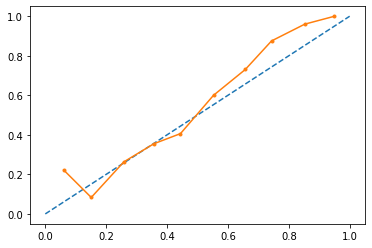

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.05, n_estimator :200 max_features : 3, max_depth : 3 


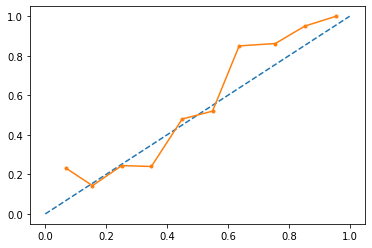

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.84      0.77       133
         1.0       0.80      0.64      0.71       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :200 max_features : 3, max_depth : 4 


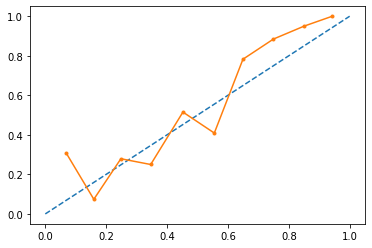

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.84      0.77       133
         1.0       0.81      0.66      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.05, n_estimator :200 max_features : 3, max_depth : 5 


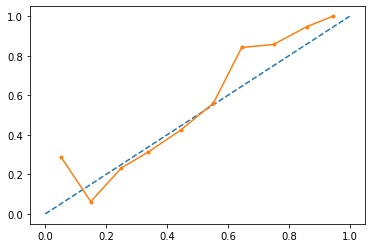

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.05, n_estimator :200 max_features : 4, max_depth : 3 


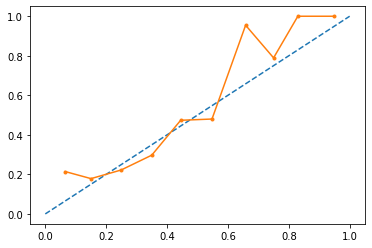

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.84      0.77       133
         1.0       0.80      0.64      0.71       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.05, n_estimator :200 max_features : 4, max_depth : 4 


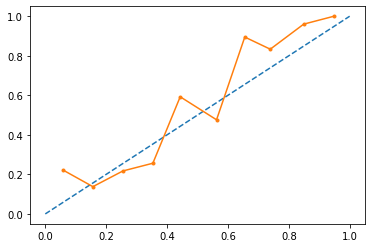

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.05, n_estimator :200 max_features : 4, max_depth : 5 


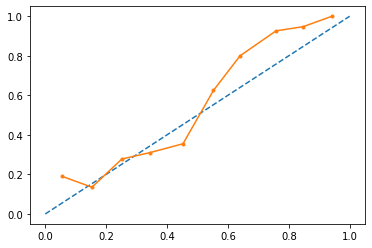

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.84      0.80       133
         1.0       0.82      0.73      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.05, n_estimator :200 max_features : 5, max_depth : 3 


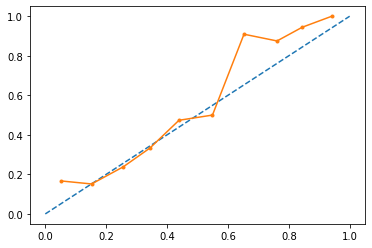

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.05, n_estimator :200 max_features : 5, max_depth : 4 


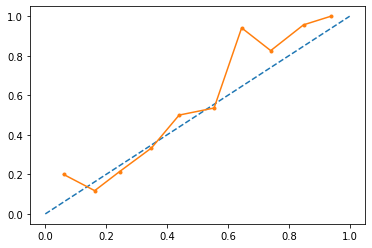

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.05, n_estimator :200 max_features : 5, max_depth : 5 


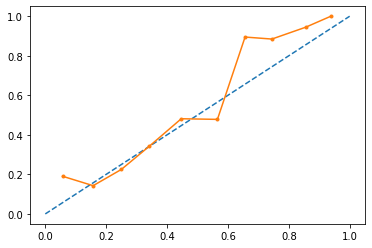

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.68      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.02, n_estimator :100 max_features : 2, max_depth : 3 


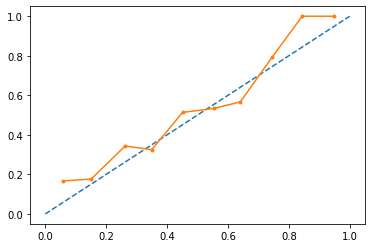

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.73      0.70       133
         1.0       0.70      0.63      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.02, n_estimator :100 max_features : 2, max_depth : 4 


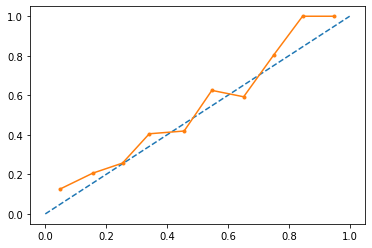

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :100 max_features : 2, max_depth : 5 


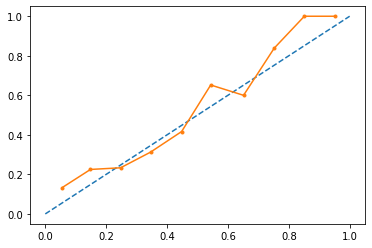

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       133
         1.0       0.78      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.02, n_estimator :100 max_features : 3, max_depth : 3 


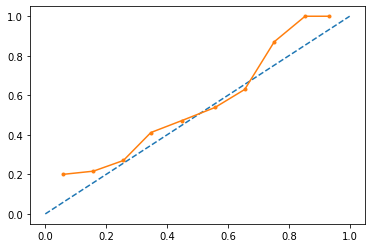

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.78      0.72       133
         1.0       0.74      0.61      0.67       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.02, n_estimator :100 max_features : 3, max_depth : 4 


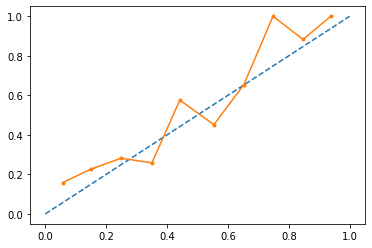

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.72      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :100 max_features : 3, max_depth : 5 


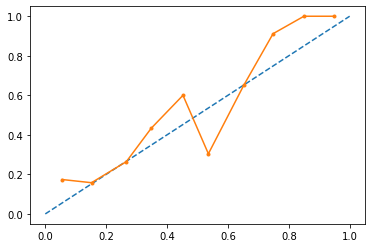

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.02, n_estimator :100 max_features : 4, max_depth : 3 


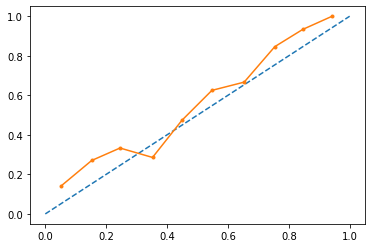

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.02, n_estimator :100 max_features : 4, max_depth : 4 


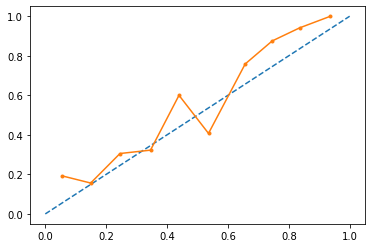

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.02, n_estimator :100 max_features : 4, max_depth : 5 


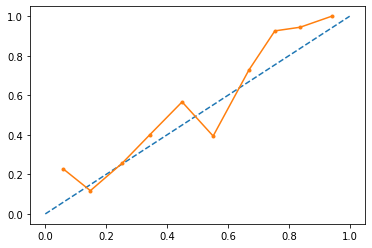

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.02, n_estimator :100 max_features : 5, max_depth : 3 


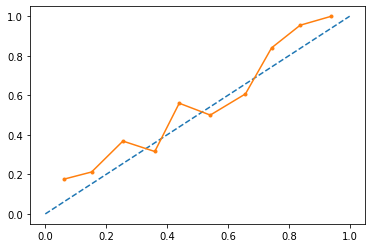

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.02, n_estimator :100 max_features : 5, max_depth : 4 


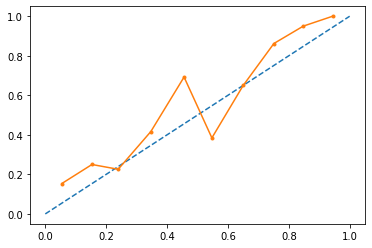

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.02, n_estimator :100 max_features : 5, max_depth : 5 


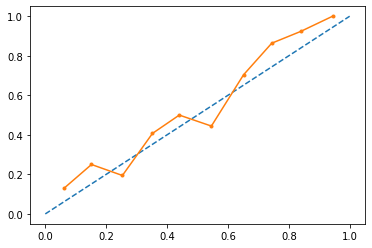

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.79      0.75       133
         1.0       0.76      0.69      0.73       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.02, n_estimator :120 max_features : 2, max_depth : 3 


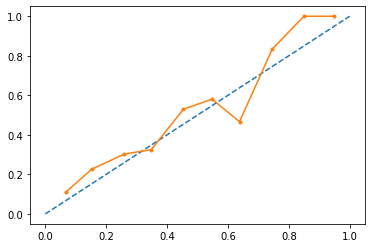

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.72      0.69       133
         1.0       0.69      0.64      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.02, n_estimator :120 max_features : 2, max_depth : 4 


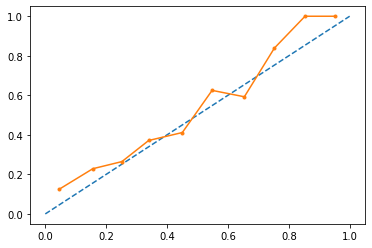

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.80      0.75       133
         1.0       0.77      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.73       265

learning rate: 0.02, n_estimator :120 max_features : 2, max_depth : 5 


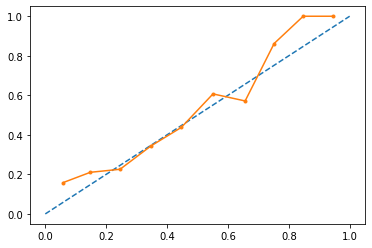

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.80      0.76       133
         1.0       0.78      0.68      0.73       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.02, n_estimator :120 max_features : 3, max_depth : 3 


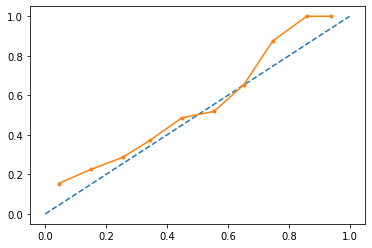

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.77      0.72       133
         1.0       0.73      0.62      0.67       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.02, n_estimator :120 max_features : 3, max_depth : 4 


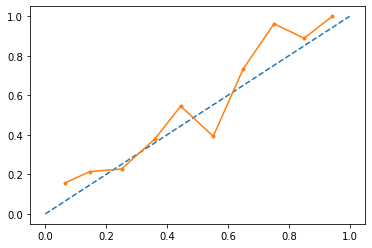

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.02, n_estimator :120 max_features : 3, max_depth : 5 


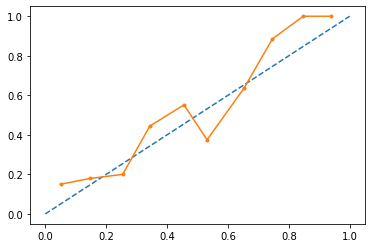

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :120 max_features : 4, max_depth : 3 


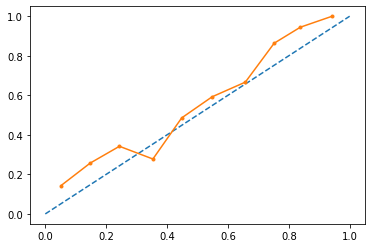

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :120 max_features : 4, max_depth : 4 


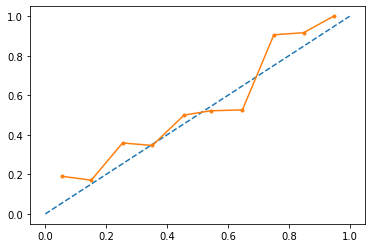

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.71       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :120 max_features : 4, max_depth : 5 


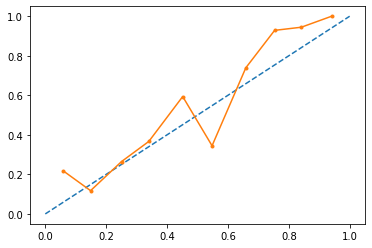

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.77      0.74       133
         1.0       0.75      0.68      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.02, n_estimator :120 max_features : 5, max_depth : 3 


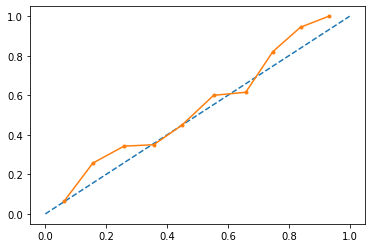

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.02, n_estimator :120 max_features : 5, max_depth : 4 


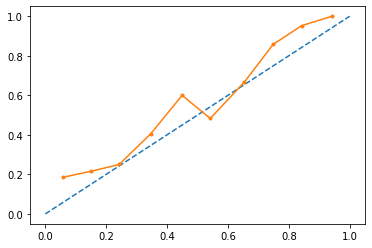

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.78      0.73       133
         1.0       0.75      0.65      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :120 max_features : 5, max_depth : 5 


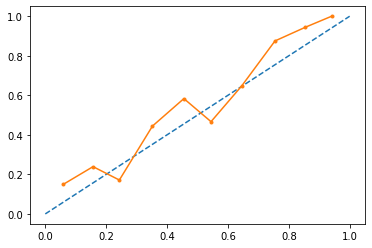

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.67      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.02, n_estimator :150 max_features : 2, max_depth : 3 


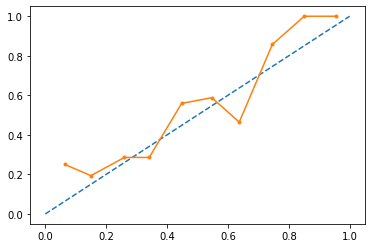

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.72      0.70       133
         1.0       0.70      0.66      0.68       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.02, n_estimator :150 max_features : 2, max_depth : 4 


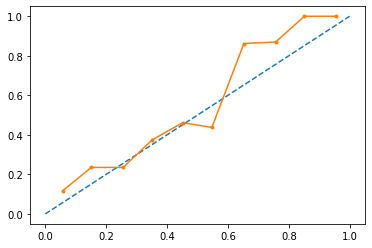

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.74       133
         1.0       0.75      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :150 max_features : 2, max_depth : 5 


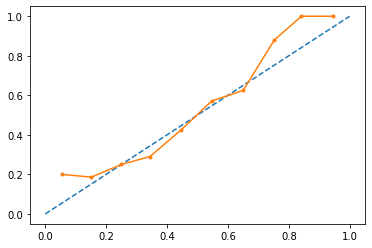

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.81      0.77       133
         1.0       0.79      0.70      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 0.02, n_estimator :150 max_features : 3, max_depth : 3 


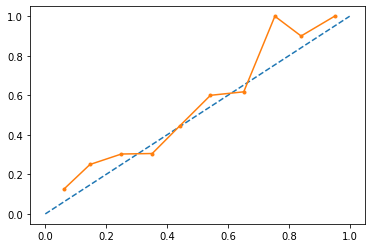

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :150 max_features : 3, max_depth : 4 


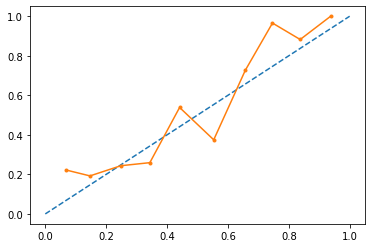

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.64      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :150 max_features : 3, max_depth : 5 


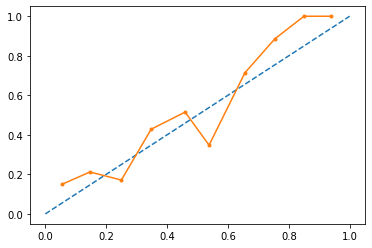

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.75       133
         1.0       0.76      0.68      0.72       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.02, n_estimator :150 max_features : 4, max_depth : 3 


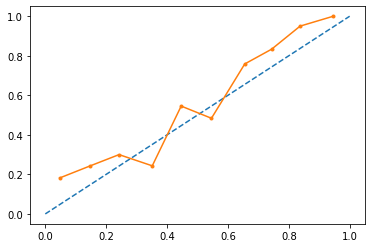

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.02, n_estimator :150 max_features : 4, max_depth : 4 


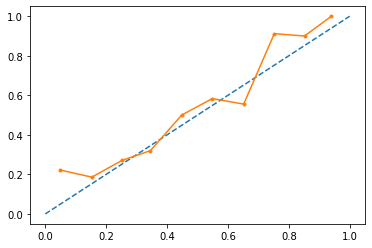

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.67      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.02, n_estimator :150 max_features : 4, max_depth : 5 


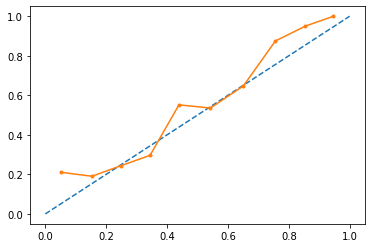

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       133
         1.0       0.78      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.02, n_estimator :150 max_features : 5, max_depth : 3 


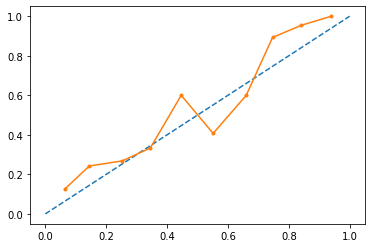

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.02, n_estimator :150 max_features : 5, max_depth : 4 


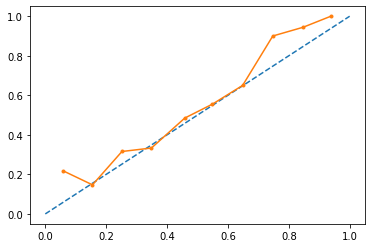

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.76      0.73       133
         1.0       0.74      0.69      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.02, n_estimator :150 max_features : 5, max_depth : 5 


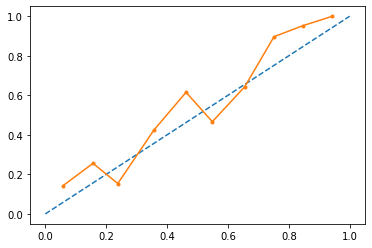

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.79      0.75       133
         1.0       0.76      0.68      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.02, n_estimator :180 max_features : 2, max_depth : 3 


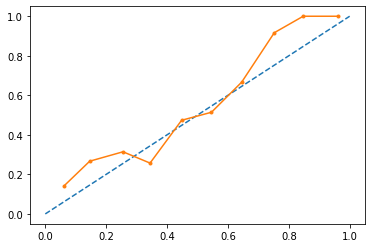

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :180 max_features : 2, max_depth : 4 


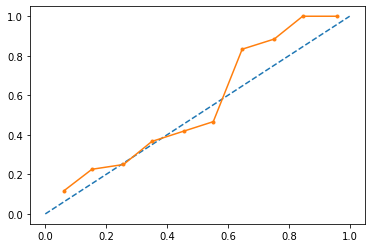

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.76      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.02, n_estimator :180 max_features : 2, max_depth : 5 


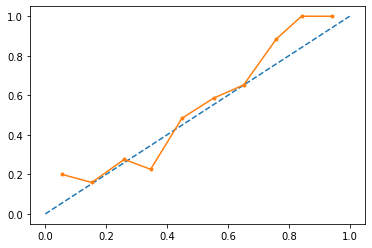

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.80      0.77       133
         1.0       0.78      0.70      0.74       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.02, n_estimator :180 max_features : 3, max_depth : 3 


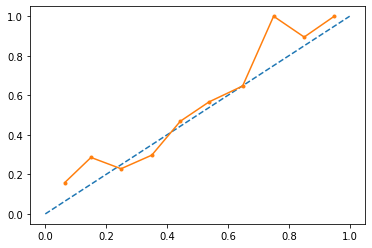

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :180 max_features : 3, max_depth : 4 


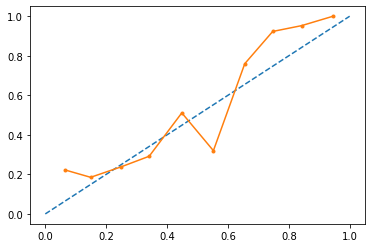

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.80      0.75       133
         1.0       0.77      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.74      0.73      0.73       265
weighted avg       0.74      0.73      0.73       265

learning rate: 0.02, n_estimator :180 max_features : 3, max_depth : 5 


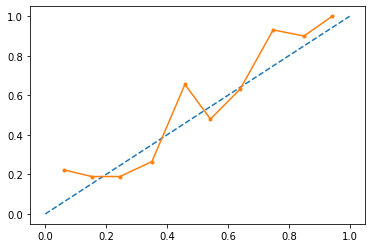

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.77       133
         1.0       0.78      0.69      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.02, n_estimator :180 max_features : 4, max_depth : 3 


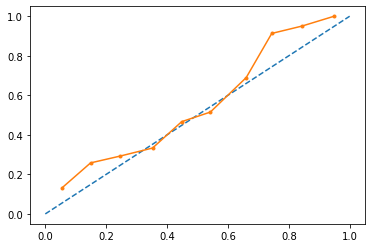

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.02, n_estimator :180 max_features : 4, max_depth : 4 


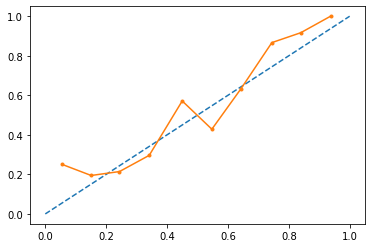

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.76      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.02, n_estimator :180 max_features : 4, max_depth : 5 


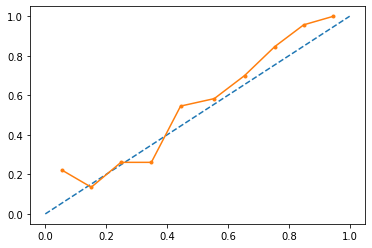

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.02, n_estimator :180 max_features : 5, max_depth : 3 


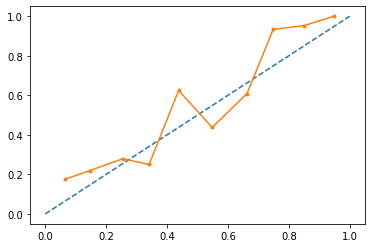

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :180 max_features : 5, max_depth : 4 


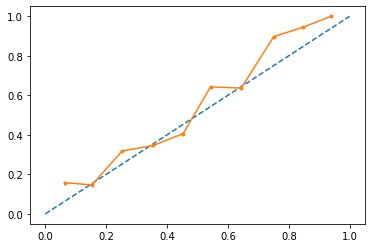

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.77      0.75       133
         1.0       0.75      0.70      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.02, n_estimator :180 max_features : 5, max_depth : 5 


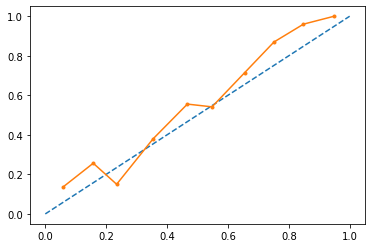

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.80      0.75       133
         1.0       0.77      0.68      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.02, n_estimator :200 max_features : 2, max_depth : 3 


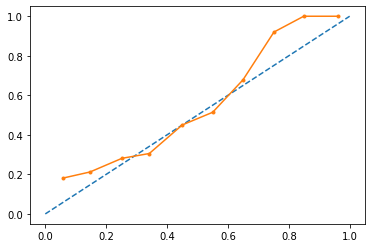

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :200 max_features : 2, max_depth : 4 


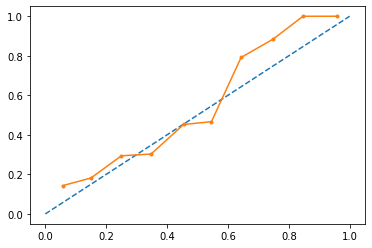

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.80      0.75       133
         1.0       0.77      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.74      0.73      0.73       265
weighted avg       0.74      0.73      0.73       265

learning rate: 0.02, n_estimator :200 max_features : 2, max_depth : 5 


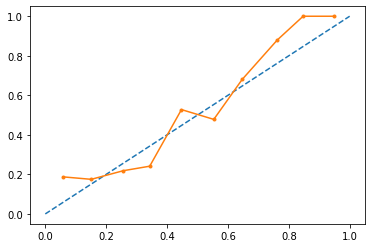

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.77       133
         1.0       0.79      0.68      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.02, n_estimator :200 max_features : 3, max_depth : 3 


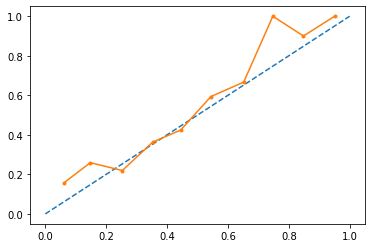

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.74       133
         1.0       0.75      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :200 max_features : 3, max_depth : 4 


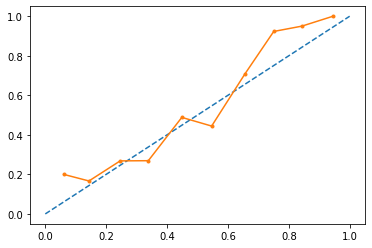

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.80      0.75       133
         1.0       0.76      0.66      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.02, n_estimator :200 max_features : 3, max_depth : 5 


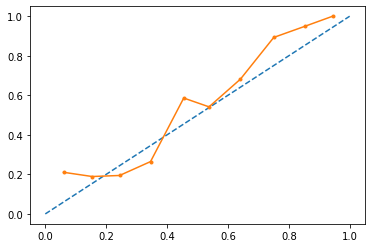

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.80      0.76       133
         1.0       0.78      0.70      0.74       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.02, n_estimator :200 max_features : 4, max_depth : 3 


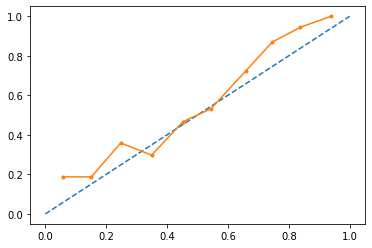

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.71       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.02, n_estimator :200 max_features : 4, max_depth : 4 


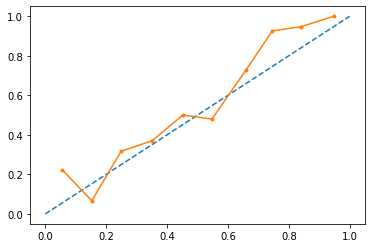

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.80      0.75       133
         1.0       0.77      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.73       265

learning rate: 0.02, n_estimator :200 max_features : 4, max_depth : 5 


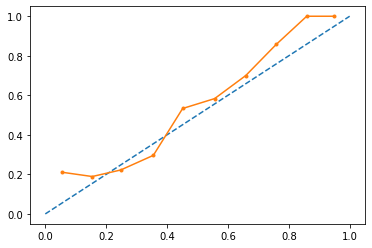

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.02, n_estimator :200 max_features : 5, max_depth : 3 


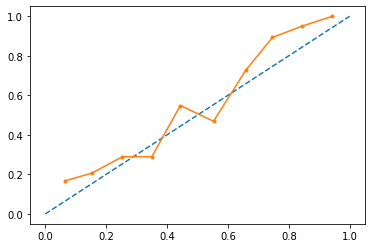

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.64      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.02, n_estimator :200 max_features : 5, max_depth : 4 


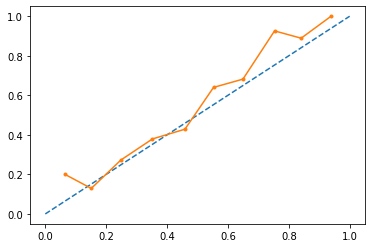

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.79      0.75       133
         1.0       0.76      0.69      0.73       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.02, n_estimator :200 max_features : 5, max_depth : 5 


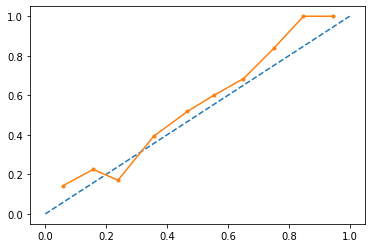

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.80      0.76       133
         1.0       0.77      0.69      0.73       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.01, n_estimator :100 max_features : 2, max_depth : 3 


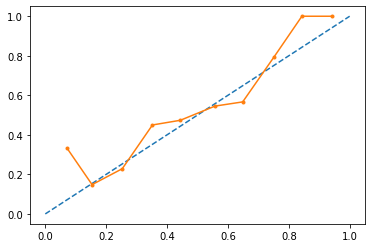

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.01, n_estimator :100 max_features : 2, max_depth : 4 


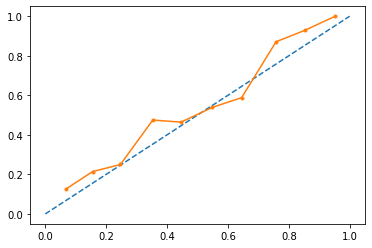

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.01, n_estimator :100 max_features : 2, max_depth : 5 


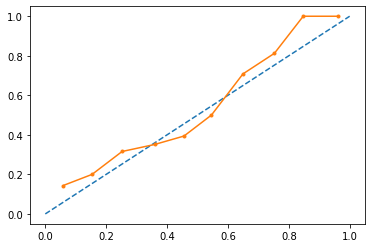

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :100 max_features : 3, max_depth : 3 


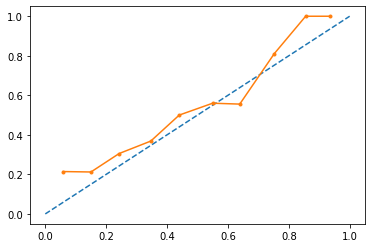

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.01, n_estimator :100 max_features : 3, max_depth : 4 


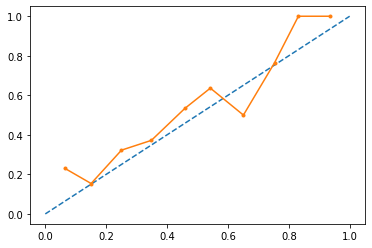

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :100 max_features : 3, max_depth : 5 


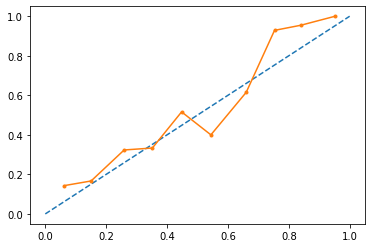

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.74      0.72       133
         1.0       0.73      0.68      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :100 max_features : 4, max_depth : 3 


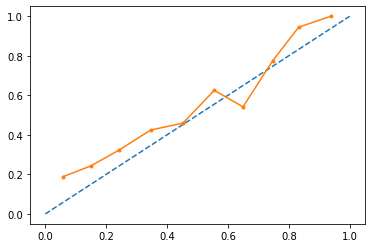

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.01, n_estimator :100 max_features : 4, max_depth : 4 


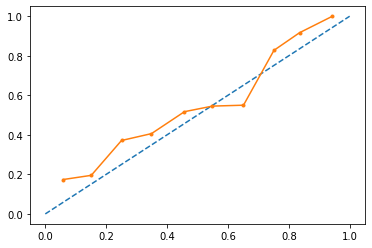

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :100 max_features : 4, max_depth : 5 


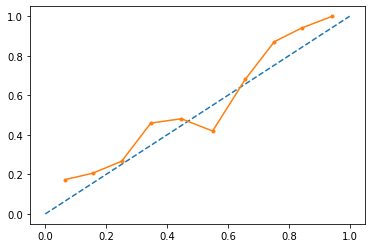

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.74      0.71       133
         1.0       0.71      0.64      0.68       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.01, n_estimator :100 max_features : 5, max_depth : 3 


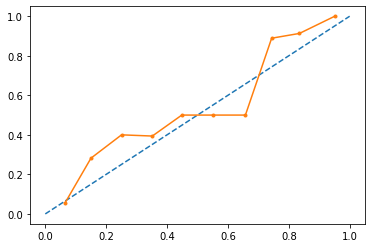

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       133
         1.0       0.72      0.62      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.01, n_estimator :100 max_features : 5, max_depth : 4 


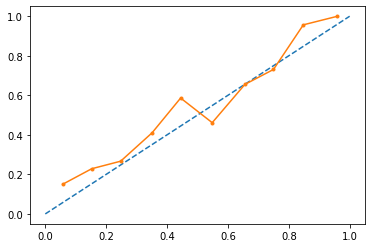

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :100 max_features : 5, max_depth : 5 


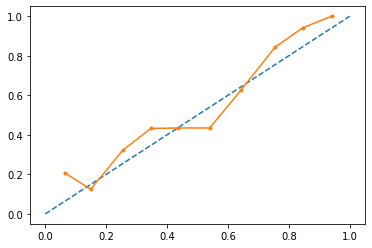

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :120 max_features : 2, max_depth : 3 


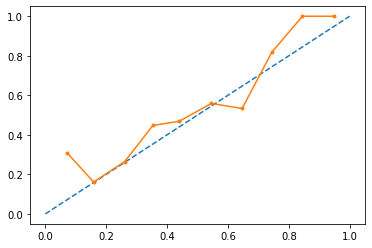

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.71      0.68       133
         1.0       0.68      0.63      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.01, n_estimator :120 max_features : 2, max_depth : 4 


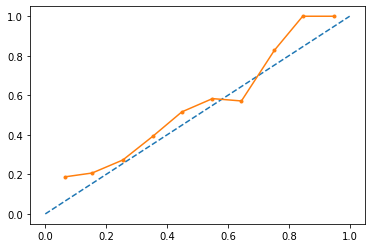

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.01, n_estimator :120 max_features : 2, max_depth : 5 


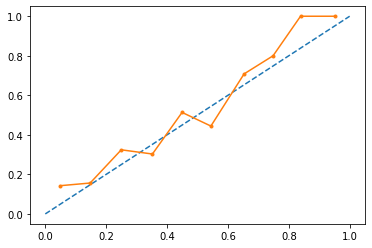

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.74       133
         1.0       0.75      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :120 max_features : 3, max_depth : 3 


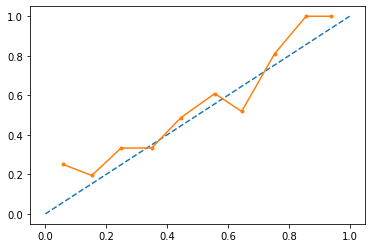

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.01, n_estimator :120 max_features : 3, max_depth : 4 


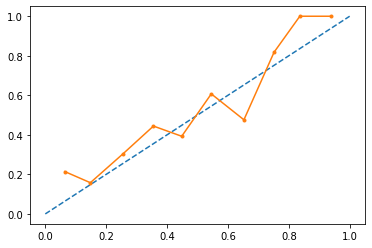

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :120 max_features : 3, max_depth : 5 


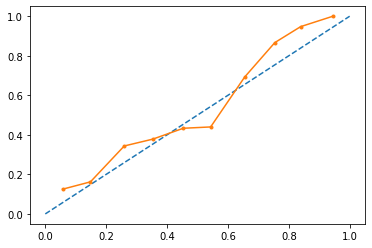

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :120 max_features : 4, max_depth : 3 


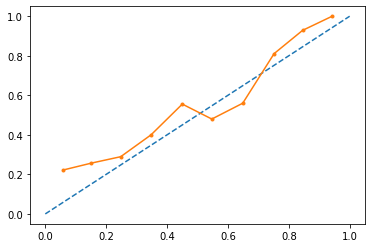

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.72      0.69       133
         1.0       0.69      0.62      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.01, n_estimator :120 max_features : 4, max_depth : 4 


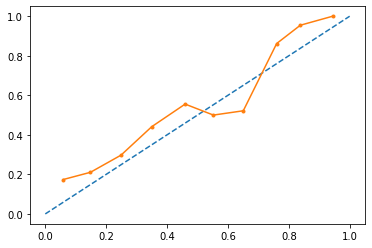

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :120 max_features : 4, max_depth : 5 


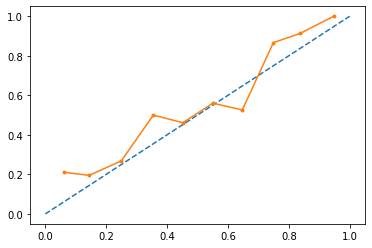

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.78      0.73       133
         1.0       0.75      0.65      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :120 max_features : 5, max_depth : 3 


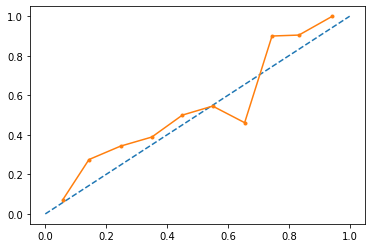

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.01, n_estimator :120 max_features : 5, max_depth : 4 


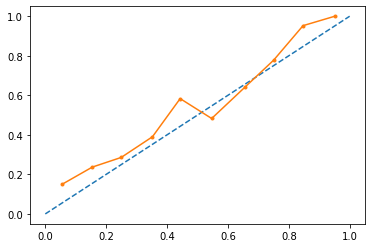

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.72      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :120 max_features : 5, max_depth : 5 


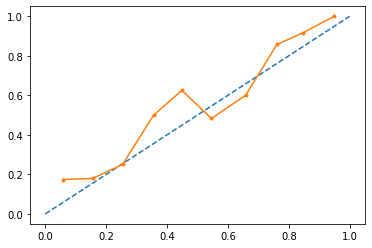

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :150 max_features : 2, max_depth : 3 


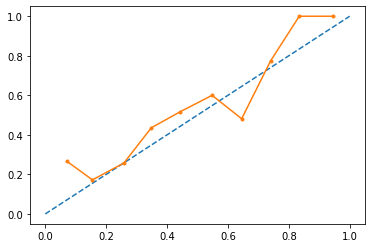

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.71      0.68       133
         1.0       0.68      0.64      0.66       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.01, n_estimator :150 max_features : 2, max_depth : 4 


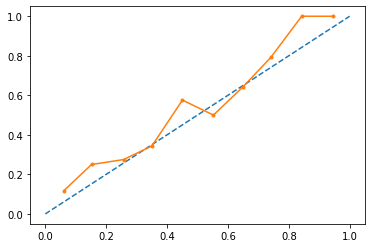

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :150 max_features : 2, max_depth : 5 


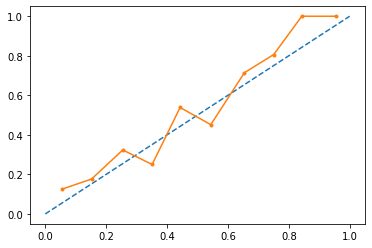

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :150 max_features : 3, max_depth : 3 


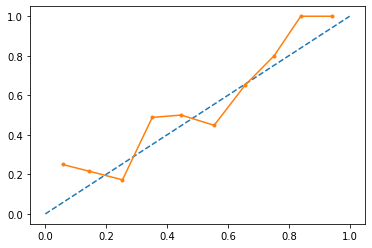

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.01, n_estimator :150 max_features : 3, max_depth : 4 


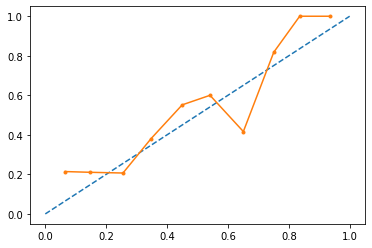

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.01, n_estimator :150 max_features : 3, max_depth : 5 


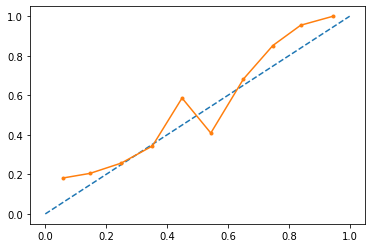

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :150 max_features : 4, max_depth : 3 


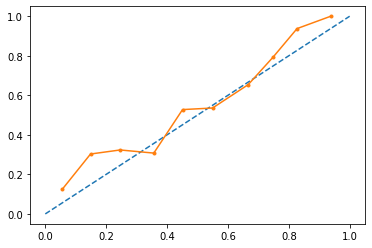

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.73      0.69       133
         1.0       0.69      0.62      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.01, n_estimator :150 max_features : 4, max_depth : 4 


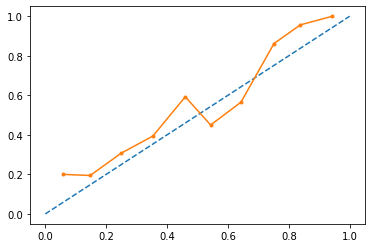

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :150 max_features : 4, max_depth : 5 


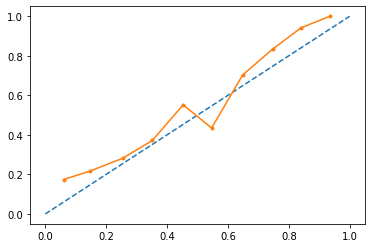

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :150 max_features : 5, max_depth : 3 


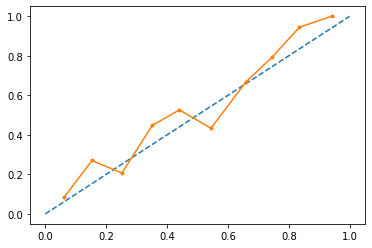

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.70      0.63      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.01, n_estimator :150 max_features : 5, max_depth : 4 


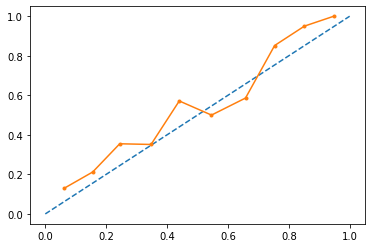

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :150 max_features : 5, max_depth : 5 


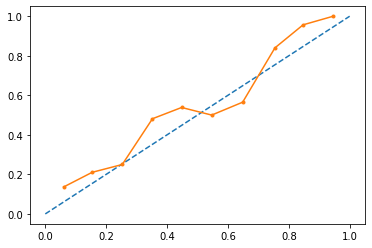

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.75      0.65      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :180 max_features : 2, max_depth : 3 


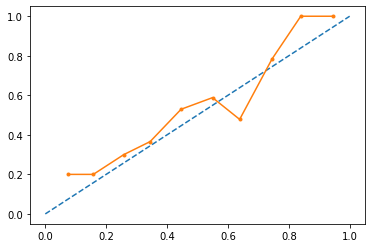

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.72      0.70       133
         1.0       0.70      0.64      0.67       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.01, n_estimator :180 max_features : 2, max_depth : 4 


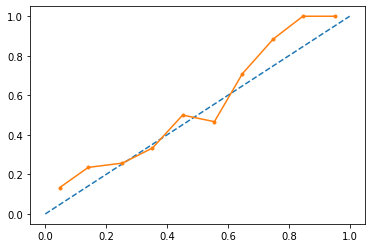

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :180 max_features : 2, max_depth : 5 


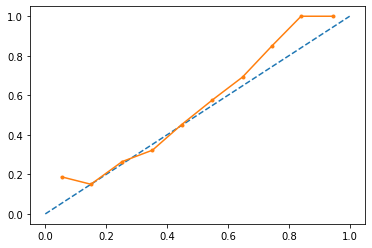

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.80      0.76       133
         1.0       0.78      0.69      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.01, n_estimator :180 max_features : 3, max_depth : 3 


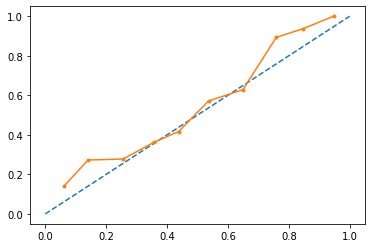

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :180 max_features : 3, max_depth : 4 


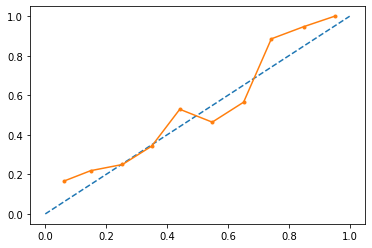

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.01, n_estimator :180 max_features : 3, max_depth : 5 


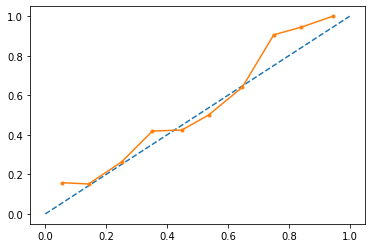

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.79      0.75       133
         1.0       0.76      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.74      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.01, n_estimator :180 max_features : 4, max_depth : 3 


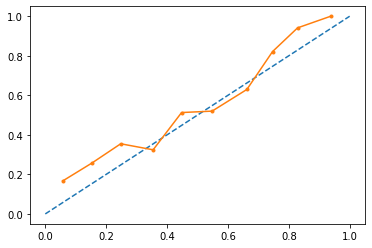

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.71      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.01, n_estimator :180 max_features : 4, max_depth : 4 


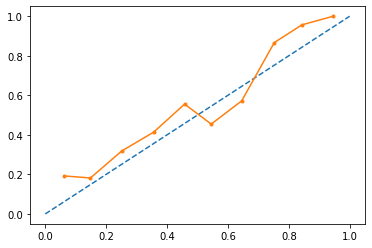

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :180 max_features : 4, max_depth : 5 


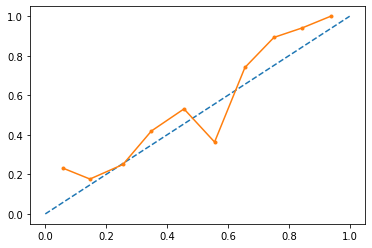

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.01, n_estimator :180 max_features : 5, max_depth : 3 


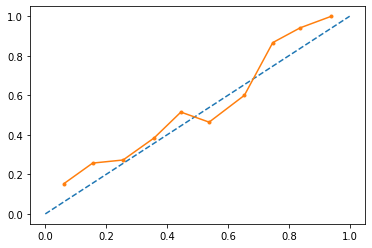

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.74      0.71       133
         1.0       0.71      0.64      0.68       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.01, n_estimator :180 max_features : 5, max_depth : 4 


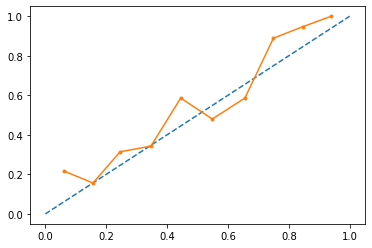

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :180 max_features : 5, max_depth : 5 


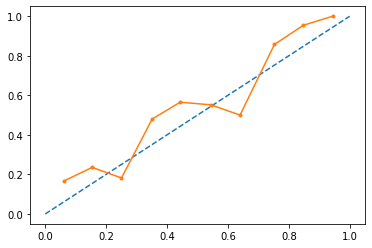

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.76      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.01, n_estimator :200 max_features : 2, max_depth : 3 


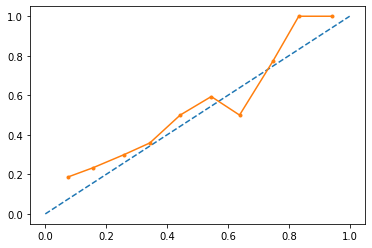

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.01, n_estimator :200 max_features : 2, max_depth : 4 


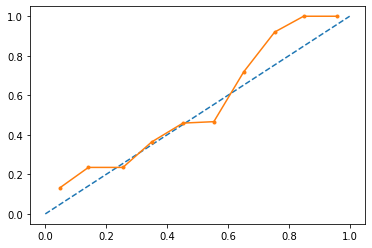

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :200 max_features : 2, max_depth : 5 


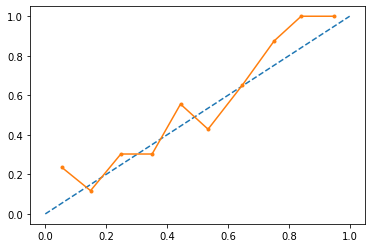

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.74       133
         1.0       0.75      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.01, n_estimator :200 max_features : 3, max_depth : 3 


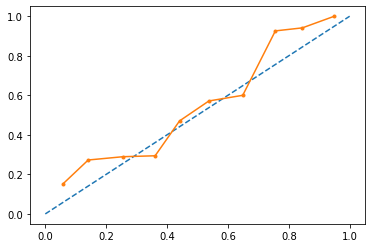

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.72      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :200 max_features : 3, max_depth : 4 


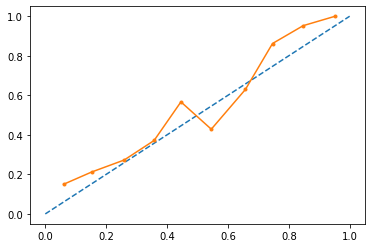

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.01, n_estimator :200 max_features : 3, max_depth : 5 


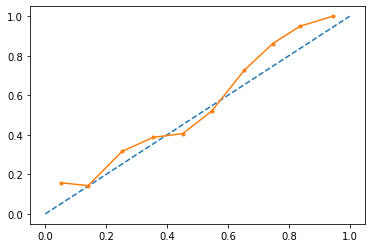

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.79      0.75       133
         1.0       0.76      0.68      0.72       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.73       265
weighted avg       0.74      0.74      0.74       265

learning rate: 0.01, n_estimator :200 max_features : 4, max_depth : 3 


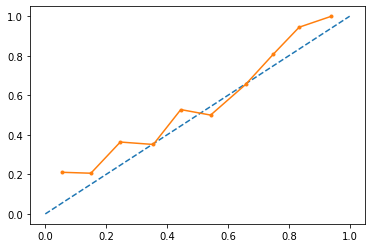

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.01, n_estimator :200 max_features : 4, max_depth : 4 


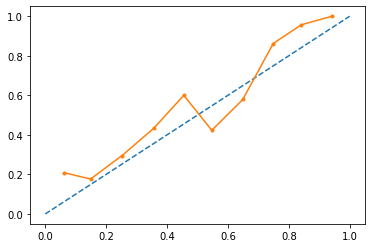

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.01, n_estimator :200 max_features : 4, max_depth : 5 


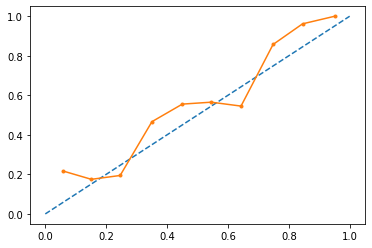

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.76      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.01, n_estimator :200 max_features : 5, max_depth : 3 


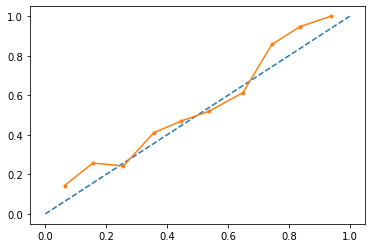

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.01, n_estimator :200 max_features : 5, max_depth : 4 


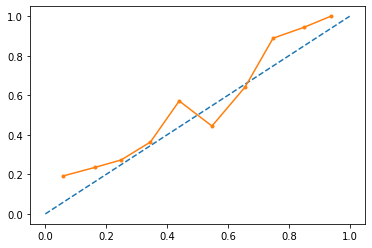

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.01, n_estimator :200 max_features : 5, max_depth : 5 


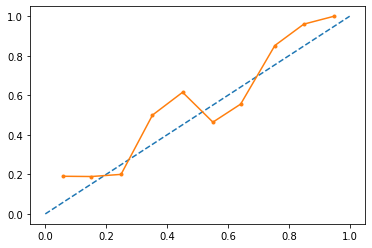

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.79      0.74       133
         1.0       0.76      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.008, n_estimator :100 max_features : 2, max_depth : 3 


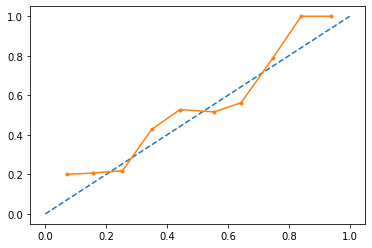

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.65       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.008, n_estimator :100 max_features : 2, max_depth : 4 


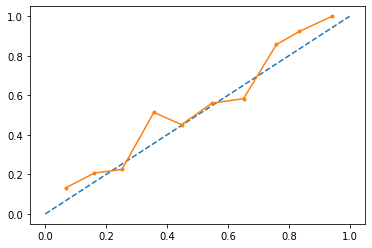

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.74      0.71       133
         1.0       0.71      0.64      0.68       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.008, n_estimator :100 max_features : 2, max_depth : 5 


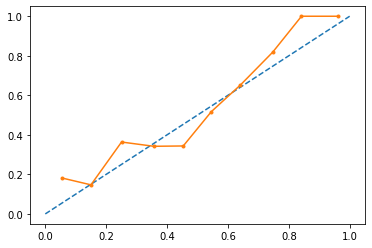

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.79      0.75       133
         1.0       0.76      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.74      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.008, n_estimator :100 max_features : 3, max_depth : 3 


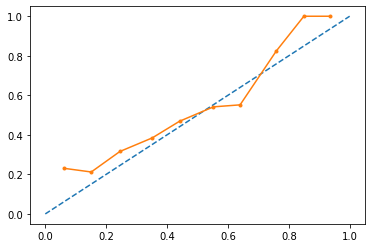

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.008, n_estimator :100 max_features : 3, max_depth : 4 


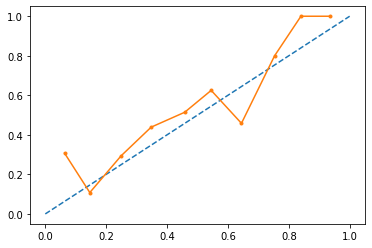

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.78      0.73       133
         1.0       0.75      0.64      0.69       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.008, n_estimator :100 max_features : 3, max_depth : 5 


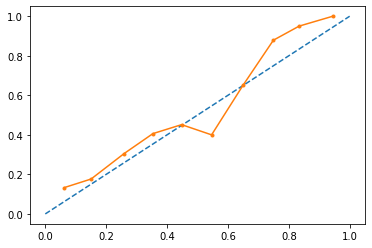

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :100 max_features : 4, max_depth : 3 


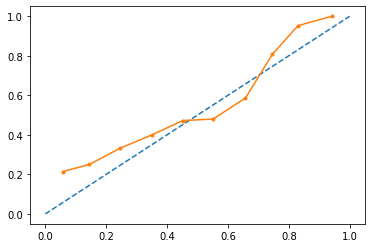

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.72      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.008, n_estimator :100 max_features : 4, max_depth : 4 


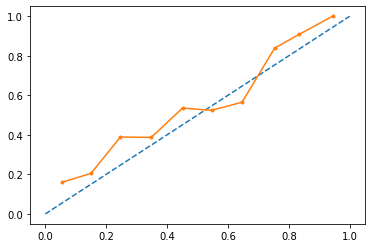

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :100 max_features : 4, max_depth : 5 


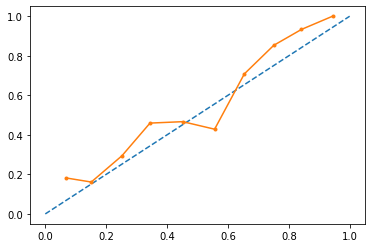

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.008, n_estimator :100 max_features : 5, max_depth : 3 


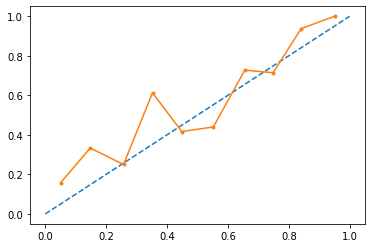

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.59      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.008, n_estimator :100 max_features : 5, max_depth : 4 


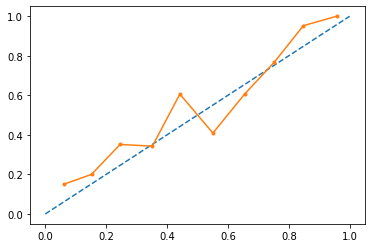

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.008, n_estimator :100 max_features : 5, max_depth : 5 


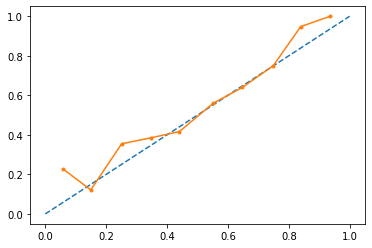

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :120 max_features : 2, max_depth : 3 


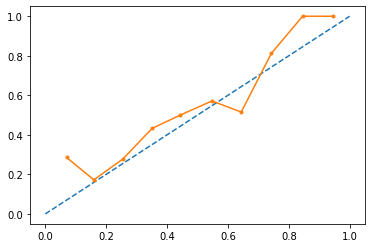

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.62      0.65       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.008, n_estimator :120 max_features : 2, max_depth : 4 


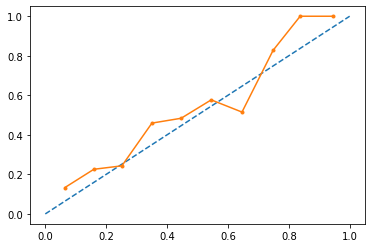

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.72      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :120 max_features : 2, max_depth : 5 


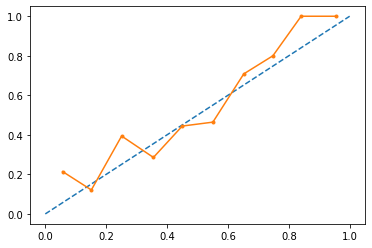

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.77      0.74       133
         1.0       0.75      0.68      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.008, n_estimator :120 max_features : 3, max_depth : 3 


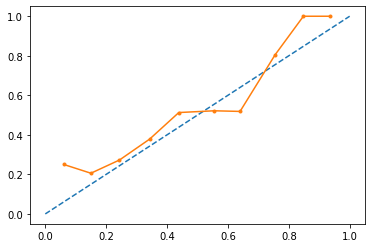

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.008, n_estimator :120 max_features : 3, max_depth : 4 


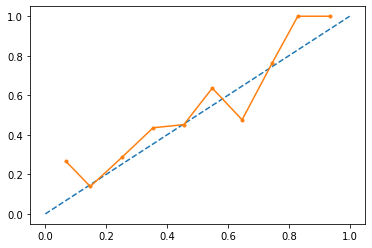

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.64      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :120 max_features : 3, max_depth : 5 


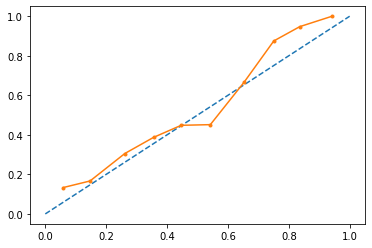

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.72       133
         1.0       0.72      0.67      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :120 max_features : 4, max_depth : 3 


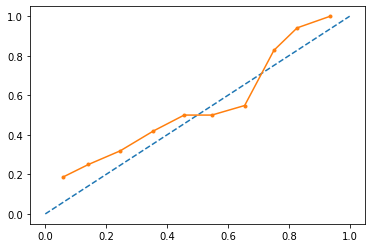

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.008, n_estimator :120 max_features : 4, max_depth : 4 


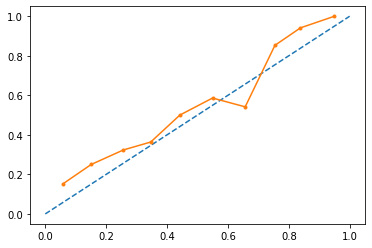

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :120 max_features : 4, max_depth : 5 


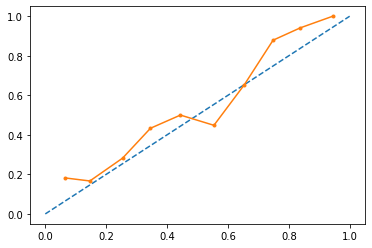

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.008, n_estimator :120 max_features : 5, max_depth : 3 


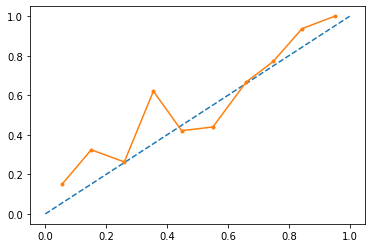

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.59      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.008, n_estimator :120 max_features : 5, max_depth : 4 


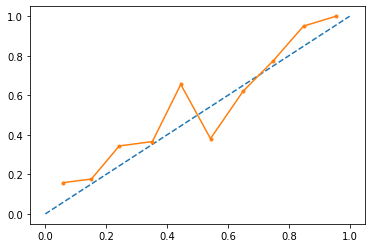

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.008, n_estimator :120 max_features : 5, max_depth : 5 


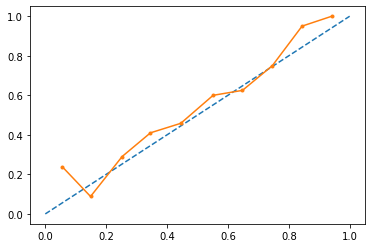

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.008, n_estimator :150 max_features : 2, max_depth : 3 


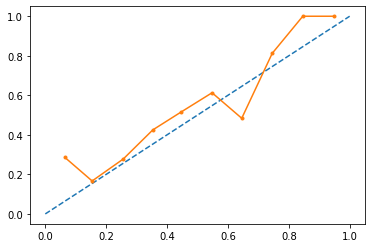

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.71      0.68       133
         1.0       0.68      0.63      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.008, n_estimator :150 max_features : 2, max_depth : 4 


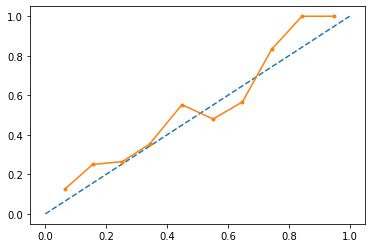

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.72       133
         1.0       0.72      0.67      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :150 max_features : 2, max_depth : 5 


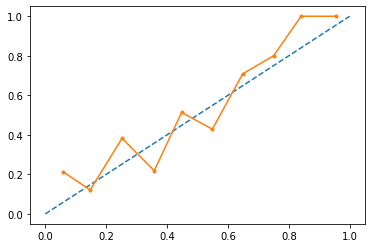

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.78      0.74       133
         1.0       0.75      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.008, n_estimator :150 max_features : 3, max_depth : 3 


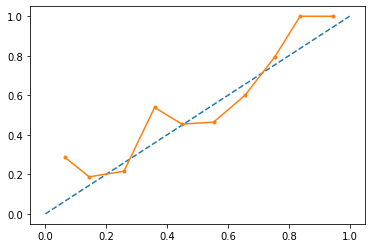

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.62      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.008, n_estimator :150 max_features : 3, max_depth : 4 


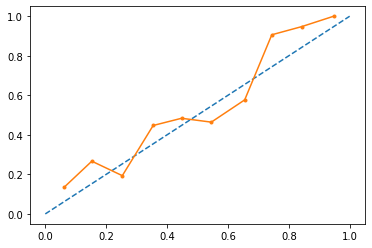

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.008, n_estimator :150 max_features : 3, max_depth : 5 


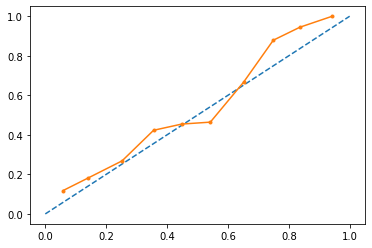

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.76      0.73       133
         1.0       0.74      0.69      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.008, n_estimator :150 max_features : 4, max_depth : 3 


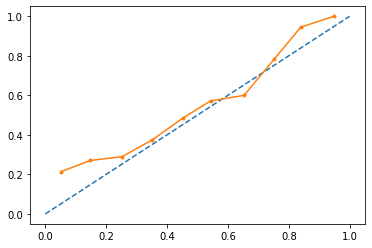

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.008, n_estimator :150 max_features : 4, max_depth : 4 


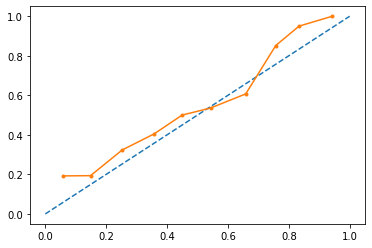

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.008, n_estimator :150 max_features : 4, max_depth : 5 


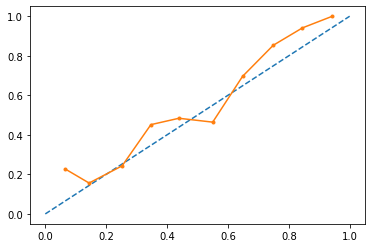

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.008, n_estimator :150 max_features : 5, max_depth : 3 


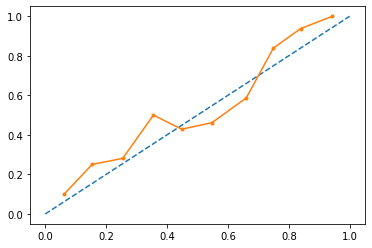

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.008, n_estimator :150 max_features : 5, max_depth : 4 


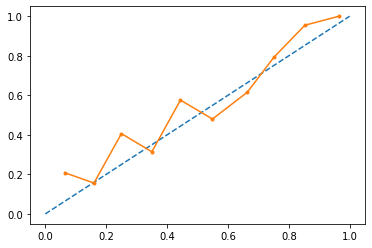

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.008, n_estimator :150 max_features : 5, max_depth : 5 


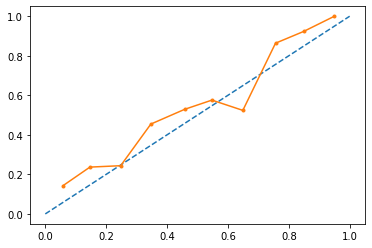

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.008, n_estimator :180 max_features : 2, max_depth : 3 


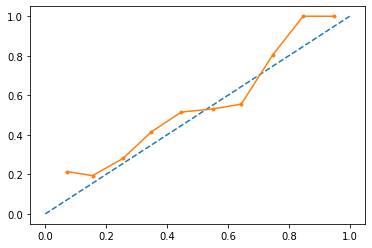

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.71      0.69       133
         1.0       0.69      0.64      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.008, n_estimator :180 max_features : 2, max_depth : 4 


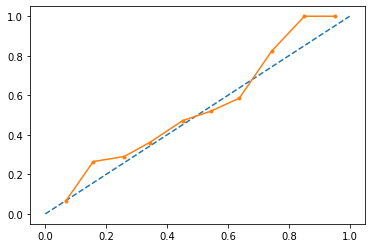

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :180 max_features : 2, max_depth : 5 


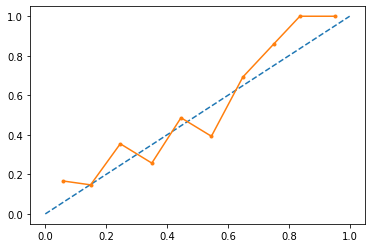

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.77      0.74       133
         1.0       0.75      0.68      0.71       132

    accuracy                           0.73       265
   macro avg       0.73      0.73      0.73       265
weighted avg       0.73      0.73      0.73       265

learning rate: 0.008, n_estimator :180 max_features : 3, max_depth : 3 


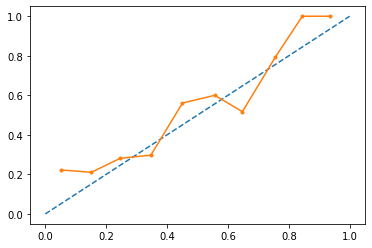

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.008, n_estimator :180 max_features : 3, max_depth : 4 


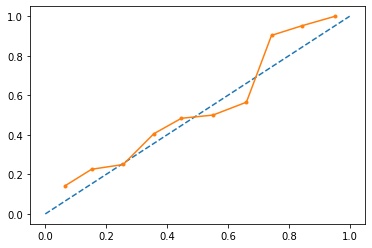

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.008, n_estimator :180 max_features : 3, max_depth : 5 


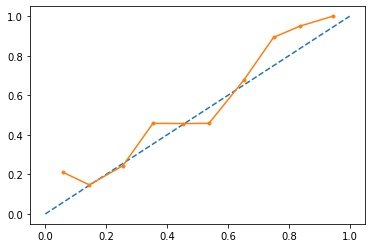

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.76      0.73       133
         1.0       0.74      0.68      0.71       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.008, n_estimator :180 max_features : 4, max_depth : 3 


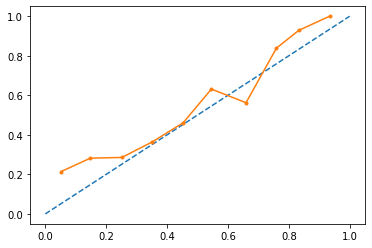

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.008, n_estimator :180 max_features : 4, max_depth : 4 


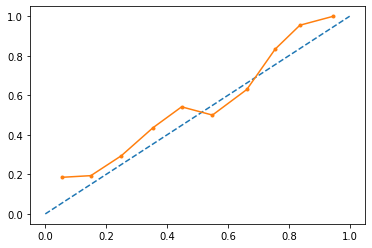

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.008, n_estimator :180 max_features : 4, max_depth : 5 


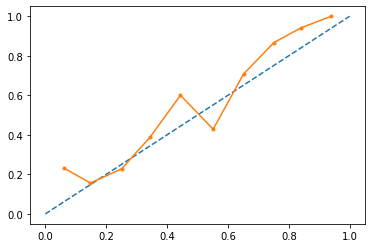

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :180 max_features : 5, max_depth : 3 


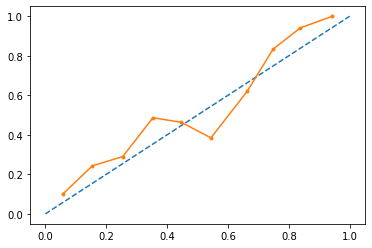

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.008, n_estimator :180 max_features : 5, max_depth : 4 


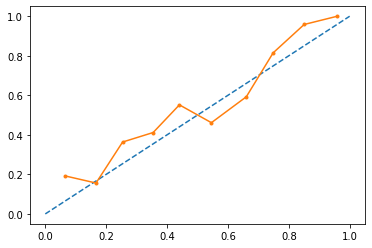

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.008, n_estimator :180 max_features : 5, max_depth : 5 


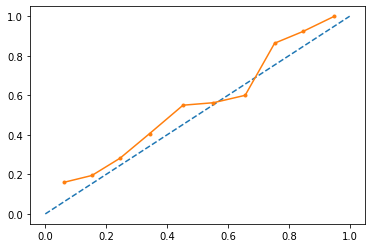

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.008, n_estimator :200 max_features : 2, max_depth : 3 


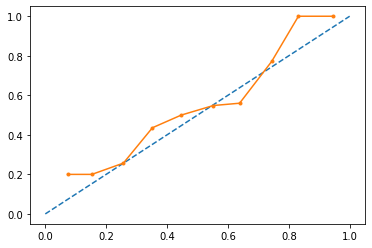

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.72      0.69       133
         1.0       0.69      0.63      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.008, n_estimator :200 max_features : 2, max_depth : 4 


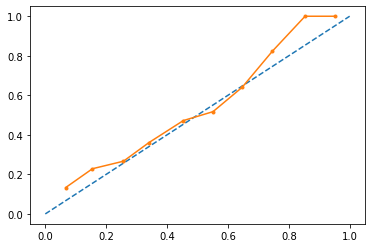

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.008, n_estimator :200 max_features : 2, max_depth : 5 


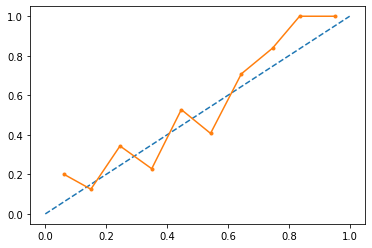

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.008, n_estimator :200 max_features : 3, max_depth : 3 


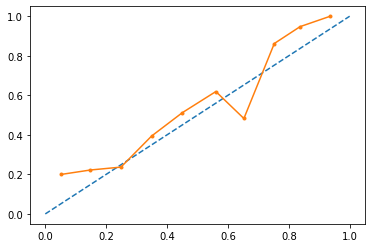

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.71      0.62      0.66       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.008, n_estimator :200 max_features : 3, max_depth : 4 


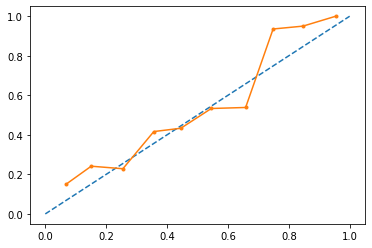

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :200 max_features : 3, max_depth : 5 


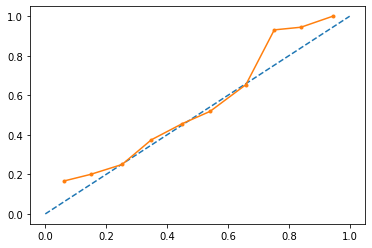

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.74      0.72       133
         1.0       0.73      0.68      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.008, n_estimator :200 max_features : 4, max_depth : 3 


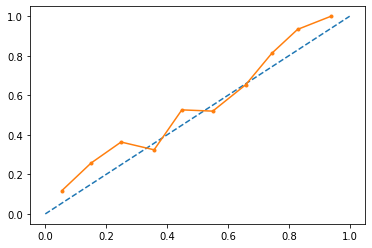

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.008, n_estimator :200 max_features : 4, max_depth : 4 


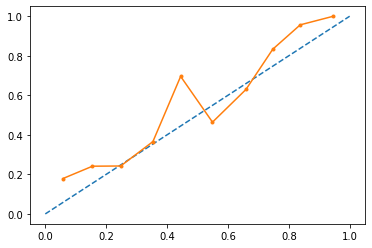

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.008, n_estimator :200 max_features : 4, max_depth : 5 


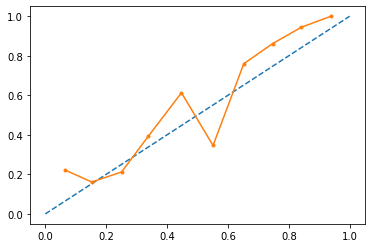

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.008, n_estimator :200 max_features : 5, max_depth : 3 


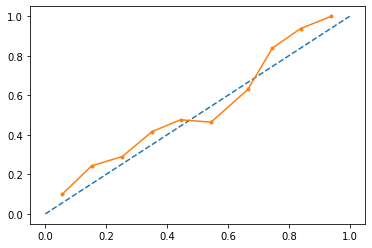

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.62      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.008, n_estimator :200 max_features : 5, max_depth : 4 


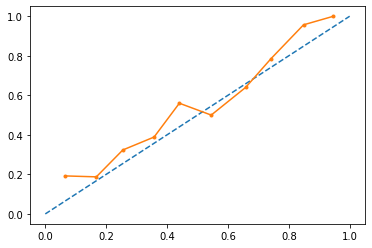

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.008, n_estimator :200 max_features : 5, max_depth : 5 


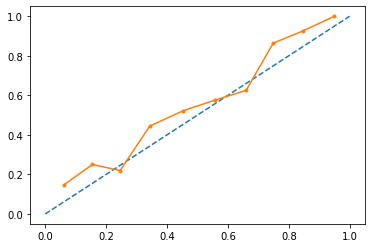

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.67      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.005, n_estimator :100 max_features : 2, max_depth : 3 


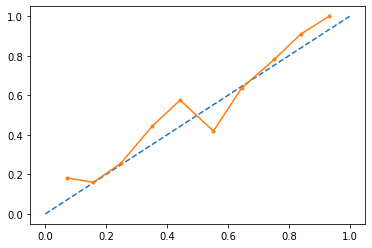

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :100 max_features : 2, max_depth : 4 


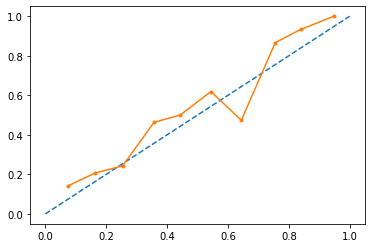

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.005, n_estimator :100 max_features : 2, max_depth : 5 


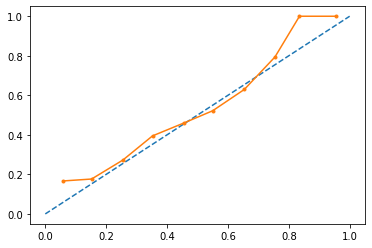

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.005, n_estimator :100 max_features : 3, max_depth : 3 


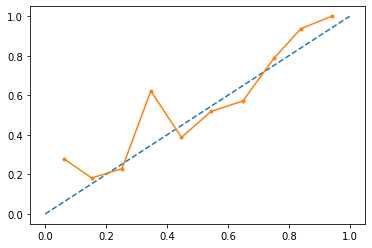

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.70      0.68       133
         1.0       0.67      0.63      0.65       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :100 max_features : 3, max_depth : 4 


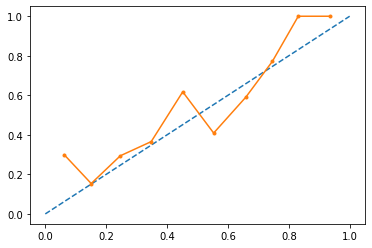

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.005, n_estimator :100 max_features : 3, max_depth : 5 


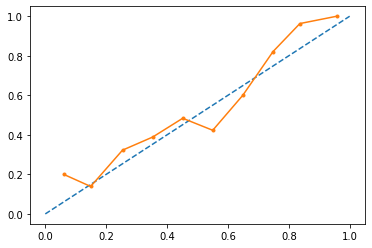

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.71       133
         1.0       0.72      0.66      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.005, n_estimator :100 max_features : 4, max_depth : 3 


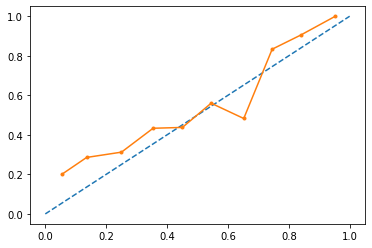

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.005, n_estimator :100 max_features : 4, max_depth : 4 


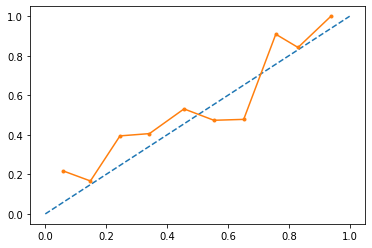

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.005, n_estimator :100 max_features : 4, max_depth : 5 


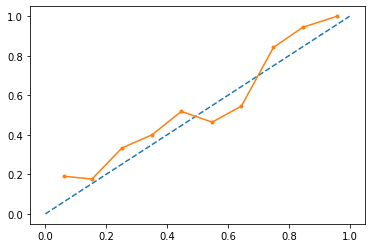

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.005, n_estimator :100 max_features : 5, max_depth : 3 


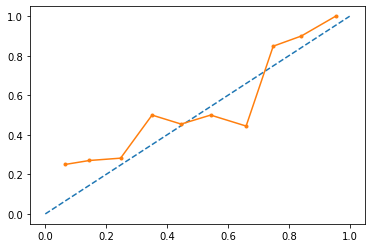

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.005, n_estimator :100 max_features : 5, max_depth : 4 


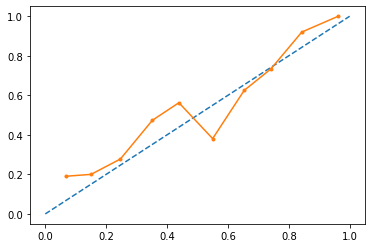

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.75      0.69       133
         1.0       0.70      0.58      0.64       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.005, n_estimator :100 max_features : 5, max_depth : 5 


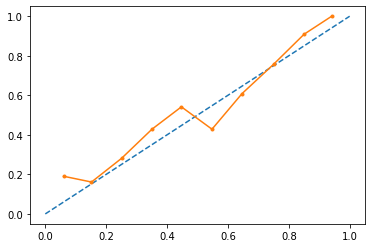

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.005, n_estimator :120 max_features : 2, max_depth : 3 


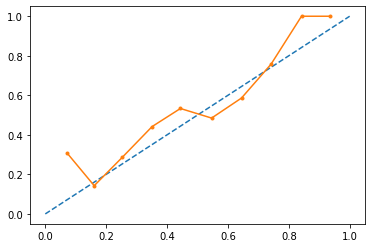

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.70      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :120 max_features : 2, max_depth : 4 


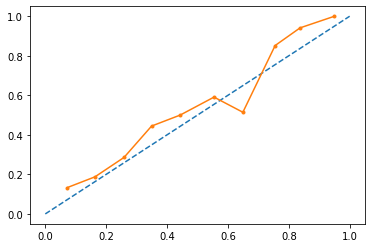

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.71      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.005, n_estimator :120 max_features : 2, max_depth : 5 


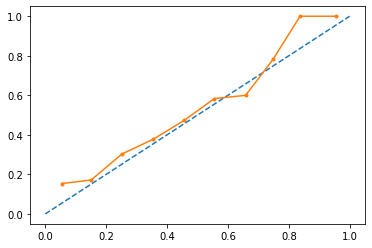

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.005, n_estimator :120 max_features : 3, max_depth : 3 


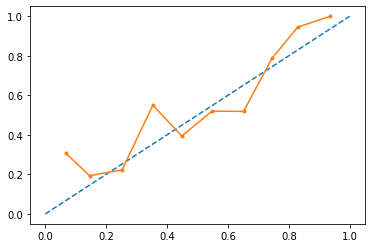

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :120 max_features : 3, max_depth : 4 


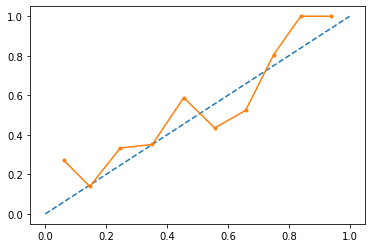

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.71      0.62      0.66       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.005, n_estimator :120 max_features : 3, max_depth : 5 


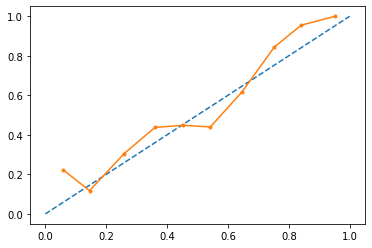

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.72       133
         1.0       0.72      0.67      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.005, n_estimator :120 max_features : 4, max_depth : 3 


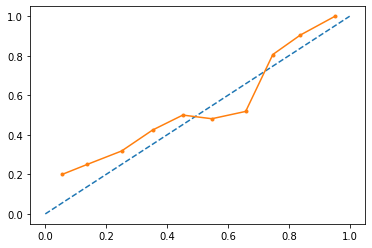

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.72      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.005, n_estimator :120 max_features : 4, max_depth : 4 


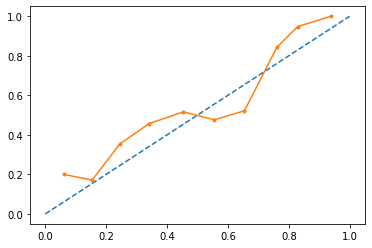

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.005, n_estimator :120 max_features : 4, max_depth : 5 


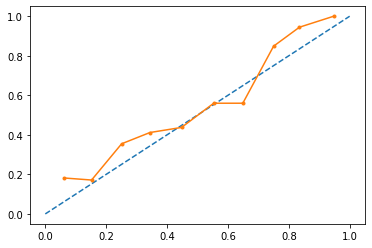

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.005, n_estimator :120 max_features : 5, max_depth : 3 


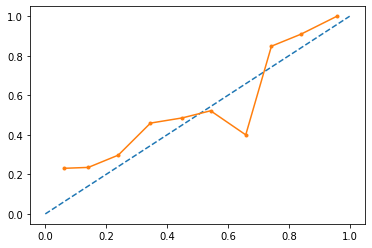

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.005, n_estimator :120 max_features : 5, max_depth : 4 


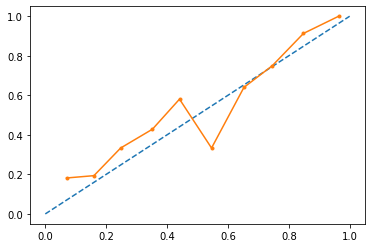

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.75      0.70       133
         1.0       0.71      0.60      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.005, n_estimator :120 max_features : 5, max_depth : 5 


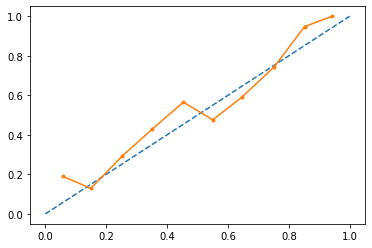

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.63      0.67       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.005, n_estimator :150 max_features : 2, max_depth : 3 


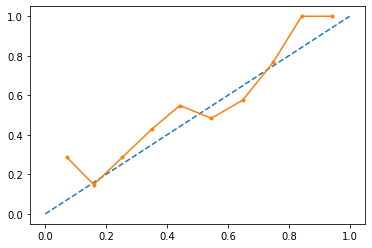

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.69      0.67       133
         1.0       0.67      0.62      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :150 max_features : 2, max_depth : 4 


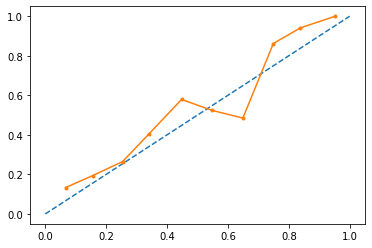

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.71      0.62      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.005, n_estimator :150 max_features : 2, max_depth : 5 


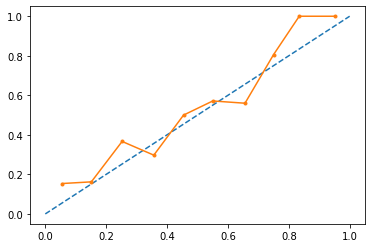

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.005, n_estimator :150 max_features : 3, max_depth : 3 


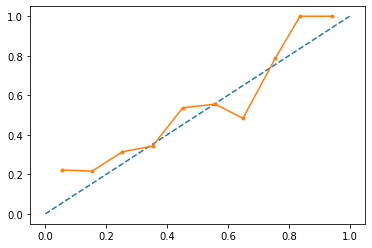

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.005, n_estimator :150 max_features : 3, max_depth : 4 


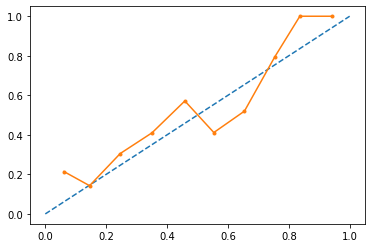

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.005, n_estimator :150 max_features : 3, max_depth : 5 


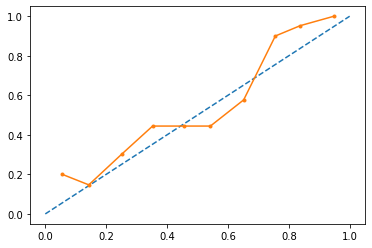

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.74      0.72       133
         1.0       0.72      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.005, n_estimator :150 max_features : 4, max_depth : 3 


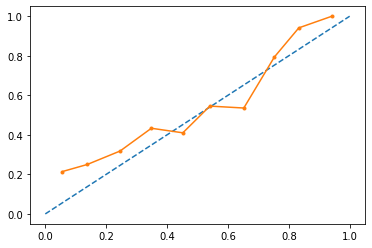

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.005, n_estimator :150 max_features : 4, max_depth : 4 


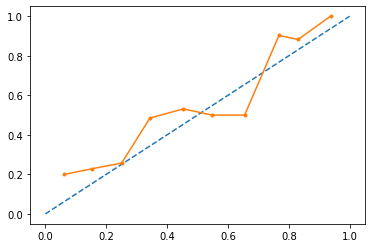

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.73       133
         1.0       0.74      0.64      0.68       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.005, n_estimator :150 max_features : 4, max_depth : 5 


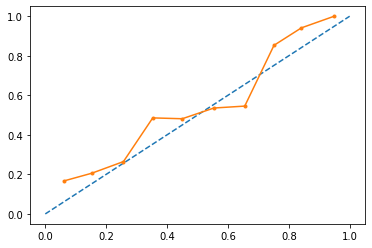

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.005, n_estimator :150 max_features : 5, max_depth : 3 


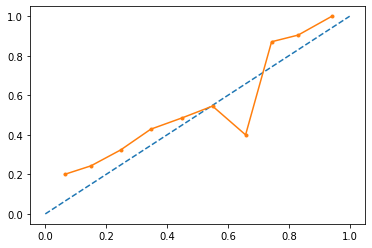

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.005, n_estimator :150 max_features : 5, max_depth : 4 


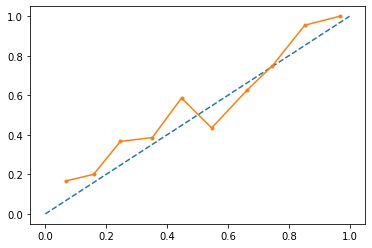

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.005, n_estimator :150 max_features : 5, max_depth : 5 


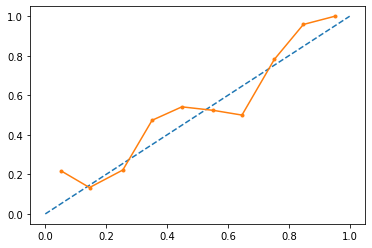

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.005, n_estimator :180 max_features : 2, max_depth : 3 


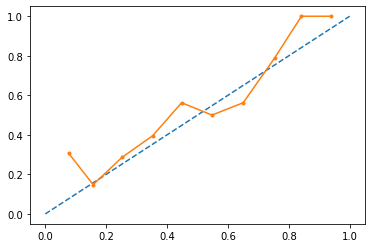

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.69      0.67       133
         1.0       0.67      0.62      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :180 max_features : 2, max_depth : 4 


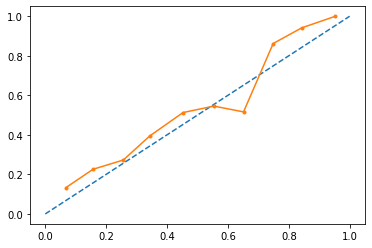

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.005, n_estimator :180 max_features : 2, max_depth : 5 


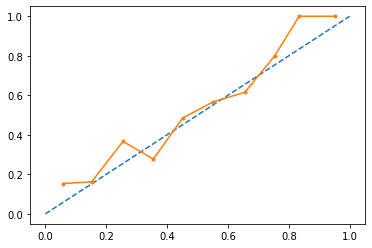

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.77      0.74       133
         1.0       0.74      0.68      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.005, n_estimator :180 max_features : 3, max_depth : 3 


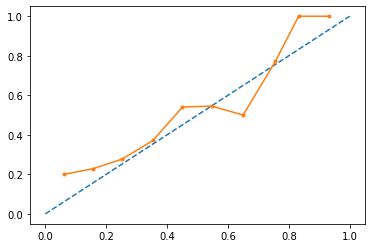

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.005, n_estimator :180 max_features : 3, max_depth : 4 


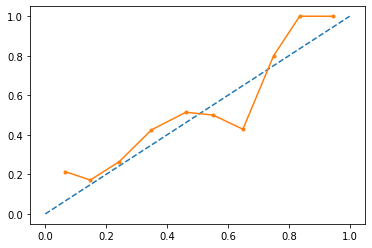

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.005, n_estimator :180 max_features : 3, max_depth : 5 


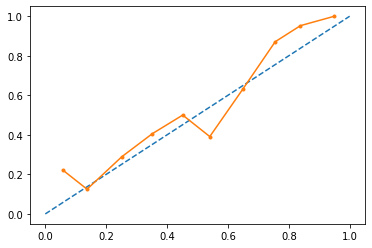

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.74      0.72       133
         1.0       0.73      0.68      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.005, n_estimator :180 max_features : 4, max_depth : 3 


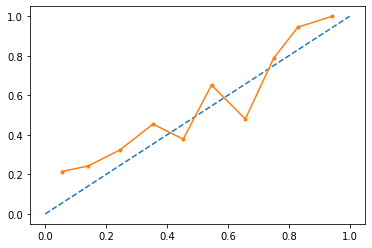

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.71      0.62      0.66       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.005, n_estimator :180 max_features : 4, max_depth : 4 


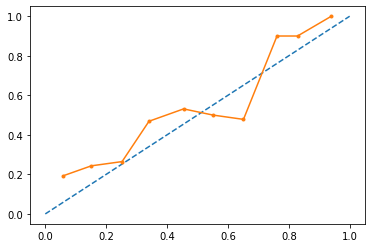

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.005, n_estimator :180 max_features : 4, max_depth : 5 


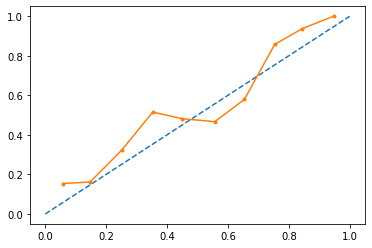

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.76      0.73       133
         1.0       0.74      0.68      0.71       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.005, n_estimator :180 max_features : 5, max_depth : 3 


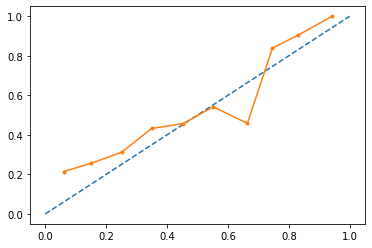

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.005, n_estimator :180 max_features : 5, max_depth : 4 


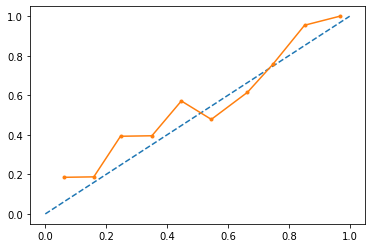

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.005, n_estimator :180 max_features : 5, max_depth : 5 


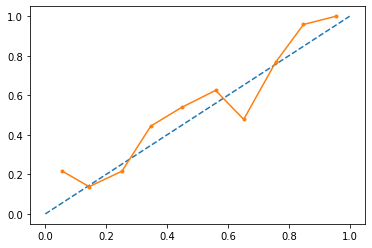

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.005, n_estimator :200 max_features : 2, max_depth : 3 


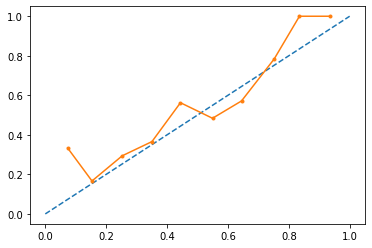

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.70      0.68       133
         1.0       0.67      0.63      0.65       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.005, n_estimator :200 max_features : 2, max_depth : 4 


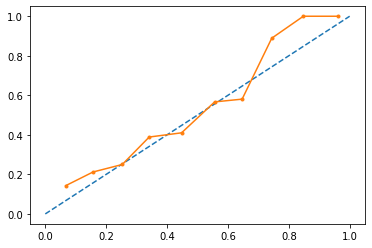

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.005, n_estimator :200 max_features : 2, max_depth : 5 


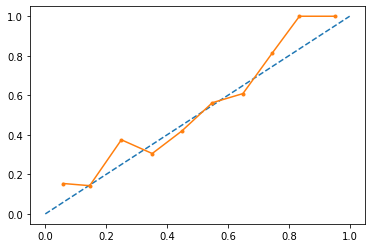

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.005, n_estimator :200 max_features : 3, max_depth : 3 


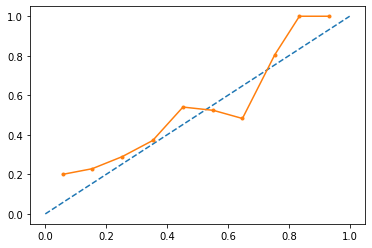

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.005, n_estimator :200 max_features : 3, max_depth : 4 


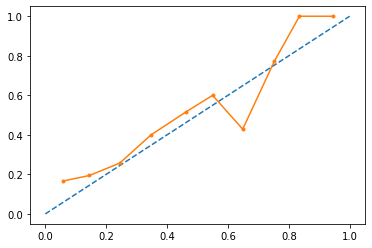

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.77      0.72       133
         1.0       0.73      0.62      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.005, n_estimator :200 max_features : 3, max_depth : 5 


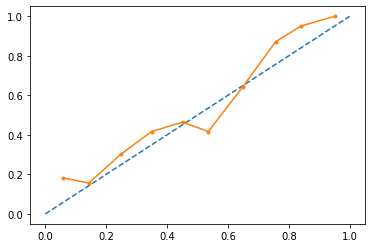

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.76      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.005, n_estimator :200 max_features : 4, max_depth : 3 


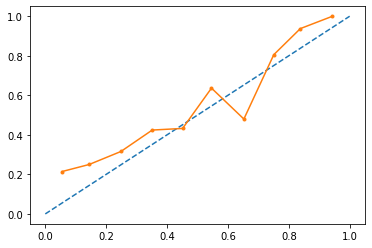

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.71       133
         1.0       0.72      0.61      0.66       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.68       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.005, n_estimator :200 max_features : 4, max_depth : 4 


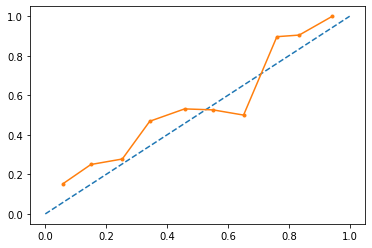

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.005, n_estimator :200 max_features : 4, max_depth : 5 


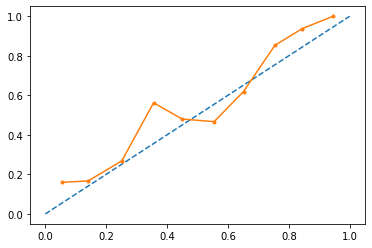

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.76      0.73       133
         1.0       0.74      0.68      0.71       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.005, n_estimator :200 max_features : 5, max_depth : 3 


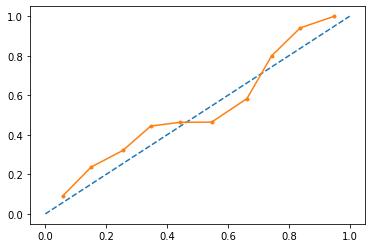

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.62      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.005, n_estimator :200 max_features : 5, max_depth : 4 


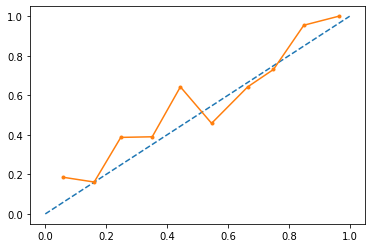

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.005, n_estimator :200 max_features : 5, max_depth : 5 


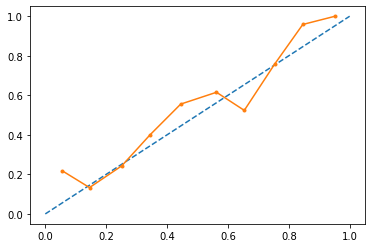

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.002, n_estimator :100 max_features : 2, max_depth : 3 


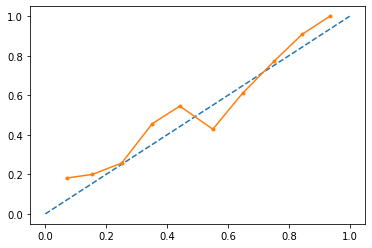

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.70      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :100 max_features : 2, max_depth : 4 


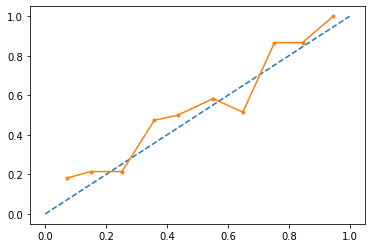

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.002, n_estimator :100 max_features : 2, max_depth : 5 


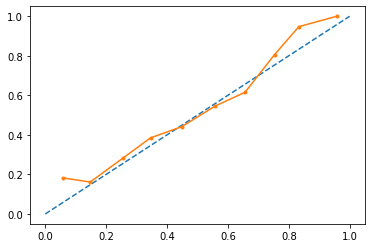

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.73       133
         1.0       0.74      0.64      0.68       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.002, n_estimator :100 max_features : 3, max_depth : 3 


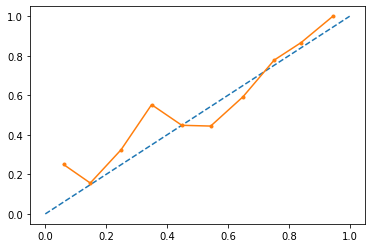

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.67       133
         1.0       0.66      0.61      0.64       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :100 max_features : 3, max_depth : 4 


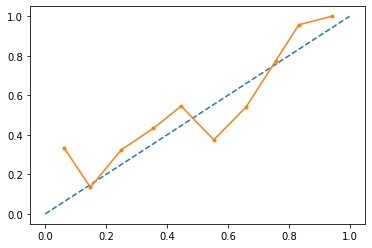

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.002, n_estimator :100 max_features : 3, max_depth : 5 


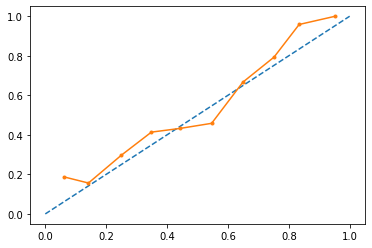

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.74      0.71       133
         1.0       0.72      0.65      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :100 max_features : 4, max_depth : 3 


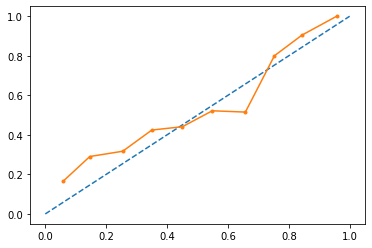

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :100 max_features : 4, max_depth : 4 


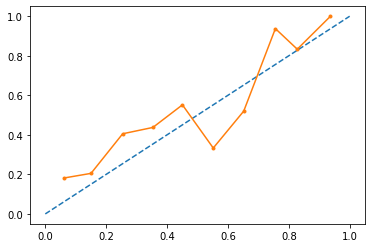

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.71      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.002, n_estimator :100 max_features : 4, max_depth : 5 


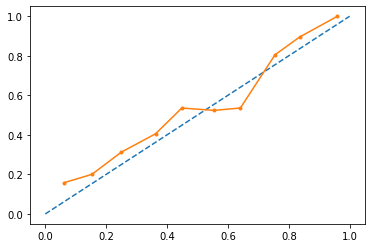

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.002, n_estimator :100 max_features : 5, max_depth : 3 


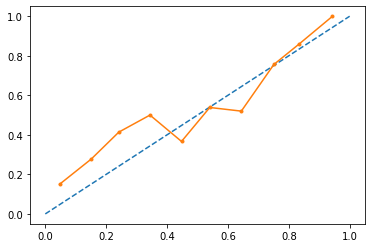

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.60      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :100 max_features : 5, max_depth : 4 


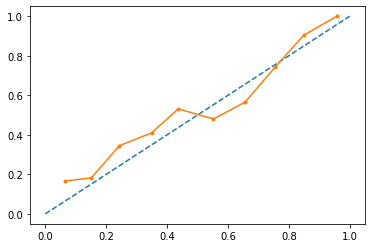

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.002, n_estimator :100 max_features : 5, max_depth : 5 


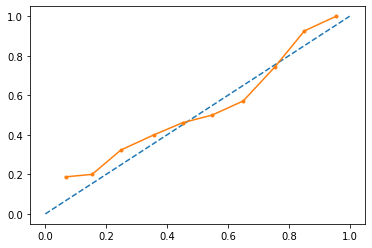

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.002, n_estimator :120 max_features : 2, max_depth : 3 


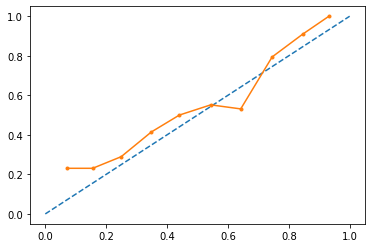

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.70      0.67       133
         1.0       0.66      0.60      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :120 max_features : 2, max_depth : 4 


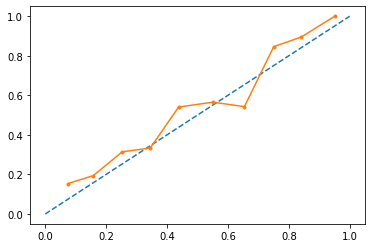

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.002, n_estimator :120 max_features : 2, max_depth : 5 


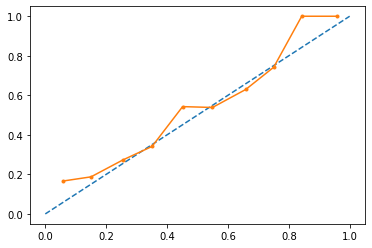

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.63      0.67       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :120 max_features : 3, max_depth : 3 


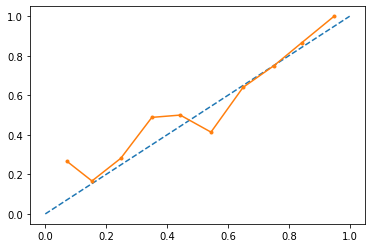

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :120 max_features : 3, max_depth : 4 


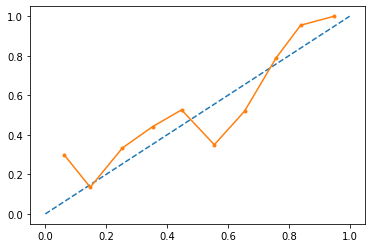

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.74      0.69       133
         1.0       0.69      0.59      0.64       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.002, n_estimator :120 max_features : 3, max_depth : 5 


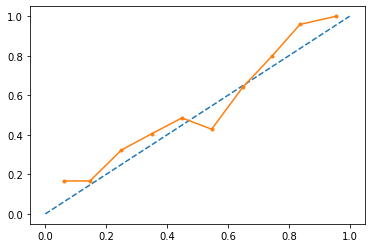

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.002, n_estimator :120 max_features : 4, max_depth : 3 


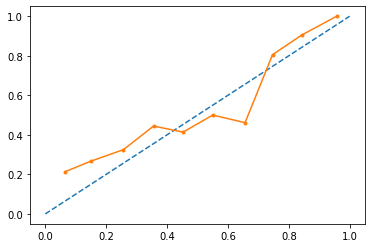

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :120 max_features : 4, max_depth : 4 


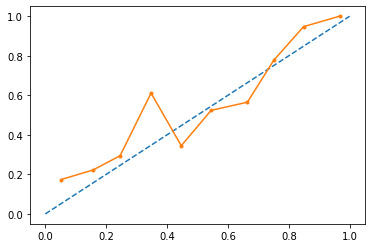

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.69      0.60      0.64       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.002, n_estimator :120 max_features : 4, max_depth : 5 


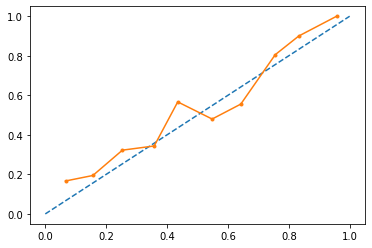

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.002, n_estimator :120 max_features : 5, max_depth : 3 


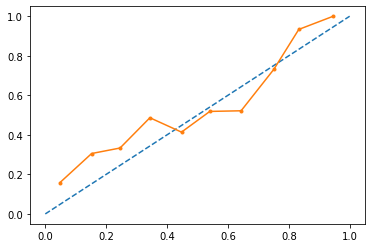

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.72      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.002, n_estimator :120 max_features : 5, max_depth : 4 


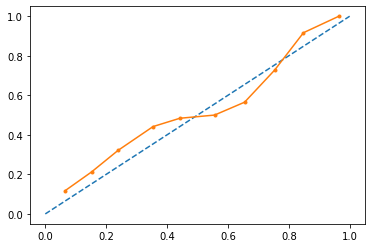

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.002, n_estimator :120 max_features : 5, max_depth : 5 


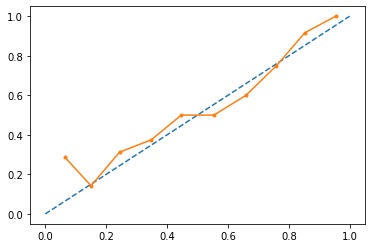

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.76      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.002, n_estimator :150 max_features : 2, max_depth : 3 


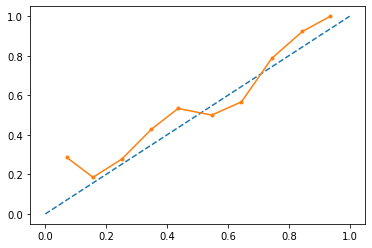

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.70      0.67       133
         1.0       0.66      0.60      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :150 max_features : 2, max_depth : 4 


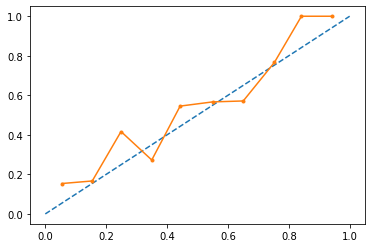

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.73      0.70       133
         1.0       0.70      0.64      0.67       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.002, n_estimator :150 max_features : 2, max_depth : 5 


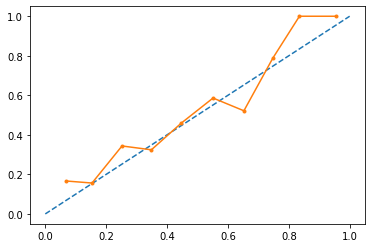

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.77      0.73       133
         1.0       0.74      0.66      0.70       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 0.002, n_estimator :150 max_features : 3, max_depth : 3 


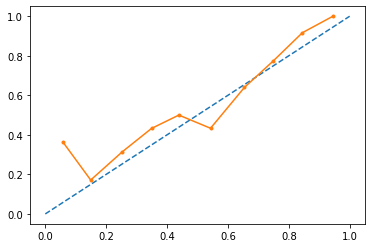

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.66       133
         1.0       0.66      0.61      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :150 max_features : 3, max_depth : 4 


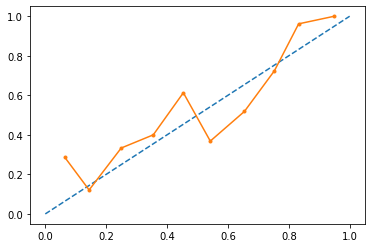

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.73      0.68       133
         1.0       0.68      0.59      0.63       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :150 max_features : 3, max_depth : 5 


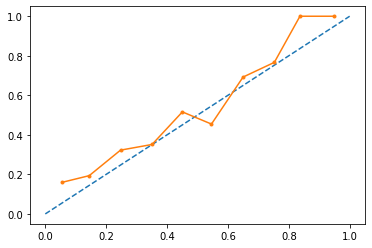

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.71       133
         1.0       0.71      0.66      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :150 max_features : 4, max_depth : 3 


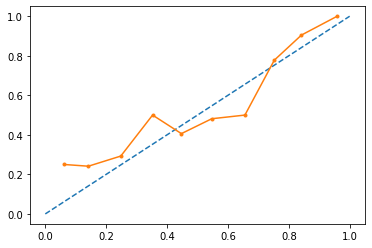

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :150 max_features : 4, max_depth : 4 


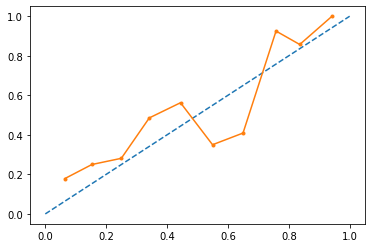

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.002, n_estimator :150 max_features : 4, max_depth : 5 


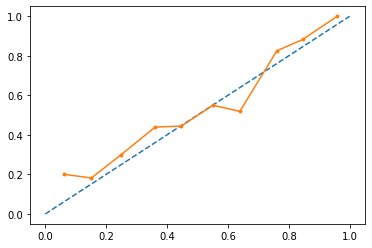

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :150 max_features : 5, max_depth : 3 


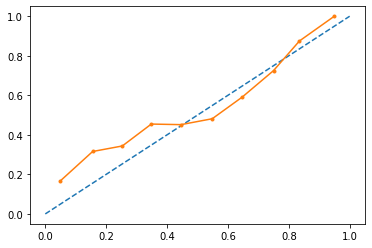

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.65       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.002, n_estimator :150 max_features : 5, max_depth : 4 


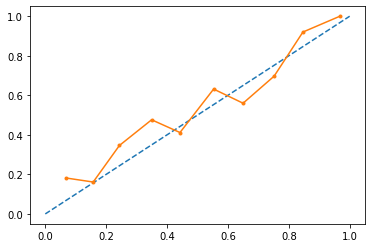

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.002, n_estimator :150 max_features : 5, max_depth : 5 


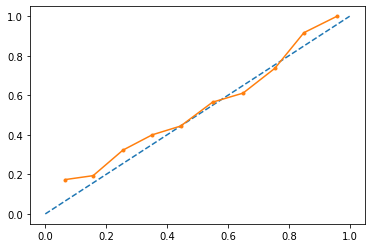

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.002, n_estimator :180 max_features : 2, max_depth : 3 


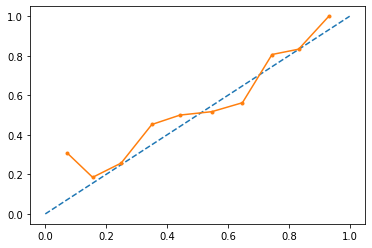

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.66       133
         1.0       0.66      0.61      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :180 max_features : 2, max_depth : 4 


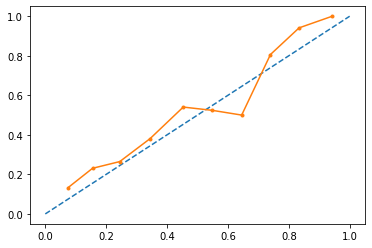

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.73      0.69       133
         1.0       0.69      0.62      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.002, n_estimator :180 max_features : 2, max_depth : 5 


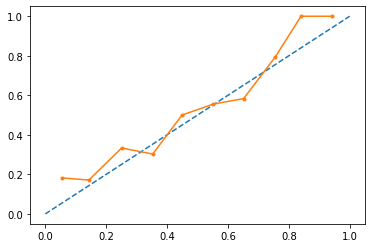

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.67      0.71       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 0.002, n_estimator :180 max_features : 3, max_depth : 3 


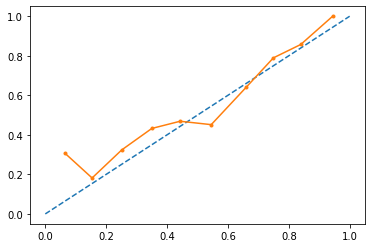

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.70      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :180 max_features : 3, max_depth : 4 


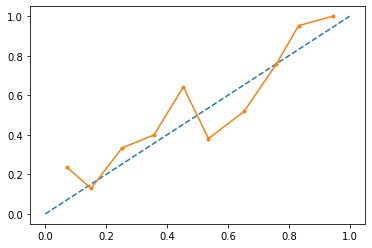

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.002, n_estimator :180 max_features : 3, max_depth : 5 


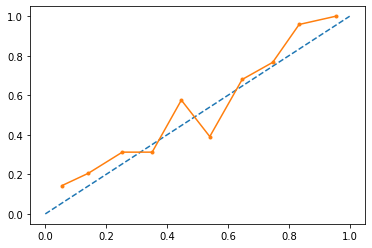

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.71       133
         1.0       0.72      0.66      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :180 max_features : 4, max_depth : 3 


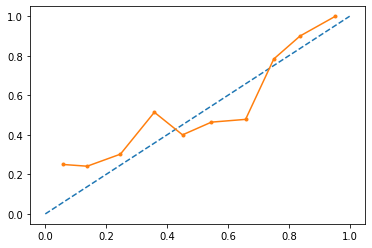

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :180 max_features : 4, max_depth : 4 


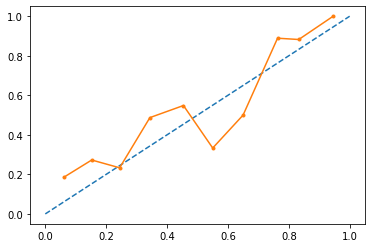

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.002, n_estimator :180 max_features : 4, max_depth : 5 


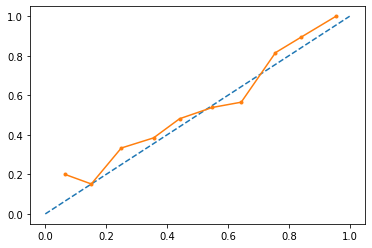

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :180 max_features : 5, max_depth : 3 


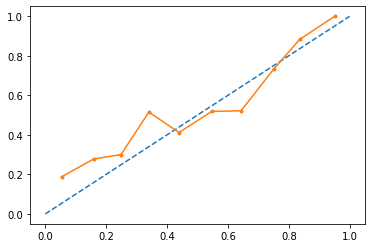

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :180 max_features : 5, max_depth : 4 


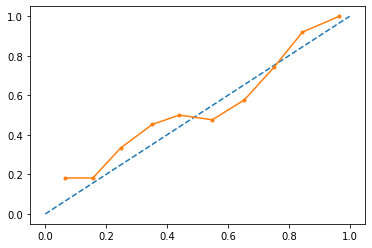

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.002, n_estimator :180 max_features : 5, max_depth : 5 


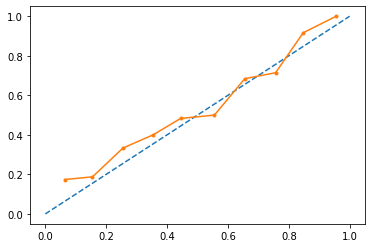

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.002, n_estimator :200 max_features : 2, max_depth : 3 


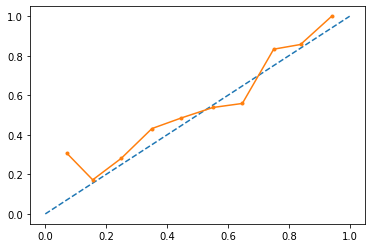

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.67       133
         1.0       0.66      0.61      0.64       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :200 max_features : 2, max_depth : 4 


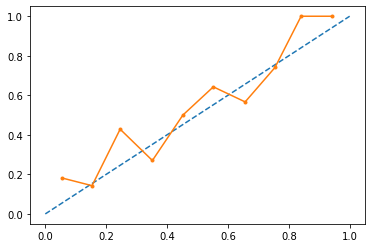

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :200 max_features : 2, max_depth : 5 


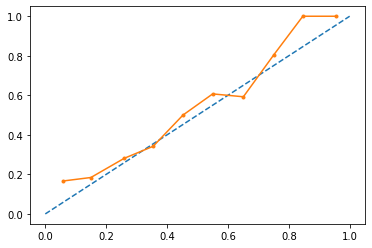

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.66      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.002, n_estimator :200 max_features : 3, max_depth : 3 


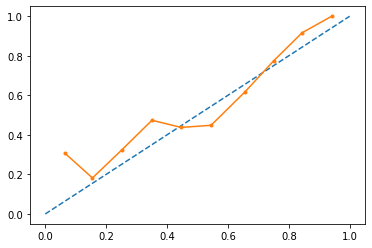

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.67       133
         1.0       0.66      0.61      0.64       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.002, n_estimator :200 max_features : 3, max_depth : 4 


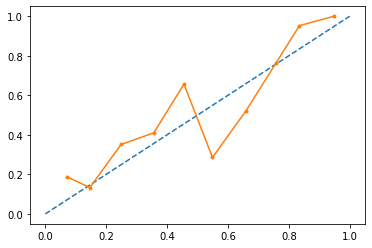

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.65       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.002, n_estimator :200 max_features : 3, max_depth : 5 


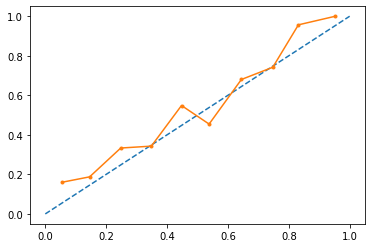

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.74      0.71       133
         1.0       0.71      0.66      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :200 max_features : 4, max_depth : 3 


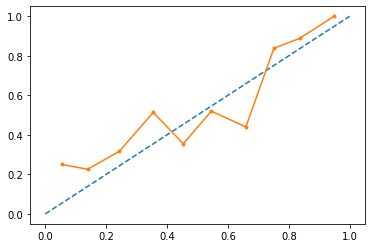

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.002, n_estimator :200 max_features : 4, max_depth : 4 


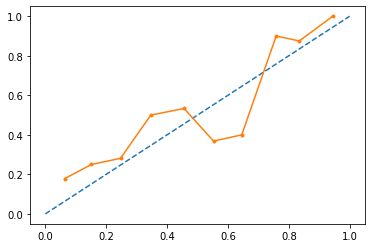

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.002, n_estimator :200 max_features : 4, max_depth : 5 


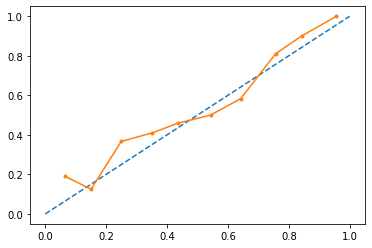

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.72       133
         1.0       0.72      0.65      0.69       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.002, n_estimator :200 max_features : 5, max_depth : 3 


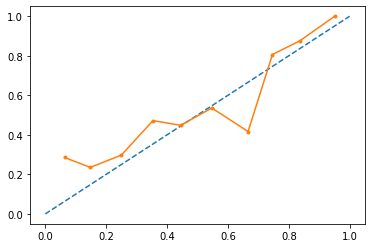

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.72      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.67      0.66      0.66       265
weighted avg       0.67      0.66      0.66       265

learning rate: 0.002, n_estimator :200 max_features : 5, max_depth : 4 


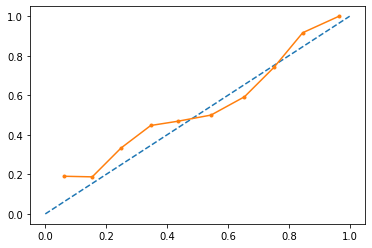

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.002, n_estimator :200 max_features : 5, max_depth : 5 


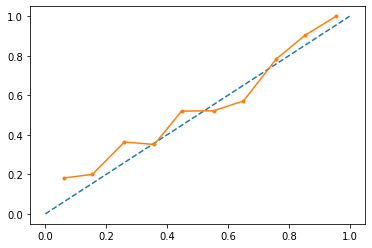

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.77      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.71      0.70      0.70       265
weighted avg       0.71      0.70      0.70       265

learning rate: 0.001, n_estimator :100 max_features : 2, max_depth : 3 


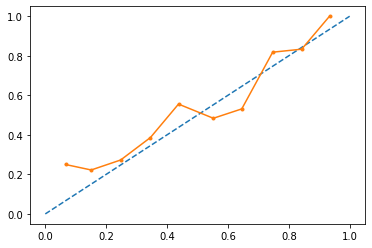

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.70      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :100 max_features : 2, max_depth : 4 


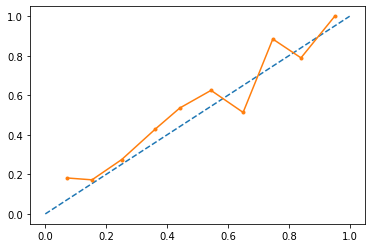

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.001, n_estimator :100 max_features : 2, max_depth : 5 


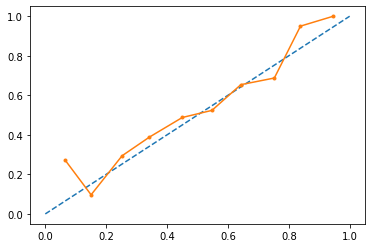

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.77      0.72       133
         1.0       0.73      0.62      0.67       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.001, n_estimator :100 max_features : 3, max_depth : 3 


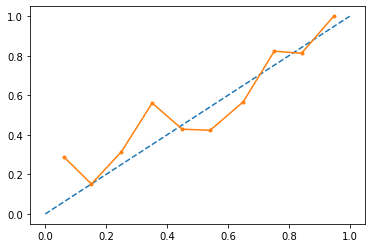

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.63      0.68      0.66       133
         1.0       0.65      0.60      0.62       132

    accuracy                           0.64       265
   macro avg       0.64      0.64      0.64       265
weighted avg       0.64      0.64      0.64       265

learning rate: 0.001, n_estimator :100 max_features : 3, max_depth : 4 


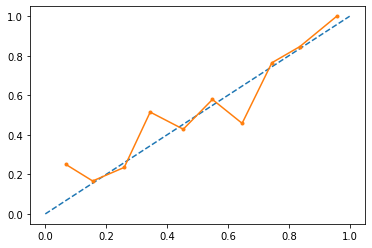

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.69      0.68      0.68       265

learning rate: 0.001, n_estimator :100 max_features : 3, max_depth : 5 


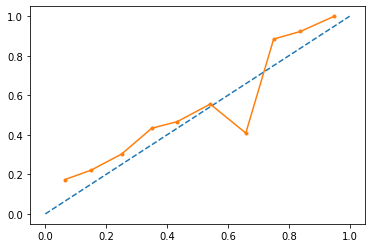

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.001, n_estimator :100 max_features : 4, max_depth : 3 


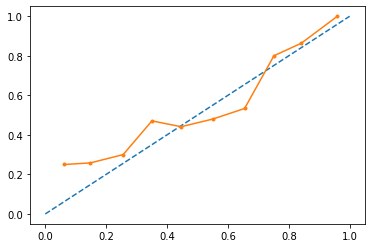

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :100 max_features : 4, max_depth : 4 


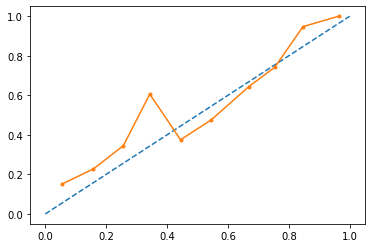

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.73      0.69       133
         1.0       0.69      0.61      0.65       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.001, n_estimator :100 max_features : 4, max_depth : 5 


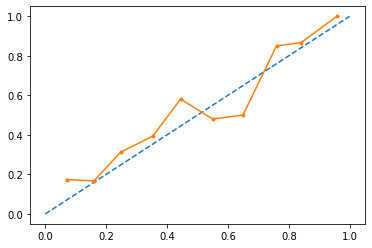

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.72      0.69       133
         1.0       0.69      0.64      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :100 max_features : 5, max_depth : 3 


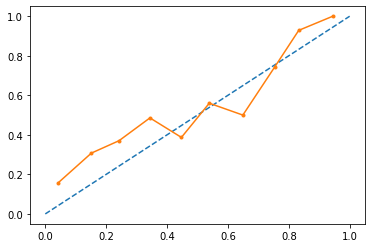

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.66       133
         1.0       0.66      0.61      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.001, n_estimator :100 max_features : 5, max_depth : 4 


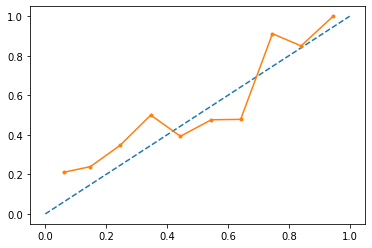

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.75      0.70       133
         1.0       0.70      0.59      0.64       132

    accuracy                           0.67       265
   macro avg       0.68      0.67      0.67       265
weighted avg       0.68      0.67      0.67       265

learning rate: 0.001, n_estimator :100 max_features : 5, max_depth : 5 


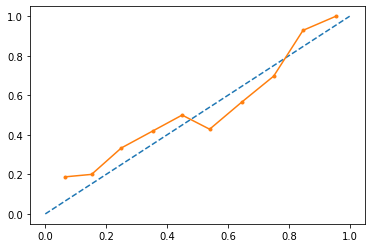

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.71       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.001, n_estimator :120 max_features : 2, max_depth : 3 


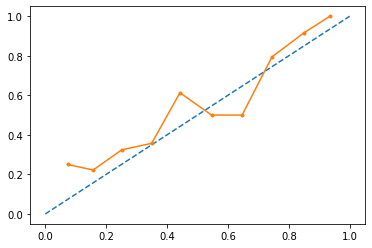

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.69      0.66       133
         1.0       0.66      0.61      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.001, n_estimator :120 max_features : 2, max_depth : 4 


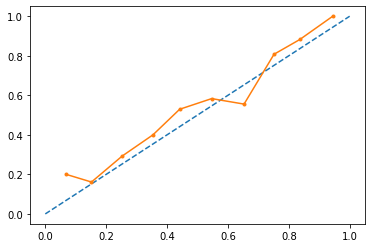

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.001, n_estimator :120 max_features : 2, max_depth : 5 


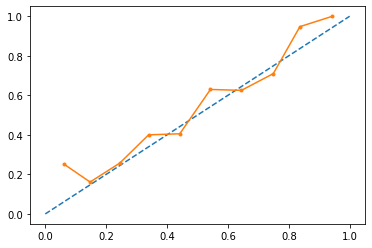

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.78      0.74       133
         1.0       0.75      0.66      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.001, n_estimator :120 max_features : 3, max_depth : 3 


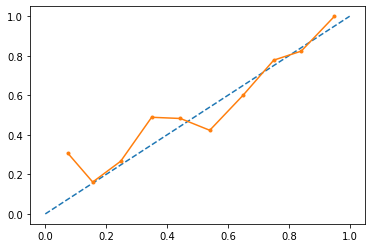

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.68       133
         1.0       0.68      0.60      0.63       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :120 max_features : 3, max_depth : 4 


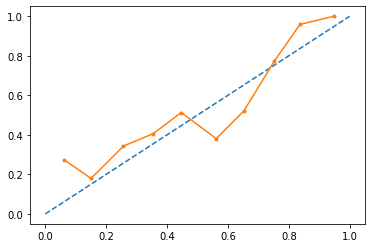

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.69      0.60      0.64       132

    accuracy                           0.67       265
   macro avg       0.67      0.67      0.67       265
weighted avg       0.67      0.67      0.67       265

learning rate: 0.001, n_estimator :120 max_features : 3, max_depth : 5 


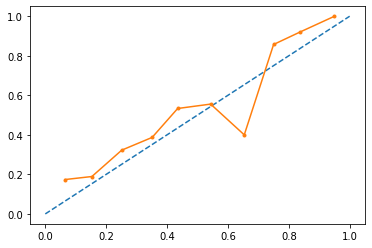

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.001, n_estimator :120 max_features : 4, max_depth : 3 


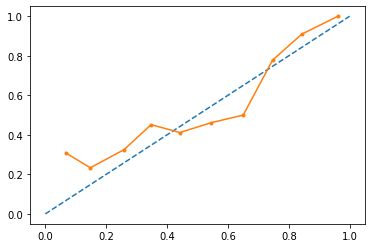

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :120 max_features : 4, max_depth : 4 


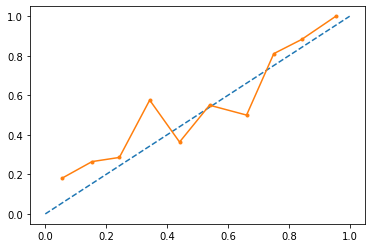

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.72      0.68       133
         1.0       0.68      0.60      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :120 max_features : 4, max_depth : 5 


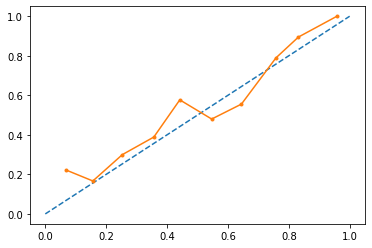

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.72      0.69       133
         1.0       0.69      0.64      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :120 max_features : 5, max_depth : 3 


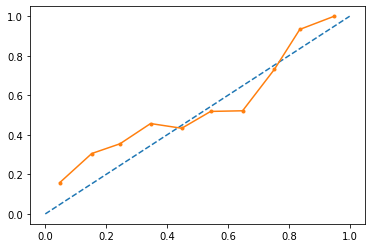

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :120 max_features : 5, max_depth : 4 


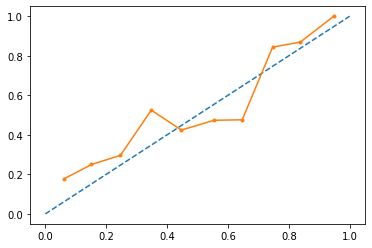

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.76      0.70       133
         1.0       0.71      0.60      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :120 max_features : 5, max_depth : 5 


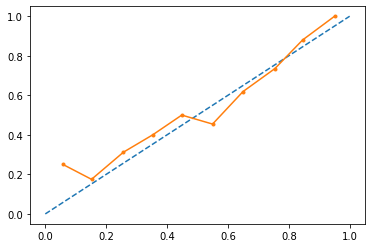

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.72      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.001, n_estimator :150 max_features : 2, max_depth : 3 


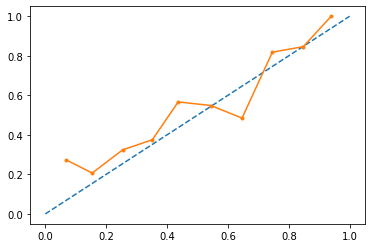

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.68      0.66       133
         1.0       0.66      0.61      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.64       265
weighted avg       0.65      0.65      0.64       265

learning rate: 0.001, n_estimator :150 max_features : 2, max_depth : 4 


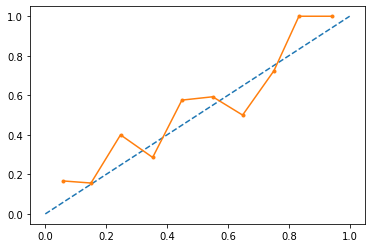

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.73      0.70       133
         1.0       0.70      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.001, n_estimator :150 max_features : 2, max_depth : 5 


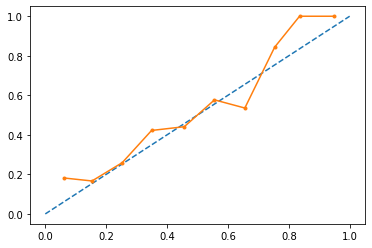

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.75      0.72       133
         1.0       0.73      0.67      0.70       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.71       265
weighted avg       0.71      0.71      0.71       265

learning rate: 0.001, n_estimator :150 max_features : 3, max_depth : 3 


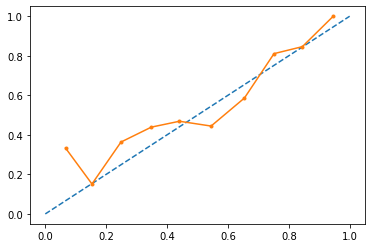

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :150 max_features : 3, max_depth : 4 


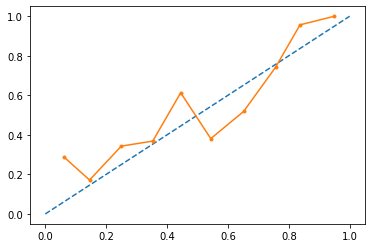

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.73      0.68       133
         1.0       0.68      0.59      0.63       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :150 max_features : 3, max_depth : 5 


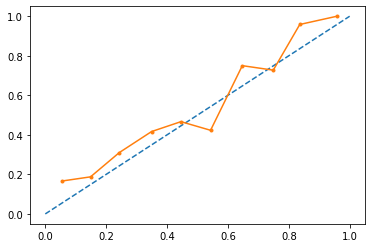

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.74      0.71       133
         1.0       0.71      0.64      0.68       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.001, n_estimator :150 max_features : 4, max_depth : 3 


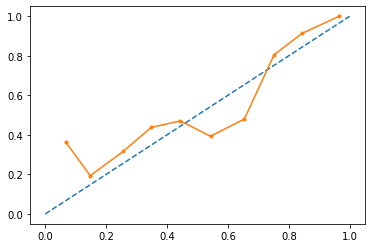

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :150 max_features : 4, max_depth : 4 


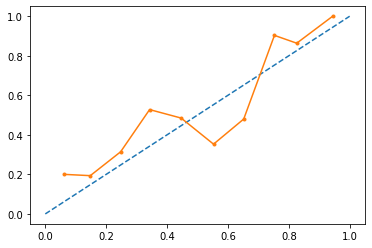

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.001, n_estimator :150 max_features : 4, max_depth : 5 


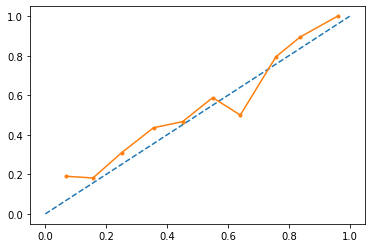

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.73      0.70       133
         1.0       0.70      0.65      0.68       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.001, n_estimator :150 max_features : 5, max_depth : 3 


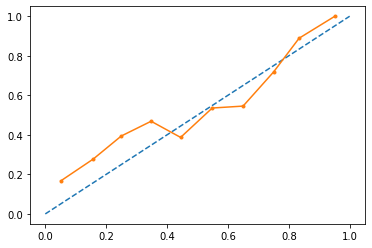

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :150 max_features : 5, max_depth : 4 


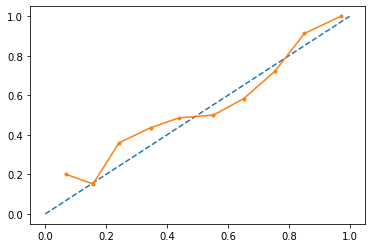

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.001, n_estimator :150 max_features : 5, max_depth : 5 


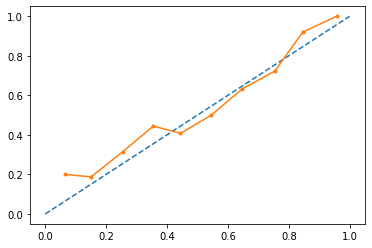

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.76      0.72       133
         1.0       0.73      0.65      0.69       132

    accuracy                           0.71       265
   macro avg       0.71      0.71      0.70       265
weighted avg       0.71      0.71      0.70       265

learning rate: 0.001, n_estimator :180 max_features : 2, max_depth : 3 


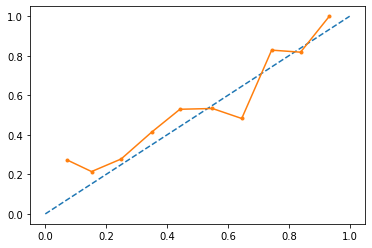

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.68      0.66       133
         1.0       0.66      0.61      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.64       265
weighted avg       0.65      0.65      0.64       265

learning rate: 0.001, n_estimator :180 max_features : 2, max_depth : 4 


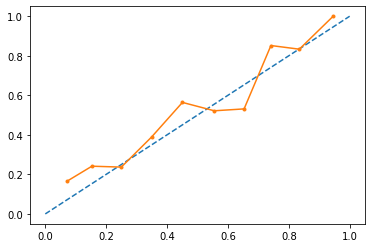

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.73      0.70       133
         1.0       0.70      0.63      0.66       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :180 max_features : 2, max_depth : 5 


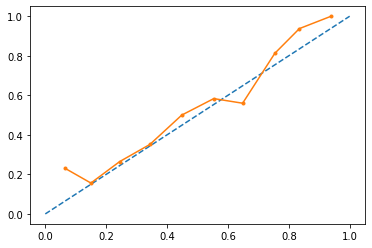

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.69      0.79      0.74       133
         1.0       0.75      0.64      0.69       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.001, n_estimator :180 max_features : 3, max_depth : 3 


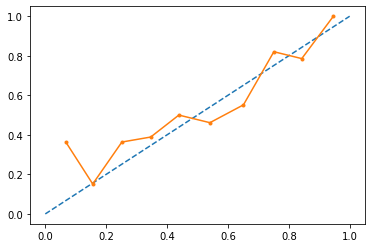

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.60      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.001, n_estimator :180 max_features : 3, max_depth : 4 


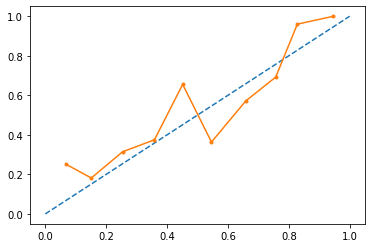

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.73      0.68       133
         1.0       0.68      0.58      0.63       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.65       265
weighted avg       0.66      0.66      0.65       265

learning rate: 0.001, n_estimator :180 max_features : 3, max_depth : 5 


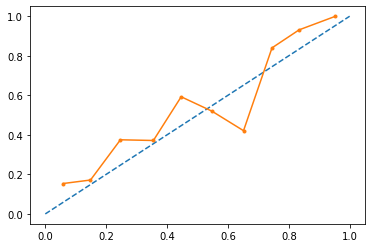

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.001, n_estimator :180 max_features : 4, max_depth : 3 


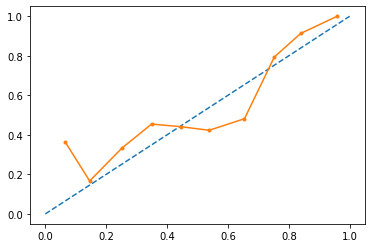

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :180 max_features : 4, max_depth : 4 


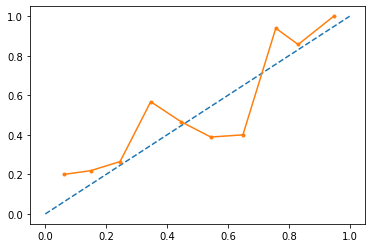

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.74      0.69       133
         1.0       0.70      0.60      0.64       132

    accuracy                           0.67       265
   macro avg       0.68      0.67      0.67       265
weighted avg       0.68      0.67      0.67       265

learning rate: 0.001, n_estimator :180 max_features : 4, max_depth : 5 


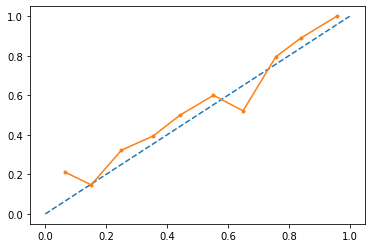

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.71      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.001, n_estimator :180 max_features : 5, max_depth : 3 


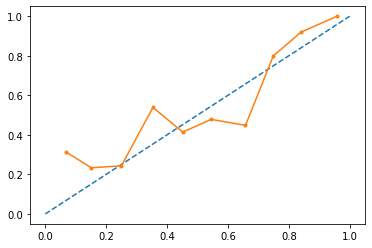

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.71      0.67       133
         1.0       0.67      0.59      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.001, n_estimator :180 max_features : 5, max_depth : 4 


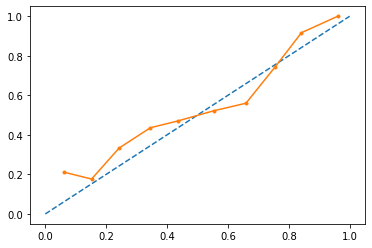

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.001, n_estimator :180 max_features : 5, max_depth : 5 


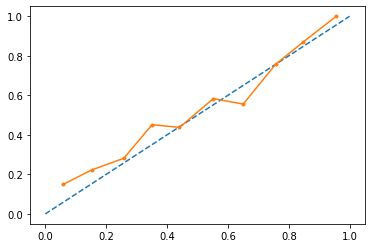

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.76      0.72       133
         1.0       0.73      0.64      0.68       132

    accuracy                           0.70       265
   macro avg       0.70      0.70      0.70       265
weighted avg       0.70      0.70      0.70       265

learning rate: 0.001, n_estimator :200 max_features : 2, max_depth : 3 


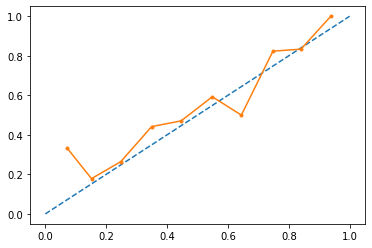

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.63      0.68      0.65       133
         1.0       0.65      0.61      0.63       132

    accuracy                           0.64       265
   macro avg       0.64      0.64      0.64       265
weighted avg       0.64      0.64      0.64       265

learning rate: 0.001, n_estimator :200 max_features : 2, max_depth : 4 


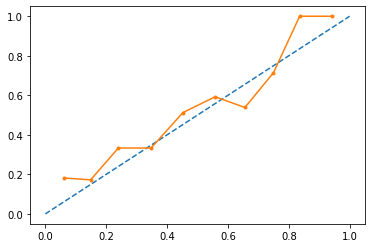

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.74      0.70       133
         1.0       0.70      0.63      0.66       132

    accuracy                           0.68       265
   macro avg       0.69      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :200 max_features : 2, max_depth : 5 


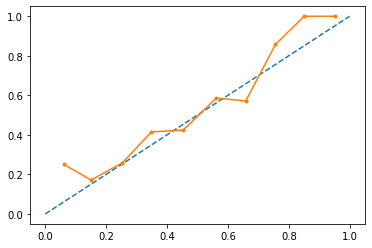

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.77      0.73       133
         1.0       0.74      0.67      0.70       132

    accuracy                           0.72       265
   macro avg       0.72      0.72      0.72       265
weighted avg       0.72      0.72      0.72       265

learning rate: 0.001, n_estimator :200 max_features : 3, max_depth : 3 


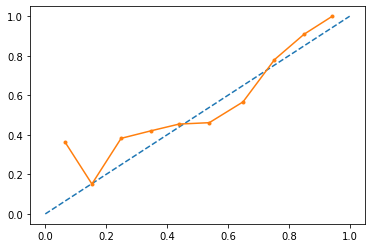

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.64      0.70      0.67       133
         1.0       0.66      0.60      0.63       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.001, n_estimator :200 max_features : 3, max_depth : 4 


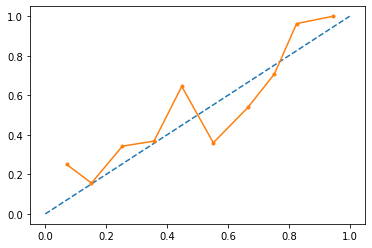

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.63      0.71      0.67       133
         1.0       0.67      0.58      0.62       132

    accuracy                           0.65       265
   macro avg       0.65      0.65      0.65       265
weighted avg       0.65      0.65      0.65       265

learning rate: 0.001, n_estimator :200 max_features : 3, max_depth : 5 


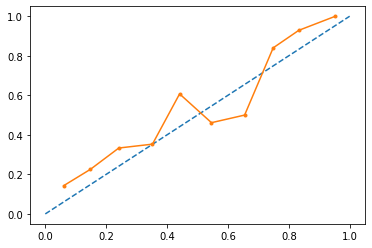

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.75      0.71       133
         1.0       0.72      0.63      0.67       132

    accuracy                           0.69       265
   macro avg       0.69      0.69      0.69       265
weighted avg       0.69      0.69      0.69       265

learning rate: 0.001, n_estimator :200 max_features : 4, max_depth : 3 


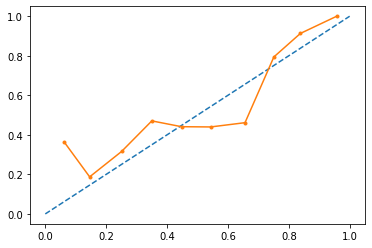

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :200 max_features : 4, max_depth : 4 


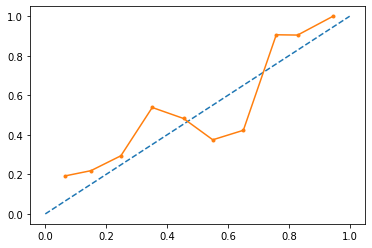

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.75      0.70       133
         1.0       0.71      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :200 max_features : 4, max_depth : 5 


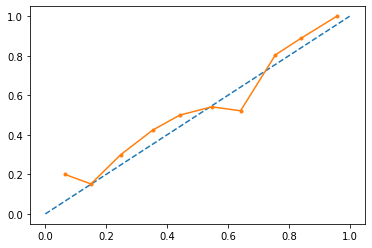

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.67      0.73      0.70       133
         1.0       0.70      0.64      0.67       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.68       265
weighted avg       0.68      0.68      0.68       265

learning rate: 0.001, n_estimator :200 max_features : 5, max_depth : 3 


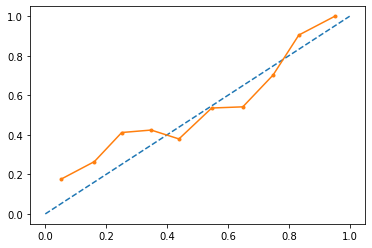

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.65      0.71      0.68       133
         1.0       0.68      0.61      0.64       132

    accuracy                           0.66       265
   macro avg       0.66      0.66      0.66       265
weighted avg       0.66      0.66      0.66       265

learning rate: 0.001, n_estimator :200 max_features : 5, max_depth : 4 


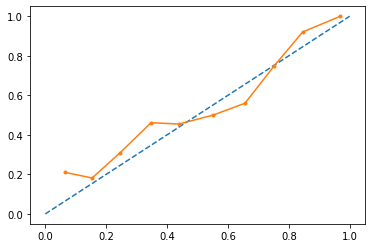

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.66      0.74      0.70       133
         1.0       0.70      0.61      0.65       132

    accuracy                           0.68       265
   macro avg       0.68      0.68      0.67       265
weighted avg       0.68      0.68      0.67       265

learning rate: 0.001, n_estimator :200 max_features : 5, max_depth : 5 


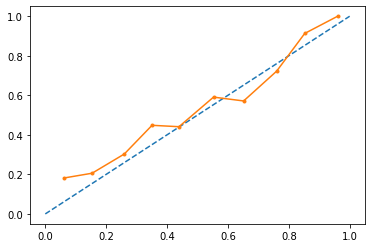

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.75      0.71       133
         1.0       0.72      0.64      0.67       132

    accuracy                           0.69       265
   macro avg       0.70      0.69      0.69       265
weighted avg       0.70      0.69      0.69       265

learning rate: 0.1, n_estimator :100 max_features : 2, max_depth : 3 


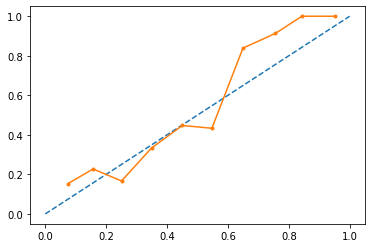

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.80      0.75       133
         1.0       0.77      0.67      0.71       132

    accuracy                           0.73       265
   macro avg       0.74      0.73      0.73       265
weighted avg       0.74      0.73      0.73       265

learning rate: 0.1, n_estimator :100 max_features : 2, max_depth : 4 


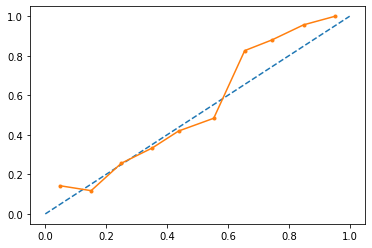

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       133
         1.0       0.79      0.69      0.74       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.1, n_estimator :100 max_features : 2, max_depth : 5 


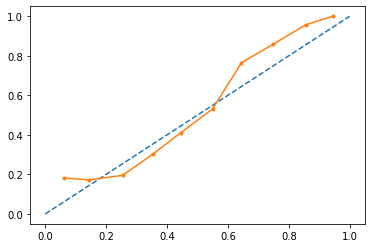

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.82      0.78       133
         1.0       0.79      0.70      0.75       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :100 max_features : 3, max_depth : 3 


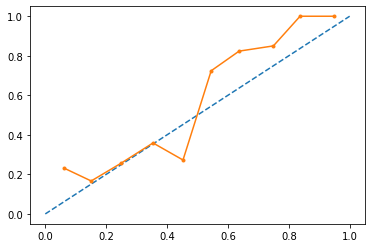

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.79       133
         1.0       0.82      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :100 max_features : 3, max_depth : 4 


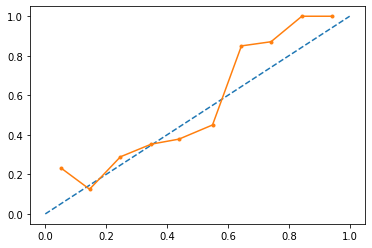

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.85      0.77       133
         1.0       0.81      0.65      0.72       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.1, n_estimator :100 max_features : 3, max_depth : 5 


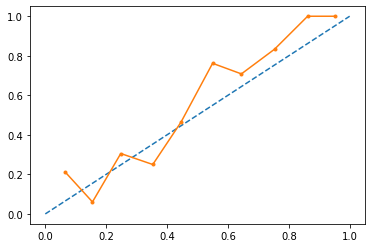

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :100 max_features : 4, max_depth : 3 


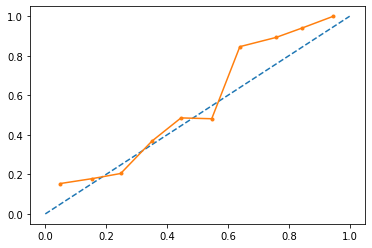

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.80      0.66      0.72       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.1, n_estimator :100 max_features : 4, max_depth : 4 


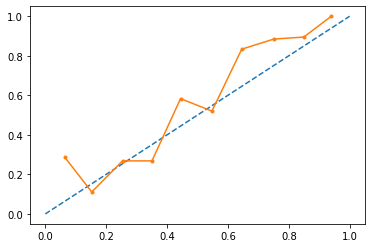

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.1, n_estimator :100 max_features : 4, max_depth : 5 


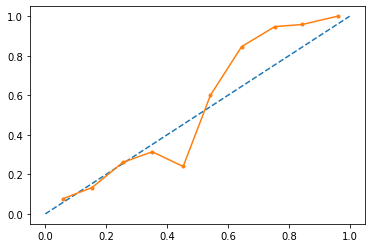

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.86      0.81       133
         1.0       0.84      0.73      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.80      0.80      0.80       265

learning rate: 0.1, n_estimator :100 max_features : 5, max_depth : 3 


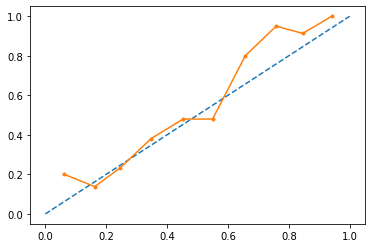

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.1, n_estimator :100 max_features : 5, max_depth : 4 


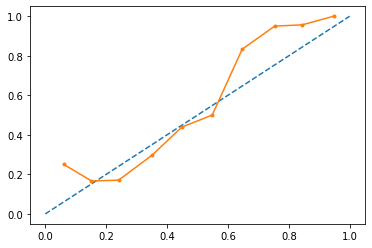

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.79       133
         1.0       0.83      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.78      0.77      0.76       265

learning rate: 0.1, n_estimator :100 max_features : 5, max_depth : 5 


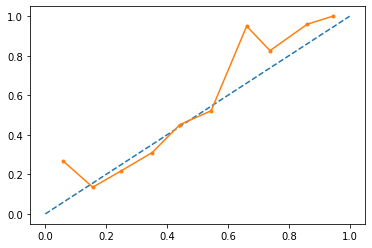

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.1, n_estimator :120 max_features : 2, max_depth : 3 


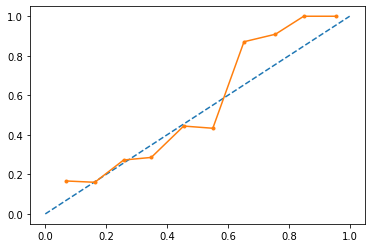

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.79      0.67      0.72       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.1, n_estimator :120 max_features : 2, max_depth : 4 


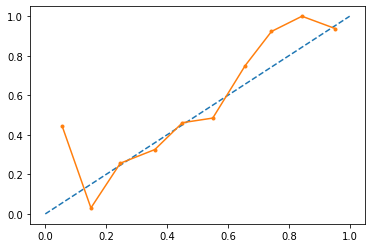

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.77       133
         1.0       0.79      0.68      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.1, n_estimator :120 max_features : 2, max_depth : 5 


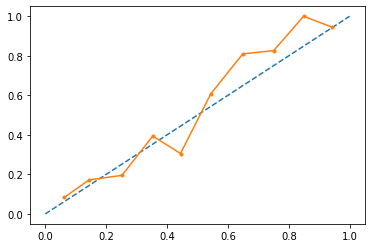

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.82      0.71      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :120 max_features : 3, max_depth : 3 


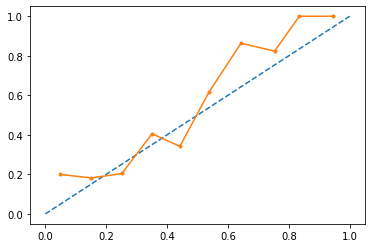

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :120 max_features : 3, max_depth : 4 


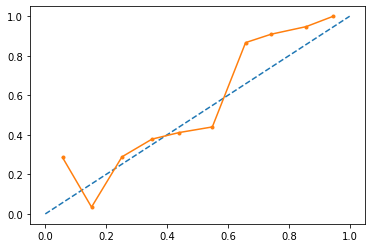

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.85      0.77       133
         1.0       0.81      0.65      0.72       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.1, n_estimator :120 max_features : 3, max_depth : 5 


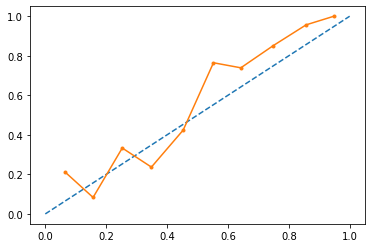

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.89      0.81       133
         1.0       0.86      0.69      0.76       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.1, n_estimator :120 max_features : 4, max_depth : 3 


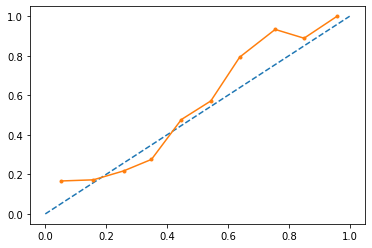

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.82      0.76       133
         1.0       0.78      0.66      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.1, n_estimator :120 max_features : 4, max_depth : 4 


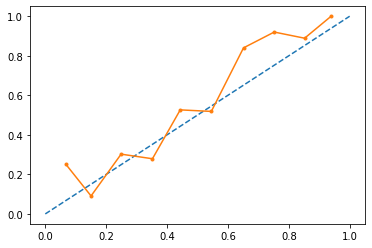

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.84      0.79       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :120 max_features : 4, max_depth : 5 


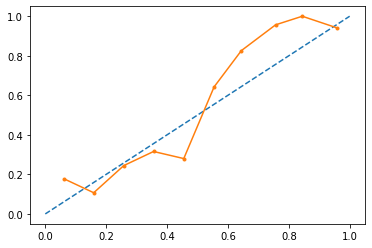

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.88      0.82       133
         1.0       0.86      0.73      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.1, n_estimator :120 max_features : 5, max_depth : 3 


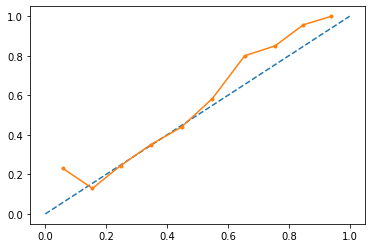

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :120 max_features : 5, max_depth : 4 


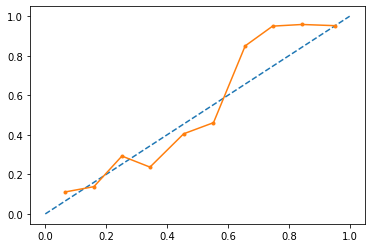

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.79       133
         1.0       0.82      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :120 max_features : 5, max_depth : 5 


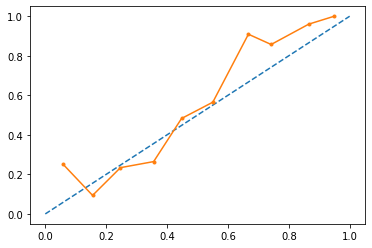

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.87      0.81       133
         1.0       0.85      0.71      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.1, n_estimator :150 max_features : 2, max_depth : 3 


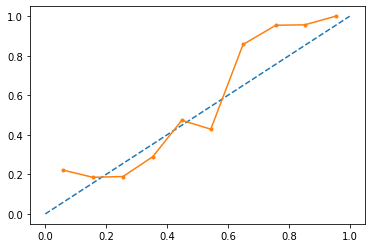

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.82      0.76       133
         1.0       0.79      0.67      0.72       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.1, n_estimator :150 max_features : 2, max_depth : 4 


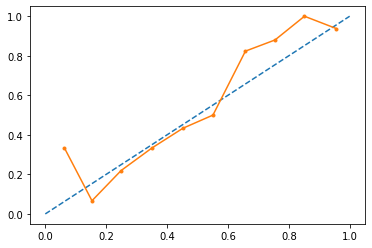

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.1, n_estimator :150 max_features : 2, max_depth : 5 


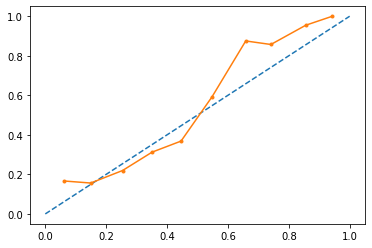

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :150 max_features : 3, max_depth : 3 


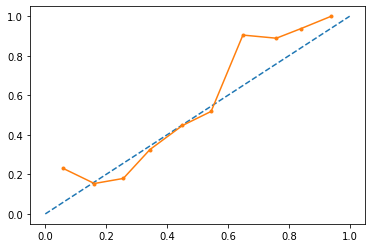

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :150 max_features : 3, max_depth : 4 


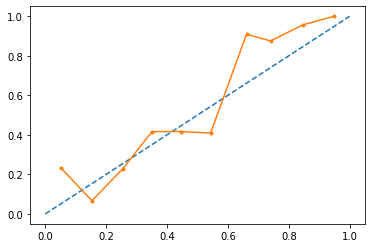

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :150 max_features : 3, max_depth : 5 


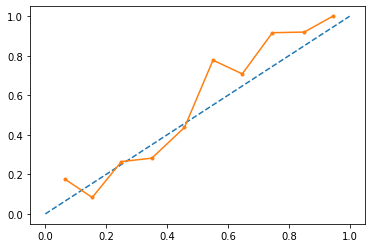

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.1, n_estimator :150 max_features : 4, max_depth : 3 


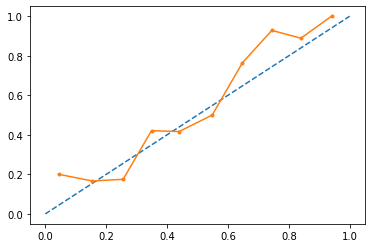

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.86      0.78       133
         1.0       0.82      0.65      0.73       132

    accuracy                           0.75       265
   macro avg       0.77      0.75      0.75       265
weighted avg       0.77      0.75      0.75       265

learning rate: 0.1, n_estimator :150 max_features : 4, max_depth : 4 


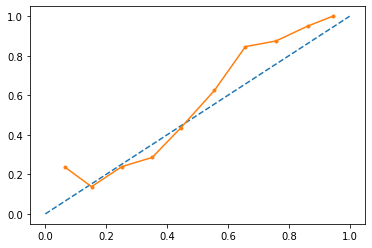

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :150 max_features : 4, max_depth : 5 


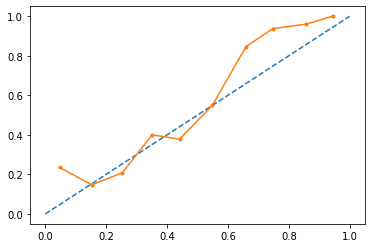

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.88      0.80       133
         1.0       0.85      0.67      0.75       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.77       265
weighted avg       0.79      0.78      0.77       265

learning rate: 0.1, n_estimator :150 max_features : 5, max_depth : 3 


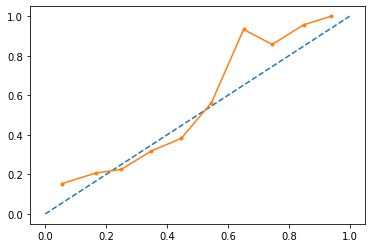

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :150 max_features : 5, max_depth : 4 


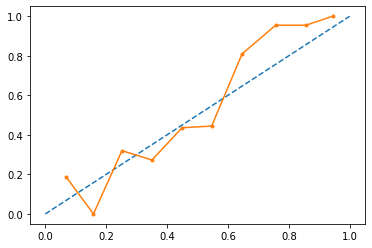

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.89      0.80       133
         1.0       0.85      0.66      0.74       132

    accuracy                           0.77       265
   macro avg       0.79      0.77      0.77       265
weighted avg       0.79      0.77      0.77       265

learning rate: 0.1, n_estimator :150 max_features : 5, max_depth : 5 


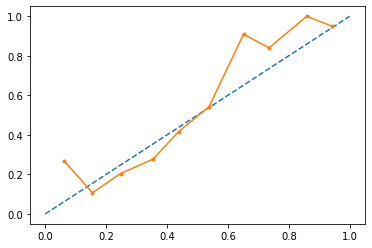

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.81       133
         1.0       0.84      0.72      0.78       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.1, n_estimator :180 max_features : 2, max_depth : 3 


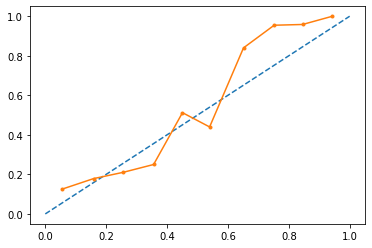

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.84      0.77       133
         1.0       0.80      0.65      0.72       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.74       265
weighted avg       0.76      0.75      0.74       265

learning rate: 0.1, n_estimator :180 max_features : 2, max_depth : 4 


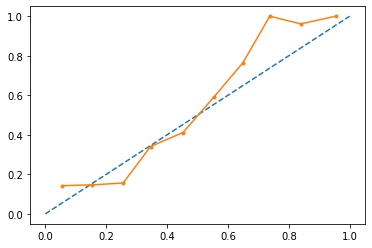

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :180 max_features : 2, max_depth : 5 


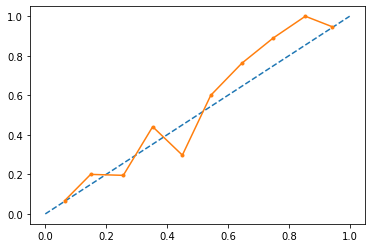

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :180 max_features : 3, max_depth : 3 


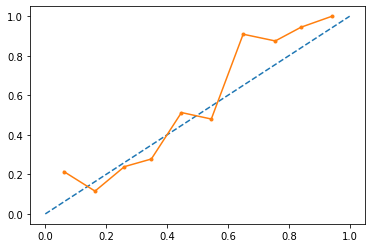

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :180 max_features : 3, max_depth : 4 


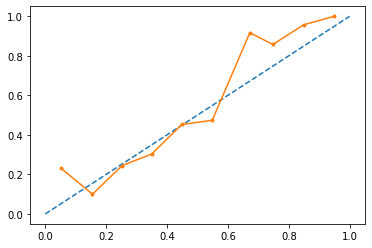

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.83      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :180 max_features : 3, max_depth : 5 


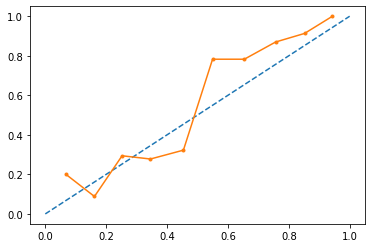

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.86      0.72      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.1, n_estimator :180 max_features : 4, max_depth : 3 


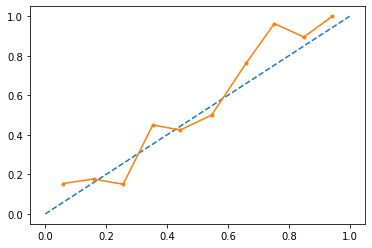

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.86      0.78       133
         1.0       0.82      0.65      0.73       132

    accuracy                           0.75       265
   macro avg       0.77      0.75      0.75       265
weighted avg       0.77      0.75      0.75       265

learning rate: 0.1, n_estimator :180 max_features : 4, max_depth : 4 


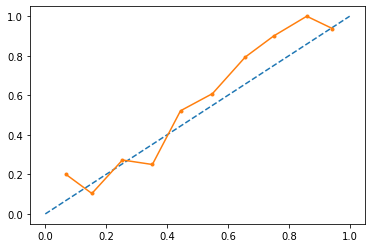

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :180 max_features : 4, max_depth : 5 


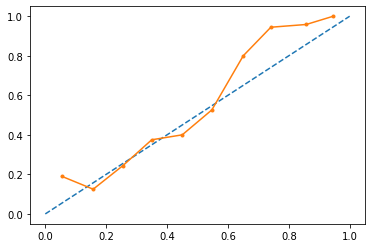

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.88      0.80       133
         1.0       0.85      0.68      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :180 max_features : 5, max_depth : 3 


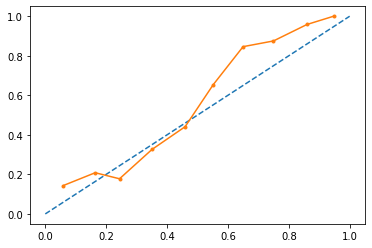

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.88      0.80       133
         1.0       0.85      0.68      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :180 max_features : 5, max_depth : 4 


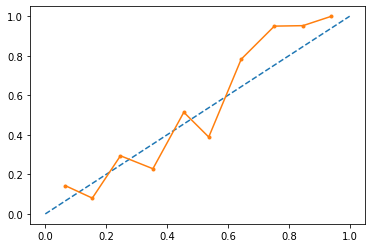

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.83      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.1, n_estimator :180 max_features : 5, max_depth : 5 


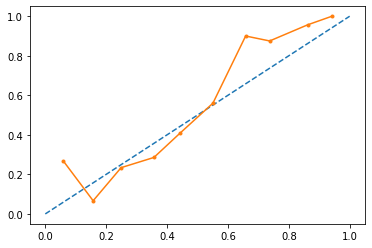

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.87      0.81       133
         1.0       0.85      0.71      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.1, n_estimator :200 max_features : 2, max_depth : 3 


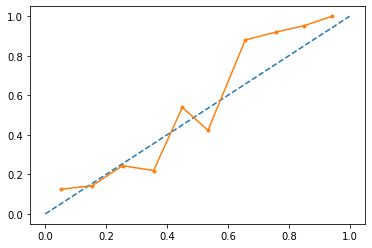

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.80      0.66      0.72       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.1, n_estimator :200 max_features : 2, max_depth : 4 


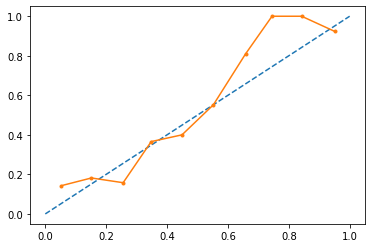

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :200 max_features : 2, max_depth : 5 


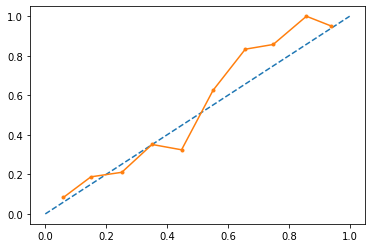

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :200 max_features : 3, max_depth : 3 


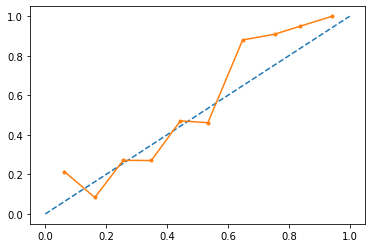

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.1, n_estimator :200 max_features : 3, max_depth : 4 


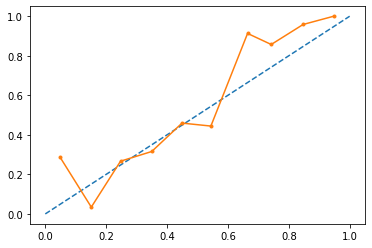

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.87      0.79       133
         1.0       0.83      0.65      0.73       132

    accuracy                           0.76       265
   macro avg       0.78      0.76      0.76       265
weighted avg       0.78      0.76      0.76       265

learning rate: 0.1, n_estimator :200 max_features : 3, max_depth : 5 


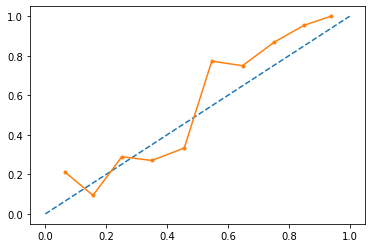

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.86      0.72      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.1, n_estimator :200 max_features : 4, max_depth : 3 


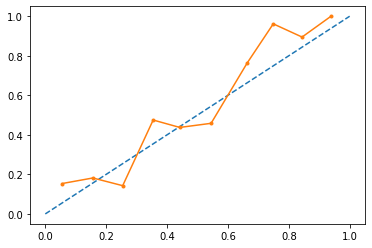

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.85      0.77       133
         1.0       0.81      0.64      0.72       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.74       265
weighted avg       0.76      0.75      0.74       265

learning rate: 0.1, n_estimator :200 max_features : 4, max_depth : 4 


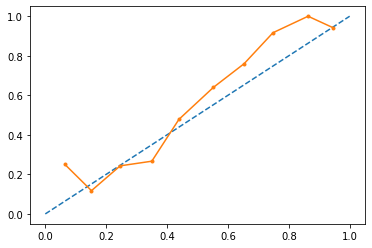

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :200 max_features : 4, max_depth : 5 


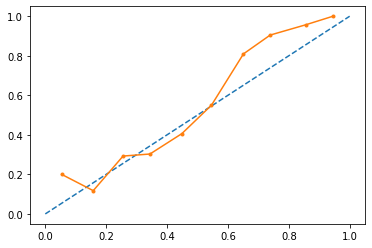

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.88      0.80       133
         1.0       0.85      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.80      0.78      0.78       265
weighted avg       0.80      0.78      0.78       265

learning rate: 0.1, n_estimator :200 max_features : 5, max_depth : 3 


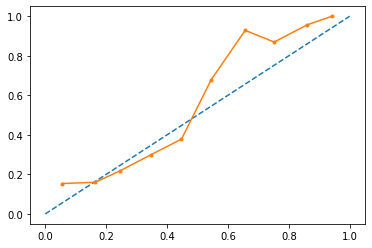

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.1, n_estimator :200 max_features : 5, max_depth : 4 


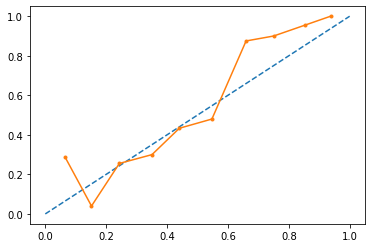

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.1, n_estimator :200 max_features : 5, max_depth : 5 


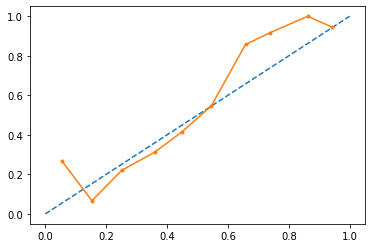

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.87      0.81       133
         1.0       0.85      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 0.2, n_estimator :100 max_features : 2, max_depth : 3 


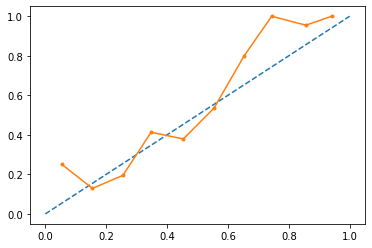

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.2, n_estimator :100 max_features : 2, max_depth : 4 


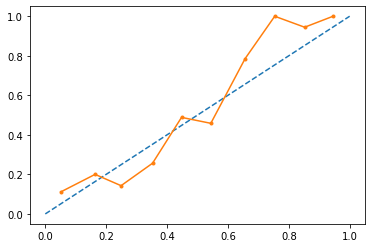

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :100 max_features : 2, max_depth : 5 


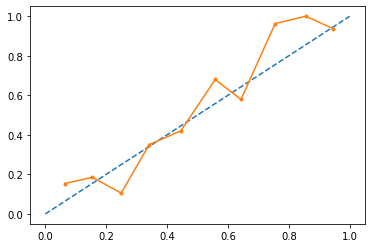

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :100 max_features : 3, max_depth : 3 


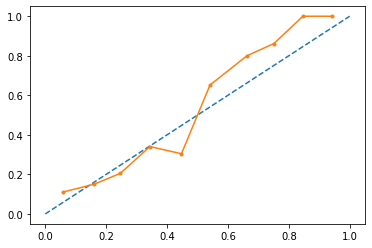

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.89      0.80       133
         1.0       0.85      0.67      0.75       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.77       265
weighted avg       0.79      0.78      0.77       265

learning rate: 0.2, n_estimator :100 max_features : 3, max_depth : 4 


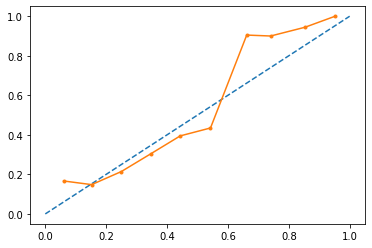

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :100 max_features : 3, max_depth : 5 


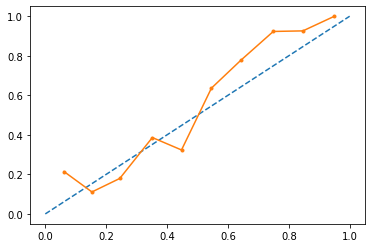

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :100 max_features : 4, max_depth : 3 


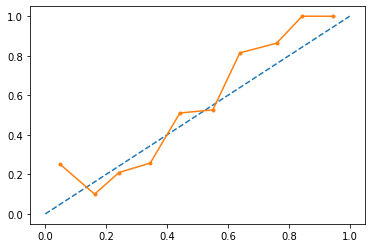

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :100 max_features : 4, max_depth : 4 


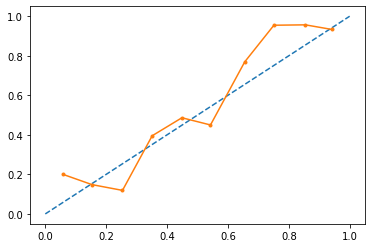

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.84      0.77       133
         1.0       0.80      0.65      0.72       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.74       265
weighted avg       0.76      0.75      0.74       265

learning rate: 0.2, n_estimator :100 max_features : 4, max_depth : 5 


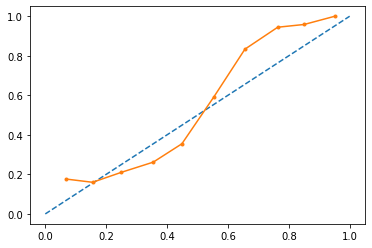

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.87      0.81       133
         1.0       0.85      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 0.2, n_estimator :100 max_features : 5, max_depth : 3 


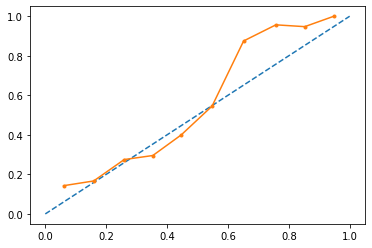

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.87      0.79       133
         1.0       0.84      0.66      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.78      0.77      0.76       265

learning rate: 0.2, n_estimator :100 max_features : 5, max_depth : 4 


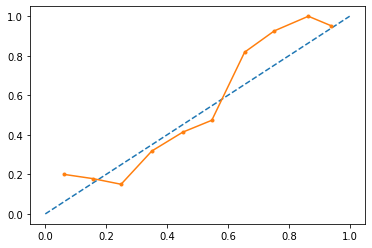

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :100 max_features : 5, max_depth : 5 


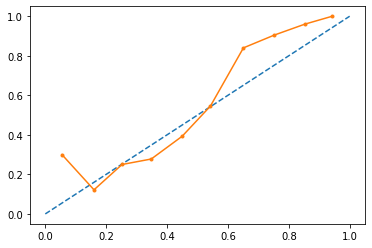

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.84      0.70      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :120 max_features : 2, max_depth : 3 


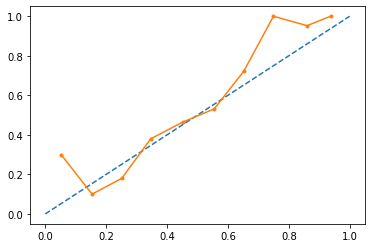

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.2, n_estimator :120 max_features : 2, max_depth : 4 


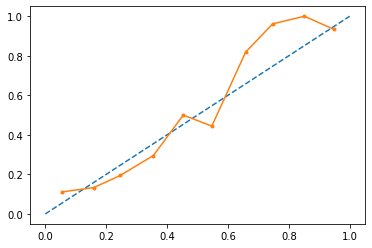

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :120 max_features : 2, max_depth : 5 


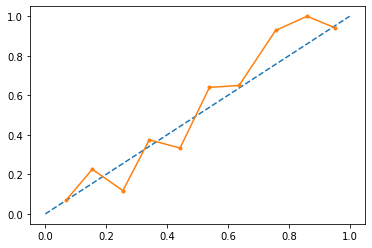

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.87      0.80       133
         1.0       0.84      0.68      0.75       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :120 max_features : 3, max_depth : 3 


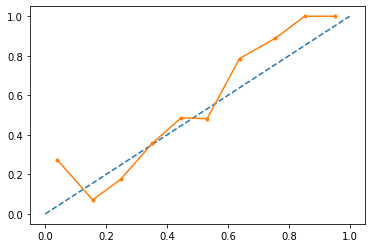

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.2, n_estimator :120 max_features : 3, max_depth : 4 


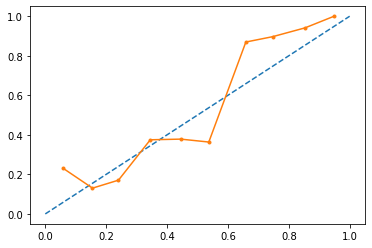

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.2, n_estimator :120 max_features : 3, max_depth : 5 


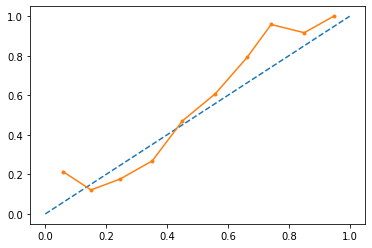

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :120 max_features : 4, max_depth : 3 


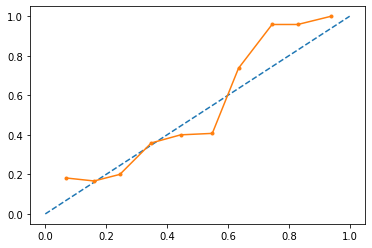

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.2, n_estimator :120 max_features : 4, max_depth : 4 


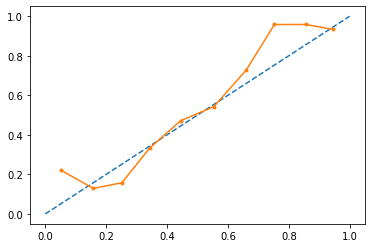

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :120 max_features : 4, max_depth : 5 


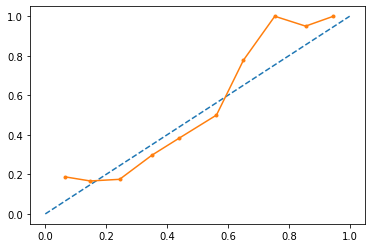

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.82      0.71      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :120 max_features : 5, max_depth : 3 


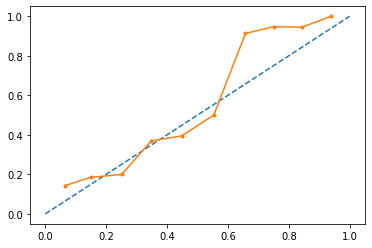

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.88      0.79       133
         1.0       0.84      0.65      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.78      0.77      0.76       265

learning rate: 0.2, n_estimator :120 max_features : 5, max_depth : 4 


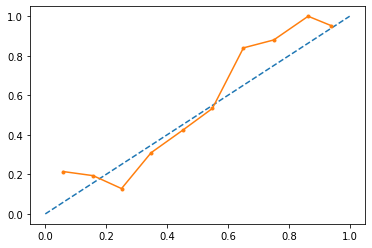

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.89      0.81       133
         1.0       0.86      0.69      0.76       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.2, n_estimator :120 max_features : 5, max_depth : 5 


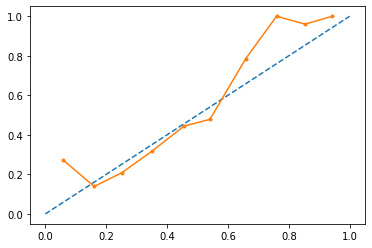

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :150 max_features : 2, max_depth : 3 


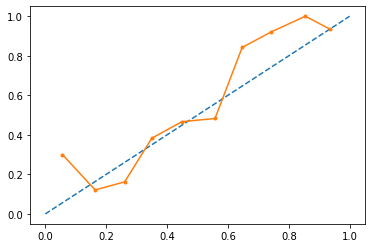

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :150 max_features : 2, max_depth : 4 


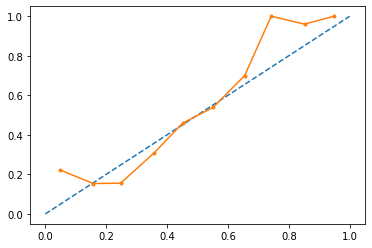

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :150 max_features : 2, max_depth : 5 


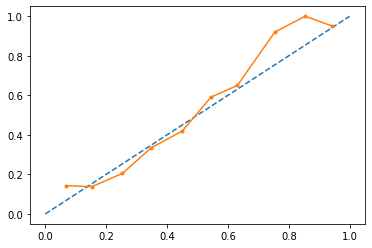

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :150 max_features : 3, max_depth : 3 


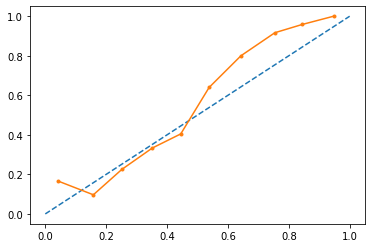

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.89      0.80       133
         1.0       0.86      0.67      0.75       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :150 max_features : 3, max_depth : 4 


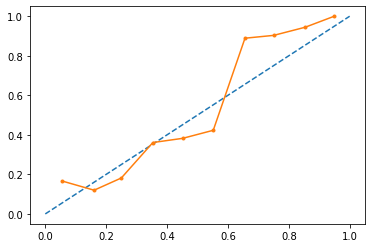

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :150 max_features : 3, max_depth : 5 


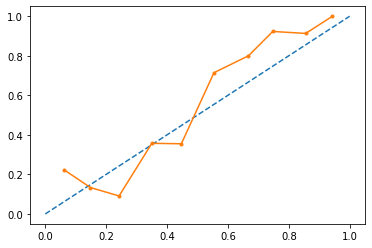

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.88      0.82       133
         1.0       0.86      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.2, n_estimator :150 max_features : 4, max_depth : 3 


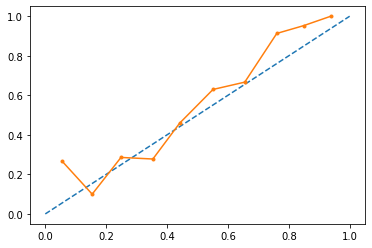

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :150 max_features : 4, max_depth : 4 


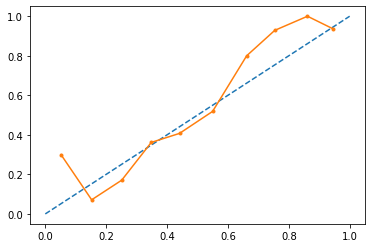

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.2, n_estimator :150 max_features : 4, max_depth : 5 


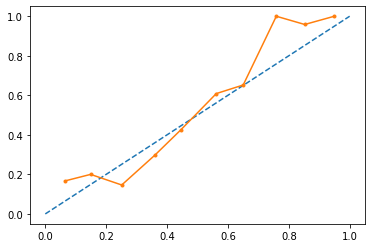

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :150 max_features : 5, max_depth : 3 


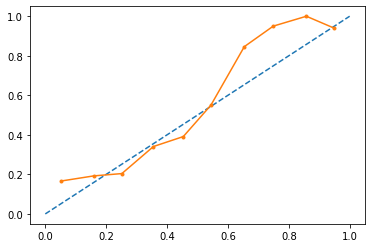

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :150 max_features : 5, max_depth : 4 


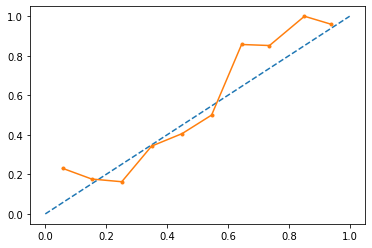

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :150 max_features : 5, max_depth : 5 


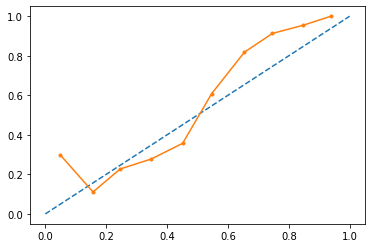

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.88      0.82       133
         1.0       0.86      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.2, n_estimator :180 max_features : 2, max_depth : 3 


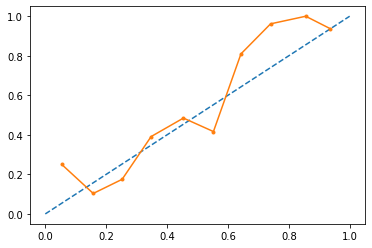

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.77       133
         1.0       0.80      0.66      0.72       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 0.2, n_estimator :180 max_features : 2, max_depth : 4 


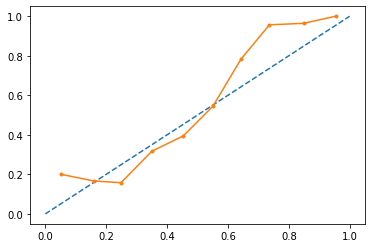

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.87      0.80       133
         1.0       0.84      0.68      0.75       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :180 max_features : 2, max_depth : 5 


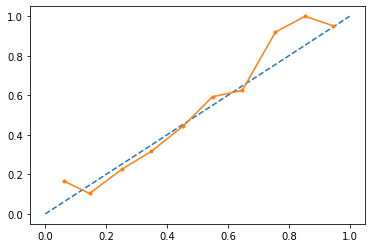

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :180 max_features : 3, max_depth : 3 


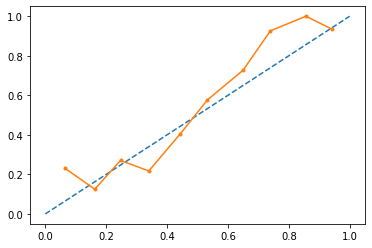

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :180 max_features : 3, max_depth : 4 


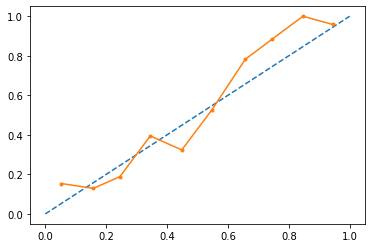

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :180 max_features : 3, max_depth : 5 


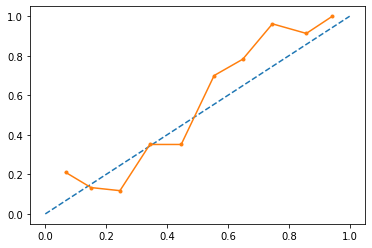

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.87      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.2, n_estimator :180 max_features : 4, max_depth : 3 


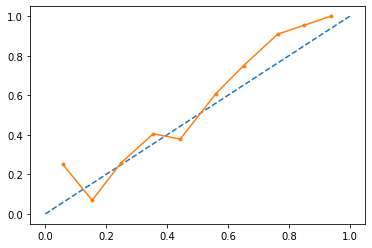

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.86      0.78       133
         1.0       0.82      0.65      0.73       132

    accuracy                           0.75       265
   macro avg       0.77      0.75      0.75       265
weighted avg       0.77      0.75      0.75       265

learning rate: 0.2, n_estimator :180 max_features : 4, max_depth : 4 


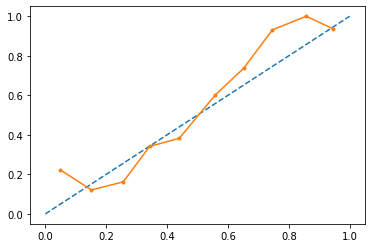

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.84      0.70      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :180 max_features : 4, max_depth : 5 


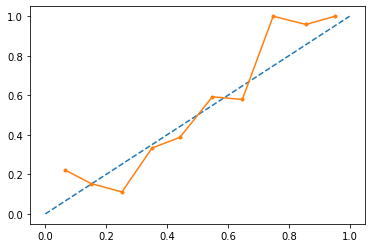

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.71      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :180 max_features : 5, max_depth : 3 


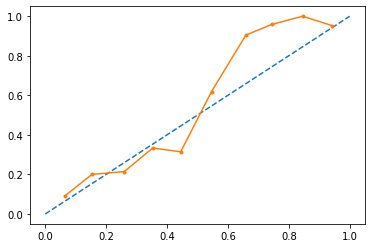

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.91      0.82       133
         1.0       0.88      0.69      0.77       132

    accuracy                           0.80       265
   macro avg       0.82      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.2, n_estimator :180 max_features : 5, max_depth : 4 


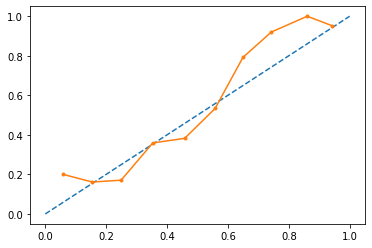

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.89      0.81       133
         1.0       0.86      0.68      0.76       132

    accuracy                           0.78       265
   macro avg       0.80      0.78      0.78       265
weighted avg       0.80      0.78      0.78       265

learning rate: 0.2, n_estimator :180 max_features : 5, max_depth : 5 


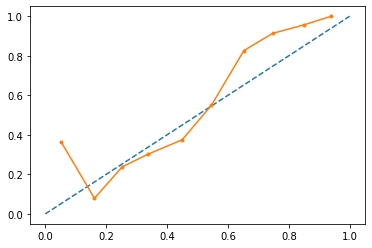

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.2, n_estimator :200 max_features : 2, max_depth : 3 


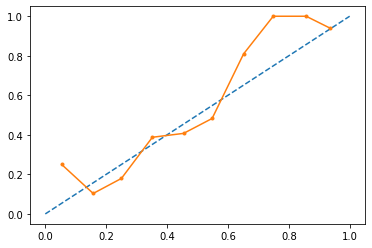

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.84      0.79       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :200 max_features : 2, max_depth : 4 


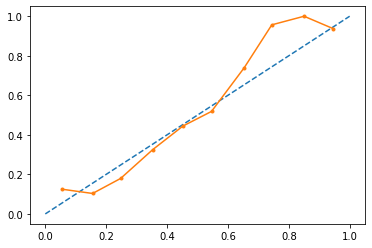

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.88      0.80       133
         1.0       0.85      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.80      0.78      0.78       265
weighted avg       0.80      0.78      0.78       265

learning rate: 0.2, n_estimator :200 max_features : 2, max_depth : 5 


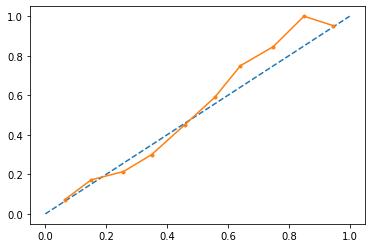

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :200 max_features : 3, max_depth : 3 


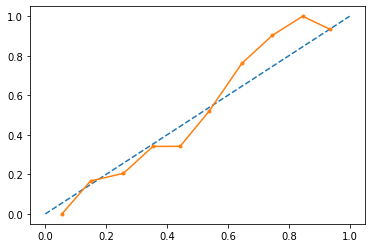

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.79       133
         1.0       0.82      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.2, n_estimator :200 max_features : 3, max_depth : 4 


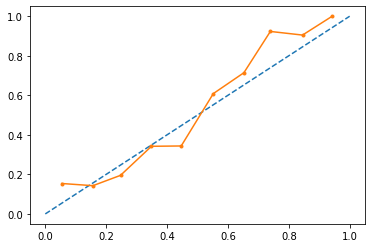

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.2, n_estimator :200 max_features : 3, max_depth : 5 


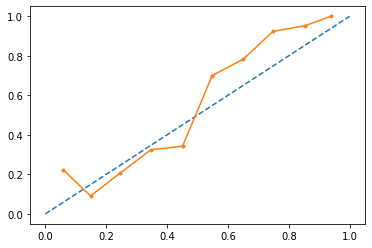

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.87      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.2, n_estimator :200 max_features : 4, max_depth : 3 


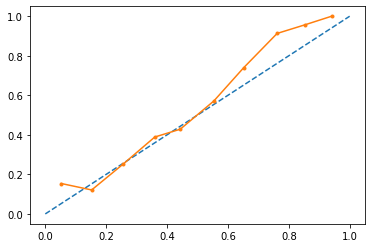

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.86      0.78       133
         1.0       0.83      0.65      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :200 max_features : 4, max_depth : 4 


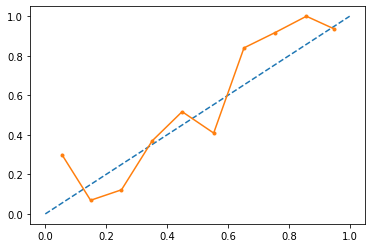

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.2, n_estimator :200 max_features : 4, max_depth : 5 


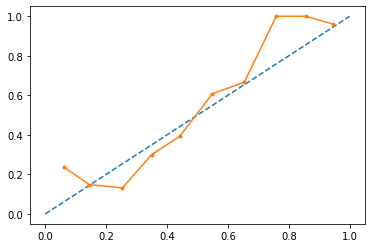

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.72      0.77       132

    accuracy                           0.79       265
   macro avg       0.79      0.79      0.79       265
weighted avg       0.79      0.79      0.79       265

learning rate: 0.2, n_estimator :200 max_features : 5, max_depth : 3 


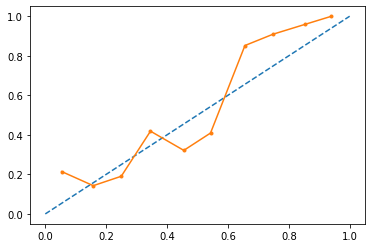

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.2, n_estimator :200 max_features : 5, max_depth : 4 


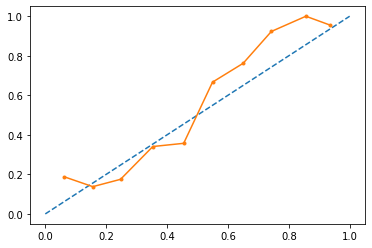

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.90      0.82       133
         1.0       0.88      0.70      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.2, n_estimator :200 max_features : 5, max_depth : 5 


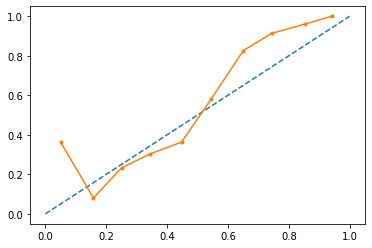

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.81       133
         1.0       0.86      0.70      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.79       265
weighted avg       0.81      0.80      0.79       265

learning rate: 0.3, n_estimator :100 max_features : 2, max_depth : 3 


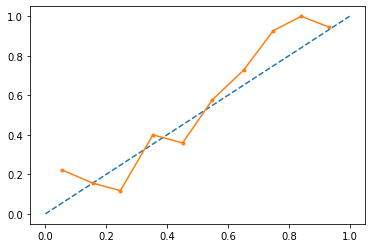

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :100 max_features : 2, max_depth : 4 


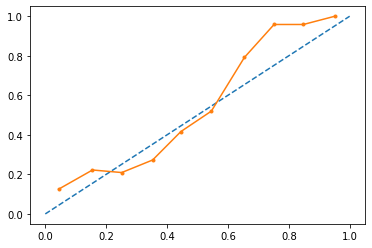

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :100 max_features : 2, max_depth : 5 


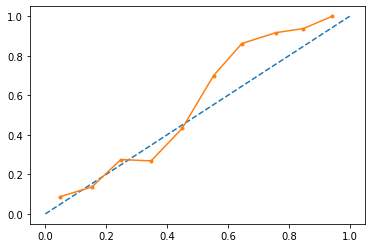

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :100 max_features : 3, max_depth : 3 


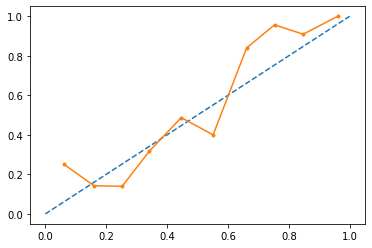

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.81      0.67      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.3, n_estimator :100 max_features : 3, max_depth : 4 


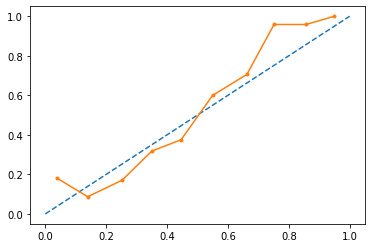

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.71      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :100 max_features : 3, max_depth : 5 


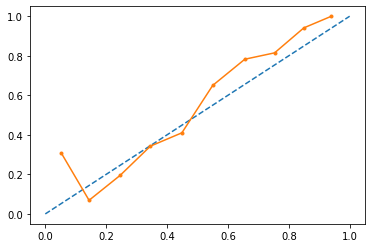

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.87      0.79       133
         1.0       0.84      0.67      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :100 max_features : 4, max_depth : 3 


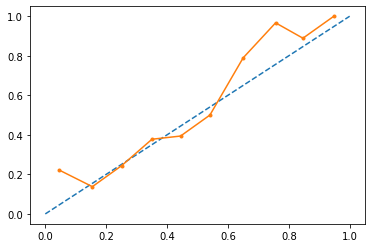

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.76       133
         1.0       0.79      0.65      0.71       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.3, n_estimator :100 max_features : 4, max_depth : 4 


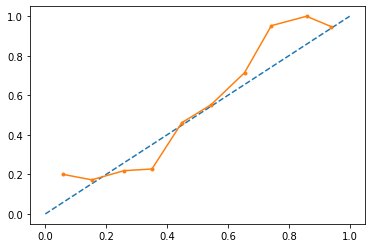

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :100 max_features : 4, max_depth : 5 


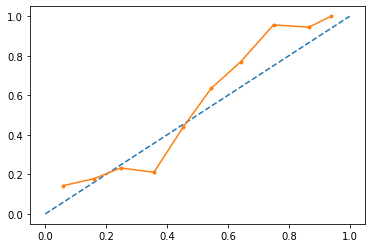

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :100 max_features : 5, max_depth : 3 


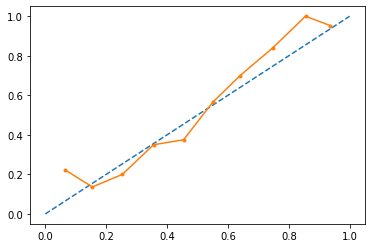

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :100 max_features : 5, max_depth : 4 


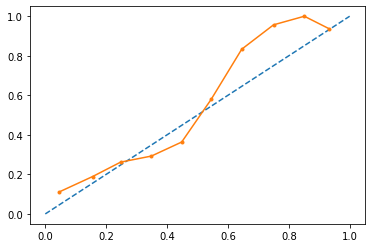

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.89      0.81       133
         1.0       0.86      0.68      0.76       132

    accuracy                           0.78       265
   macro avg       0.80      0.78      0.78       265
weighted avg       0.80      0.78      0.78       265

learning rate: 0.3, n_estimator :100 max_features : 5, max_depth : 5 


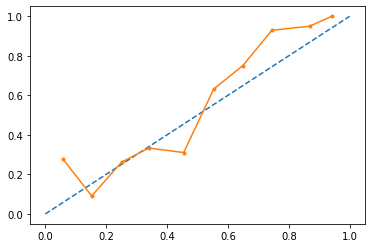

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.81       133
         1.0       0.86      0.70      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.79       265
weighted avg       0.81      0.80      0.79       265

learning rate: 0.3, n_estimator :120 max_features : 2, max_depth : 3 


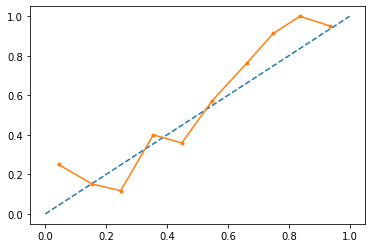

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :120 max_features : 2, max_depth : 4 


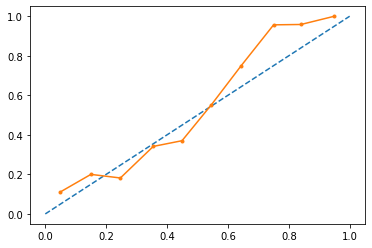

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.84      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :120 max_features : 2, max_depth : 5 


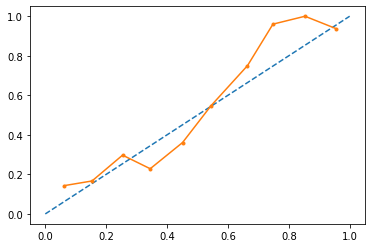

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :120 max_features : 3, max_depth : 3 


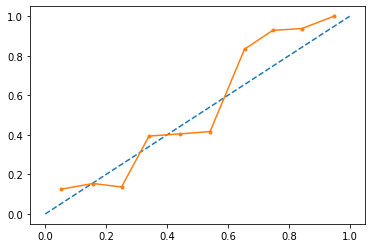

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.81      0.67      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.3, n_estimator :120 max_features : 3, max_depth : 4 


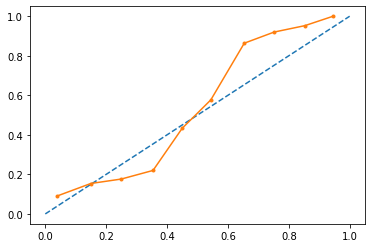

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.87      0.81       133
         1.0       0.85      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 0.3, n_estimator :120 max_features : 3, max_depth : 5 


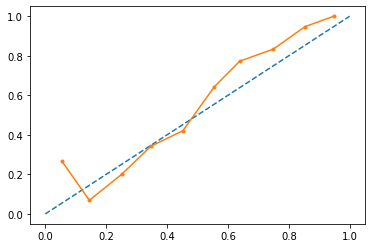

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.88      0.80       133
         1.0       0.85      0.67      0.75       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.77       265
weighted avg       0.79      0.78      0.77       265

learning rate: 0.3, n_estimator :120 max_features : 4, max_depth : 3 


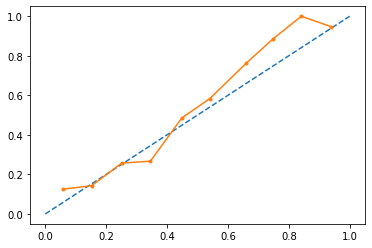

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.3, n_estimator :120 max_features : 4, max_depth : 4 


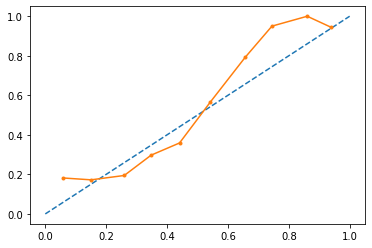

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :120 max_features : 4, max_depth : 5 


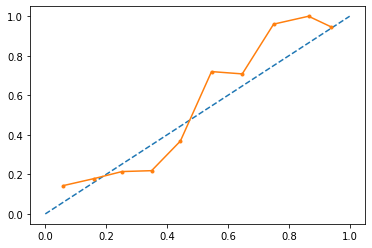

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.88      0.82       133
         1.0       0.86      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.3, n_estimator :120 max_features : 5, max_depth : 3 


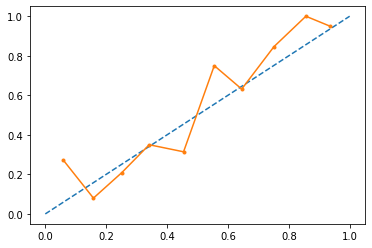

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :120 max_features : 5, max_depth : 4 


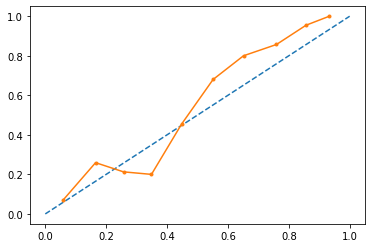

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :120 max_features : 5, max_depth : 5 


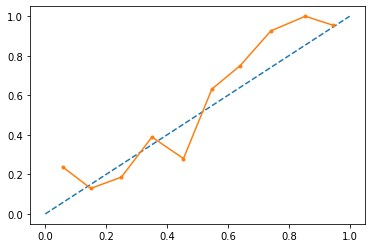

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 0.3, n_estimator :150 max_features : 2, max_depth : 3 


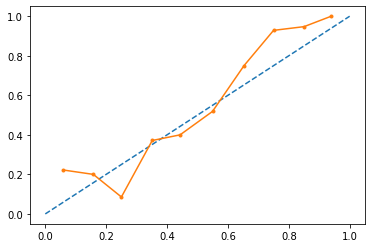

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.3, n_estimator :150 max_features : 2, max_depth : 4 


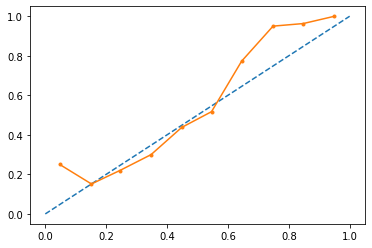

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.84      0.78       133
         1.0       0.81      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :150 max_features : 2, max_depth : 5 


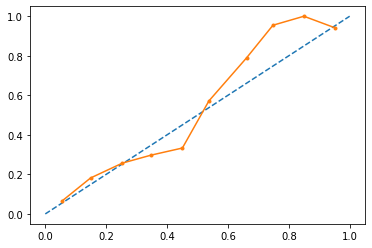

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.84      0.70      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :150 max_features : 3, max_depth : 3 


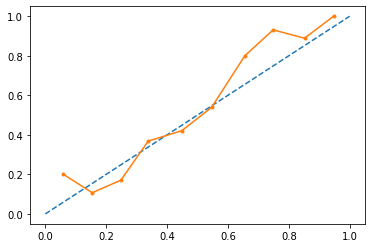

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :150 max_features : 3, max_depth : 4 


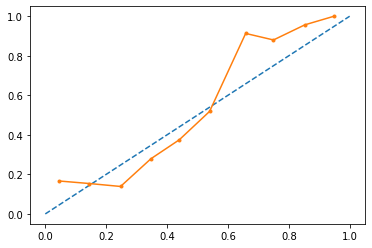

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.86      0.81       133
         1.0       0.84      0.73      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.80       265
weighted avg       0.80      0.80      0.80       265

learning rate: 0.3, n_estimator :150 max_features : 3, max_depth : 5 


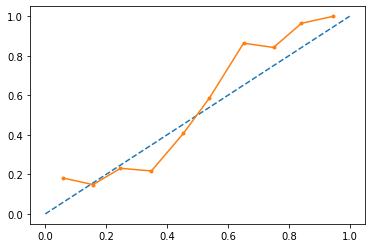

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :150 max_features : 4, max_depth : 3 


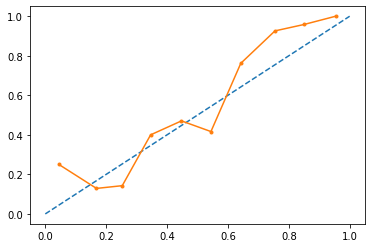

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.70      0.83      0.76       133
         1.0       0.79      0.64      0.71       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 0.3, n_estimator :150 max_features : 4, max_depth : 4 


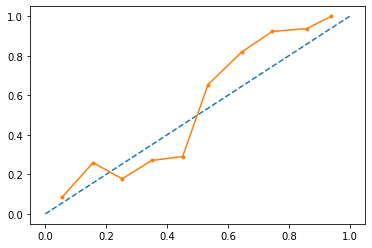

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.81       133
         1.0       0.86      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :150 max_features : 4, max_depth : 5 


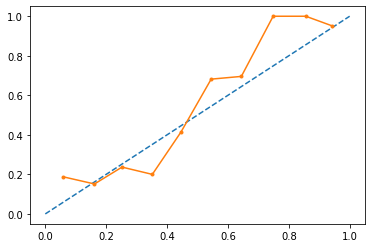

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.81       133
         1.0       0.86      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :150 max_features : 5, max_depth : 3 


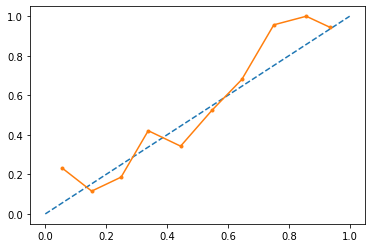

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :150 max_features : 5, max_depth : 4 


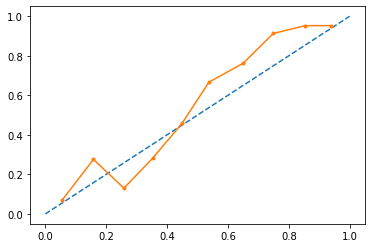

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.81       133
         1.0       0.84      0.72      0.78       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :150 max_features : 5, max_depth : 5 


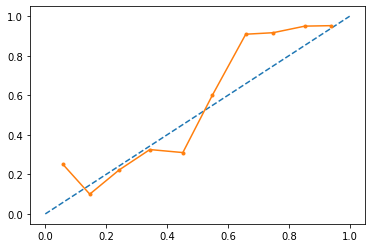

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.86      0.72      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.3, n_estimator :180 max_features : 2, max_depth : 3 


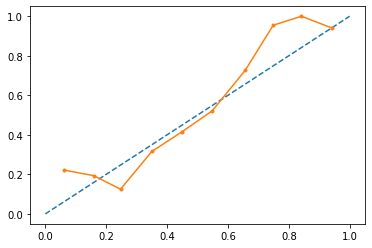

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.3, n_estimator :180 max_features : 2, max_depth : 4 


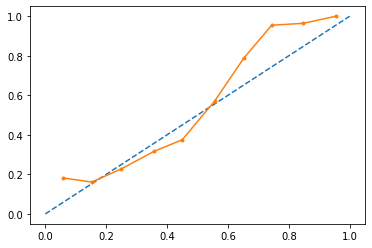

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.79       133
         1.0       0.82      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :180 max_features : 2, max_depth : 5 


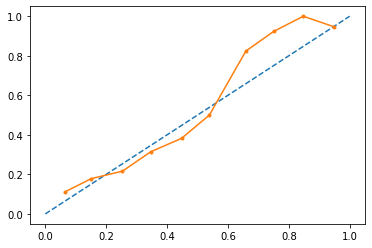

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :180 max_features : 3, max_depth : 3 


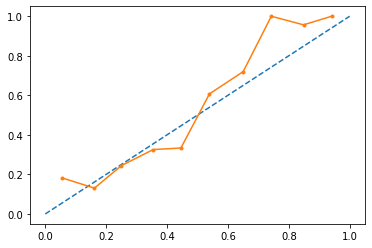

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :180 max_features : 3, max_depth : 4 


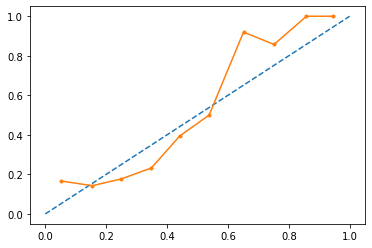

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.86      0.81       133
         1.0       0.84      0.73      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.80      0.80      0.80       265

learning rate: 0.3, n_estimator :180 max_features : 3, max_depth : 5 


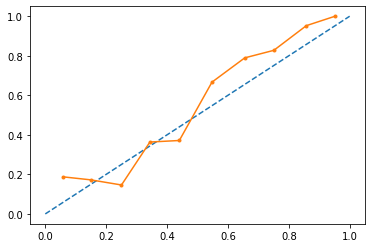

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :180 max_features : 4, max_depth : 3 


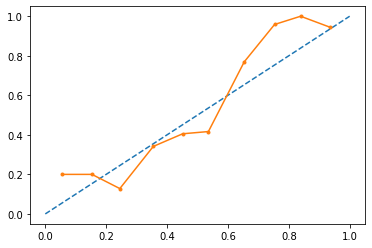

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :180 max_features : 4, max_depth : 4 


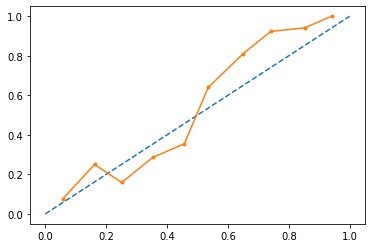

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.87      0.72      0.79       132

    accuracy                           0.81       265
   macro avg       0.82      0.81      0.81       265
weighted avg       0.82      0.81      0.81       265

learning rate: 0.3, n_estimator :180 max_features : 4, max_depth : 5 


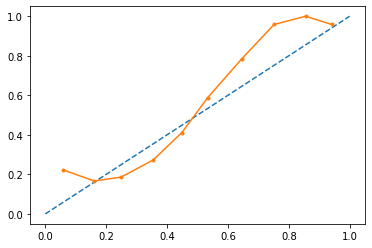

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.81       133
         1.0       0.86      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :180 max_features : 5, max_depth : 3 


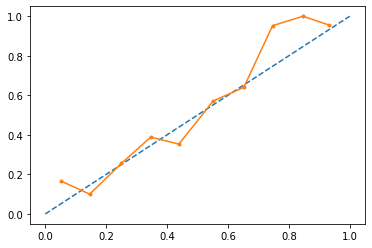

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :180 max_features : 5, max_depth : 4 


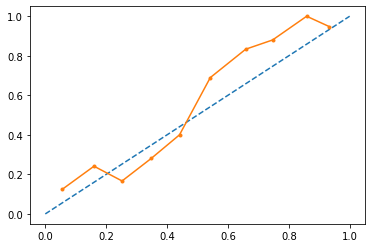

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.87      0.81       133
         1.0       0.85      0.71      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :180 max_features : 5, max_depth : 5 


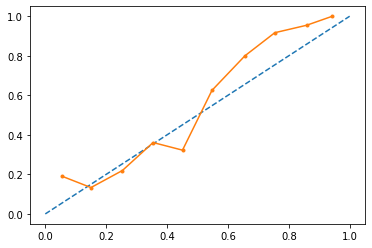

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.87      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.3, n_estimator :200 max_features : 2, max_depth : 3 


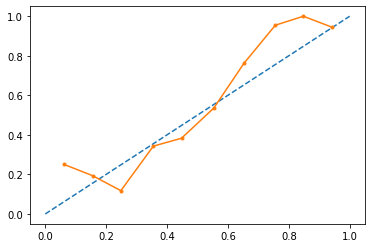

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.3, n_estimator :200 max_features : 2, max_depth : 4 


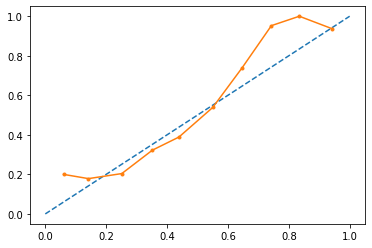

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.79       133
         1.0       0.82      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :200 max_features : 2, max_depth : 5 


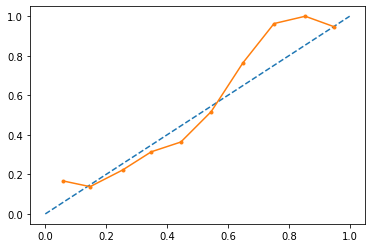

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.82      0.71      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :200 max_features : 3, max_depth : 3 


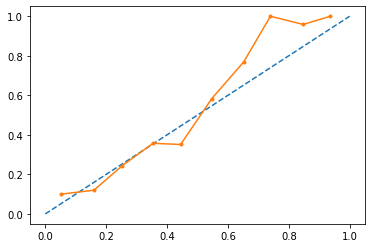

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.87      0.79       133
         1.0       0.84      0.67      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :200 max_features : 3, max_depth : 4 


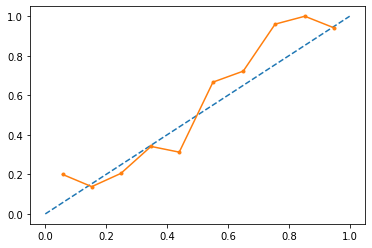

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.3, n_estimator :200 max_features : 3, max_depth : 5 


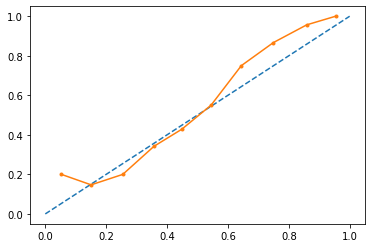

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :200 max_features : 4, max_depth : 3 


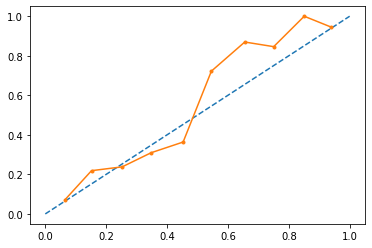

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.90      0.81       133
         1.0       0.87      0.68      0.77       132

    accuracy                           0.79       265
   macro avg       0.81      0.79      0.79       265
weighted avg       0.81      0.79      0.79       265

learning rate: 0.3, n_estimator :200 max_features : 4, max_depth : 4 


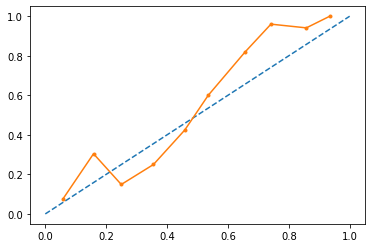

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.82       133
         1.0       0.87      0.70      0.77       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.79       265
weighted avg       0.81      0.80      0.79       265

learning rate: 0.3, n_estimator :200 max_features : 4, max_depth : 5 


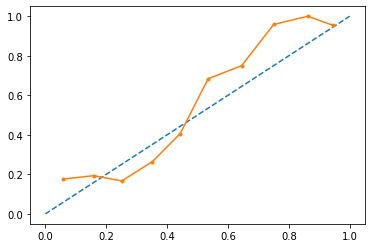

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.86      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.3, n_estimator :200 max_features : 5, max_depth : 3 


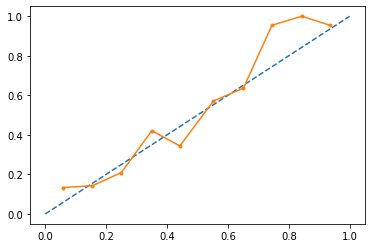

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.3, n_estimator :200 max_features : 5, max_depth : 4 


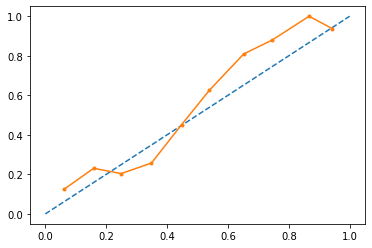

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.3, n_estimator :200 max_features : 5, max_depth : 5 


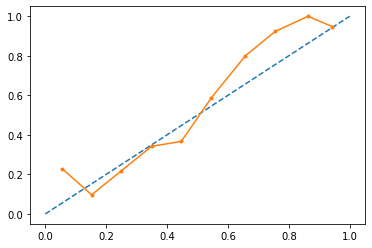

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.87      0.81       133
         1.0       0.85      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 0.5, n_estimator :100 max_features : 2, max_depth : 3 


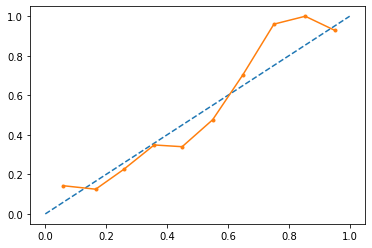

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.5, n_estimator :100 max_features : 2, max_depth : 4 


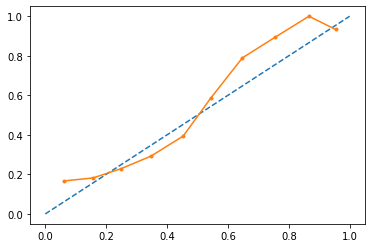

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :100 max_features : 2, max_depth : 5 


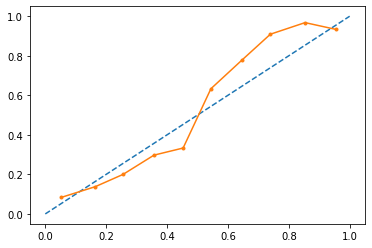

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.87      0.72      0.79       132

    accuracy                           0.81       265
   macro avg       0.82      0.81      0.81       265
weighted avg       0.82      0.81      0.81       265

learning rate: 0.5, n_estimator :100 max_features : 3, max_depth : 3 


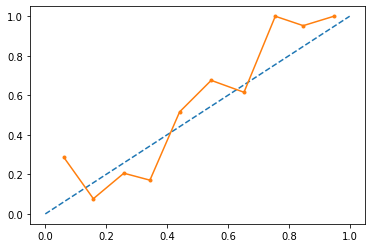

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.5, n_estimator :100 max_features : 3, max_depth : 4 


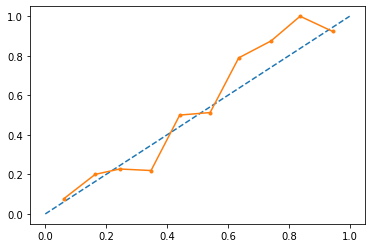

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.68      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :100 max_features : 3, max_depth : 5 


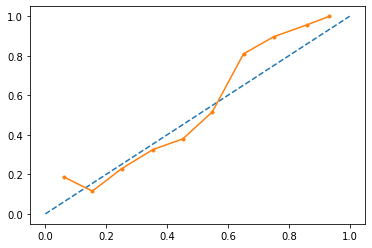

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.80      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 0.5, n_estimator :100 max_features : 4, max_depth : 3 


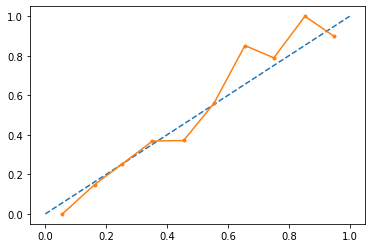

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       133
         1.0       0.79      0.69      0.74       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :100 max_features : 4, max_depth : 4 


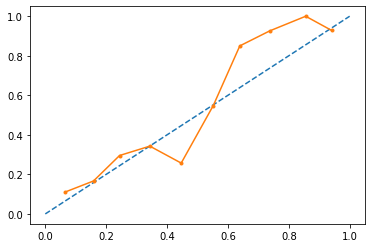

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :100 max_features : 4, max_depth : 5 


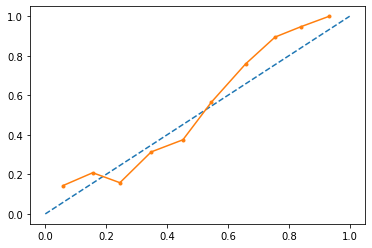

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :100 max_features : 5, max_depth : 3 


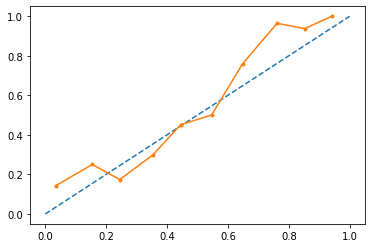

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.5, n_estimator :100 max_features : 5, max_depth : 4 


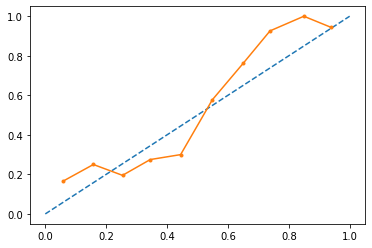

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.87      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :100 max_features : 5, max_depth : 5 


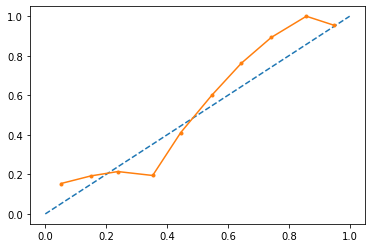

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.83      0.71      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :120 max_features : 2, max_depth : 3 


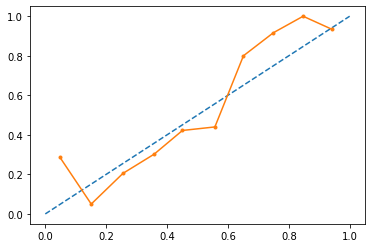

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.81      0.66      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :120 max_features : 2, max_depth : 4 


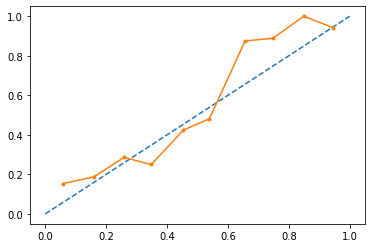

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :120 max_features : 2, max_depth : 5 


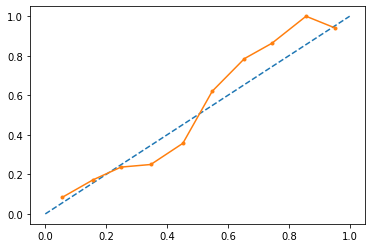

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :120 max_features : 3, max_depth : 3 


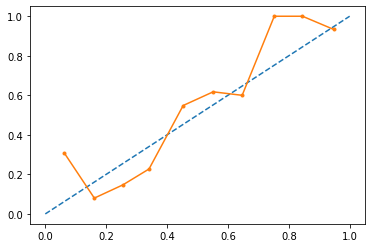

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.84      0.71      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :120 max_features : 3, max_depth : 4 


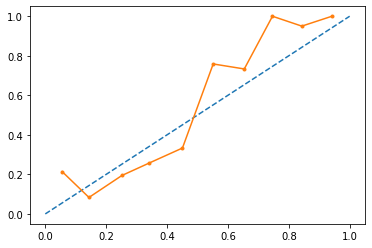

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.89      0.82       133
         1.0       0.86      0.73      0.79       132

    accuracy                           0.81       265
   macro avg       0.82      0.81      0.81       265
weighted avg       0.82      0.81      0.81       265

learning rate: 0.5, n_estimator :120 max_features : 3, max_depth : 5 


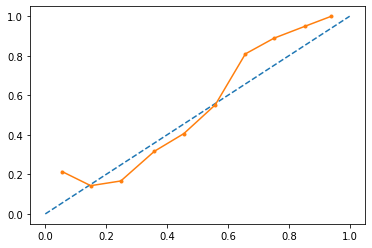

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.5, n_estimator :120 max_features : 4, max_depth : 3 


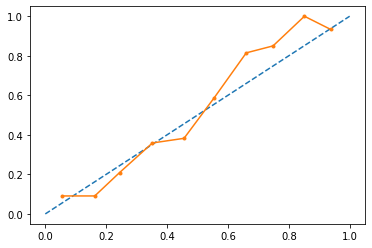

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.5, n_estimator :120 max_features : 4, max_depth : 4 


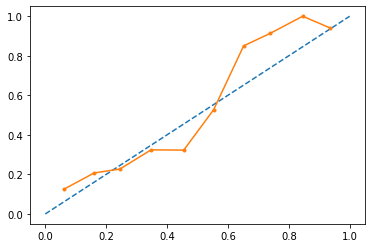

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.5, n_estimator :120 max_features : 4, max_depth : 5 


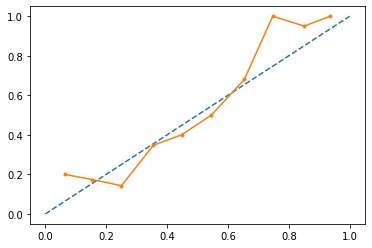

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.84      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :120 max_features : 5, max_depth : 3 


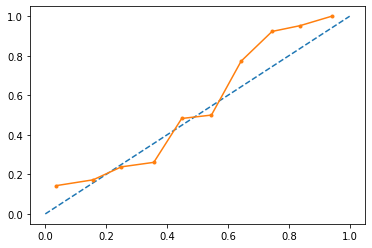

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.80      0.68      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 0.5, n_estimator :120 max_features : 5, max_depth : 4 


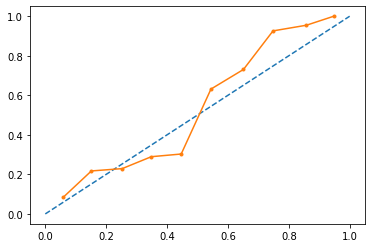

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.87      0.81       133
         1.0       0.85      0.71      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :120 max_features : 5, max_depth : 5 


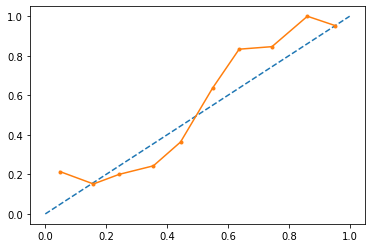

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.87      0.81       133
         1.0       0.85      0.73      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.5, n_estimator :150 max_features : 2, max_depth : 3 


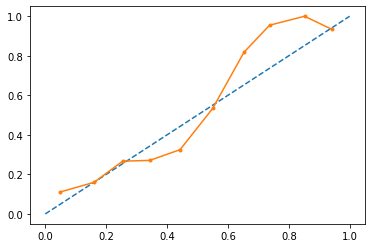

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.68      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :150 max_features : 2, max_depth : 4 


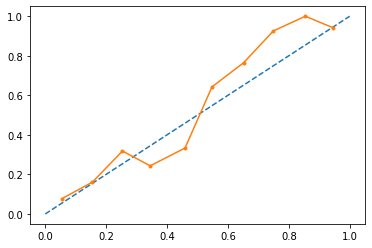

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.87      0.81       133
         1.0       0.85      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :150 max_features : 2, max_depth : 5 


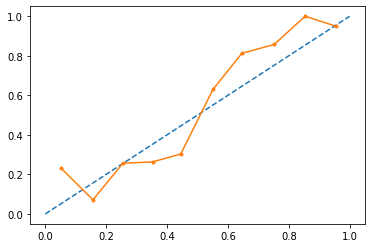

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.88      0.82       133
         1.0       0.86      0.73      0.79       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.5, n_estimator :150 max_features : 3, max_depth : 3 


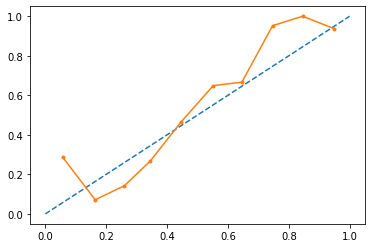

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.83      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :150 max_features : 3, max_depth : 4 


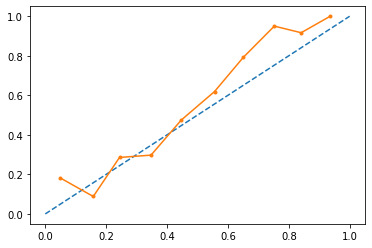

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.88      0.79       133
         1.0       0.84      0.65      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.76       265
weighted avg       0.78      0.77      0.76       265

learning rate: 0.5, n_estimator :150 max_features : 3, max_depth : 5 


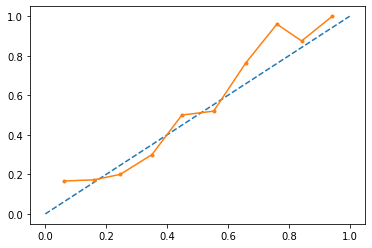

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :150 max_features : 4, max_depth : 3 


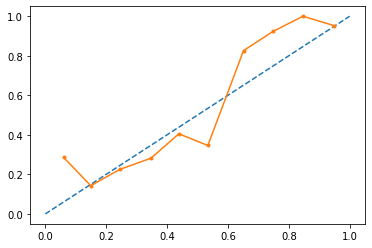

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.82      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.5, n_estimator :150 max_features : 4, max_depth : 4 


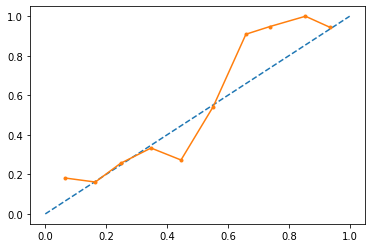

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.82      0.71      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :150 max_features : 4, max_depth : 5 


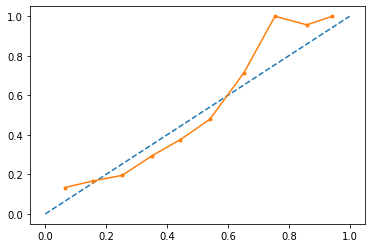

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.82      0.71      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :150 max_features : 5, max_depth : 3 


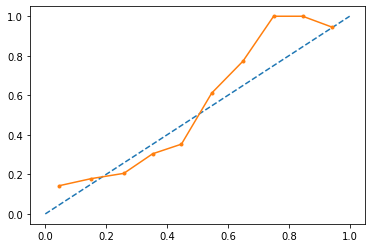

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.82       133
         1.0       0.87      0.70      0.77       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.79       265
weighted avg       0.81      0.80      0.79       265

learning rate: 0.5, n_estimator :150 max_features : 5, max_depth : 4 


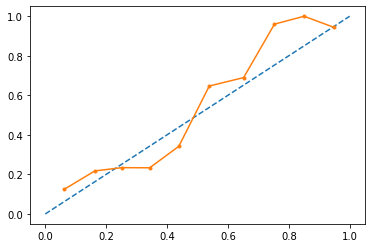

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.88      0.81       133
         1.0       0.85      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 0.5, n_estimator :150 max_features : 5, max_depth : 5 


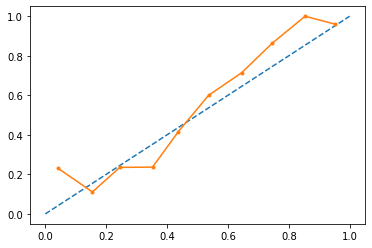

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.84      0.80       133
         1.0       0.82      0.74      0.78       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :180 max_features : 2, max_depth : 3 


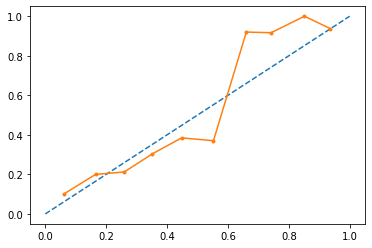

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 0.5, n_estimator :180 max_features : 2, max_depth : 4 


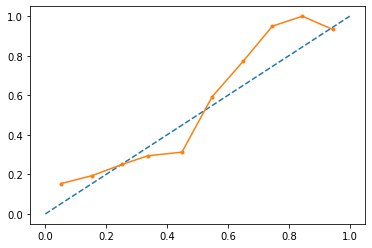

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.86      0.80       133
         1.0       0.84      0.71      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :180 max_features : 2, max_depth : 5 


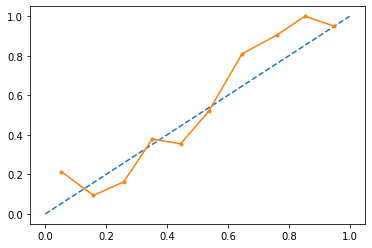

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.89      0.82       133
         1.0       0.86      0.71      0.78       132

    accuracy                           0.80       265
   macro avg       0.81      0.80      0.80       265
weighted avg       0.81      0.80      0.80       265

learning rate: 0.5, n_estimator :180 max_features : 3, max_depth : 3 


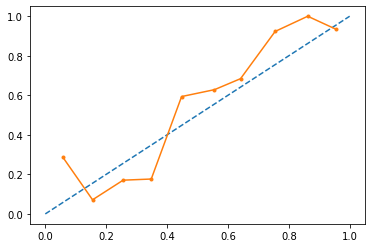

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.84      0.79       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :180 max_features : 3, max_depth : 4 


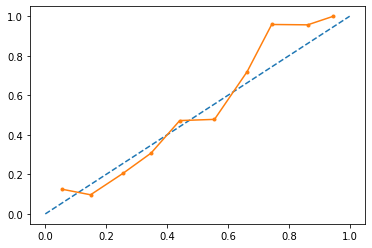

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :180 max_features : 3, max_depth : 5 


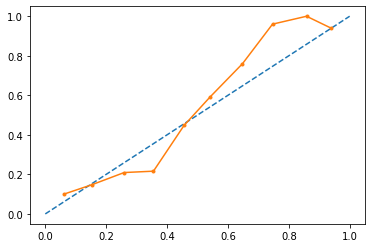

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.87      0.79       133
         1.0       0.84      0.67      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :180 max_features : 4, max_depth : 3 


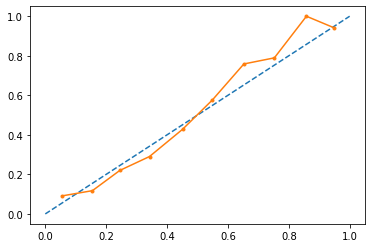

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :180 max_features : 4, max_depth : 4 


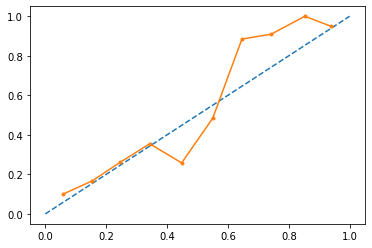

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.79       133
         1.0       0.81      0.71      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :180 max_features : 4, max_depth : 5 


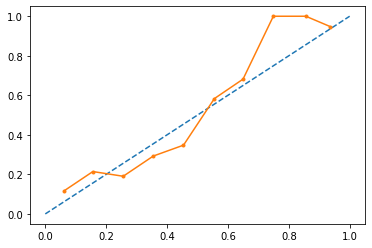

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.81       133
         1.0       0.84      0.72      0.78       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :180 max_features : 5, max_depth : 3 


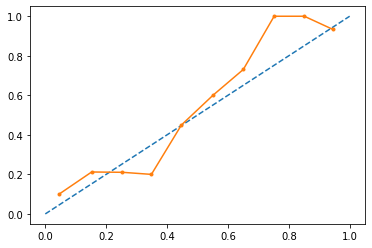

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :180 max_features : 5, max_depth : 4 


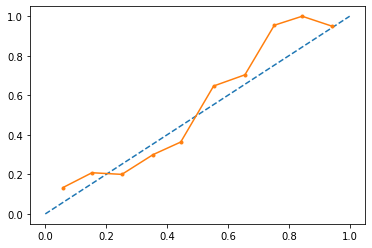

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.89      0.81       133
         1.0       0.86      0.70      0.77       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :180 max_features : 5, max_depth : 5 


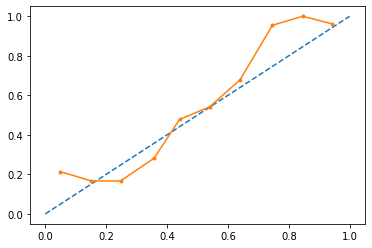

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.84      0.79       133
         1.0       0.82      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :200 max_features : 2, max_depth : 3 


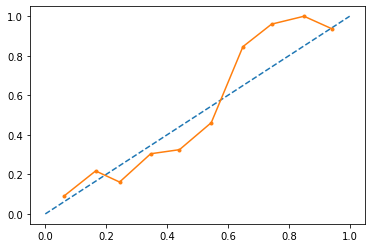

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.78       133
         1.0       0.82      0.68      0.74       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.5, n_estimator :200 max_features : 2, max_depth : 4 


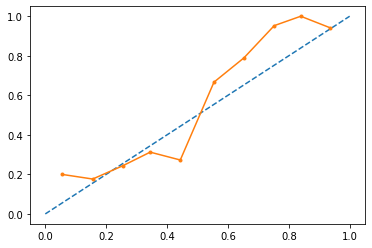

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.81       133
         1.0       0.84      0.72      0.78       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 0.5, n_estimator :200 max_features : 2, max_depth : 5 


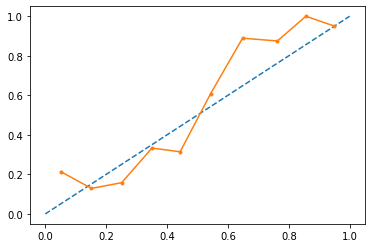

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.77      0.91      0.83       133
         1.0       0.89      0.72      0.79       132

    accuracy                           0.82       265
   macro avg       0.83      0.81      0.81       265
weighted avg       0.83      0.82      0.81       265

learning rate: 0.5, n_estimator :200 max_features : 3, max_depth : 3 


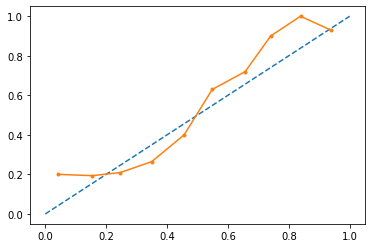

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 0.5, n_estimator :200 max_features : 3, max_depth : 4 


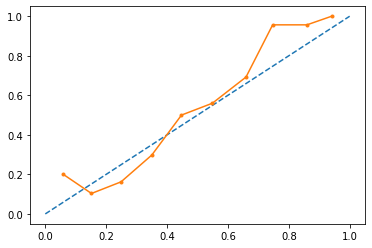

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.5, n_estimator :200 max_features : 3, max_depth : 5 


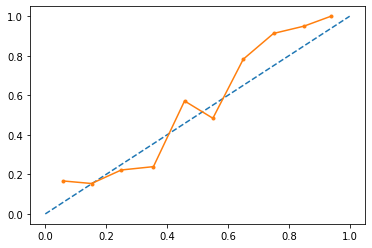

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 0.5, n_estimator :200 max_features : 4, max_depth : 3 


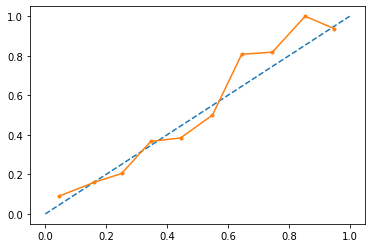

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       133
         1.0       0.79      0.69      0.74       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 0.5, n_estimator :200 max_features : 4, max_depth : 4 


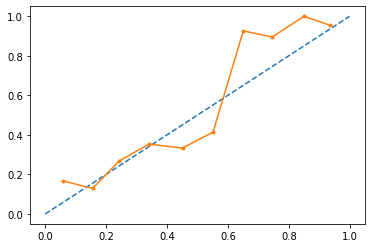

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.76       265
weighted avg       0.77      0.77      0.76       265

learning rate: 0.5, n_estimator :200 max_features : 4, max_depth : 5 


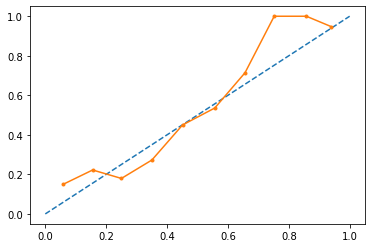

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.83      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :200 max_features : 5, max_depth : 3 


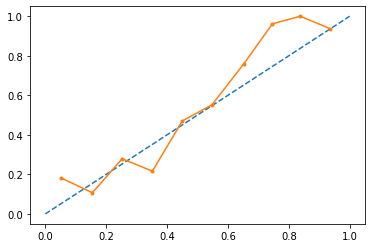

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 0.5, n_estimator :200 max_features : 5, max_depth : 4 


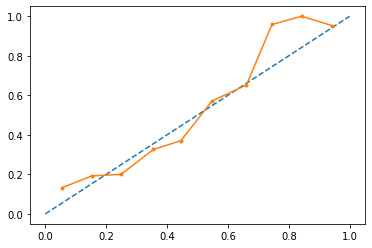

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.87      0.80       133
         1.0       0.84      0.70      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 0.5, n_estimator :200 max_features : 5, max_depth : 5 


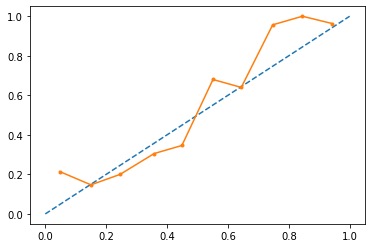

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.87      0.81       133
         1.0       0.85      0.72      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.79       265
weighted avg       0.80      0.80      0.79       265

learning rate: 1, n_estimator :100 max_features : 2, max_depth : 3 


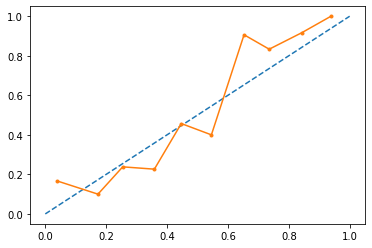

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.82      0.77       133
         1.0       0.79      0.70      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 1, n_estimator :100 max_features : 2, max_depth : 4 


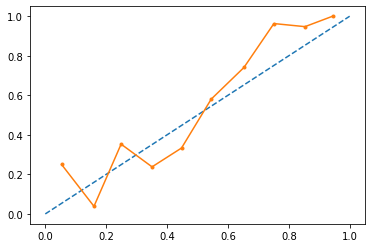

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.79       133
         1.0       0.83      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :100 max_features : 2, max_depth : 5 


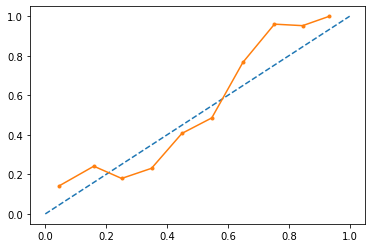

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.80      0.77       133
         1.0       0.78      0.71      0.74       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :100 max_features : 3, max_depth : 3 


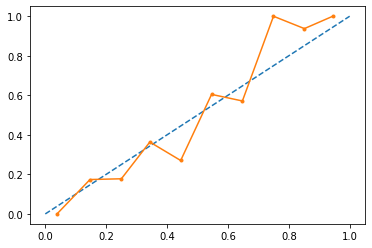

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.81      0.77       133
         1.0       0.79      0.71      0.75       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 1, n_estimator :100 max_features : 3, max_depth : 4 


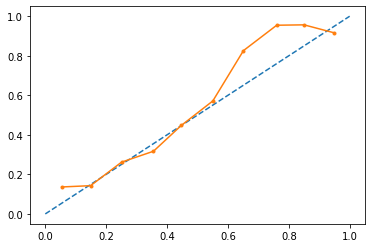

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.88      0.79       133
         1.0       0.84      0.64      0.73       132

    accuracy                           0.76       265
   macro avg       0.78      0.76      0.76       265
weighted avg       0.78      0.76      0.76       265

learning rate: 1, n_estimator :100 max_features : 3, max_depth : 5 


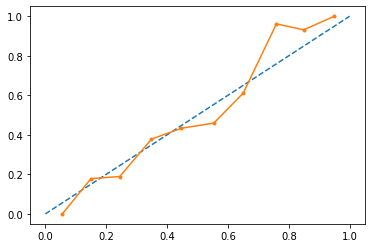

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.79      0.75       133
         1.0       0.76      0.69      0.73       132

    accuracy                           0.74       265
   macro avg       0.74      0.74      0.74       265
weighted avg       0.74      0.74      0.74       265

learning rate: 1, n_estimator :100 max_features : 4, max_depth : 3 


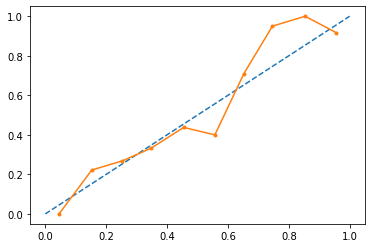

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.83      0.75       133
         1.0       0.78      0.61      0.69       132

    accuracy                           0.72       265
   macro avg       0.73      0.72      0.72       265
weighted avg       0.73      0.72      0.72       265

learning rate: 1, n_estimator :100 max_features : 4, max_depth : 4 


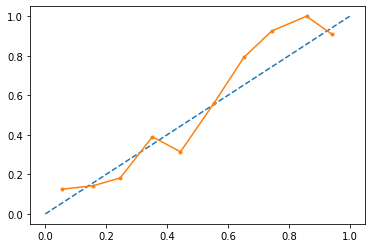

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 1, n_estimator :100 max_features : 4, max_depth : 5 


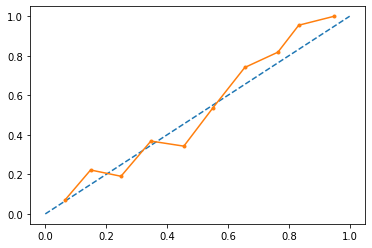

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.82      0.78       133
         1.0       0.79      0.70      0.75       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :100 max_features : 5, max_depth : 3 


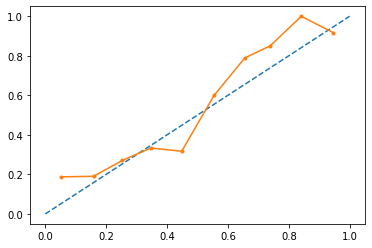

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.84      0.78       133
         1.0       0.81      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :100 max_features : 5, max_depth : 4 


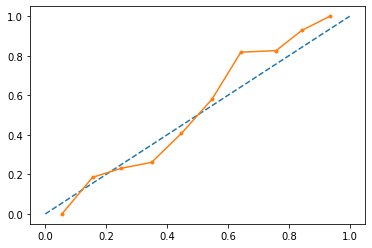

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :100 max_features : 5, max_depth : 5 


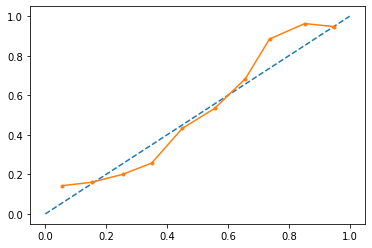

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.83      0.79       133
         1.0       0.81      0.73      0.77       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 1, n_estimator :120 max_features : 2, max_depth : 3 


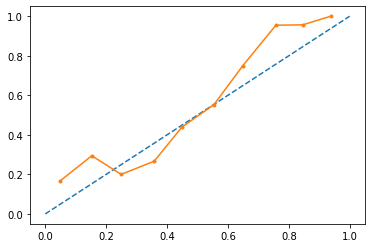

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.76       133
         1.0       0.79      0.65      0.71       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 1, n_estimator :120 max_features : 2, max_depth : 4 


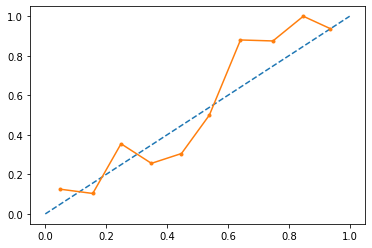

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.79       133
         1.0       0.81      0.71      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :120 max_features : 2, max_depth : 5 


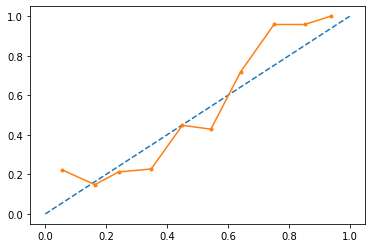

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.81      0.77       133
         1.0       0.79      0.71      0.75       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 1, n_estimator :120 max_features : 3, max_depth : 3 


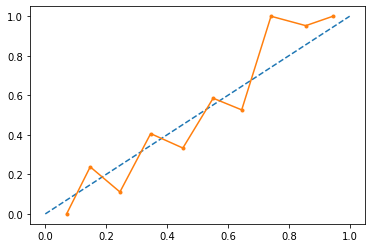

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.84      0.79       133
         1.0       0.82      0.70      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :120 max_features : 3, max_depth : 4 


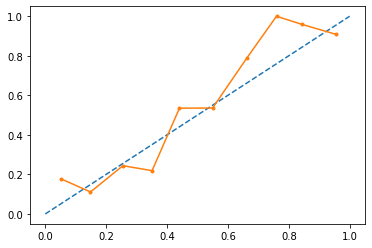

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.86      0.78       133
         1.0       0.83      0.65      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :120 max_features : 3, max_depth : 5 


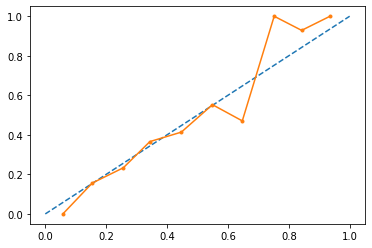

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.81      0.77       133
         1.0       0.79      0.70      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 1, n_estimator :120 max_features : 4, max_depth : 3 


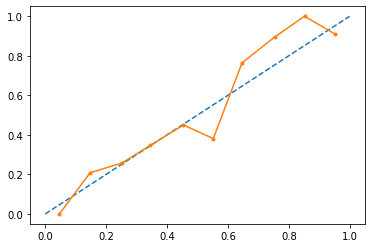

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.68      0.80      0.74       133
         1.0       0.76      0.62      0.68       132

    accuracy                           0.71       265
   macro avg       0.72      0.71      0.71       265
weighted avg       0.72      0.71      0.71       265

learning rate: 1, n_estimator :120 max_features : 4, max_depth : 4 


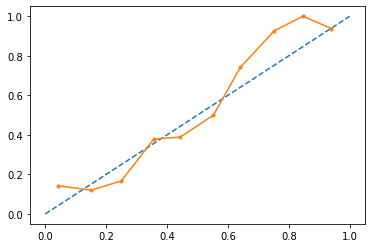

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.80      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 1, n_estimator :120 max_features : 4, max_depth : 5 


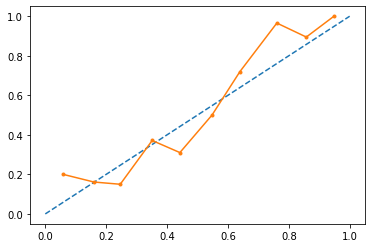

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.81       133
         1.0       0.84      0.73      0.78       132

    accuracy                           0.80       265
   macro avg       0.80      0.80      0.80       265
weighted avg       0.80      0.80      0.80       265

learning rate: 1, n_estimator :120 max_features : 5, max_depth : 3 


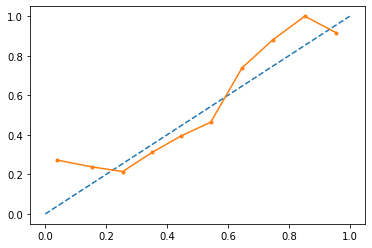

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.85      0.77       133
         1.0       0.81      0.65      0.72       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :120 max_features : 5, max_depth : 4 


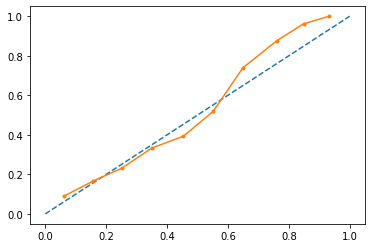

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.80      0.70      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :120 max_features : 5, max_depth : 5 


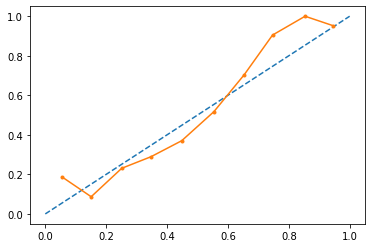

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.83      0.79       133
         1.0       0.81      0.73      0.77       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 1, n_estimator :150 max_features : 2, max_depth : 3 


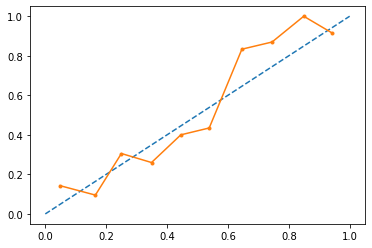

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :150 max_features : 2, max_depth : 4 


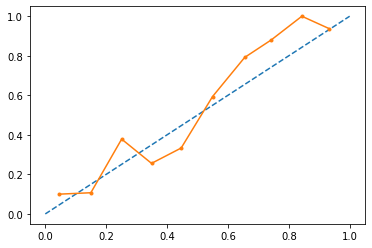

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :150 max_features : 2, max_depth : 5 


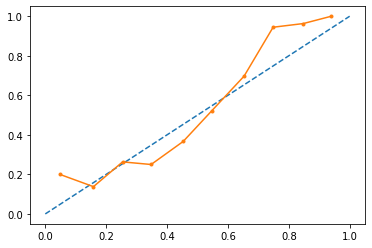

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.79       133
         1.0       0.81      0.71      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :150 max_features : 3, max_depth : 3 


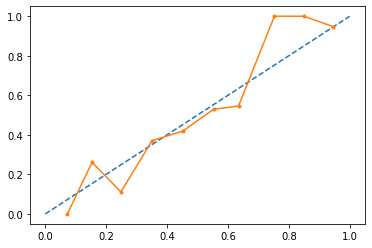

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :150 max_features : 3, max_depth : 4 


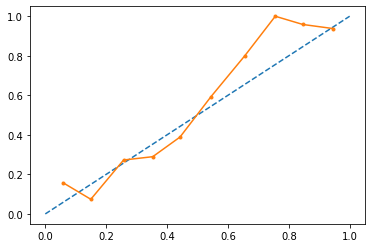

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.86      0.79       133
         1.0       0.83      0.67      0.74       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :150 max_features : 3, max_depth : 5 


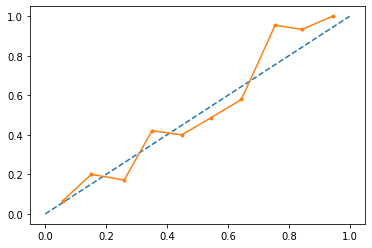

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.80      0.76       133
         1.0       0.78      0.69      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 1, n_estimator :150 max_features : 4, max_depth : 3 


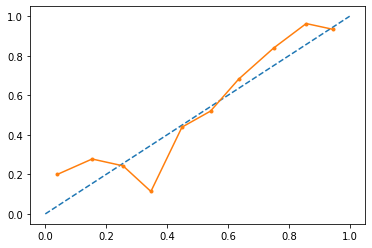

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.80      0.68      0.74       132

    accuracy                           0.76       265
   macro avg       0.76      0.76      0.76       265
weighted avg       0.76      0.76      0.76       265

learning rate: 1, n_estimator :150 max_features : 4, max_depth : 4 


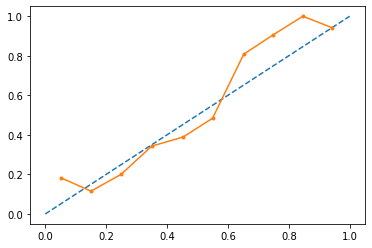

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :150 max_features : 4, max_depth : 5 


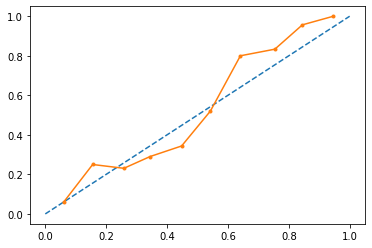

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.84      0.79       133
         1.0       0.82      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 1, n_estimator :150 max_features : 5, max_depth : 3 


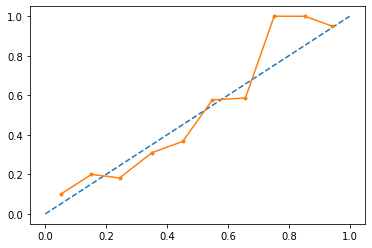

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :150 max_features : 5, max_depth : 4 


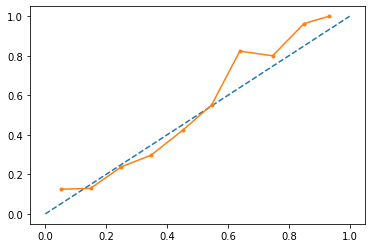

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :150 max_features : 5, max_depth : 5 


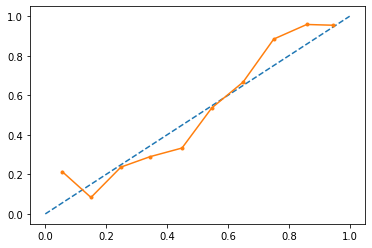

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.83      0.79       133
         1.0       0.81      0.73      0.77       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 1, n_estimator :180 max_features : 2, max_depth : 3 


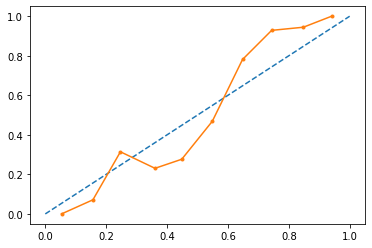

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.83      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 1, n_estimator :180 max_features : 2, max_depth : 4 


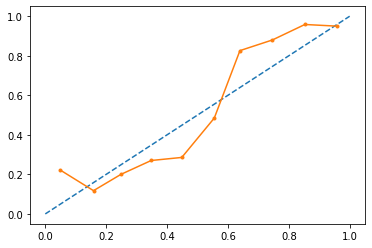

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.82      0.79       133
         1.0       0.80      0.73      0.77       132

    accuracy                           0.78       265
   macro avg       0.78      0.78      0.78       265
weighted avg       0.78      0.78      0.78       265

learning rate: 1, n_estimator :180 max_features : 2, max_depth : 5 


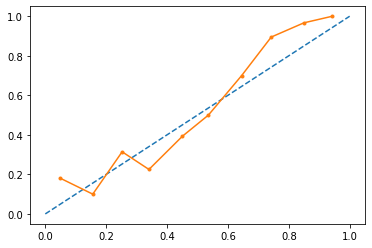

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.81      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 1, n_estimator :180 max_features : 3, max_depth : 3 


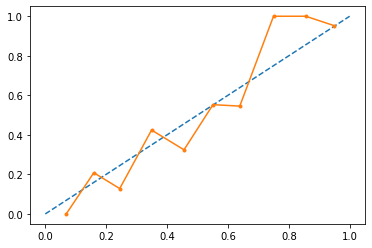

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.76       133
         1.0       0.78      0.68      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 1, n_estimator :180 max_features : 3, max_depth : 4 


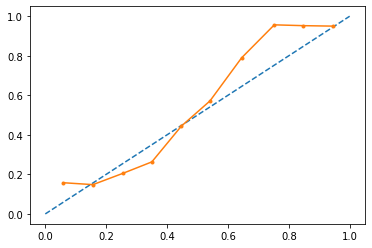

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.86      0.78       133
         1.0       0.83      0.66      0.73       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :180 max_features : 3, max_depth : 5 


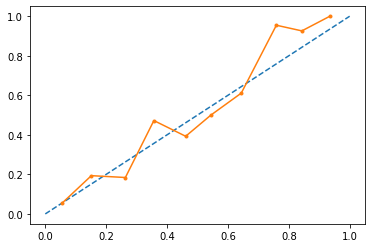

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :180 max_features : 4, max_depth : 3 


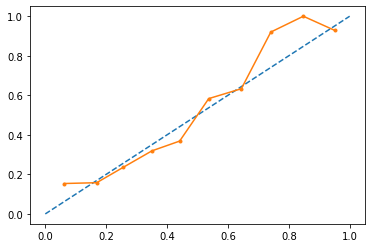

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.82      0.76       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 1, n_estimator :180 max_features : 4, max_depth : 4 


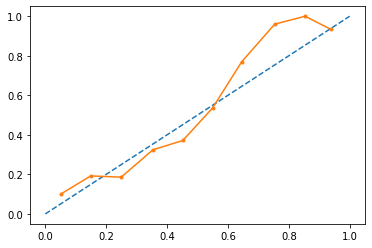

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.85      0.79       133
         1.0       0.82      0.70      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :180 max_features : 4, max_depth : 5 


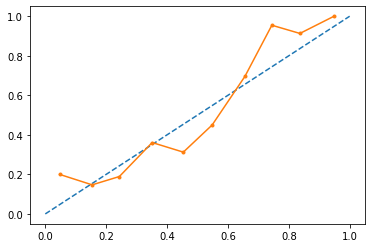

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.76      0.86      0.81       133
         1.0       0.84      0.72      0.78       132

    accuracy                           0.79       265
   macro avg       0.80      0.79      0.79       265
weighted avg       0.80      0.79      0.79       265

learning rate: 1, n_estimator :180 max_features : 5, max_depth : 3 


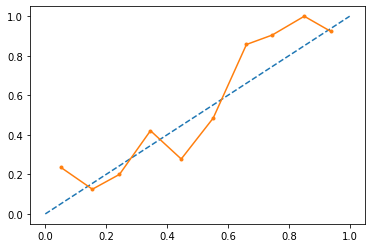

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :180 max_features : 5, max_depth : 4 


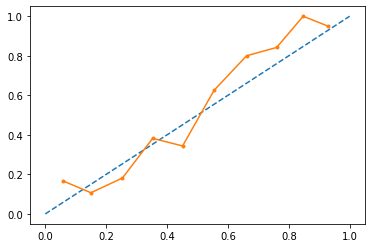

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.85      0.79       133
         1.0       0.82      0.69      0.75       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :180 max_features : 5, max_depth : 5 


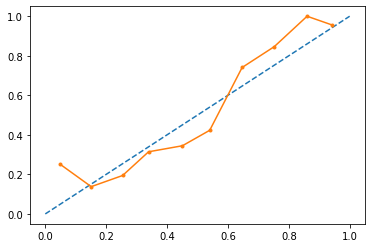

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.84      0.79       133
         1.0       0.82      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 1, n_estimator :200 max_features : 2, max_depth : 3 


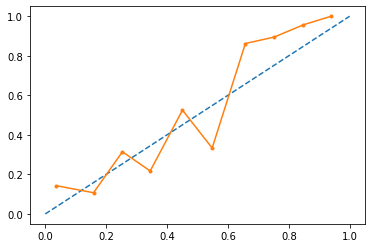

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.71      0.83      0.76       133
         1.0       0.79      0.65      0.71       132

    accuracy                           0.74       265
   macro avg       0.75      0.74      0.74       265
weighted avg       0.75      0.74      0.74       265

learning rate: 1, n_estimator :200 max_features : 2, max_depth : 4 


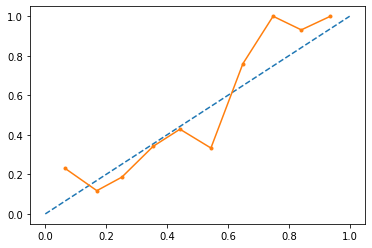

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.81      0.77       133
         1.0       0.78      0.69      0.73       132

    accuracy                           0.75       265
   macro avg       0.75      0.75      0.75       265
weighted avg       0.75      0.75      0.75       265

learning rate: 1, n_estimator :200 max_features : 2, max_depth : 5 


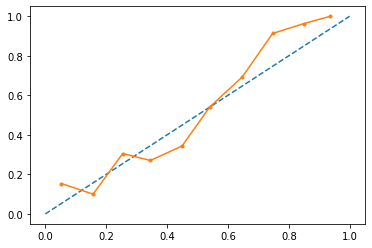

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.79       133
         1.0       0.81      0.71      0.76       132

    accuracy                           0.77       265
   macro avg       0.78      0.77      0.77       265
weighted avg       0.78      0.77      0.77       265

learning rate: 1, n_estimator :200 max_features : 3, max_depth : 3 


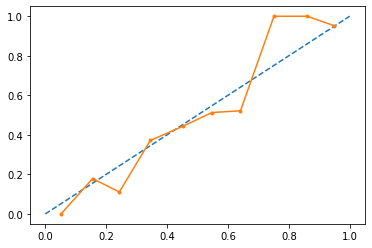

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :200 max_features : 3, max_depth : 4 


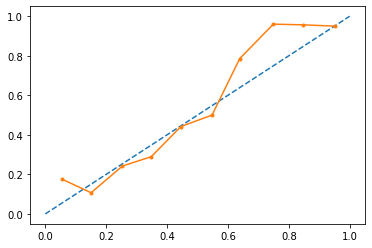

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.89      0.80       133
         1.0       0.85      0.66      0.74       132

    accuracy                           0.77       265
   macro avg       0.79      0.77      0.77       265
weighted avg       0.79      0.77      0.77       265

learning rate: 1, n_estimator :200 max_features : 3, max_depth : 5 


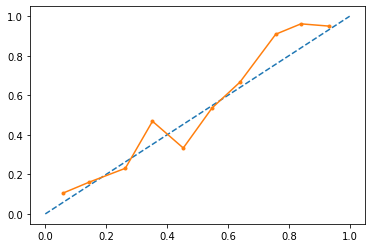

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.73      0.83      0.78       133
         1.0       0.81      0.69      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :200 max_features : 4, max_depth : 3 


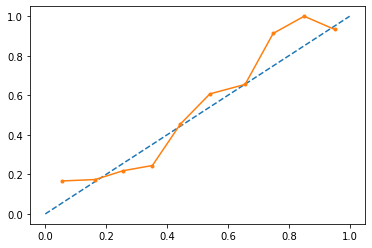

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.80      0.68      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :200 max_features : 4, max_depth : 4 


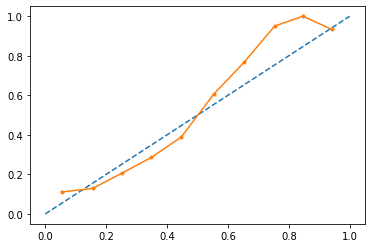

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.86      0.80       133
         1.0       0.83      0.69      0.76       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 1, n_estimator :200 max_features : 4, max_depth : 5 


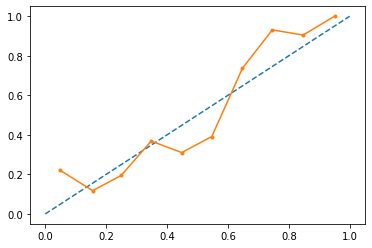

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.75      0.85      0.80       133
         1.0       0.83      0.72      0.77       132

    accuracy                           0.78       265
   macro avg       0.79      0.78      0.78       265
weighted avg       0.79      0.78      0.78       265

learning rate: 1, n_estimator :200 max_features : 5, max_depth : 3 


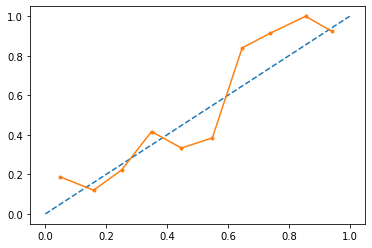

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.83      0.77       133
         1.0       0.79      0.67      0.73       132

    accuracy                           0.75       265
   macro avg       0.76      0.75      0.75       265
weighted avg       0.76      0.75      0.75       265

learning rate: 1, n_estimator :200 max_features : 5, max_depth : 4 


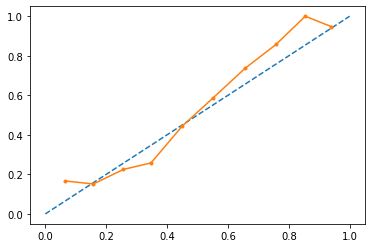

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.72      0.85      0.78       133
         1.0       0.82      0.67      0.74       132

    accuracy                           0.76       265
   macro avg       0.77      0.76      0.76       265
weighted avg       0.77      0.76      0.76       265

learning rate: 1, n_estimator :200 max_features : 5, max_depth : 5 


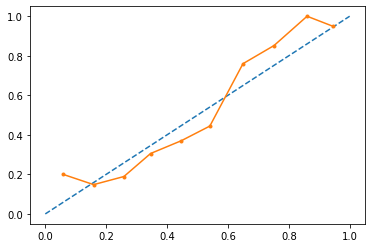

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.74      0.83      0.78       133
         1.0       0.80      0.71      0.76       132

    accuracy                           0.77       265
   macro avg       0.77      0.77      0.77       265
weighted avg       0.77      0.77      0.77       265

learning rate: 2, n_estimator :100 max_features : 2, max_depth : 3 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


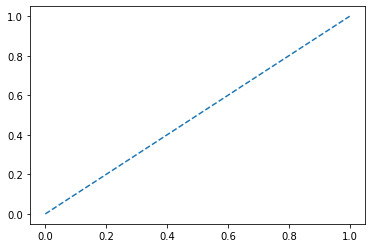

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :100 max_features : 2, max_depth : 4 


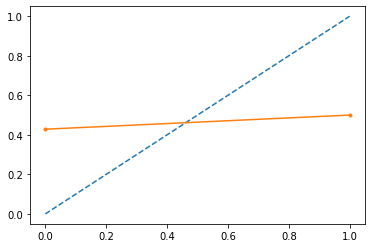

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :100 max_features : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


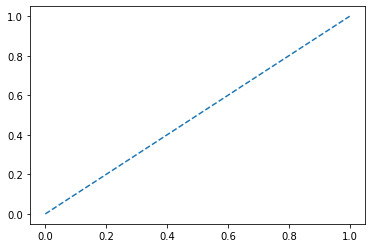

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :100 max_features : 3, max_depth : 3 


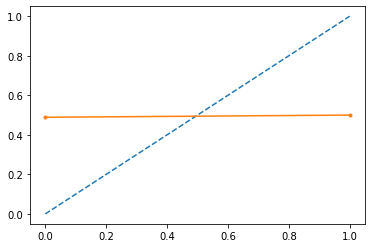

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.51      0.17      0.26       133
         1.0       0.50      0.83      0.62       132

    accuracy                           0.50       265
   macro avg       0.51      0.50      0.44       265
weighted avg       0.51      0.50      0.44       265

learning rate: 2, n_estimator :100 max_features : 3, max_depth : 4 


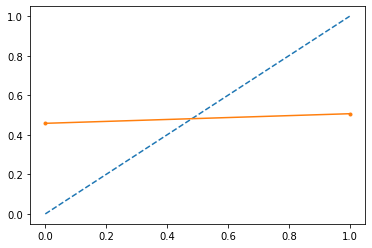

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.54      0.20      0.29       133
         1.0       0.51      0.83      0.63       132

    accuracy                           0.51       265
   macro avg       0.52      0.51      0.46       265
weighted avg       0.52      0.51      0.46       265

learning rate: 2, n_estimator :100 max_features : 3, max_depth : 5 


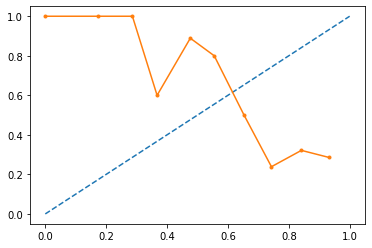

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :100 max_features : 4, max_depth : 3 


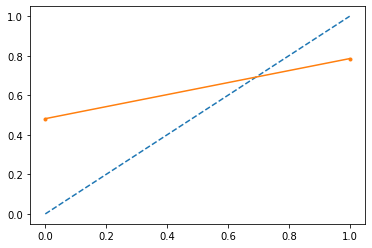

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.52      0.98      0.68       133
         1.0       0.79      0.08      0.15       132

    accuracy                           0.53       265
   macro avg       0.65      0.53      0.41       265
weighted avg       0.65      0.53      0.41       265

learning rate: 2, n_estimator :100 max_features : 4, max_depth : 4 


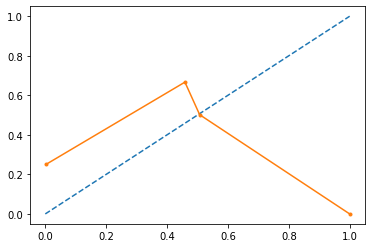

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :100 max_features : 4, max_depth : 5 


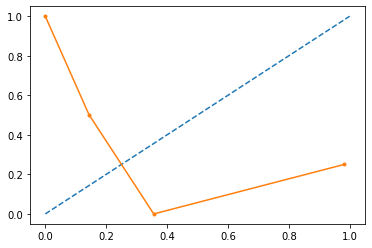

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :100 max_features : 5, max_depth : 3 


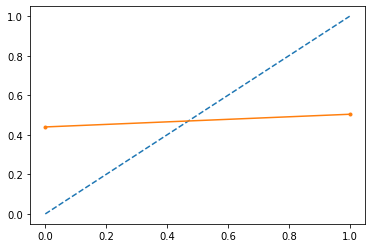

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.56      0.11      0.18       133
         1.0       0.50      0.92      0.65       132

    accuracy                           0.51       265
   macro avg       0.53      0.51      0.41       265
weighted avg       0.53      0.51      0.41       265

learning rate: 2, n_estimator :100 max_features : 5, max_depth : 4 


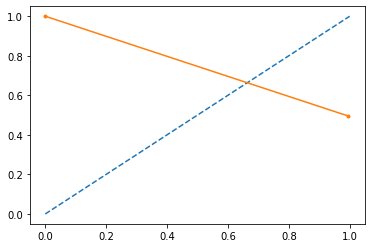

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      0.99      0.66       132

    accuracy                           0.49       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.49      0.33       265

learning rate: 2, n_estimator :100 max_features : 5, max_depth : 5 


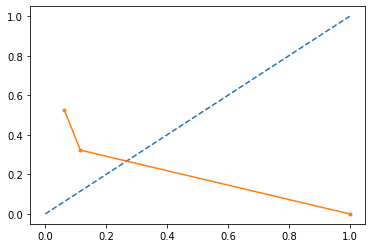

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :120 max_features : 2, max_depth : 3 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


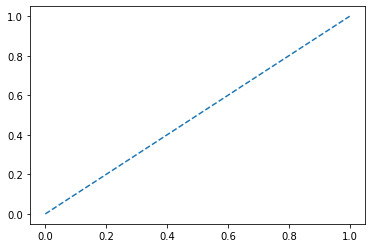

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :120 max_features : 2, max_depth : 4 


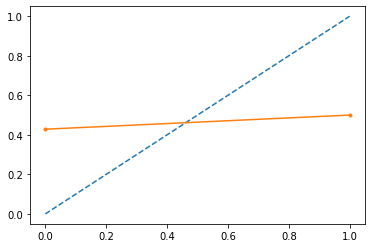

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :120 max_features : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


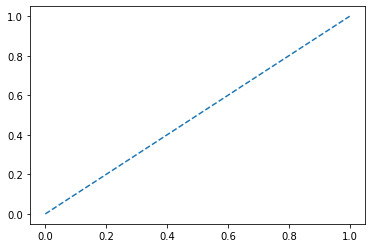

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :120 max_features : 3, max_depth : 3 


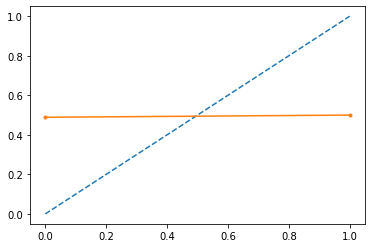

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.51      0.17      0.26       133
         1.0       0.50      0.83      0.62       132

    accuracy                           0.50       265
   macro avg       0.51      0.50      0.44       265
weighted avg       0.51      0.50      0.44       265

learning rate: 2, n_estimator :120 max_features : 3, max_depth : 4 


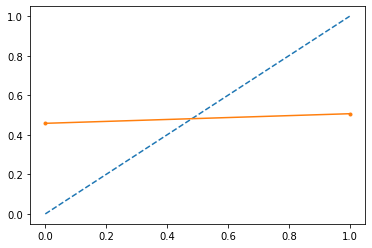

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.54      0.20      0.29       133
         1.0       0.51      0.83      0.63       132

    accuracy                           0.51       265
   macro avg       0.52      0.51      0.46       265
weighted avg       0.52      0.51      0.46       265

learning rate: 2, n_estimator :120 max_features : 3, max_depth : 5 


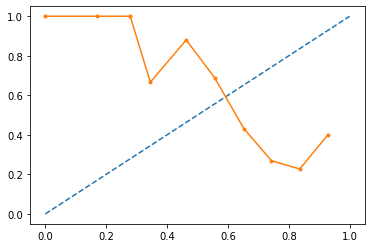

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :120 max_features : 4, max_depth : 3 


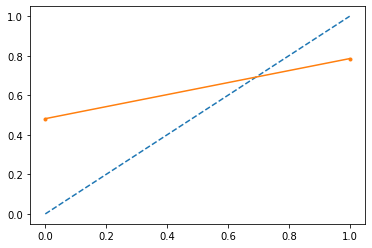

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.52      0.98      0.68       133
         1.0       0.79      0.08      0.15       132

    accuracy                           0.53       265
   macro avg       0.65      0.53      0.41       265
weighted avg       0.65      0.53      0.41       265

learning rate: 2, n_estimator :120 max_features : 4, max_depth : 4 


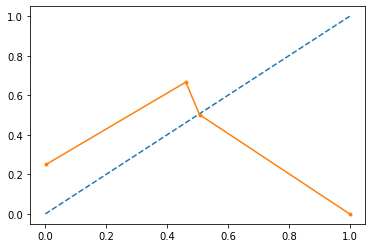

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :120 max_features : 4, max_depth : 5 


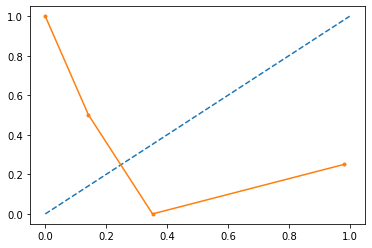

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :120 max_features : 5, max_depth : 3 


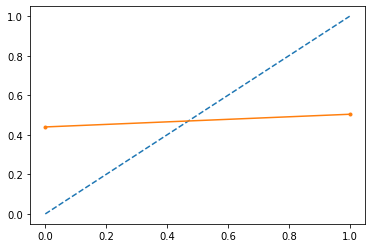

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.56      0.11      0.18       133
         1.0       0.50      0.92      0.65       132

    accuracy                           0.51       265
   macro avg       0.53      0.51      0.41       265
weighted avg       0.53      0.51      0.41       265

learning rate: 2, n_estimator :120 max_features : 5, max_depth : 4 


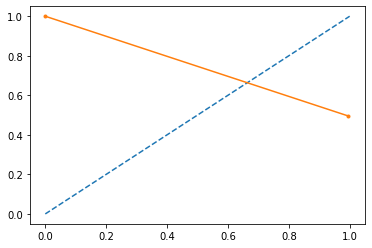

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      0.99      0.66       132

    accuracy                           0.49       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.49      0.33       265

learning rate: 2, n_estimator :120 max_features : 5, max_depth : 5 


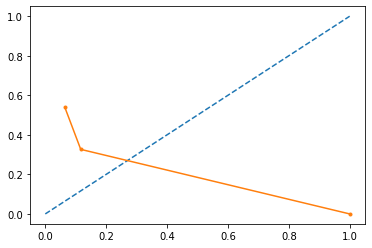

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :150 max_features : 2, max_depth : 3 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


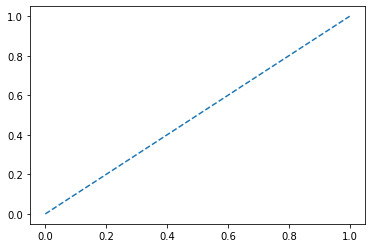

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :150 max_features : 2, max_depth : 4 


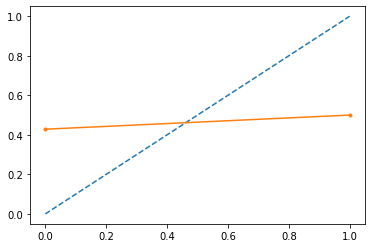

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :150 max_features : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


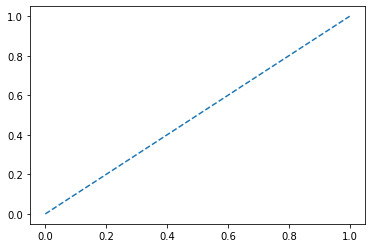

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :150 max_features : 3, max_depth : 3 


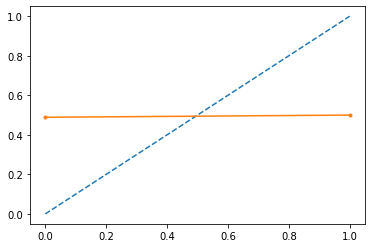

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.51      0.17      0.26       133
         1.0       0.50      0.83      0.62       132

    accuracy                           0.50       265
   macro avg       0.51      0.50      0.44       265
weighted avg       0.51      0.50      0.44       265

learning rate: 2, n_estimator :150 max_features : 3, max_depth : 4 


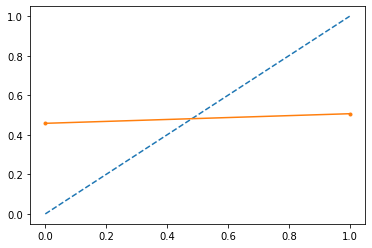

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.54      0.20      0.29       133
         1.0       0.51      0.83      0.63       132

    accuracy                           0.51       265
   macro avg       0.52      0.51      0.46       265
weighted avg       0.52      0.51      0.46       265

learning rate: 2, n_estimator :150 max_features : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


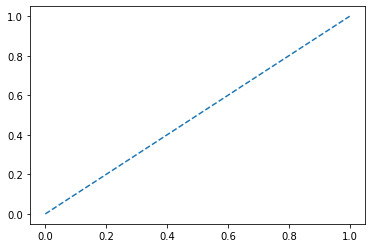

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :150 max_features : 4, max_depth : 3 


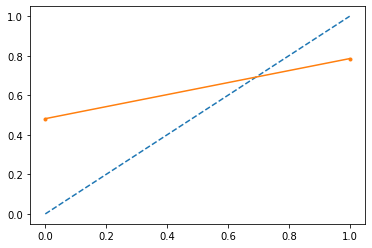

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.52      0.98      0.68       133
         1.0       0.79      0.08      0.15       132

    accuracy                           0.53       265
   macro avg       0.65      0.53      0.41       265
weighted avg       0.65      0.53      0.41       265

learning rate: 2, n_estimator :150 max_features : 4, max_depth : 4 


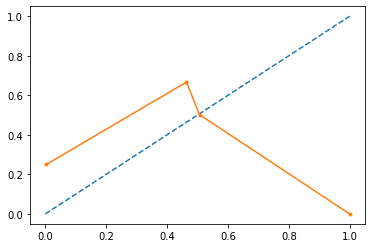

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :150 max_features : 4, max_depth : 5 


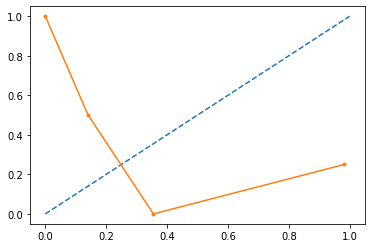

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :150 max_features : 5, max_depth : 3 


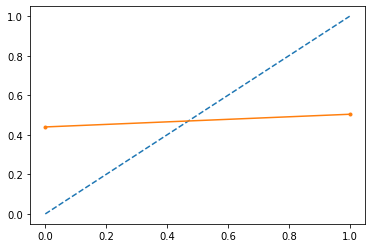

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.56      0.11      0.18       133
         1.0       0.50      0.92      0.65       132

    accuracy                           0.51       265
   macro avg       0.53      0.51      0.41       265
weighted avg       0.53      0.51      0.41       265

learning rate: 2, n_estimator :150 max_features : 5, max_depth : 4 


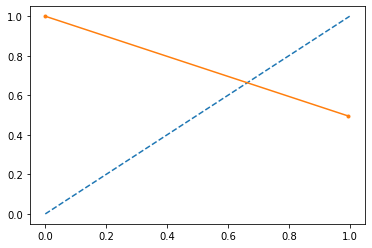

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      0.99      0.66       132

    accuracy                           0.49       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.49      0.33       265

learning rate: 2, n_estimator :150 max_features : 5, max_depth : 5 


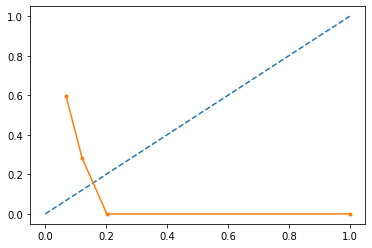

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :180 max_features : 2, max_depth : 3 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


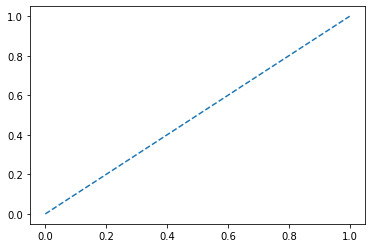

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :180 max_features : 2, max_depth : 4 


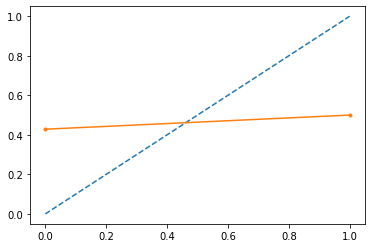

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :180 max_features : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


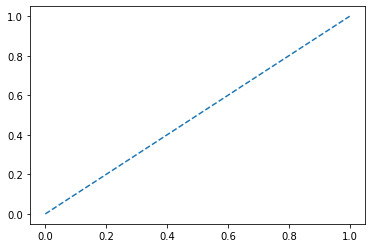

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :180 max_features : 3, max_depth : 3 


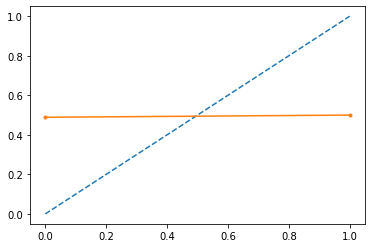

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.51      0.17      0.26       133
         1.0       0.50      0.83      0.62       132

    accuracy                           0.50       265
   macro avg       0.51      0.50      0.44       265
weighted avg       0.51      0.50      0.44       265

learning rate: 2, n_estimator :180 max_features : 3, max_depth : 4 


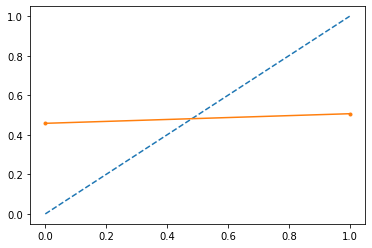

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.54      0.20      0.29       133
         1.0       0.51      0.83      0.63       132

    accuracy                           0.51       265
   macro avg       0.52      0.51      0.46       265
weighted avg       0.52      0.51      0.46       265

learning rate: 2, n_estimator :180 max_features : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


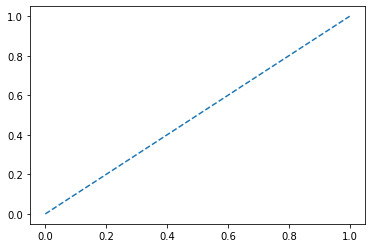

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :180 max_features : 4, max_depth : 3 


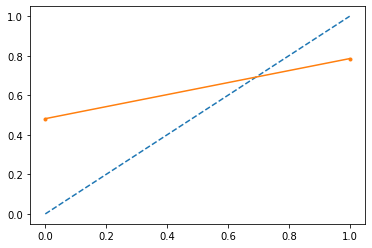

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.52      0.98      0.68       133
         1.0       0.79      0.08      0.15       132

    accuracy                           0.53       265
   macro avg       0.65      0.53      0.41       265
weighted avg       0.65      0.53      0.41       265

learning rate: 2, n_estimator :180 max_features : 4, max_depth : 4 


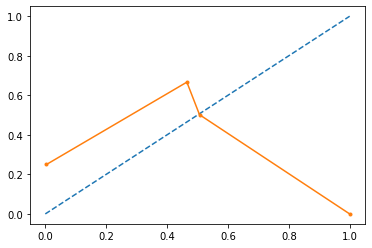

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :180 max_features : 4, max_depth : 5 


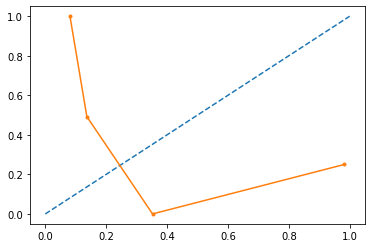

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :180 max_features : 5, max_depth : 3 


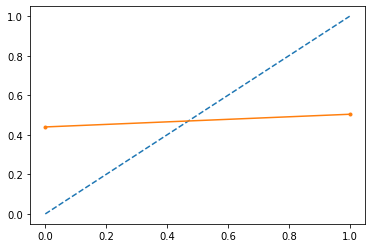

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.56      0.11      0.18       133
         1.0       0.50      0.92      0.65       132

    accuracy                           0.51       265
   macro avg       0.53      0.51      0.41       265
weighted avg       0.53      0.51      0.41       265

learning rate: 2, n_estimator :180 max_features : 5, max_depth : 4 


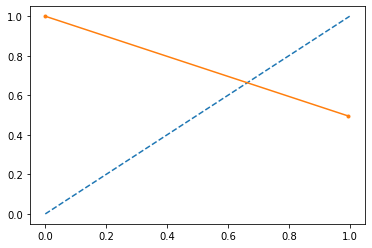

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      0.99      0.66       132

    accuracy                           0.49       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.49      0.33       265

learning rate: 2, n_estimator :180 max_features : 5, max_depth : 5 


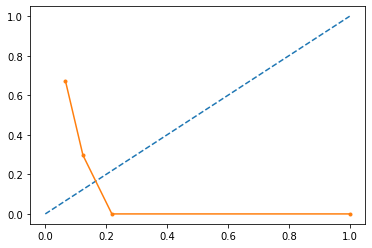

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :200 max_features : 2, max_depth : 3 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


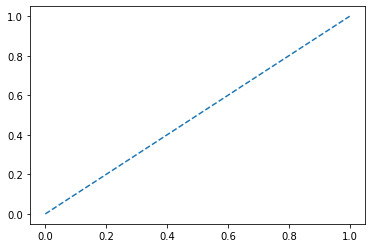

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :200 max_features : 2, max_depth : 4 


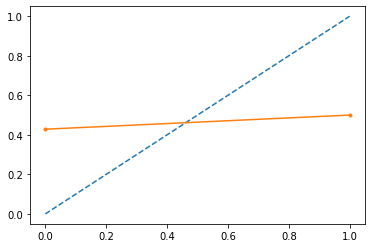

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :200 max_features : 2, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


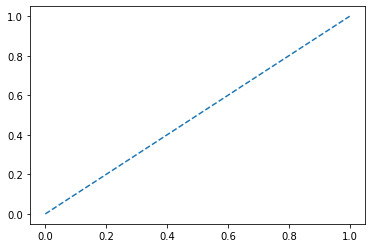

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :200 max_features : 3, max_depth : 3 


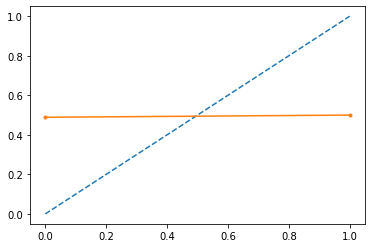

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.51      0.17      0.26       133
         1.0       0.50      0.83      0.62       132

    accuracy                           0.50       265
   macro avg       0.51      0.50      0.44       265
weighted avg       0.51      0.50      0.44       265

learning rate: 2, n_estimator :200 max_features : 3, max_depth : 4 


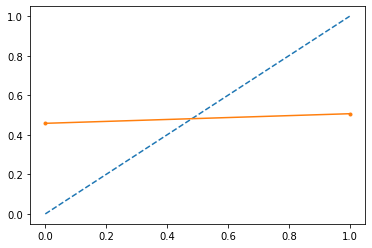

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.54      0.20      0.29       133
         1.0       0.51      0.83      0.63       132

    accuracy                           0.51       265
   macro avg       0.52      0.51      0.46       265
weighted avg       0.52      0.51      0.46       265

learning rate: 2, n_estimator :200 max_features : 3, max_depth : 5 


/opt/anaconda3/lib/python3.7/site-packages/sklearn/calibration.py:859: RuntimeWarning: invalid value encountered in true_divide
  y_prob = (y_prob - y_prob.min()) / (y_prob.max() - y_prob.min())


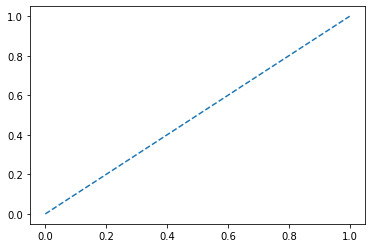

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :200 max_features : 4, max_depth : 3 


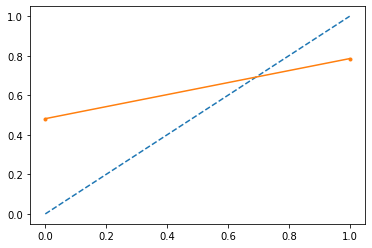

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.52      0.98      0.68       133
         1.0       0.79      0.08      0.15       132

    accuracy                           0.53       265
   macro avg       0.65      0.53      0.41       265
weighted avg       0.65      0.53      0.41       265

learning rate: 2, n_estimator :200 max_features : 4, max_depth : 4 


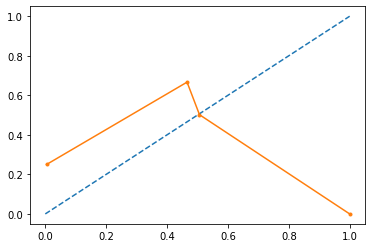

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.57      0.03      0.06       133
         1.0       0.50      0.98      0.66       132

    accuracy                           0.50       265
   macro avg       0.54      0.50      0.36       265
weighted avg       0.54      0.50      0.36       265

learning rate: 2, n_estimator :200 max_features : 4, max_depth : 5 


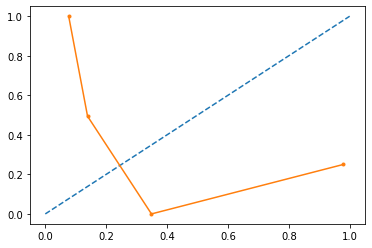

/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265

learning rate: 2, n_estimator :200 max_features : 5, max_depth : 3 


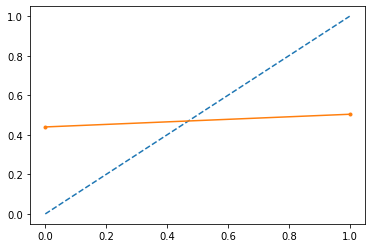

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.56      0.11      0.18       133
         1.0       0.50      0.92      0.65       132

    accuracy                           0.51       265
   macro avg       0.53      0.51      0.41       265
weighted avg       0.53      0.51      0.41       265

learning rate: 2, n_estimator :200 max_features : 5, max_depth : 4 


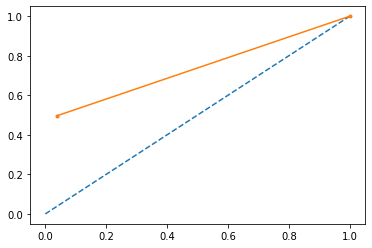

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.49      0.97      0.65       132

    accuracy                           0.48       265
   macro avg       0.25      0.48      0.33       265
weighted avg       0.24      0.48      0.32       265

learning rate: 2, n_estimator :200 max_features : 5, max_depth : 5 


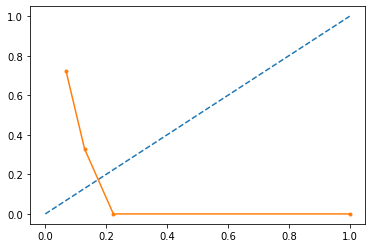

Classification Report: 
               precision    recall  f1-score   support

         0.0       0.00      0.00      0.00       133
         1.0       0.50      1.00      0.66       132

    accuracy                           0.50       265
   macro avg       0.25      0.50      0.33       265
weighted avg       0.25      0.50      0.33       265



/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/opt/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [12]:
X_c, y_c= create_target_set(df_train, 'Sale_CL', dependent_features = ['Sale_CL', 'Sale_MF', 'Sale_CC',
                                                          'Revenue_MF', 'Revenue_CC','Revenue_CL'])

X_c = feature_selection(X_c, y_c, n=20)

X_S, y_S = SMOTE_analysis(X_c, y_c)

X_train_c, X_test_c, y_train_c, y_test_c = train_and_test_split(X_S, y_S)
    
lr_list = [0.05, 0.02, 0.01,0.008, 0.005, 0.002, 0.001, 0.1, 0.2, 0.3, 0.5, 1, 2]

n_estimators = [100, 120, 150, 180, 200]
max_features = [2,3,4,5]
max_depth = [3,4,5]

for learning_rate in lr_list:
    for n_estimator in n_estimators:
        for max_feature in max_features:
            for depth in max_depth:
                print(f"learning rate: {learning_rate}, n_estimator :{n_estimator} max_features : {max_feature}, max_depth : {depth} ")

                estimator_c = model_classification(X_train_c, y_train_c, n_estimators=n_estimator, learning_rate=learning_rate, 
                                             max_features=max_feature, max_depth=depth, random_state=42)

                # predict probabilities
                probs_c = estimator_c.predict_proba(X_test_c)[:,1]
                # reliability diagram
                fop, mpv = calibration_curve(y_test_c, probs_c, n_bins=10, normalize=True)
                # plot perfectly calibrated
                plt.plot([0, 1], [0, 1], linestyle='--')
                # plot model reliability
                plt.plot(mpv, fop, marker='.')
                plt.show()
                prediction_c = estimator_c.predict(X_test_c)

                print("Classification Report: \n", classification_report(y_test_c, prediction_c))